In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import os
import cv2

### 1. 데이터 불러오기
- 경로 : /home/ubuntu/drive/SAM/merged_final.csv

In [2]:
data = pd.read_csv("/home/ubuntu/drive/SAM/merged_final.csv", encoding="UTF-8")

In [3]:
cdata = data.copy()

In [4]:
cdata.head(3)

,Unnamed: 0,check_datetime,측정일자,구역명,farm_code,내부온도,내부습도,내부CO2,근권온도,내부순간일사량,...,bbox_image_path,before_img_name,before_img_id,mask_num,mask_id,point_x,point_y,size,color,output_image_path
0,58758,2021-09-10 13:00:00,2021-09-10,1구역,F0016,27.52,72.22,467.9,22.51,223.17,...,/opt/dlami/nvme/SAM_result/F0016/C101/F0016-C1...,F0016-C101-20210910-075908,283f919417b3c53b4089683ba1cf7ca2,F0016-C101-20210910-125907_0,065e7a9bdd5065fe01976ff3f4f49f03,1132.451172,554.744629,535,"[[121, 123, 112], [123, 125, 114], [118, 120, ...",image_mask_0.png
1,58758,2021-09-10 13:00:00,2021-09-10,1구역,F0016,27.52,72.22,467.9,22.51,223.17,...,/opt/dlami/nvme/SAM_result/F0016/C101/F0016-C1...,F0016-C101-20210910-075908,283f919417b3c53b4089683ba1cf7ca2,F0016-C101-20210910-125907_1,c8f4ef001e5f686be96b1cb1bb68f68d,880.826233,100.000298,37040,"[[54, 63, 44], [88, 97, 76], [82, 91, 70], [85...",image_mask_1.png
2,58782,2021-09-10 17:00:00,2021-09-10,1구역,F0016,27.02,71.23,463.1,23.77,102.75,...,/opt/dlami/nvme/SAM_result/F0016/C101/F0016-C1...,F0016-C101-20210910-125907,d45f2f28bf7fb63dda831452e8442386,F0016-C101-20210910-165907_0,065e7a9bdd5065fe01976ff3f4f49f03,1136.085205,556.137573,576,"[[70, 71, 65], [68, 69, 63], [63, 64, 58], [49...",image_mask_0.png


In [5]:
cdata.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 134330 entries, 0 to 134329
Data columns (total 28 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   Unnamed: 0         134330 non-null  int64  
 1   check_datetime     132584 non-null  object 
 2   측정일자               132584 non-null  object 
 3   구역명                132584 non-null  object 
 4   farm_code          134330 non-null  object 
 5   내부온도               132584 non-null  float64
 6   내부습도               132584 non-null  float64
 7   내부CO2              132584 non-null  float64
 8   근권온도               132584 non-null  float64
 9   내부순간일사량            132584 non-null  float64
 10  측정년도               132584 non-null  float64
 11  측정월                132584 non-null  float64
 12  input_image_name   134330 non-null  object 
 13  input_image_path   134330 non-null  object 
 14  img_id             134330 non-null  object 
 15  area_code          134330 non-null  object 
 16  sh

In [6]:
cdata.describe()

,Unnamed: 0,내부온도,내부습도,내부CO2,근권온도,내부순간일사량,측정년도,측정월,count_masks,point_x,point_y,size
count,134330.000000,132584.000000,132584.000000,132584.000000,132584.000000,132584.000000,132584.000000,132584.000000,134330.000000,134330.000000,134330.000000,134330.000000
mean,269230.262793,19.141740,72.988144,771.722609,15.742509,145.061465,2022.563047,3.849793,64.101422,1223.711793,406.793924,2276.061810
std,119485.783577,5.582866,17.781266,752.048862,2.823580,132.604521,0.812655,3.304336,29.223869,690.399460,219.650029,7673.211729
min,58758.000000,7.820000,23.210000,149.900000,10.510000,0.000000,2021.000000,1.000000,1.000000,5.069072,3.000226,0.000000
25%,136779.000000,14.820000,58.200000,398.900000,13.860000,39.430000,2022.000000,2.000000,42.000000,657.560486,255.427425,640.000000
50%,312206.000000,19.130000,76.930000,445.200000,15.080000,110.580000,2022.000000,3.000000,67.000000,1188.767395,406.228439,1167.000000
75%,365054.000000,22.630000,89.350000,792.300000,16.870000,206.830000,2023.000000,4.000000,86.000000,1789.307159,521.223724,2223.000000
max,421398.000000,56.470000,98.890000,6484.600000,37.180000,781.820000,2024.000000,12.000000,144.000000,2556.066406,1426.772705,447704.000000


In [7]:
### unnamed column 삭제
cdata.drop(["Unnamed: 0"], axis=1, inplace=True)

In [8]:
cdata.columns

Index(['check_datetime', '측정일자', '구역명', 'farm_code', '내부온도', '내부습도', '내부CO2',
       '근권온도', '내부순간일사량', '측정년도', '측정월', 'input_image_name',
       'input_image_path', 'img_id', 'area_code', 'shot_datetime',
       'count_masks', 'bbox_image_path', 'before_img_name', 'before_img_id',
       'mask_num', 'mask_id', 'point_x', 'point_y', 'size', 'color',
       'output_image_path'],
      dtype='object')

### 2. mask info 잘못된 부분 수정
- mask_info 저장 과정에서 mask num이 +1이 되어야 하는데, 이부분이 안됨
- mask_info 마지막 값만 추출해서 +1 한 후 수정된 파일로 재저장

In [9]:
import re  
# 정규표현식 패턴
pattern = re.compile(r'\d+$')
### mask_num 전처리
for idx, mask in enumerate(cdata["mask_num"]):
  # 숫자 추출
  match = re.search(pattern, mask)
  if match:
    number = int(match.group()) + 1
    cdata.iloc[idx, 20] = re.sub(pattern, str(number), mask)

In [10]:
print(cdata["mask_num"])

0          F0016-C101-20210910-125907_1
1          F0016-C101-20210910-125907_2
2          F0016-C101-20210910-165907_1
3          F0016-C101-20210910-165907_2
4          F0016-C101-20210910-165907_3
                      ...              
134325    F0017-C101-20240403-084305_33
134326    F0017-C101-20240403-084305_34
134327    F0017-C101-20240403-084305_35
134328    F0017-C101-20240403-084305_36
134329    F0017-C101-20240403-084305_37
Name: mask_num, Length: 134330, dtype: object


In [11]:
### output_image_path 전처리
### 정규표현식 패턴
pattern = re.compile(r'(\d+)(?=\.\w+$)')
for idx, path in enumerate(cdata["output_image_path"]):
  # 숫자 추출
  match = re.search(pattern, path)
  if match:
    number = int(match.group()) + 1
    cdata.iloc[idx, -1] = re.sub(pattern, str(number), path)
  

In [12]:
print(cdata["output_image_path"])

0          image_mask_1.png
1          image_mask_2.png
2          image_mask_1.png
3          image_mask_2.png
4          image_mask_3.png
                ...        
134325    image_mask_33.png
134326    image_mask_34.png
134327    image_mask_35.png
134328    image_mask_36.png
134329    image_mask_37.png
Name: output_image_path, Length: 134330, dtype: object


In [13]:
cdata.to_csv("merged_final.csv", encoding="UTF-8")

### 3. 다시 EDA 진행

In [14]:
### 일부만 추출하여 확인했을 때 센서데이터와 이미지 자체는 잘 매핑된 것을 확인할 수 있음
cdata.loc[:5, ["check_datetime", "input_image_name", "before_img_name"]]

,check_datetime,input_image_name,before_img_name
0,2021-09-10 13:00:00,F0016-C101-20210910-125907,F0016-C101-20210910-075908
1,2021-09-10 13:00:00,F0016-C101-20210910-125907,F0016-C101-20210910-075908
2,2021-09-10 17:00:00,F0016-C101-20210910-165907,F0016-C101-20210910-125907
3,2021-09-10 17:00:00,F0016-C101-20210910-165907,F0016-C101-20210910-125907
4,2021-09-10 17:00:00,F0016-C101-20210910-165907,F0016-C101-20210910-125907
5,2021-09-10 17:00:00,F0016-C101-20210910-165907,F0016-C101-20210910-125907


##### 1) 221106 16시 - 221107 8시 비교

In [39]:
### 2021년 9월에 해당하는 이미지 필터링
nov = cdata[(cdata["측정년도"] == 2022) & (cdata["측정월"] == 6) & (cdata['farm_code'] == 'F0016')]

# 측정 일자를 datetime으로 변환
nov["측정일자"] = pd.to_datetime(nov["측정일자"])

# 토요일(5) 또는 일요일(6)에 해당하는 날짜만 필터링
nov = nov[(nov["측정일자"].dt.weekday == 5) | (nov["측정일자"].dt.weekday == 6)]

/tmp/ipykernel_53011/3925131954.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  nov["측정일자"] = pd.to_datetime(nov["측정일자"])


In [40]:
nov['before_img_name'].unique()

array(['F0016-C101-20220603-163000', 'F0016-C101-20220604-083000',
       'F0016-C101-20220604-123000', 'F0016-C101-20220604-163000',
       'F0016-C101-20220605-083000', 'F0016-C101-20220605-123000'],
      dtype=object)

In [104]:
### 전후 딸기 매핑이 잘 되었는지 확인하기 위한 데이터 추출
nov1 = nov[nov["before_img_name"] == "F0016-C101-20220605-083000"]
nov2 = nov[nov["before_img_name"] == "F0016-C101-20220605-123000"]

nov0506 = pd.merge(nov1, nov2, on="mask_id", how="outer")
nov0506.drop(['check_datetime_x', '측정일자_x', '내부온도_x',
       '내부습도_x', '내부CO2_x', '근권온도_x', '내부순간일사량_x', '측정년도_x', '측정월_x',
       'img_id_x', "구역명_x", 
       'shot_datetime_x', 'count_masks_x', 'bbox_image_path_x',
       'before_img_id_x', 'size_x', 'color_x',
       'check_datetime_y', '측정일자_y', '내부온도_y',
       '내부습도_y', '내부CO2_y', '근권온도_y', '내부순간일사량_y', '측정년도_y', '측정월_y',
       'img_id_y', "구역명_y", 
       'shot_datetime_y', 'count_masks_y', 'bbox_image_path_y',
       'size_y', 'color_y',], axis=1, inplace=True)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220605-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220605-083000
mask_num_x                                 F0016-C101-20220605-123000_12
mask_id                                 148cc7999b8946cf3813506e42ba2348
point_x_x                                                    2200.033691
point_y_x                                                    1362.121216
output_image_path_x                                    image_mask_12.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220605-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

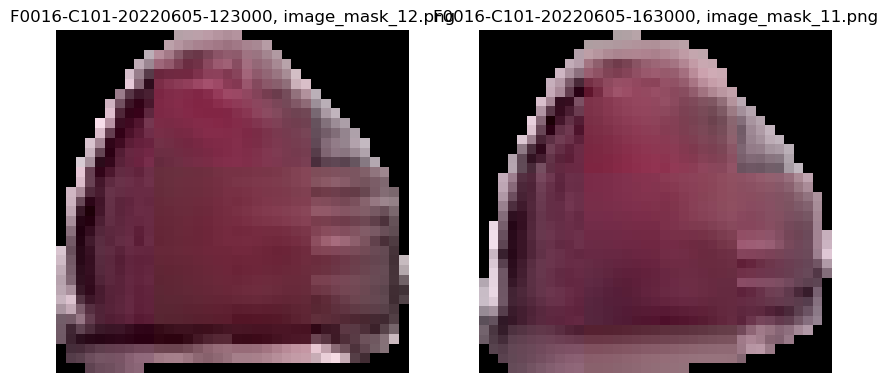

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220605-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220605-083000
mask_num_x                                  F0016-C101-20220605-123000_5
mask_id                                 3f0ab6c7b4ad3b01877996ceed23162a
point_x_x                                                     994.476929
point_y_x                                                     440.567444
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220605-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

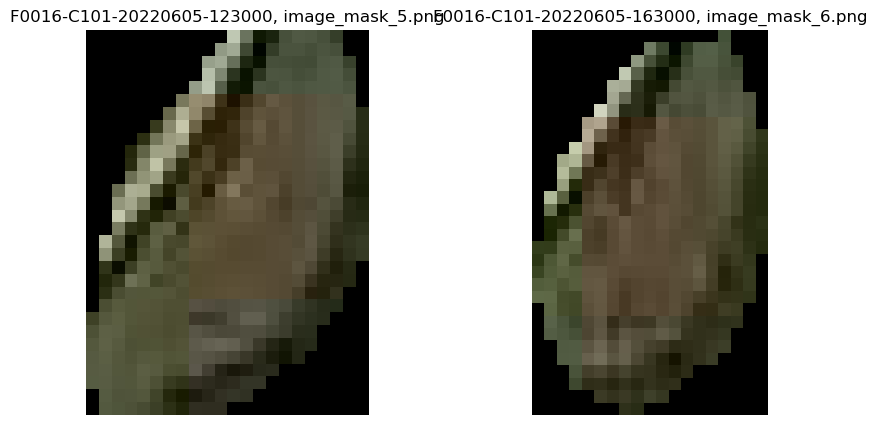

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220605-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220605-083000
mask_num_x                                  F0016-C101-20220605-123000_3
mask_id                                 7483cac893d0efe79e00aa8cf73a34a3
point_x_x                                                     743.088928
point_y_x                                                     482.064148
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220605-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

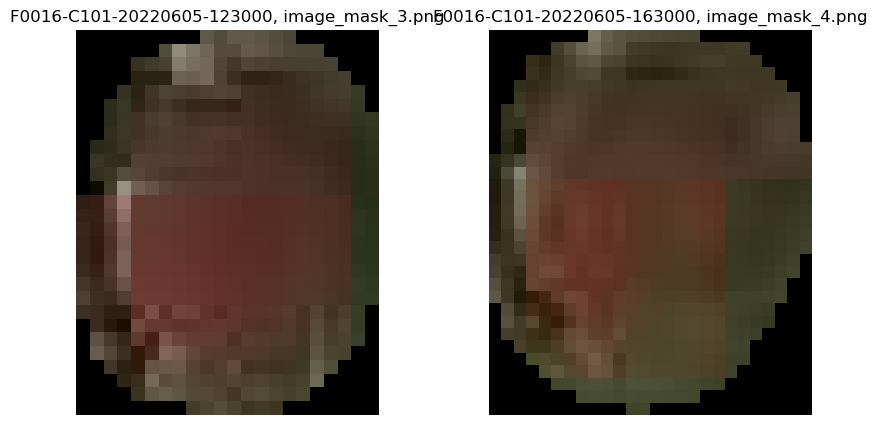

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220605-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220605-083000
mask_num_x                                  F0016-C101-20220605-123000_2
mask_id                                 85ec66814aa33f0d339c34b874a1bd6b
point_x_x                                                     771.694946
point_y_x                                                     572.843262
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220605-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

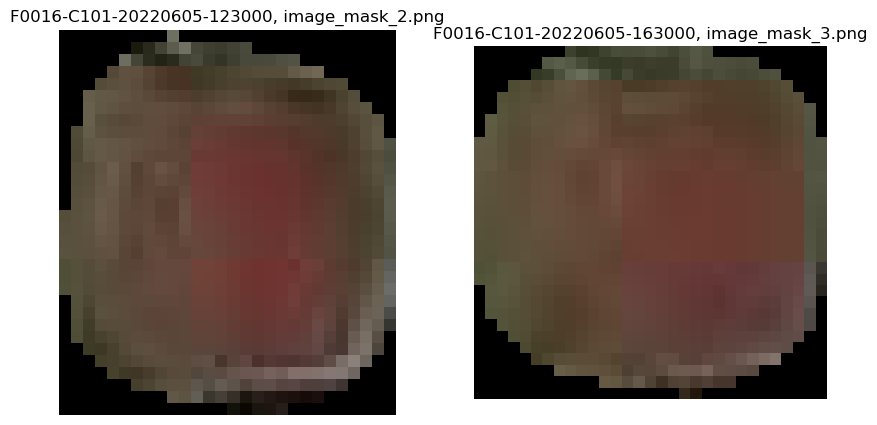

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220605-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220605-083000
mask_num_x                                  F0016-C101-20220605-123000_8
mask_id                                 8a75b8f8cf86ce4059052851dbc8dc39
point_x_x                                                     1318.59021
point_y_x                                                     530.172058
output_image_path_x                                     image_mask_8.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220605-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

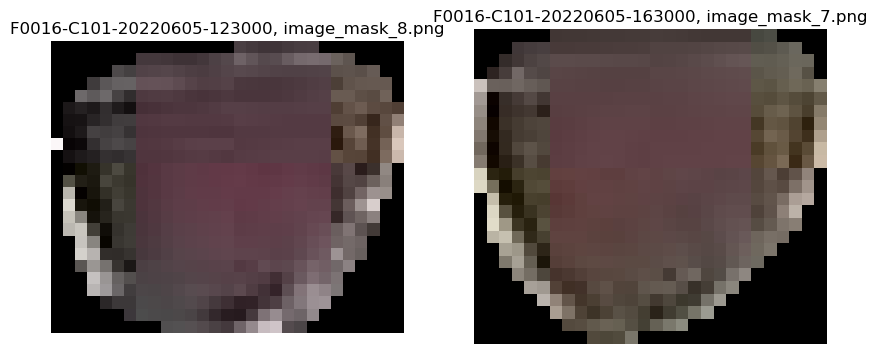

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220605-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220605-083000
mask_num_x                                  F0016-C101-20220605-123000_4
mask_id                                 9e39f368fdeac0dc6e5cee7159b1c09b
point_x_x                                                     947.186523
point_y_x                                                     585.332397
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220605-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

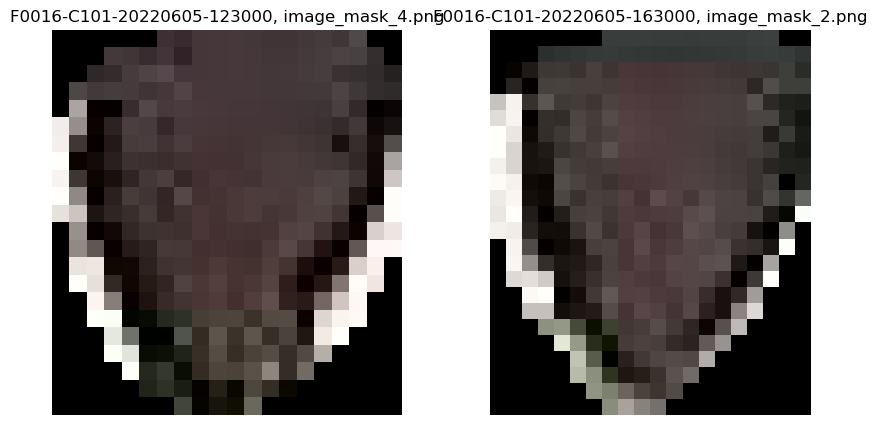

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220605-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220605-083000
mask_num_x                                  F0016-C101-20220605-123000_7
mask_id                                 d27614e8909898499e87692ba0a694ce
point_x_x                                                      979.33252
point_y_x                                                     377.468292
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220605-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

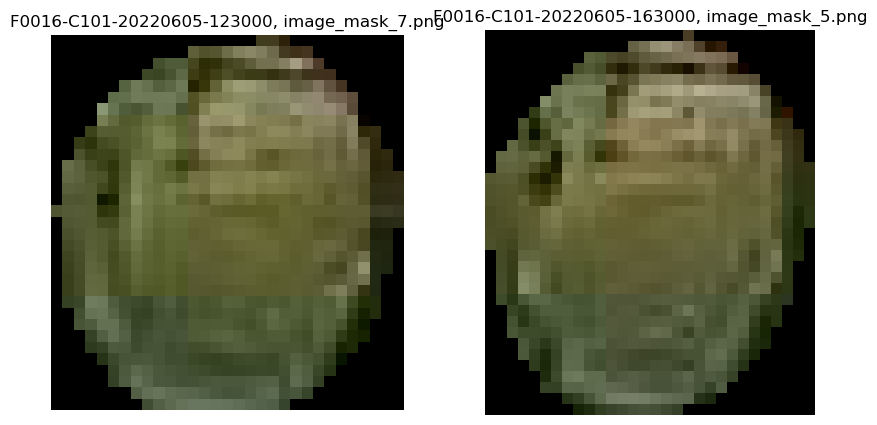

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220605-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220605-083000
mask_num_x                                  F0016-C101-20220605-123000_9
mask_id                                 f317b57528fb9de3fa4d7cca417e82c6
point_x_x                                                    2030.384644
point_y_x                                                      463.40976
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220605-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

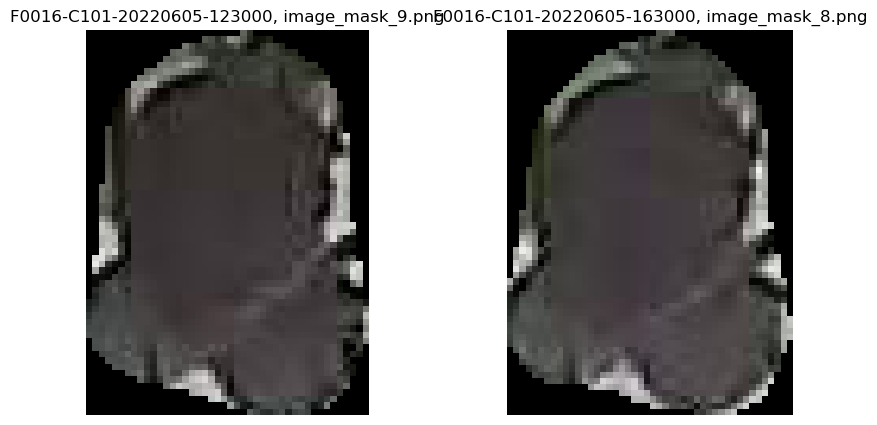

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220605-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220605-083000
mask_num_x                                 F0016-C101-20220605-123000_10
mask_id                                 f317b57528fb9de3fa4d7cca417e82c6
point_x_x                                                    2030.816406
point_y_x                                                     470.481354
output_image_path_x                                    image_mask_10.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220605-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

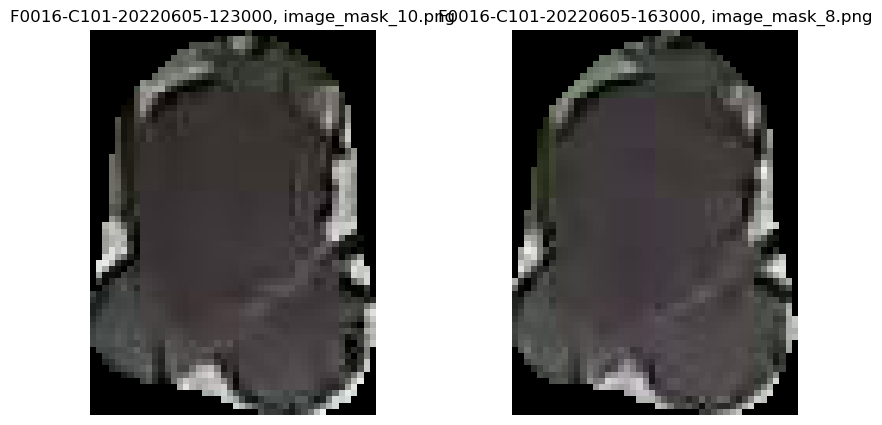

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220605-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220605-083000
mask_num_x                                  F0016-C101-20220605-123000_1
mask_id                                 feff9a1c81164dd5328765974036ff10
point_x_x                                                    1005.469116
point_y_x                                                     354.959167
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220605-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

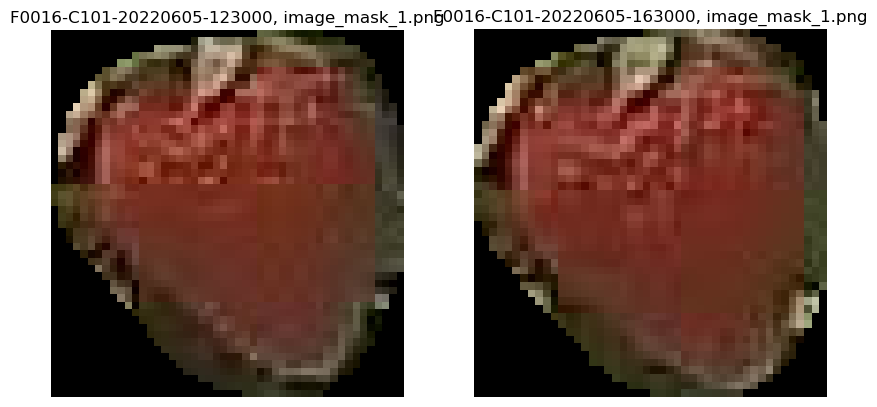

In [105]:
def visualize_mask(df_row, base_folder):
    input_img_name_x = df_row['input_image_name_x']  # 이미지 파일명 가져오기
    input_img_name_y = df_row["input_image_name_y"]

    farm_code_x = df_row["farm_code_x"]
    farm_code_y = df_row["farm_code_y"]
    
    area_code_x = df_row["area_code_x"]
    area_code_y = df_row["area_code_y"]
    
    
    mask_id_x = df_row['output_image_path_x']  # Mask ID 가져오기
    mask_id_y = df_row["output_image_path_y"]
    
    base_folder_x = base_folder + farm_code_x + "/" + area_code_x + "/" + input_img_name_x + "/masks/"
    base_folder_y = base_folder + farm_code_y + "/" + area_code_y + "/" + input_img_name_y + "/masks/"

    # 이미지 파일 경로 생성
    mask_path_x = os.path.join(base_folder_x, mask_id_x)
    mask_path_y = os.path.join(base_folder_y, mask_id_y)

    # 이미지 및 마스크 불러오기
    mask_x = cv2.imread(mask_path_x)
    mask_y = cv2.imread(mask_path_y)

    # 이미지 및 마스크 시각화
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(mask_x, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_x}, {mask_id_x}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(mask_y, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_y}, {mask_id_y}')
    plt.axis('off')

    plt.show()

# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

**생각한 전처리 방식**
- 가로, 세로 비율로 전처리 하기
    - 목적 : 가로나 세로가 너무 길다란 것을 제거하기 위함
    - 세로가 길다란 것은 앞에 딸기에 가려져서 그런 것일수도 있음
    - 하지만, 딸기가 가려져서 너무 제대로 안나오는 것을 잡는 것이 맞는가 의문이 듬..
    - 만약 위에 해당하는 것을 살리고 싶다면, 가로로 너무 긴 것만 제거해도 좋을 듯
- 이미지 촬영 날짜와 시간이 있는 부분
    - 숫자가 겹쳐져 있는 마스크가 있는데 이 부분은 제거해야 할 듯
- 중복된 마스크 제거
    - 중복된 바운딩 박스로 인해 아예 마스크가 동일한 경우가 있음
    - 따라서, 같은 딸기로 맵핑된 것을 기준으로 비슷한 위치에 있는데 마스크가 동일한 경우 하나만 남기도록 전처리 필요함
    - 또한, 마스크 크기가 더 큰 것이 여러 딸기를 잡은 것이기 때문에 마스크 크기가 작은 것만 남기도로 하는 것이 좋을 것으로 보임
- 작기 기준으로 딸기가 없는 달은 마스크 제거해야 할듯
    - 2021년 기준 9월, 10월 처럼 딸기가 아예 없고 나뭇잎만 있지만, 마스크가 생성된 경우에 해당하는 것은 제거하는 과정이 필요함.
- 마스크 사이즈 기준 너무 작은 딸기 제거해야 할듯
    - 딸기를 거의 알아볼 수 없고 너무 뒤쪽에 작게 있는거라 색상도 이상하게 나옴
- 맵핑 딸기 임계값 조절
    - 딸기가 잘 맵핑이 되는 편이지만 옆에 있는 딸기와 맵핑되는 것이 간혹가다 있음
    - 따라서 임계값을 조절하는게 좋을듯


**수정된 전처리 방식**
- 가로로 비율이 긴 애들 제거하기
- 마스크가 아예 동일한 경우 하나만 남기기
- 뭉탱이와 세세하게 잡힌게 있음 뭉탱이 날리기(동일하다고 잡힌 딸기 & 마스크 사이즈 기준)
- 작기 기준 딸기가 없는 달은 마스크 제거하기


**작기 : 2021.09.10 ~ 2022.06.09**

2021년 9월
- 딸기가 아직 없으며, 맵핑은 잘 되지만 잡은 바운딩 박스가 모두 나뭇잎임

2021년 10월
- 아직 딸기가 아예 없음
- 나뭇잎을 정돈해서 그런지 아예 뭉텅이로 잡히는 경우들이 꽤 있음
- 또한, 아예 마스크가 안되는 것들도 꽤 있음
- 중복되어 생성된 마스크는 계속 중복되게 생성됨(3개가 중복된 이미지가 생성된 경우도 있음)

2021년 11월
- 마스크가 아예 동일하게 중복된 경우가 있음
- 딸기 모양이 제대로 된것도 이상하게 짤려서 마스크를 제대로 못 잡는 경우가 있음

2021년 12월
- 중복되어서 잡는거는 계속 비슷하게 중복됨
- 맵핑은 잘되지만 뭔가 임계값이 큰 것 같음, 임계값을 줄이고 맵핑이 안된 근처에 있는 것을 제거하는 것도 하나의 방안일수도...?

2022년 1월
- 가로가 길다란 네모 모양으로 잡힌게 있는데 지우는게 가로 세로 비율을 보고 제거하도록 하는 것도 좋을 듯
- 이상한 보라색 이미지....?
- 숫자가 있는 부분에서 잡힌거는 아예 제거하는게 나을 듯

2022월 2월
- 딸기가 따져서 가려져 있던 딸기랑 맵핑이 됨(즉, 위치상으로는 맞으나 같은 딸기가 아닌 경우임)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20210912-075906
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20210911-165905
mask_num_x                                  F0016-C101-20210912-075906_4
mask_id                                 7d78902ab2ef05dfe489937a97aa69c5
point_x_x                                                    2300.004883
point_y_x                                                     407.573181
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20210912-125904
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

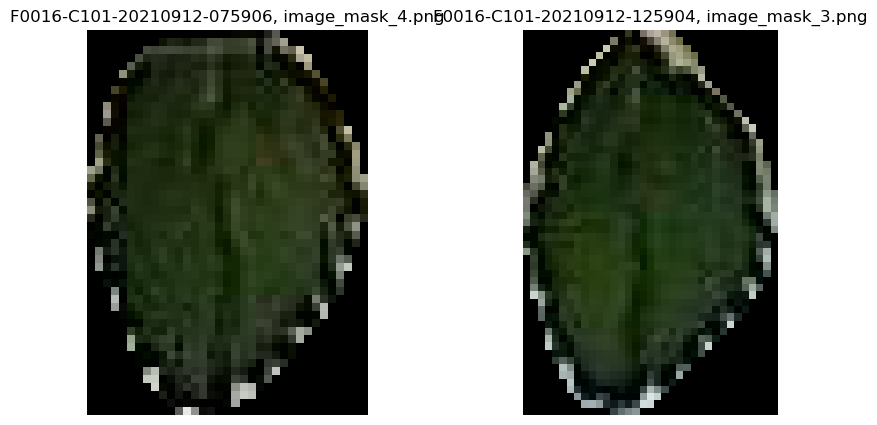

In [58]:
def visualize_mask(df_row, base_folder):
    input_img_name_x = df_row['input_image_name_x']  # 이미지 파일명 가져오기
    input_img_name_y = df_row["input_image_name_y"]

    farm_code_x = df_row["farm_code_x"]
    farm_code_y = df_row["farm_code_y"]
    
    area_code_x = df_row["area_code_x"]
    area_code_y = df_row["area_code_y"]
    
    
    mask_id_x = df_row['output_image_path_x']  # Mask ID 가져오기
    mask_id_y = df_row["output_image_path_y"]
    
    base_folder_x = base_folder + farm_code_x + "/" + area_code_x + "/" + input_img_name_x + "/masks/"
    base_folder_y = base_folder + farm_code_y + "/" + area_code_y + "/" + input_img_name_y + "/masks/"

    # 이미지 파일 경로 생성
    mask_path_x = os.path.join(base_folder_x, mask_id_x)
    mask_path_y = os.path.join(base_folder_y, mask_id_y)

    # 이미지 및 마스크 불러오기
    mask_x = cv2.imread(mask_path_x)
    mask_y = cv2.imread(mask_path_y)

    # 이미지 및 마스크 시각화
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(mask_x, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_x}, {mask_id_x}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(mask_y, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_y}, {mask_id_y}')
    plt.axis('off')

    plt.show()

# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211010-125904
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211010-075906
mask_num_x                                  F0016-C101-20211010-125904_1
mask_id                                 92ab72c89f7aecd64a7cea78078c4217
point_x_x                                                     454.619934
point_y_x                                                     524.424866
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211010-165905
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

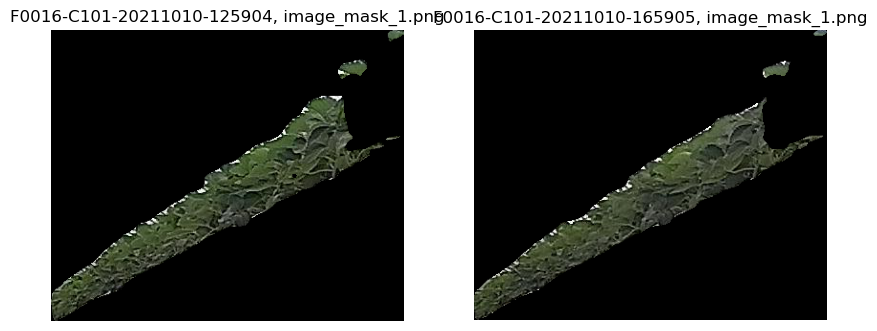

In [100]:
def visualize_mask(df_row, base_folder):
    input_img_name_x = df_row['input_image_name_x']  # 이미지 파일명 가져오기
    input_img_name_y = df_row["input_image_name_y"]

    farm_code_x = df_row["farm_code_x"]
    farm_code_y = df_row["farm_code_y"]
    
    area_code_x = df_row["area_code_x"]
    area_code_y = df_row["area_code_y"]
    
    
    mask_id_x = df_row['output_image_path_x']  # Mask ID 가져오기
    mask_id_y = df_row["output_image_path_y"]
    
    base_folder_x = base_folder + farm_code_x + "/" + area_code_x + "/" + input_img_name_x + "/masks/"
    base_folder_y = base_folder + farm_code_y + "/" + area_code_y + "/" + input_img_name_y + "/masks/"

    # 이미지 파일 경로 생성
    mask_path_x = os.path.join(base_folder_x, mask_id_x)
    mask_path_y = os.path.join(base_folder_y, mask_id_y)

    # 이미지 및 마스크 불러오기
    mask_x = cv2.imread(mask_path_x)
    mask_y = cv2.imread(mask_path_y)

    # 이미지 및 마스크 시각화
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(mask_x, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_x}, {mask_id_x}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(mask_y, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_y}, {mask_id_y}')
    plt.axis('off')

    plt.show()

# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211113-155902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211113-115903
mask_num_x                                  F0016-C101-20211113-155902_1
mask_id                                 7a29be654a41be88b33691e32feed145
point_x_x                                                    1576.351562
point_y_x                                                     115.792854
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211113-115903
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

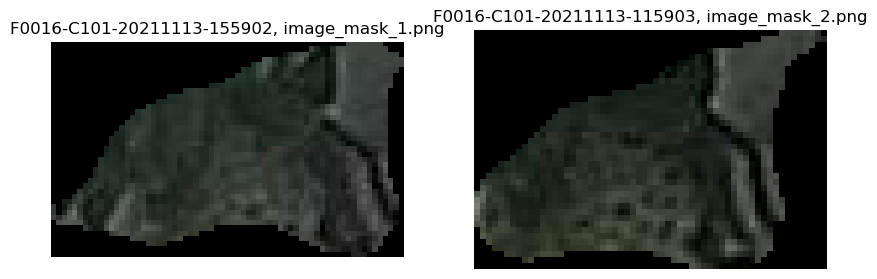

In [135]:
def visualize_mask(df_row, base_folder):
    input_img_name_x = df_row['input_image_name_x']  # 이미지 파일명 가져오기
    input_img_name_y = df_row["input_image_name_y"]

    farm_code_x = df_row["farm_code_x"]
    farm_code_y = df_row["farm_code_y"]
    
    area_code_x = df_row["area_code_x"]
    area_code_y = df_row["area_code_y"]
    
    
    mask_id_x = df_row['output_image_path_x']  # Mask ID 가져오기
    mask_id_y = df_row["output_image_path_y"]
    
    base_folder_x = base_folder + farm_code_x + "/" + area_code_x + "/" + input_img_name_x + "/masks/"
    base_folder_y = base_folder + farm_code_y + "/" + area_code_y + "/" + input_img_name_y + "/masks/"

    # 이미지 파일 경로 생성
    mask_path_x = os.path.join(base_folder_x, mask_id_x)
    mask_path_y = os.path.join(base_folder_y, mask_id_y)

    # 이미지 및 마스크 불러오기
    mask_x = cv2.imread(mask_path_x)
    mask_y = cv2.imread(mask_path_y)

    # 이미지 및 마스크 시각화
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(mask_x, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_x}, {mask_id_x}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(mask_y, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_y}, {mask_id_y}')
    plt.axis('off')

    plt.show()

# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211121-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211121-075902
mask_num_x                                  F0016-C101-20211121-125902_2
mask_id                                 39744d9b85ab955c4afcee37eeea4ac6
point_x_x                                                    1435.924683
point_y_x                                                     182.933197
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211121-075902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

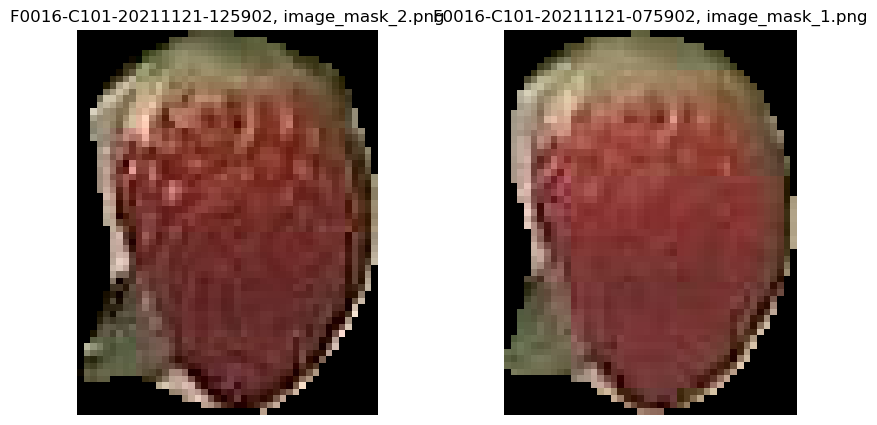

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211121-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211121-075902
mask_num_x                                  F0016-C101-20211121-125902_3
mask_id                                 8a24d8eab92ff3584f7bfac6bca8aa27
point_x_x                                                    1952.224365
point_y_x                                                      21.824551
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211121-075902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

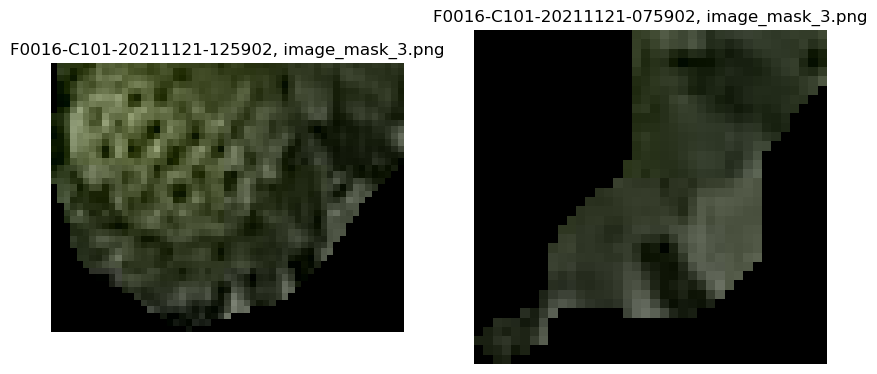

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211121-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211121-075902
mask_num_x                                  F0016-C101-20211121-125902_4
mask_id                                 8a24d8eab92ff3584f7bfac6bca8aa27
point_x_x                                                    1946.166504
point_y_x                                                       16.54718
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211121-075902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

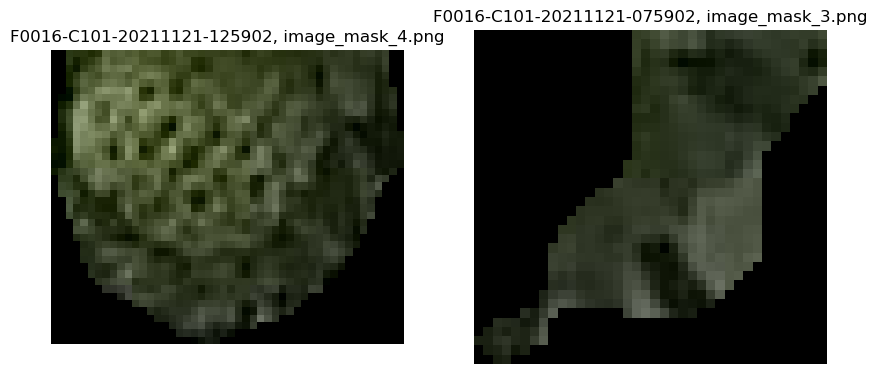

In [22]:
def visualize_mask(df_row, base_folder):
    input_img_name_x = df_row['input_image_name_x']  # 이미지 파일명 가져오기
    input_img_name_y = df_row["input_image_name_y"]

    farm_code_x = df_row["farm_code_x"]
    farm_code_y = df_row["farm_code_y"]
    
    area_code_x = df_row["area_code_x"]
    area_code_y = df_row["area_code_y"]
    
    
    mask_id_x = df_row['output_image_path_x']  # Mask ID 가져오기
    mask_id_y = df_row["output_image_path_y"]
    
    base_folder_x = base_folder + farm_code_x + "/" + area_code_x + "/" + input_img_name_x + "/masks/"
    base_folder_y = base_folder + farm_code_y + "/" + area_code_y + "/" + input_img_name_y + "/masks/"

    # 이미지 파일 경로 생성
    mask_path_x = os.path.join(base_folder_x, mask_id_x)
    mask_path_y = os.path.join(base_folder_y, mask_id_y)

    # 이미지 및 마스크 불러오기
    mask_x = cv2.imread(mask_path_x)
    mask_y = cv2.imread(mask_path_y)

    # 이미지 및 마스크 시각화
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(mask_x, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_x}, {mask_id_x}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(mask_y, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_y}, {mask_id_y}')
    plt.axis('off')

    plt.show()

# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211121-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211121-075902
mask_num_x                                  F0016-C101-20211121-125902_2
mask_id                                 39744d9b85ab955c4afcee37eeea4ac6
point_x_x                                                    1435.924683
point_y_x                                                     182.933197
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211121-165902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

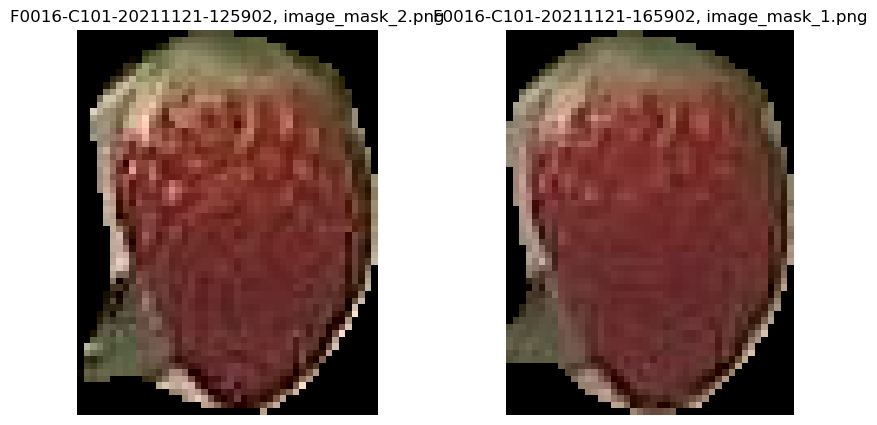

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211121-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211121-075902
mask_num_x                                  F0016-C101-20211121-125902_3
mask_id                                 8a24d8eab92ff3584f7bfac6bca8aa27
point_x_x                                                    1952.224365
point_y_x                                                      21.824551
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211121-165902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

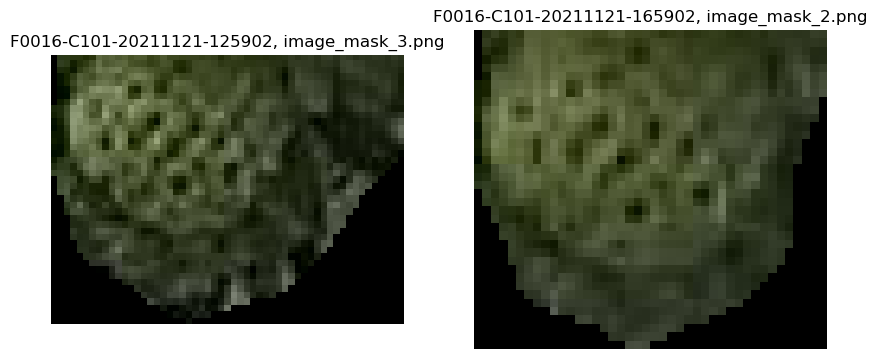

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211121-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211121-075902
mask_num_x                                  F0016-C101-20211121-125902_3
mask_id                                 8a24d8eab92ff3584f7bfac6bca8aa27
point_x_x                                                    1952.224365
point_y_x                                                      21.824551
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211121-165902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

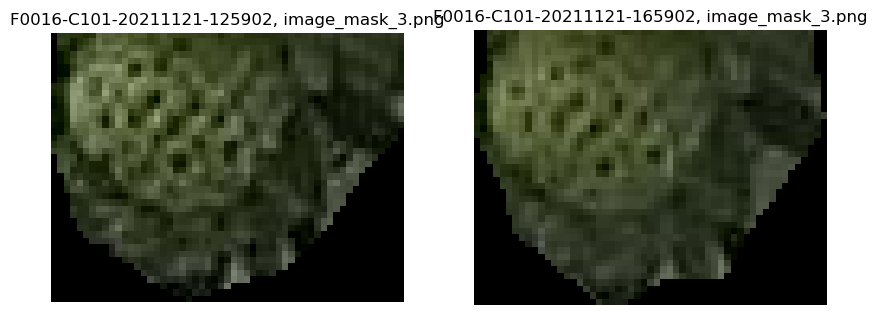

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211121-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211121-075902
mask_num_x                                  F0016-C101-20211121-125902_3
mask_id                                 8a24d8eab92ff3584f7bfac6bca8aa27
point_x_x                                                    1952.224365
point_y_x                                                      21.824551
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211121-165902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

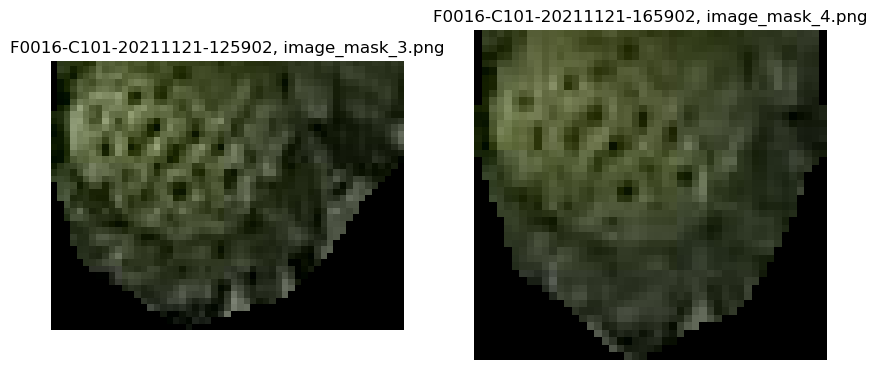

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211121-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211121-075902
mask_num_x                                  F0016-C101-20211121-125902_4
mask_id                                 8a24d8eab92ff3584f7bfac6bca8aa27
point_x_x                                                    1946.166504
point_y_x                                                       16.54718
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211121-165902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

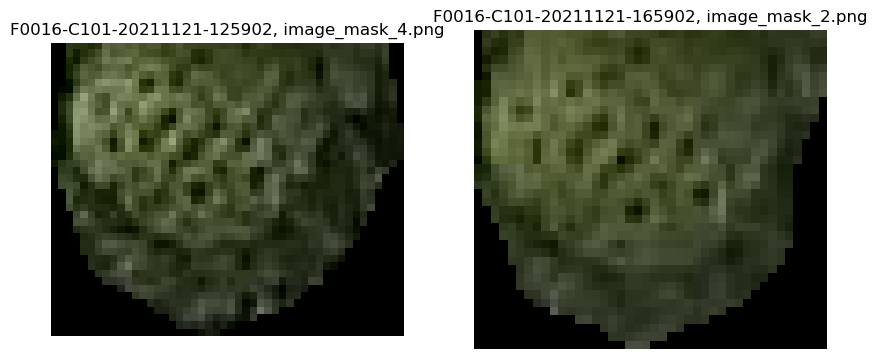

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211121-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211121-075902
mask_num_x                                  F0016-C101-20211121-125902_4
mask_id                                 8a24d8eab92ff3584f7bfac6bca8aa27
point_x_x                                                    1946.166504
point_y_x                                                       16.54718
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211121-165902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

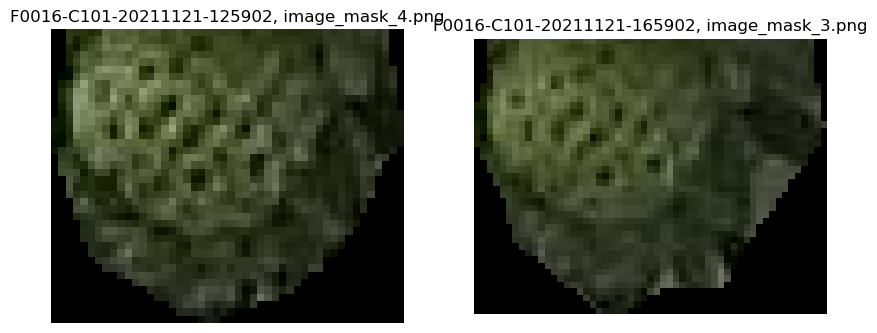

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211121-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211121-075902
mask_num_x                                  F0016-C101-20211121-125902_4
mask_id                                 8a24d8eab92ff3584f7bfac6bca8aa27
point_x_x                                                    1946.166504
point_y_x                                                       16.54718
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211121-165902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

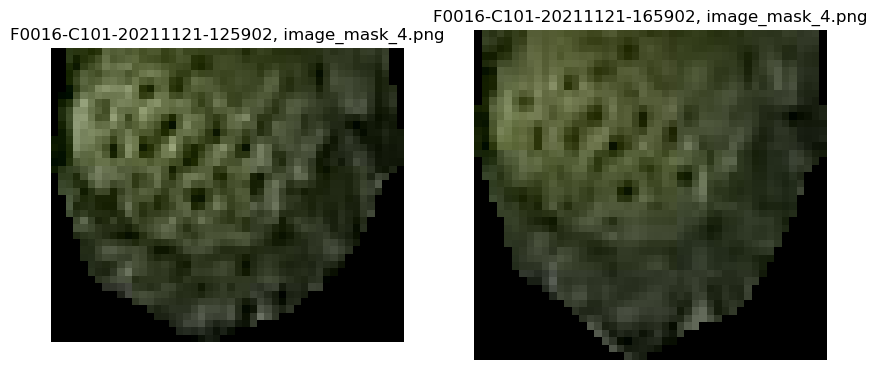

In [25]:
def visualize_mask(df_row, base_folder):
    input_img_name_x = df_row['input_image_name_x']  # 이미지 파일명 가져오기
    input_img_name_y = df_row["input_image_name_y"]

    farm_code_x = df_row["farm_code_x"]
    farm_code_y = df_row["farm_code_y"]
    
    area_code_x = df_row["area_code_x"]
    area_code_y = df_row["area_code_y"]
    
    
    mask_id_x = df_row['output_image_path_x']  # Mask ID 가져오기
    mask_id_y = df_row["output_image_path_y"]
    
    base_folder_x = base_folder + farm_code_x + "/" + area_code_x + "/" + input_img_name_x + "/masks/"
    base_folder_y = base_folder + farm_code_y + "/" + area_code_y + "/" + input_img_name_y + "/masks/"

    # 이미지 파일 경로 생성
    mask_path_x = os.path.join(base_folder_x, mask_id_x)
    mask_path_y = os.path.join(base_folder_y, mask_id_y)

    # 이미지 및 마스크 불러오기
    mask_x = cv2.imread(mask_path_x)
    mask_y = cv2.imread(mask_path_y)

    # 이미지 및 마스크 시각화
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(mask_x, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_x}, {mask_id_x}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(mask_y, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_y}, {mask_id_y}')
    plt.axis('off')

    plt.show()

# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211127-075902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211126-165902
mask_num_x                                  F0016-C101-20211127-075902_9
mask_id                                 47553f1b7ab2ae507acf37ddb4d8563b
point_x_x                                                     1959.01001
point_y_x                                                     161.887634
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211127-125902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

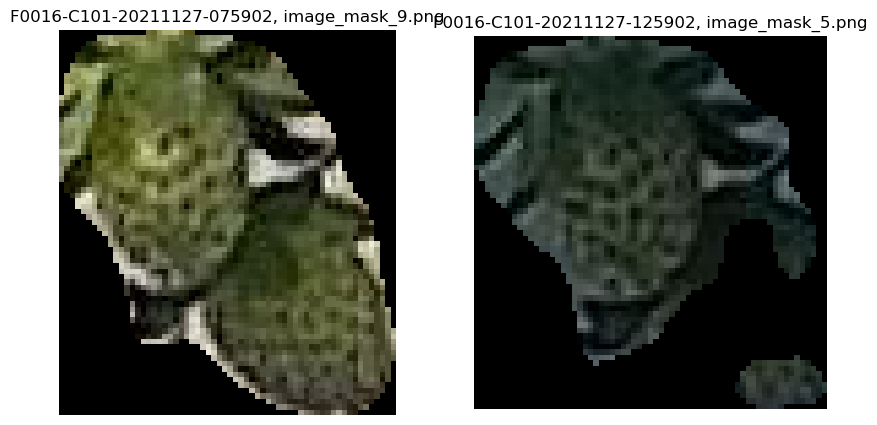

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211127-075902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211126-165902
mask_num_x                                  F0016-C101-20211127-075902_2
mask_id                                 4a483e5c3ce019b09af531759f4748fc
point_x_x                                                    1718.631592
point_y_x                                                      27.627699
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211127-125902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

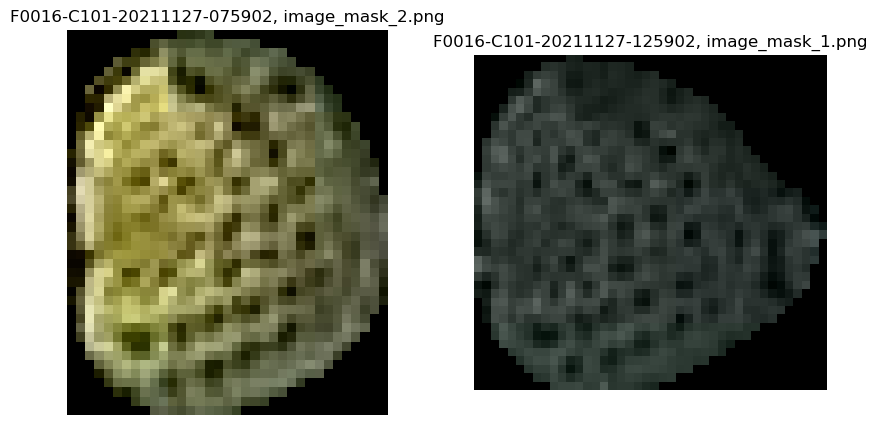

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211127-075902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211126-165902
mask_num_x                                  F0016-C101-20211127-075902_4
mask_id                                 b151d5c1d1fe62eeff0c5cdf3bb8b906
point_x_x                                                    1618.613037
point_y_x                                                      13.680704
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211127-125902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

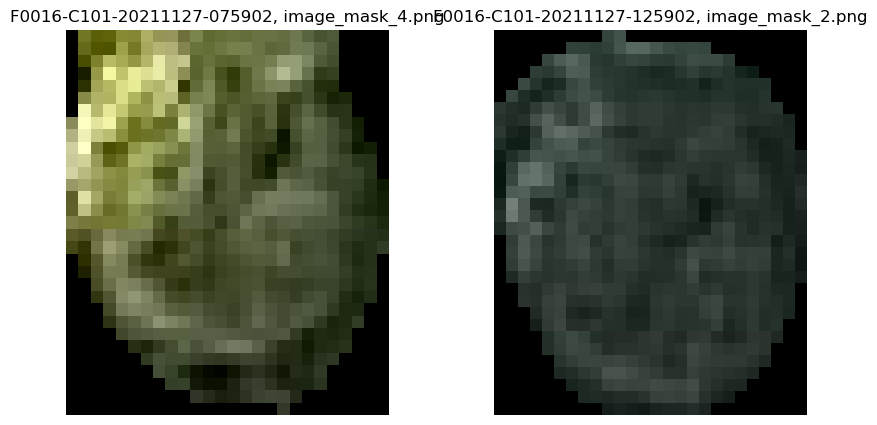

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211127-075902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211126-165902
mask_num_x                                  F0016-C101-20211127-075902_8
mask_id                                 e7f0bdc9d33073330b027b8ef8f1e328
point_x_x                                                    1974.493408
point_y_x                                                     169.743088
output_image_path_x                                     image_mask_8.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211127-125902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

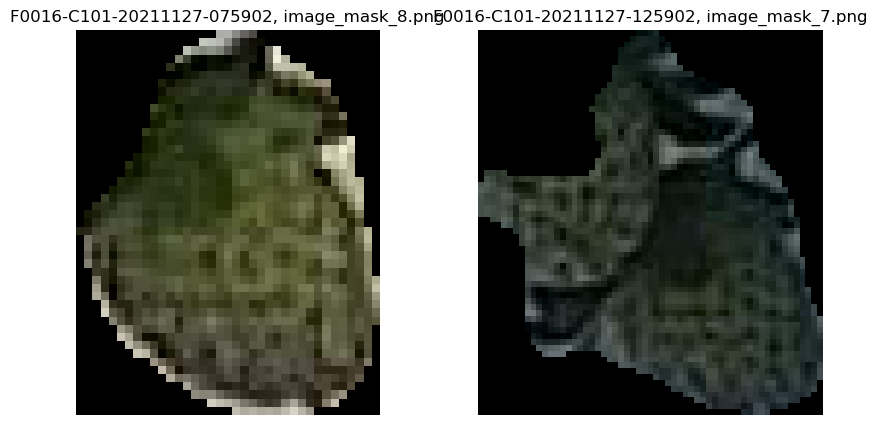

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211127-075902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211126-165902
mask_num_x                                 F0016-C101-20211127-075902_11
mask_id                                 e7f0bdc9d33073330b027b8ef8f1e328
point_x_x                                                    1974.775146
point_y_x                                                     175.736206
output_image_path_x                                    image_mask_11.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211127-125902
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

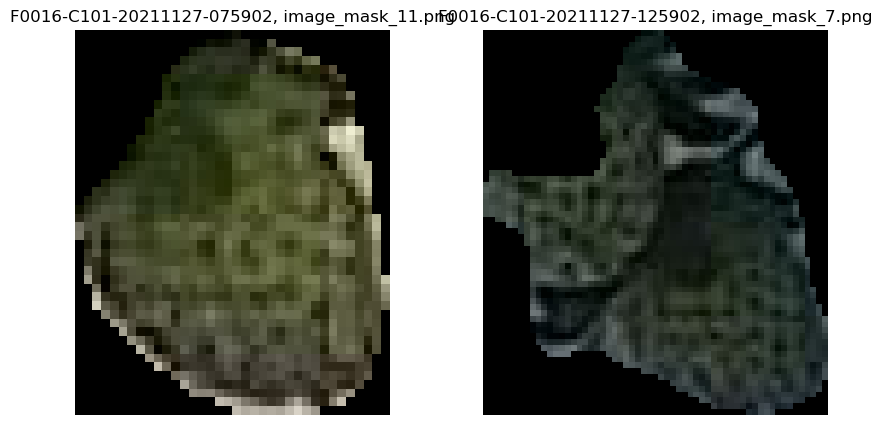

In [28]:
def visualize_mask(df_row, base_folder):
    input_img_name_x = df_row['input_image_name_x']  # 이미지 파일명 가져오기
    input_img_name_y = df_row["input_image_name_y"]

    farm_code_x = df_row["farm_code_x"]
    farm_code_y = df_row["farm_code_y"]
    
    area_code_x = df_row["area_code_x"]
    area_code_y = df_row["area_code_y"]
    
    
    mask_id_x = df_row['output_image_path_x']  # Mask ID 가져오기
    mask_id_y = df_row["output_image_path_y"]
    
    base_folder_x = base_folder + farm_code_x + "/" + area_code_x + "/" + input_img_name_x + "/masks/"
    base_folder_y = base_folder + farm_code_y + "/" + area_code_y + "/" + input_img_name_y + "/masks/"

    # 이미지 파일 경로 생성
    mask_path_x = os.path.join(base_folder_x, mask_id_x)
    mask_path_y = os.path.join(base_folder_y, mask_id_y)

    # 이미지 및 마스크 불러오기
    mask_x = cv2.imread(mask_path_x)
    mask_y = cv2.imread(mask_path_y)

    # 이미지 및 마스크 시각화
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(mask_x, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_x}, {mask_id_x}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(mask_y, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_y}, {mask_id_y}')
    plt.axis('off')

    plt.show()

# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211128-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211128-075903
mask_num_x                                  F0016-C101-20211128-125902_9
mask_id                                 3051fddbca71e9d78cd99fdff3dd64de
point_x_x                                                    2035.826538
point_y_x                                                     111.449104
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211128-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

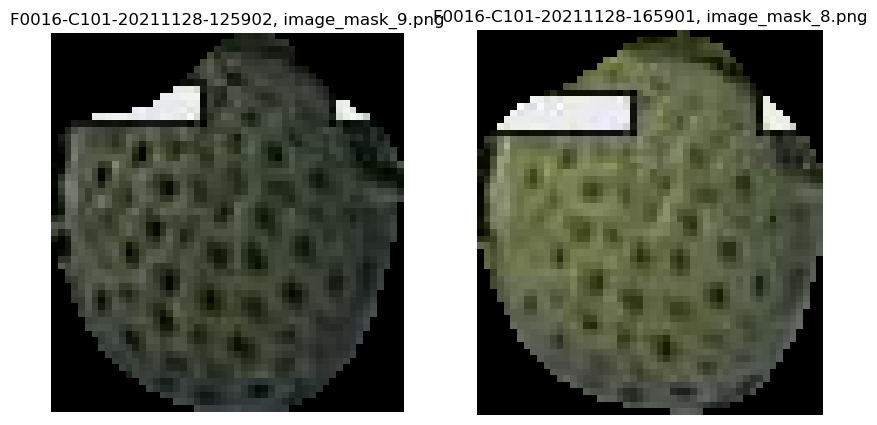

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211128-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211128-075903
mask_num_x                                  F0016-C101-20211128-125902_2
mask_id                                 4a483e5c3ce019b09af531759f4748fc
point_x_x                                                    1726.812622
point_y_x                                                      43.288177
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211128-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

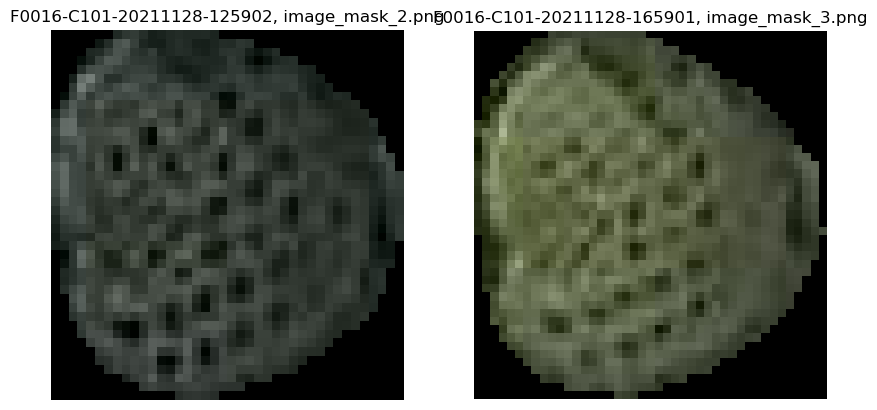

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211128-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211128-075903
mask_num_x                                  F0016-C101-20211128-125902_4
mask_id                                 546330e042247a7d7519c3c4d4590a85
point_x_x                                                    1572.772217
point_y_x                                                      74.641663
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211128-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

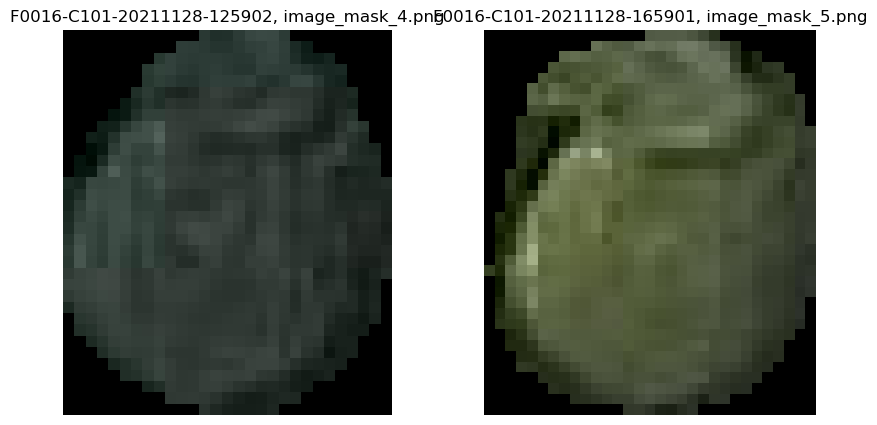

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211128-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211128-075903
mask_num_x                                  F0016-C101-20211128-125902_6
mask_id                                 5aa0ef3d20dd293022291dcbab15cc2b
point_x_x                                                    2004.075684
point_y_x                                                     194.478821
output_image_path_x                                     image_mask_6.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211128-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

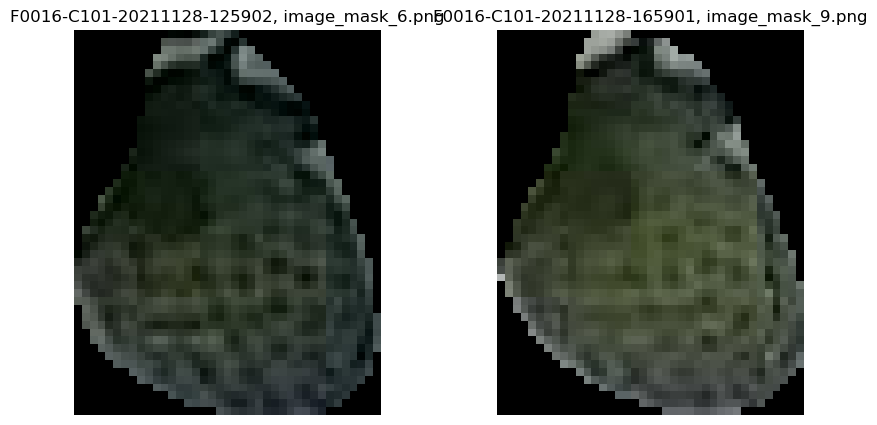

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211128-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211128-075903
mask_num_x                                  F0016-C101-20211128-125902_5
mask_id                                 a0ad580134297fef0e7ed79a6dec9bb7
point_x_x                                                     1935.52832
point_y_x                                                     110.272858
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211128-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

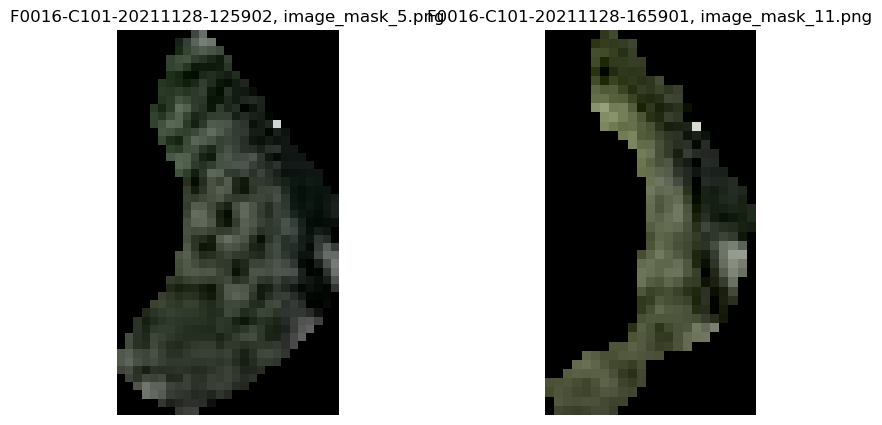

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211128-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211128-075903
mask_num_x                                  F0016-C101-20211128-125902_8
mask_id                                 a0ad580134297fef0e7ed79a6dec9bb7
point_x_x                                                    1931.593262
point_y_x                                                     118.473419
output_image_path_x                                     image_mask_8.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211128-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

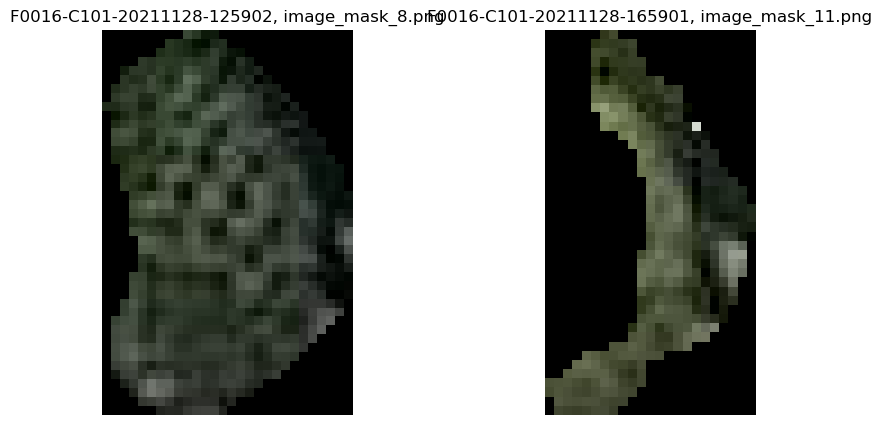

In [37]:
def visualize_mask(df_row, base_folder):
    input_img_name_x = df_row['input_image_name_x']  # 이미지 파일명 가져오기
    input_img_name_y = df_row["input_image_name_y"]

    farm_code_x = df_row["farm_code_x"]
    farm_code_y = df_row["farm_code_y"]
    
    area_code_x = df_row["area_code_x"]
    area_code_y = df_row["area_code_y"]
    
    
    mask_id_x = df_row['output_image_path_x']  # Mask ID 가져오기
    mask_id_y = df_row["output_image_path_y"]
    
    base_folder_x = base_folder + farm_code_x + "/" + area_code_x + "/" + input_img_name_x + "/masks/"
    base_folder_y = base_folder + farm_code_y + "/" + area_code_y + "/" + input_img_name_y + "/masks/"

    # 이미지 파일 경로 생성
    mask_path_x = os.path.join(base_folder_x, mask_id_x)
    mask_path_y = os.path.join(base_folder_y, mask_id_y)

    # 이미지 및 마스크 불러오기
    mask_x = cv2.imread(mask_path_x)
    mask_y = cv2.imread(mask_path_y)

    # 이미지 및 마스크 시각화
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(mask_x, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_x}, {mask_id_x}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(mask_y, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_y}, {mask_id_y}')
    plt.axis('off')

    plt.show()

# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                 F0016-C101-20211205-125902_12
mask_id                                 03b4ad2d641ebc2619e9b21eea73c53a
point_x_x                                                    1790.638916
point_y_x                                                      84.304024
output_image_path_x                                    image_mask_12.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

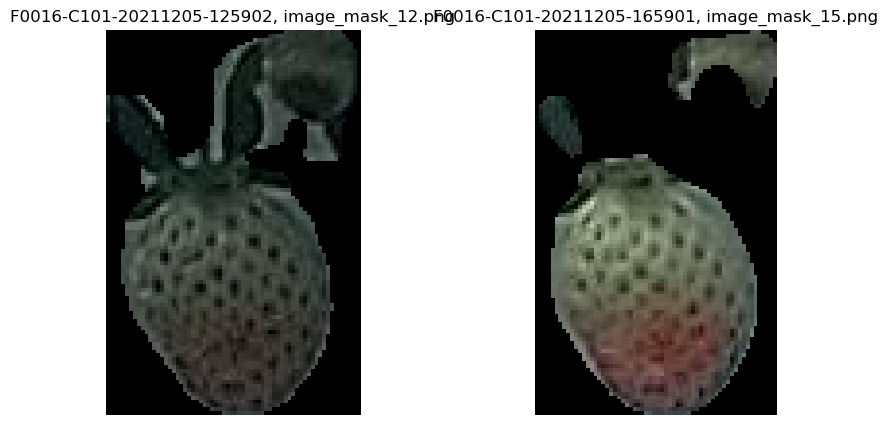

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                  F0016-C101-20211205-125902_5
mask_id                                 0b200ed0a5b30fe7244eebe7d7d8b4e0
point_x_x                                                     1100.17627
point_y_x                                                      288.89325
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

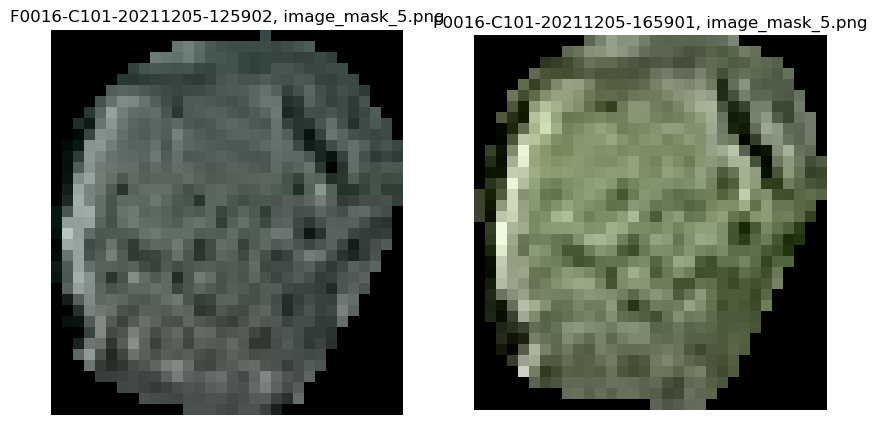

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                  F0016-C101-20211205-125902_6
mask_id                                 22797c3cbbd518f42a87f7dbb9201ded
point_x_x                                                    1121.981445
point_y_x                                                     304.172577
output_image_path_x                                     image_mask_6.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

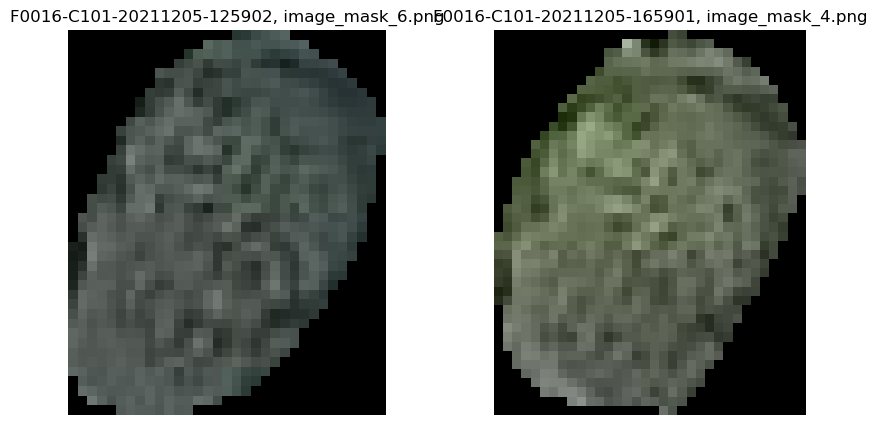

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                 F0016-C101-20211205-125902_14
mask_id                                 3fb904833779fe18dfbac952be9e56b2
point_x_x                                                    1798.546509
point_y_x                                                       99.98175
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

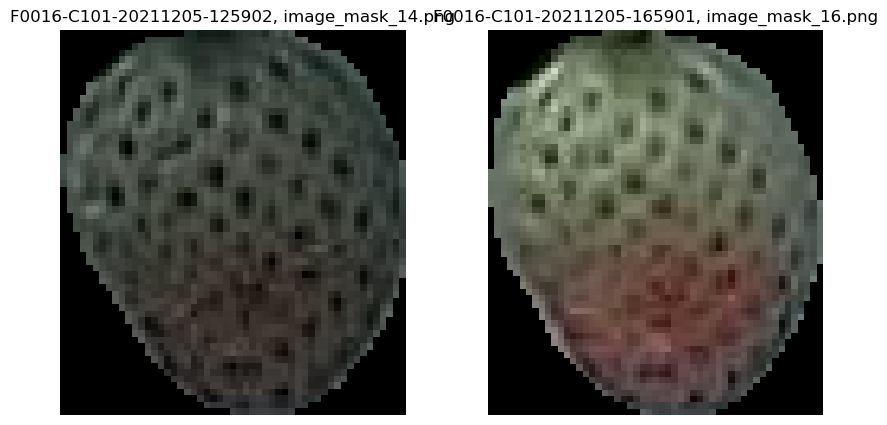

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                  F0016-C101-20211205-125902_7
mask_id                                 485180e95abb39c990ec1a1aa83187ad
point_x_x                                                    1007.266479
point_y_x                                                     351.319061
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

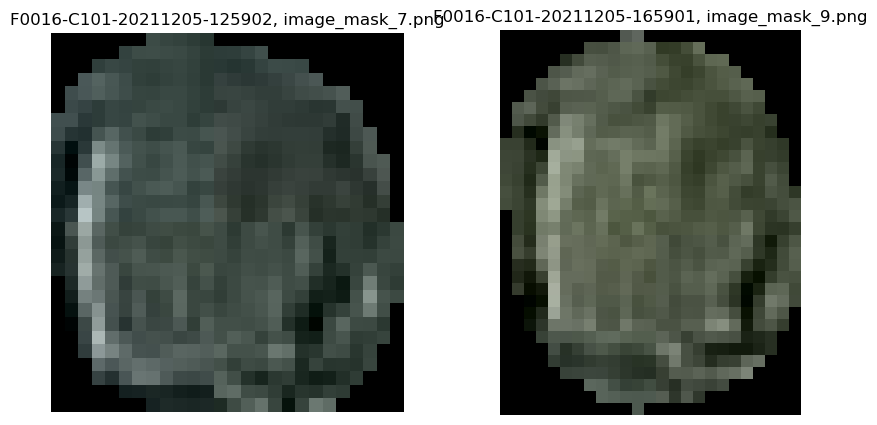

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                 F0016-C101-20211205-125902_16
mask_id                                 55c1a7e7a33438da752e77023dc2d8ec
point_x_x                                                    1961.651611
point_y_x                                                     209.324738
output_image_path_x                                    image_mask_16.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

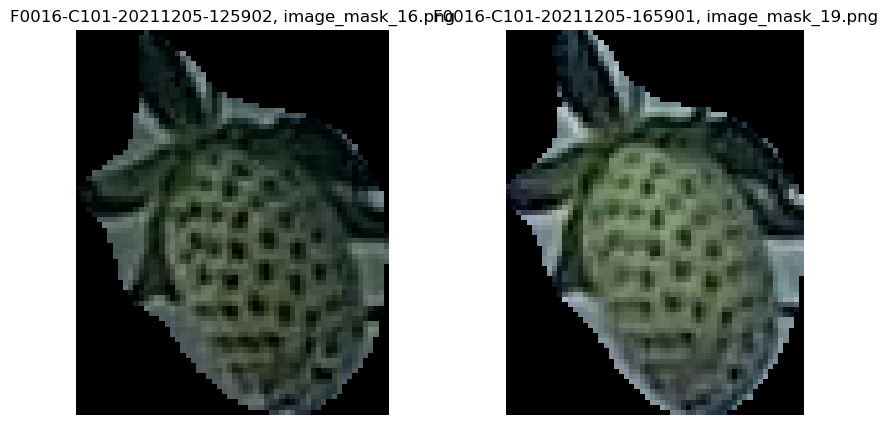

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                 F0016-C101-20211205-125902_19
mask_id                                 68be9045ef8ed05832b2a80aedb5f458
point_x_x                                                    2031.133057
point_y_x                                                     146.421921
output_image_path_x                                    image_mask_19.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

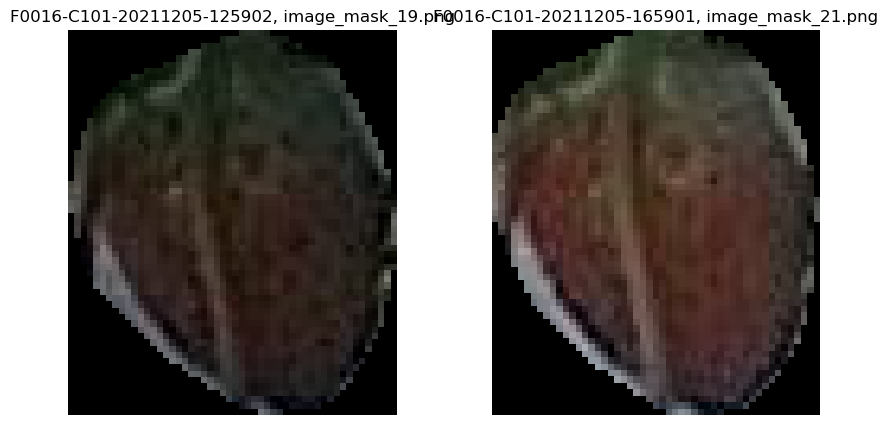

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                 F0016-C101-20211205-125902_18
mask_id                                 6d2969716ad849654c70054df3ba9208
point_x_x                                                    2083.608398
point_y_x                                                     155.113068
output_image_path_x                                    image_mask_18.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

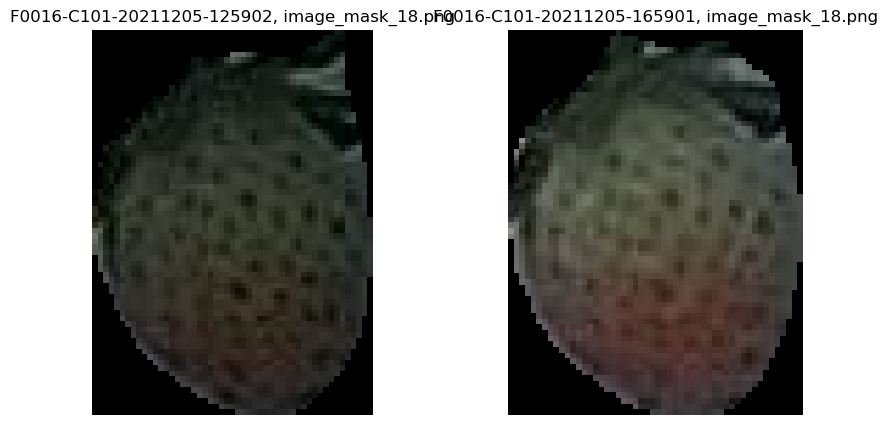

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                  F0016-C101-20211205-125902_2
mask_id                                 78f6d5d1c312e54ba2264fcf148e2bcd
point_x_x                                                     504.224884
point_y_x                                                     598.097778
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

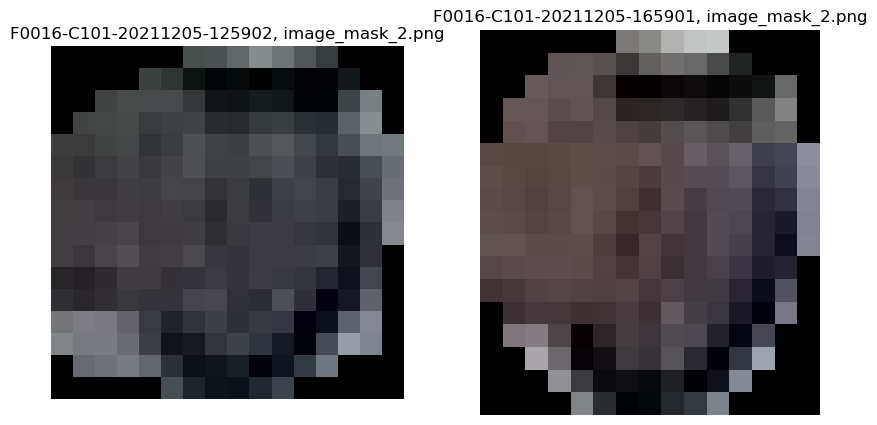

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                  F0016-C101-20211205-125902_2
mask_id                                 78f6d5d1c312e54ba2264fcf148e2bcd
point_x_x                                                     504.224884
point_y_x                                                     598.097778
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

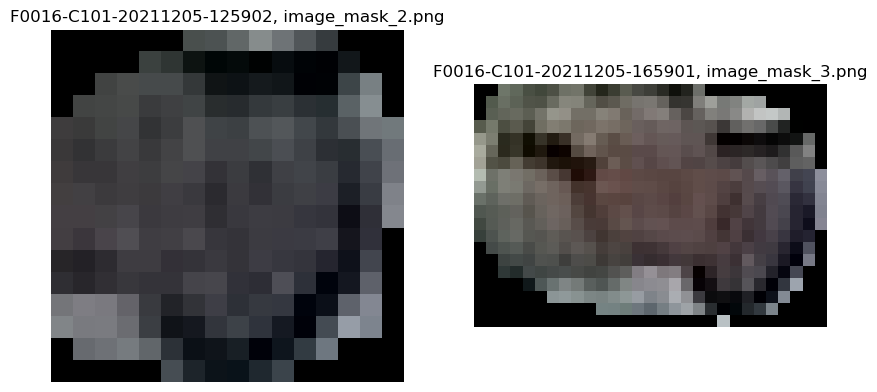

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                 F0016-C101-20211205-125902_20
mask_id                                 8e16cd44354806d04ca5fc6450e86da3
point_x_x                                                     2068.88916
point_y_x                                                     241.702789
output_image_path_x                                    image_mask_20.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

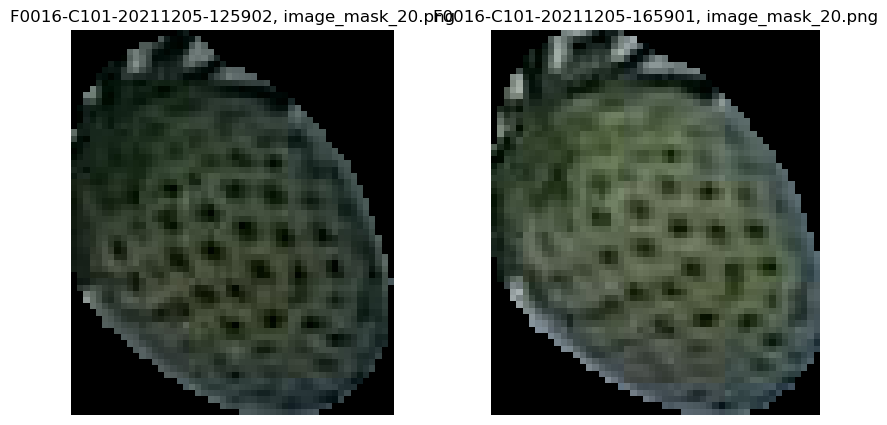

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                 F0016-C101-20211205-125902_17
mask_id                                 b96b88355ab1fb927da8606273a9b245
point_x_x                                                    2018.163452
point_y_x                                                     233.518143
output_image_path_x                                    image_mask_17.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

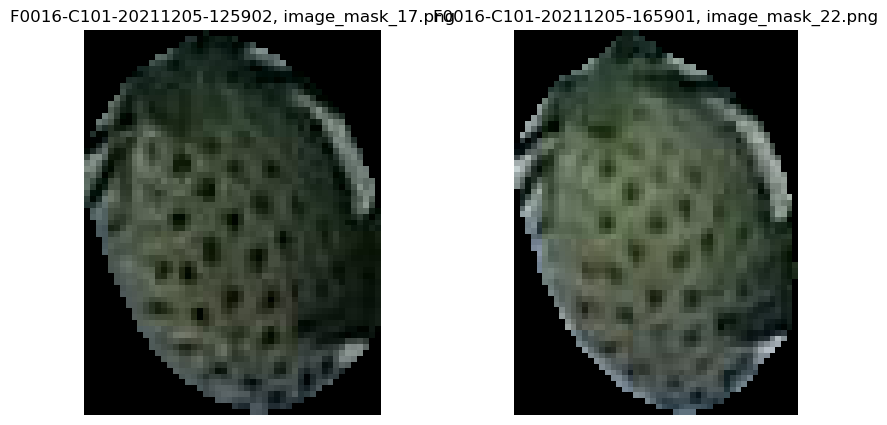

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                  F0016-C101-20211205-125902_1
mask_id                                 bf1aae255a3f6d362f16946b747b72a1
point_x_x                                                      568.35498
point_y_x                                                     554.788879
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

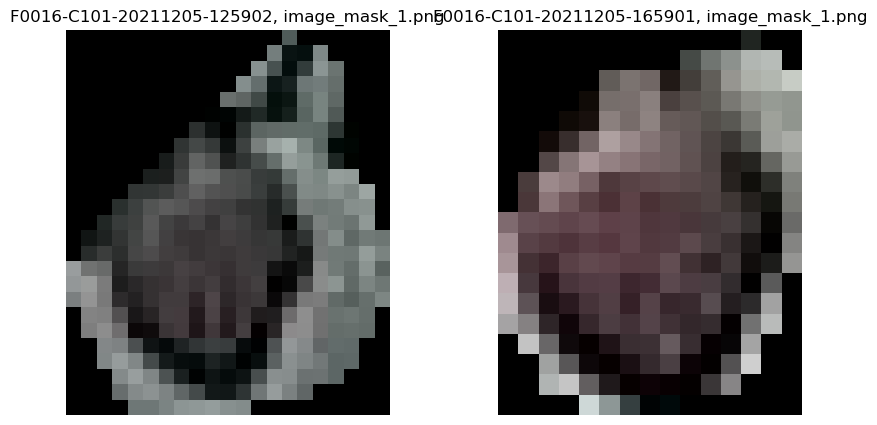

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                 F0016-C101-20211205-125902_15
mask_id                                 c00af017bd86950e42013637a1896d03
point_x_x                                                    1683.775146
point_y_x                                                     178.529602
output_image_path_x                                    image_mask_15.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

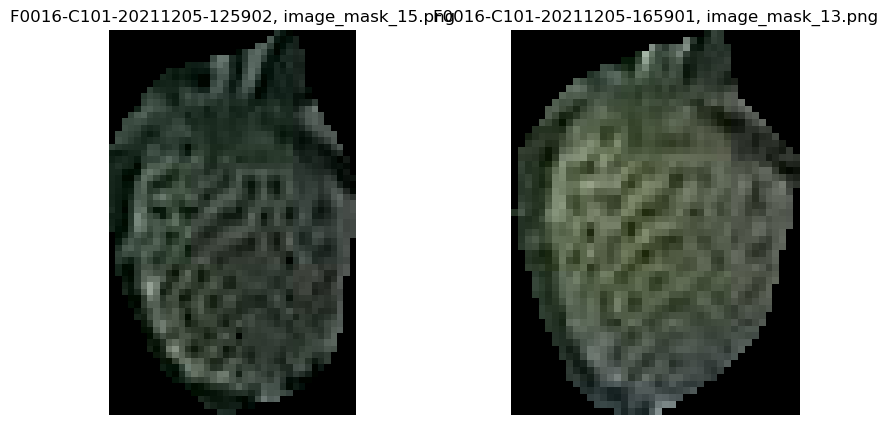

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                 F0016-C101-20211205-125902_11
mask_id                                 c3c41592bcf3aac12a543ad24bdab639
point_x_x                                                    1755.891602
point_y_x                                                     145.531219
output_image_path_x                                    image_mask_11.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

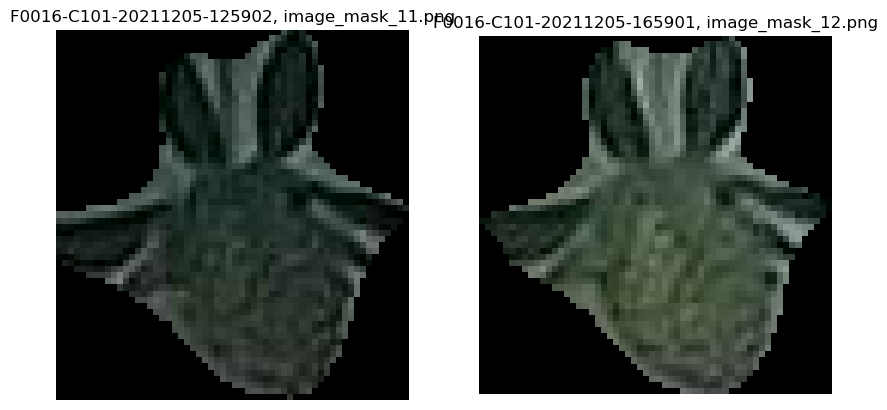

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                  F0016-C101-20211205-125902_9
mask_id                                 c77a3b768fd16dcd791cc76344b859e1
point_x_x                                                    1083.484253
point_y_x                                                     346.146698
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

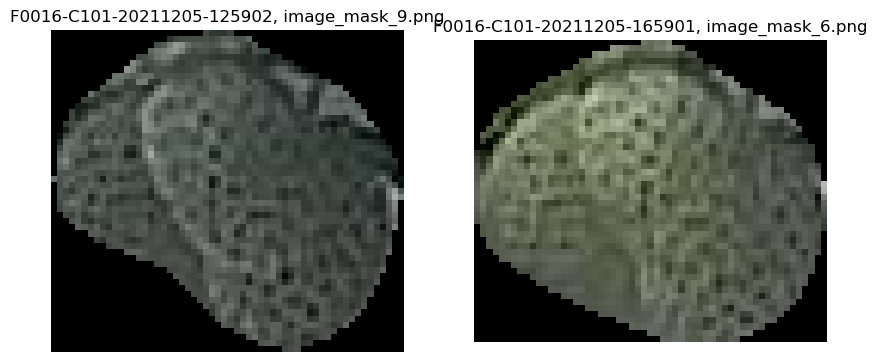

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211205-125902
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211205-075903
mask_num_x                                 F0016-C101-20211205-125902_10
mask_id                                 c77a3b768fd16dcd791cc76344b859e1
point_x_x                                                    1090.365967
point_y_x                                                     346.669495
output_image_path_x                                    image_mask_10.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211205-165901
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

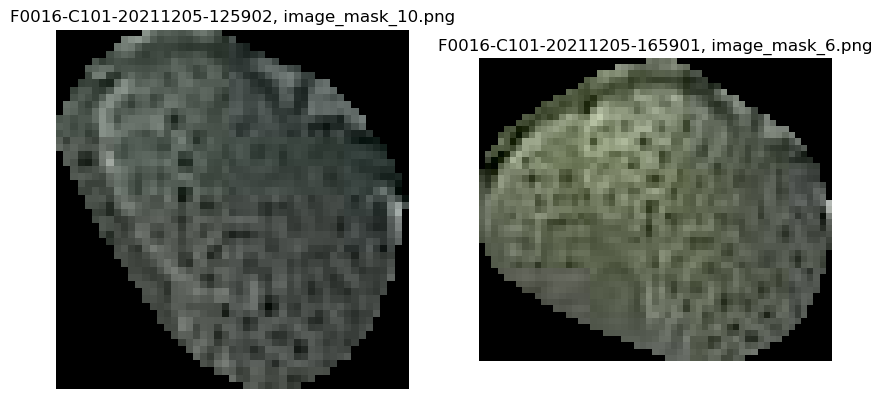

In [50]:
def visualize_mask(df_row, base_folder):
    input_img_name_x = df_row['input_image_name_x']  # 이미지 파일명 가져오기
    input_img_name_y = df_row["input_image_name_y"]

    farm_code_x = df_row["farm_code_x"]
    farm_code_y = df_row["farm_code_y"]
    
    area_code_x = df_row["area_code_x"]
    area_code_y = df_row["area_code_y"]
    
    
    mask_id_x = df_row['output_image_path_x']  # Mask ID 가져오기
    mask_id_y = df_row["output_image_path_y"]
    
    base_folder_x = base_folder + farm_code_x + "/" + area_code_x + "/" + input_img_name_x + "/masks/"
    base_folder_y = base_folder + farm_code_y + "/" + area_code_y + "/" + input_img_name_y + "/masks/"

    # 이미지 파일 경로 생성
    mask_path_x = os.path.join(base_folder_x, mask_id_x)
    mask_path_y = os.path.join(base_folder_y, mask_id_y)

    # 이미지 및 마스크 불러오기
    mask_x = cv2.imread(mask_path_x)
    mask_y = cv2.imread(mask_path_y)

    # 이미지 및 마스크 시각화
    plt.figure(figsize=(10, 5))
    plt.subplot(1, 2, 1)
    plt.imshow(cv2.cvtColor(mask_x, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_x}, {mask_id_x}')
    plt.axis('off')

    plt.subplot(1, 2, 2)
    plt.imshow(cv2.cvtColor(mask_y, cv2.COLOR_BGR2RGB))
    plt.title(f'{input_img_name_y}, {mask_id_y}')
    plt.axis('off')

    plt.show()

# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                  F0016-C101-20211211-083000_8
mask_id                                 24483e0a3d4161ad857b60fa1278f4af
point_x_x                                                     991.229614
point_y_x                                                     369.821838
output_image_path_x                                     image_mask_8.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

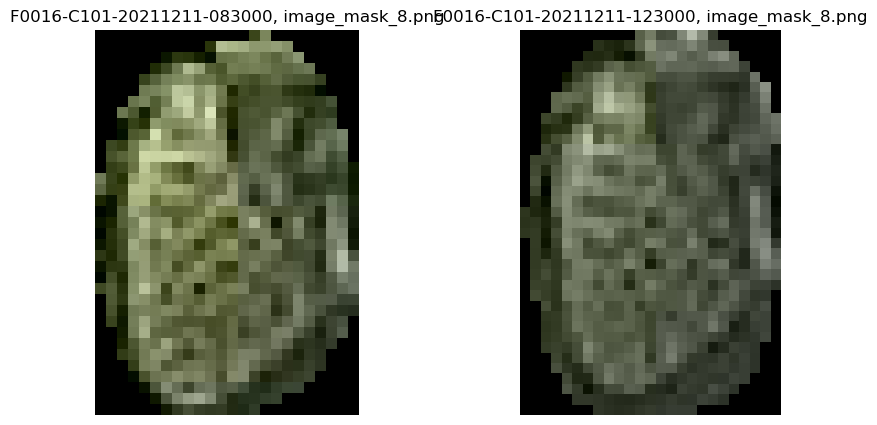

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                 F0016-C101-20211211-083000_17
mask_id                                 37e6aff27c0b265ed358a1c1d1442600
point_x_x                                                    2005.931885
point_y_x                                                     235.190781
output_image_path_x                                    image_mask_17.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

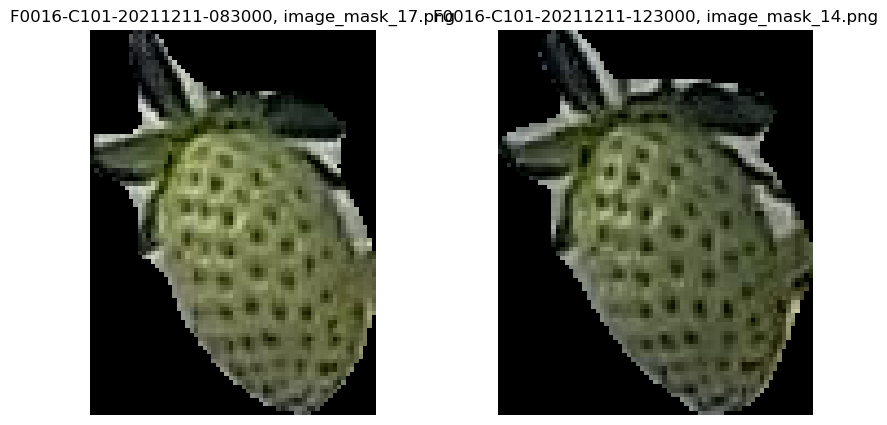

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                  F0016-C101-20211211-083000_4
mask_id                                 47d29dfcc561a2535308696c7b0bac81
point_x_x                                                    1115.949707
point_y_x                                                     369.748962
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

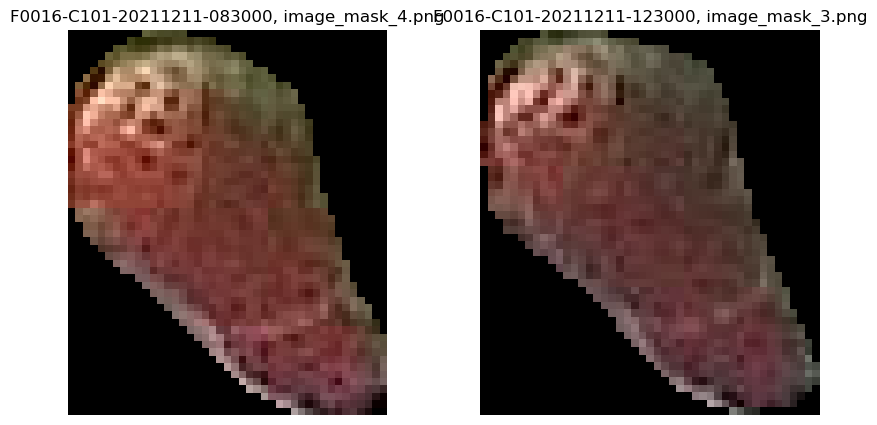

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                 F0016-C101-20211211-083000_14
mask_id                                 6e9ec94ca83c4c5be463743e0d987442
point_x_x                                                    1752.594116
point_y_x                                                     167.877075
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

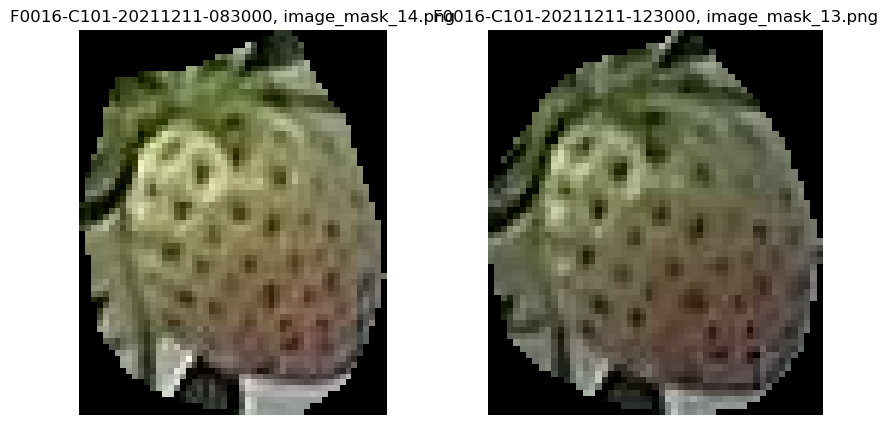

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                 F0016-C101-20211211-083000_15
mask_id                                 6e9ec94ca83c4c5be463743e0d987442
point_x_x                                                    1758.179932
point_y_x                                                     176.083862
output_image_path_x                                    image_mask_15.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

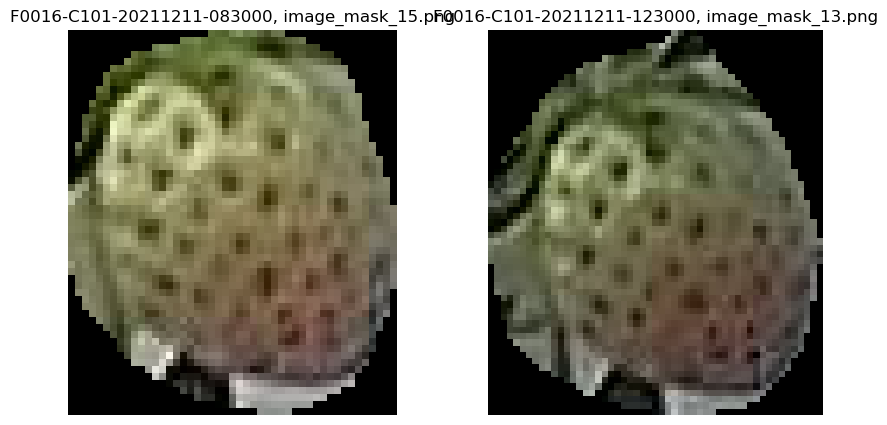

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                 F0016-C101-20211211-083000_12
mask_id                                 7dcf74371f1bbfd71b0cfbebb273bdbd
point_x_x                                                    1049.550781
point_y_x                                                     397.546753
output_image_path_x                                    image_mask_12.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

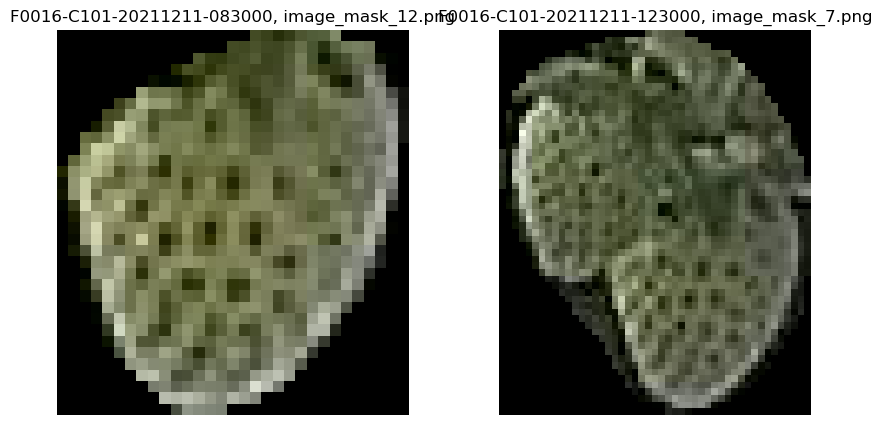

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                 F0016-C101-20211211-083000_12
mask_id                                 7dcf74371f1bbfd71b0cfbebb273bdbd
point_x_x                                                    1049.550781
point_y_x                                                     397.546753
output_image_path_x                                    image_mask_12.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

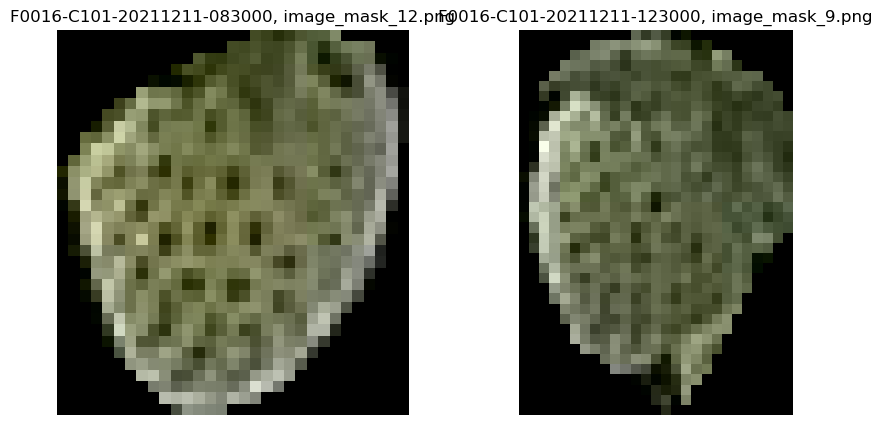

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                  F0016-C101-20211211-083000_2
mask_id                                 9790c5ada129349e5bf9f3228e4eaae9
point_x_x                                                     384.938721
point_y_x                                                     641.710938
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

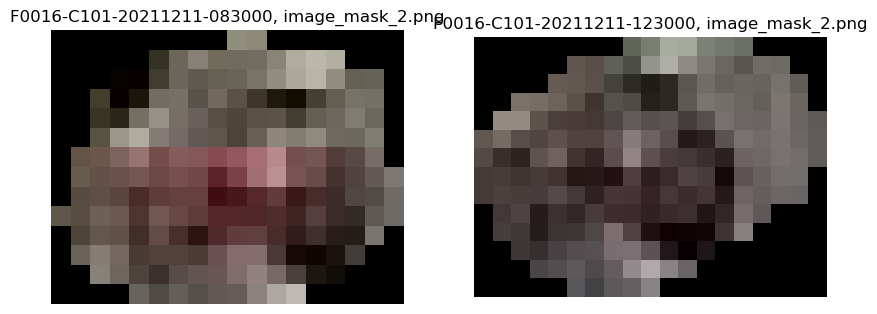

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                  F0016-C101-20211211-083000_7
mask_id                                 9f84ed447ef385f9d9d3b6e778b66251
point_x_x                                                    1097.695923
point_y_x                                                     315.622955
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

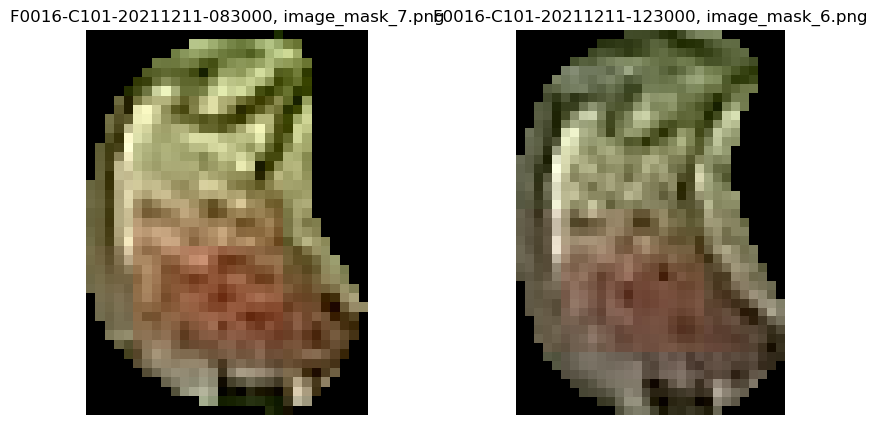

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                 F0016-C101-20211211-083000_13
mask_id                                 c0743485c9da0b624366c665fe9dd42f
point_x_x                                                    1739.549927
point_y_x                                                      225.63089
output_image_path_x                                    image_mask_13.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

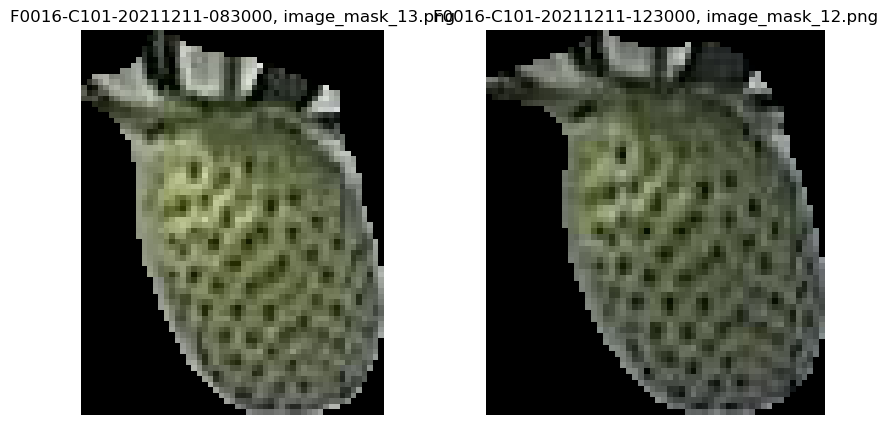

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                  F0016-C101-20211211-083000_5
mask_id                                 c77a3b768fd16dcd791cc76344b859e1
point_x_x                                                    1081.208984
point_y_x                                                        358.125
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

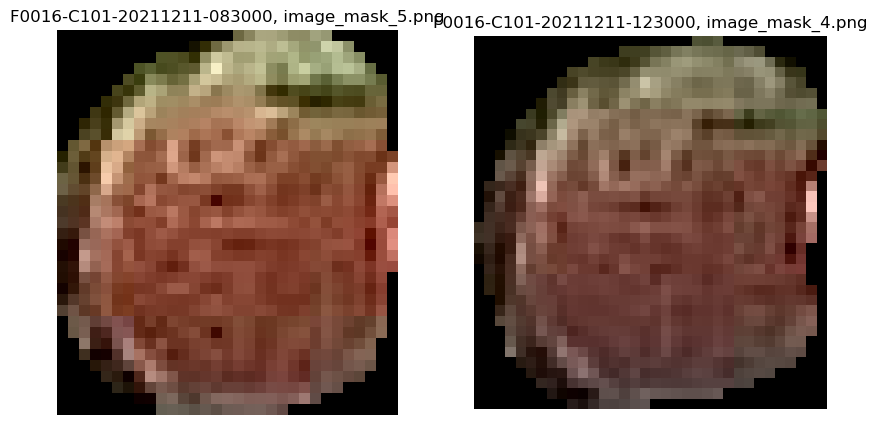

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211210-164600
mask_num_x                                  F0016-C101-20211211-083000_1
mask_id                                 d1a56c576f60253d648b35e6c407f087
point_x_x                                                     484.525146
point_y_x                                                      586.58075
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211211-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

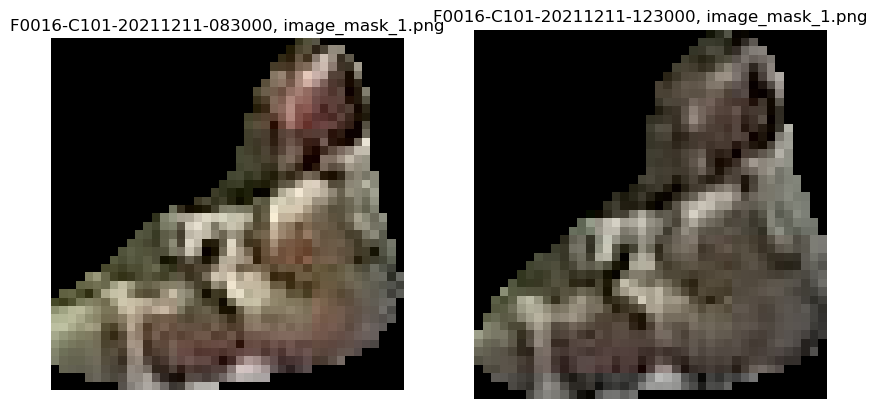

In [55]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                  F0016-C101-20211211-163100_4
mask_id                                 24483e0a3d4161ad857b60fa1278f4af
point_x_x                                                     992.765747
point_y_x                                                     373.119965
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

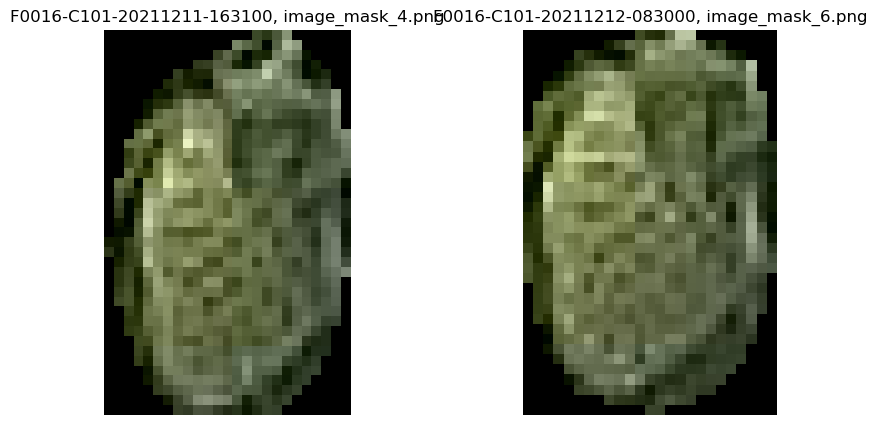

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                 F0016-C101-20211211-163100_13
mask_id                                 37e6aff27c0b265ed358a1c1d1442600
point_x_x                                                    2011.061646
point_y_x                                                     238.577133
output_image_path_x                                    image_mask_13.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

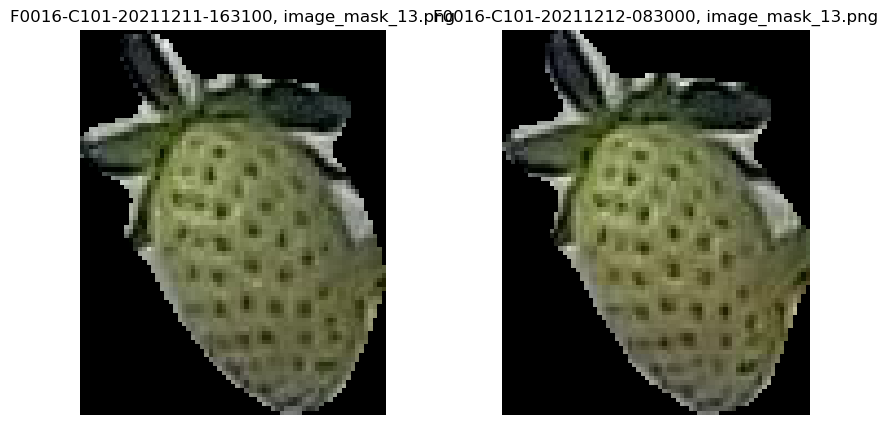

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                 F0016-C101-20211211-163100_10
mask_id                                 38a4fa43e63eba2eecfd322ed8d9b44f
point_x_x                                                    1050.088379
point_y_x                                                     400.382202
output_image_path_x                                    image_mask_10.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

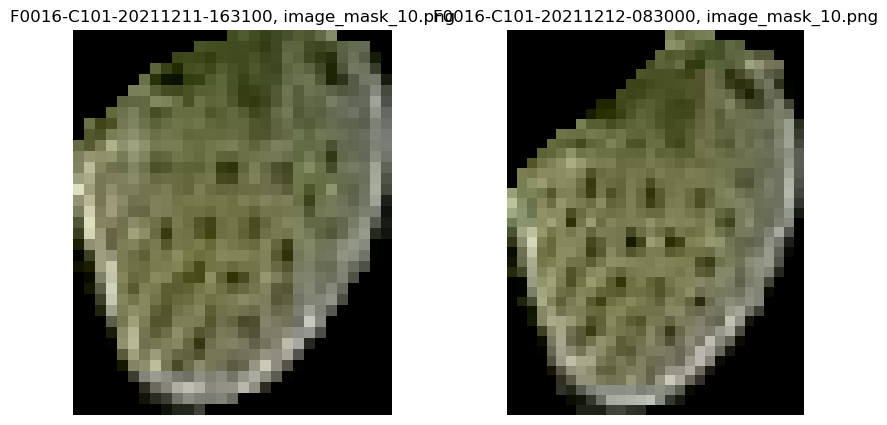

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                  F0016-C101-20211211-163100_7
mask_id                                 42098e2fd20eb553b621bfbed2c85b13
point_x_x                                                    1272.220337
point_y_x                                                     530.832092
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

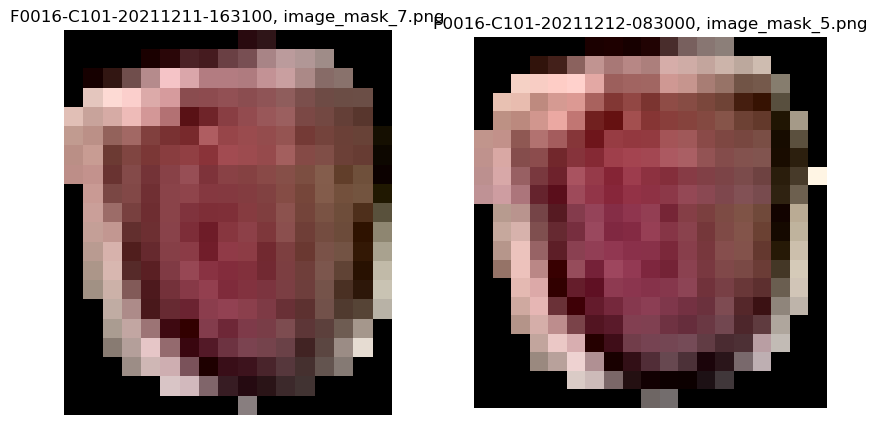

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                 F0016-C101-20211211-163100_12
mask_id                                 6e9ec94ca83c4c5be463743e0d987442
point_x_x                                                    1758.114746
point_y_x                                                     173.674591
output_image_path_x                                    image_mask_12.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

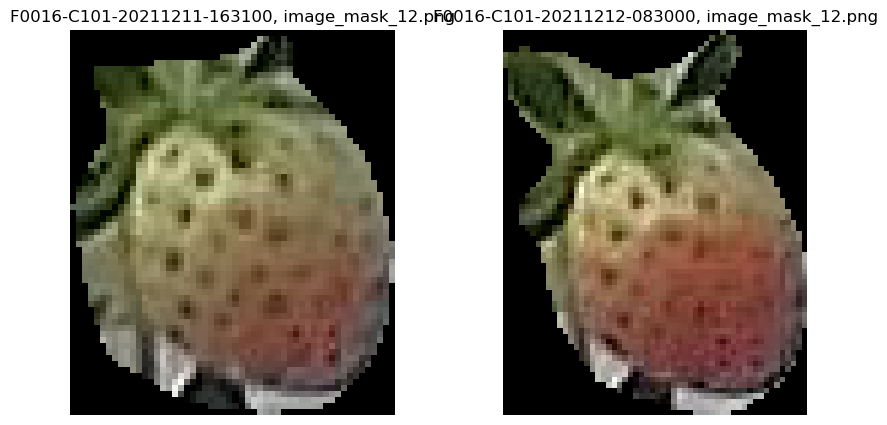

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                  F0016-C101-20211211-163100_8
mask_id                                 7dcf74371f1bbfd71b0cfbebb273bdbd
point_x_x                                                    1042.128784
point_y_x                                                     388.040436
output_image_path_x                                     image_mask_8.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

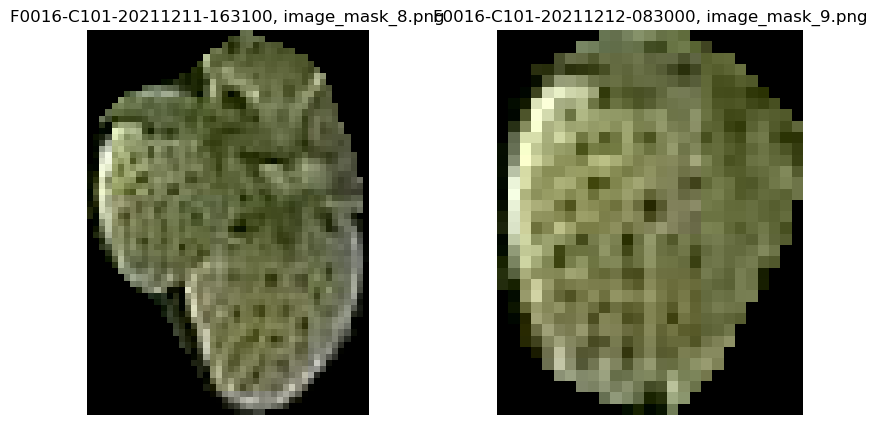

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                  F0016-C101-20211211-163100_9
mask_id                                 7dcf74371f1bbfd71b0cfbebb273bdbd
point_x_x                                                    1034.078735
point_y_x                                                     383.479858
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

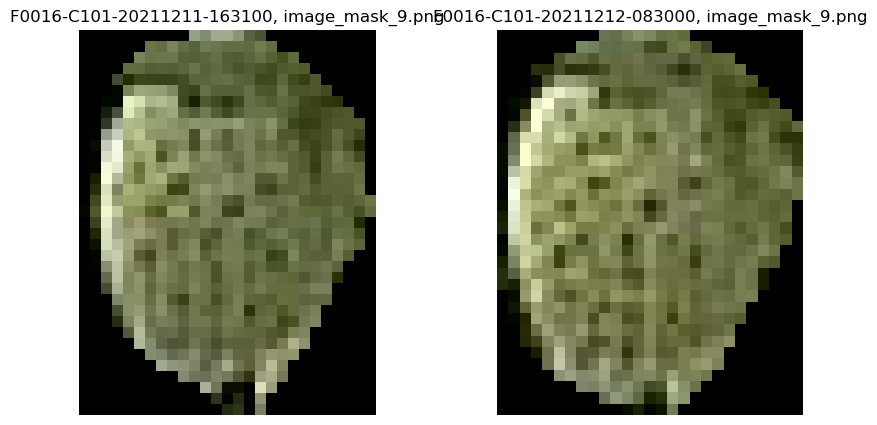

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                  F0016-C101-20211211-163100_5
mask_id                                 894de37d1029d6fb834a229bf1f2a1f8
point_x_x                                                    1118.626343
point_y_x                                                     317.052826
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

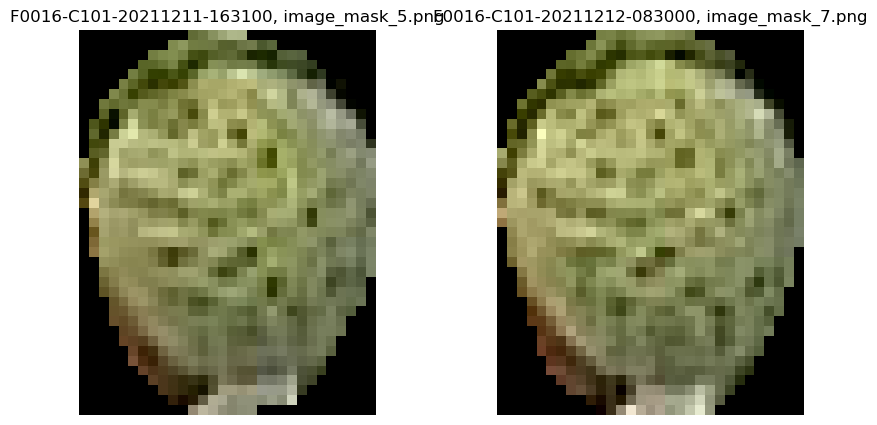

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                 F0016-C101-20211211-163100_14
mask_id                                 8e16cd44354806d04ca5fc6450e86da3
point_x_x                                                    2072.398193
point_y_x                                                     248.672836
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

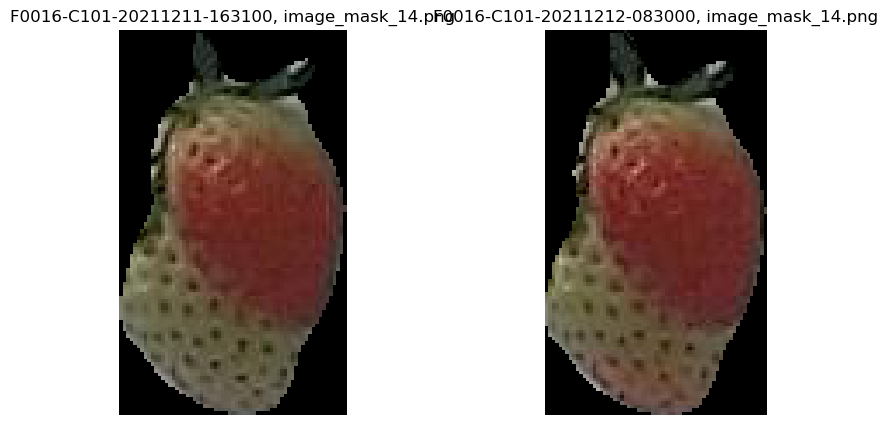

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                  F0016-C101-20211211-163100_6
mask_id                                 9f84ed447ef385f9d9d3b6e778b66251
point_x_x                                                     1097.45166
point_y_x                                                     319.633392
output_image_path_x                                     image_mask_6.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

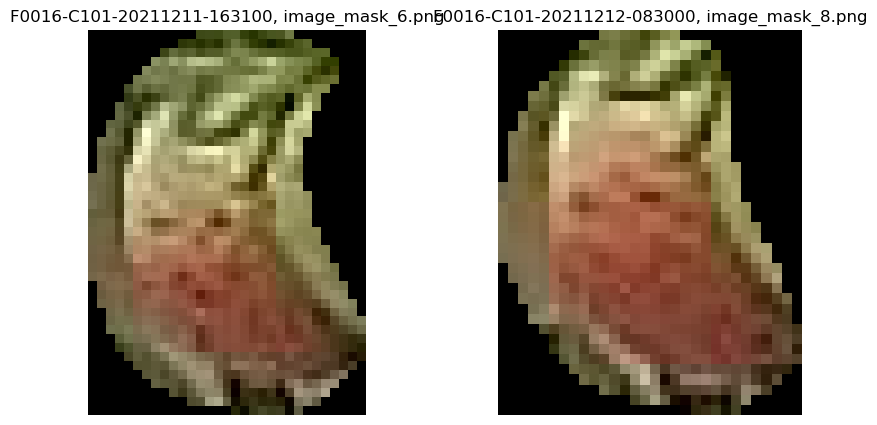

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                 F0016-C101-20211211-163100_11
mask_id                                 c0743485c9da0b624366c665fe9dd42f
point_x_x                                                    1743.803467
point_y_x                                                     231.009583
output_image_path_x                                    image_mask_11.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

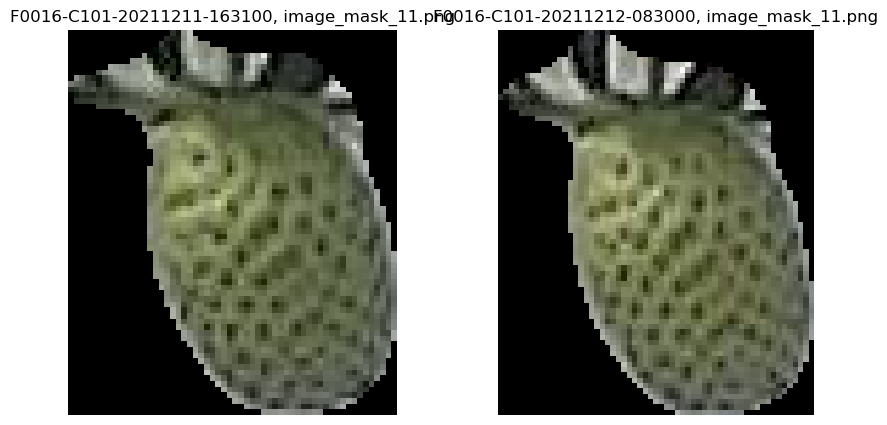

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                  F0016-C101-20211211-163100_3
mask_id                                 c77a3b768fd16dcd791cc76344b859e1
point_x_x                                                    1081.772705
point_y_x                                                     361.051941
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

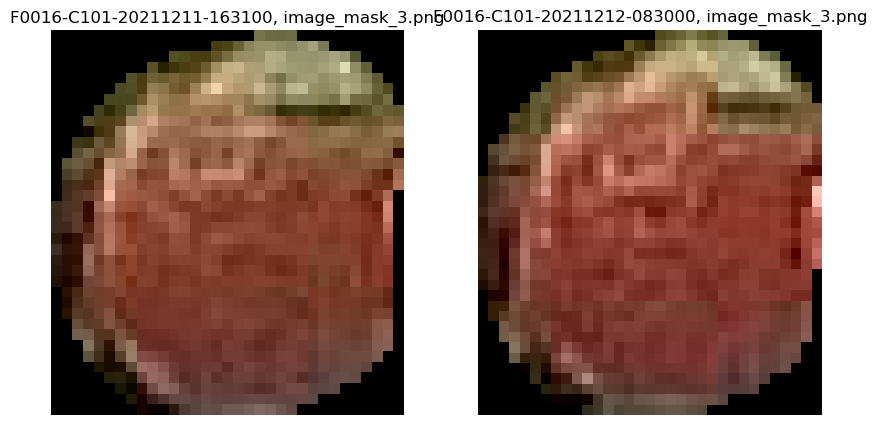

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                  F0016-C101-20211211-163100_1
mask_id                                 d1a56c576f60253d648b35e6c407f087
point_x_x                                                      488.53299
point_y_x                                                     589.004028
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

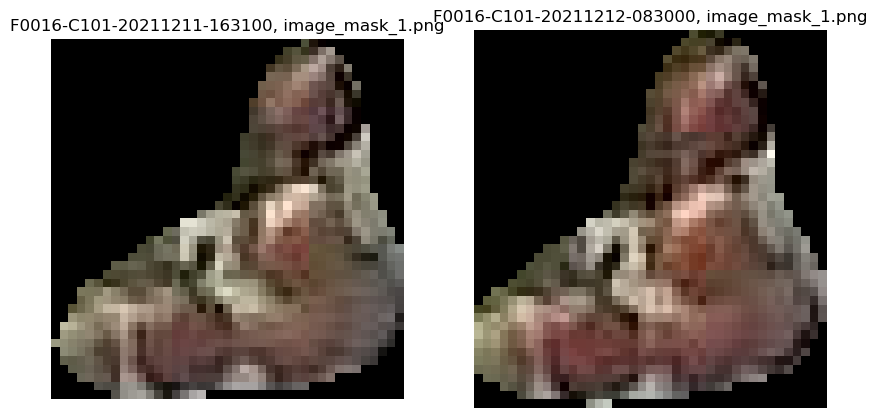

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20211211-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211211-123000
mask_num_x                                  F0016-C101-20211211-163100_1
mask_id                                 d1a56c576f60253d648b35e6c407f087
point_x_x                                                      488.53299
point_y_x                                                     589.004028
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20211212-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

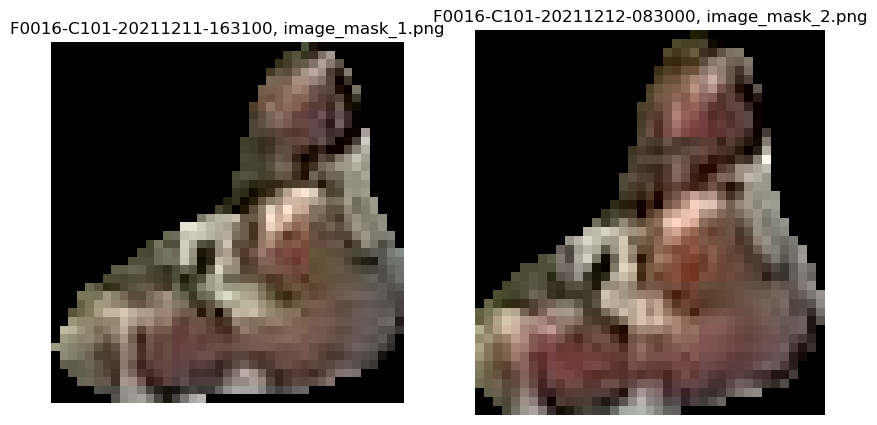

In [60]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220101-084500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211231-164800
mask_num_x                                  F0016-C101-20220101-084500_7
mask_id                                 71834d7b436cd49d6f895adf7b0d3169
point_x_x                                                    2019.727051
point_y_x                                                      12.256273
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220101-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

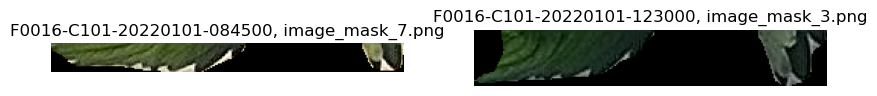

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220101-084500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211231-164800
mask_num_x                                  F0016-C101-20220101-084500_5
mask_id                                 7a29be654a41be88b33691e32feed145
point_x_x                                                    1569.173096
point_y_x                                                     134.546539
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220101-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

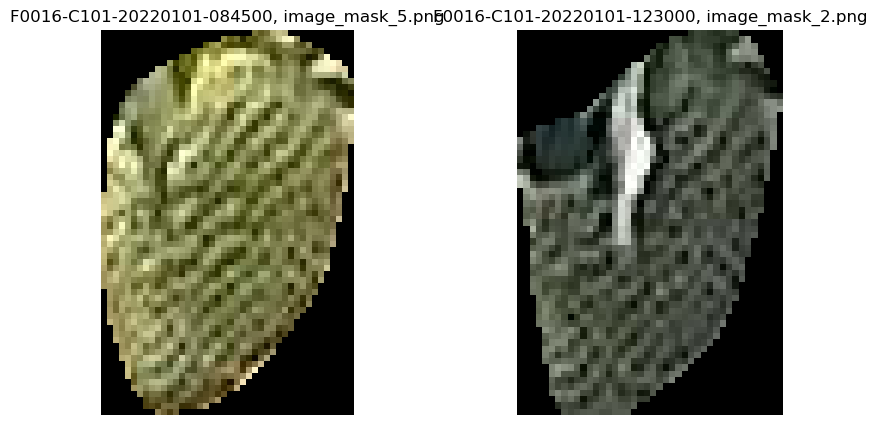

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220101-084500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20211231-164800
mask_num_x                                  F0016-C101-20220101-084500_6
mask_id                                 afef7894e81799f726d0c5a883a6b12f
point_x_x                                                    1751.081543
point_y_x                                                      46.144855
output_image_path_x                                     image_mask_6.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220101-123000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

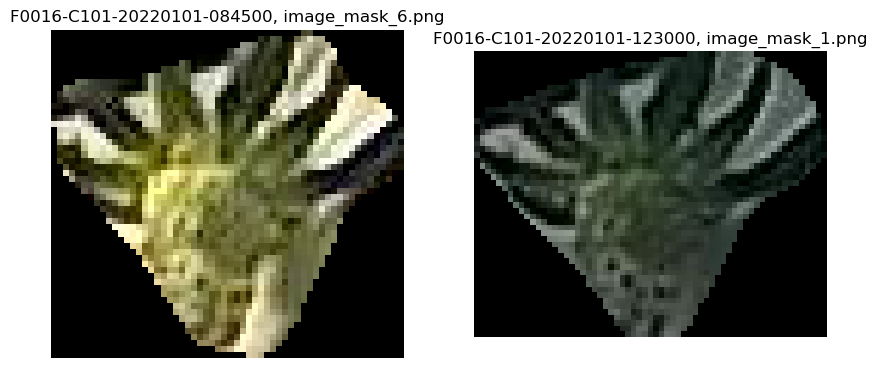

In [89]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220108-163000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220108-131500
mask_num_x                                  F0016-C101-20220108-163000_1
mask_id                                 29f47c9c502c616a5b9a3c941210bfd9
point_x_x                                                     514.113464
point_y_x                                                     150.762543
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220109-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

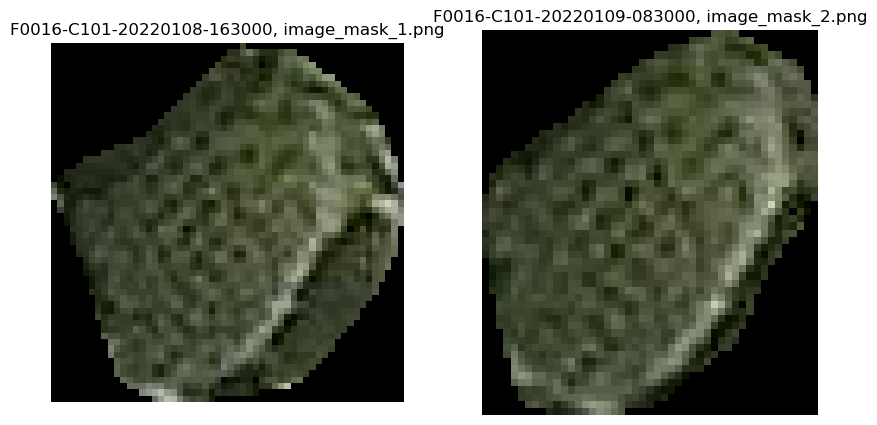

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220108-163000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220108-131500
mask_num_x                                  F0016-C101-20220108-163000_7
mask_id                                 341880194c7a8d16c3bff3200f43c5ea
point_x_x                                                     1656.29248
point_y_x                                                     190.717239
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220109-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

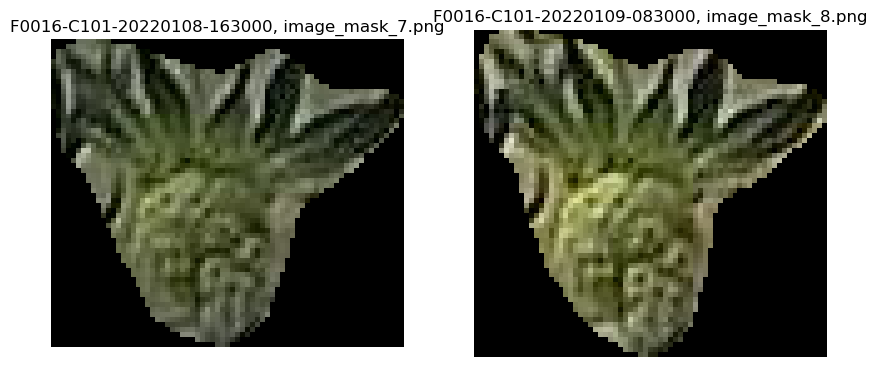

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220108-163000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220108-131500
mask_num_x                                  F0016-C101-20220108-163000_5
mask_id                                 40edf7e481ea2ef802420d3a837c60f5
point_x_x                                                    1002.938782
point_y_x                                                     302.913818
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220109-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

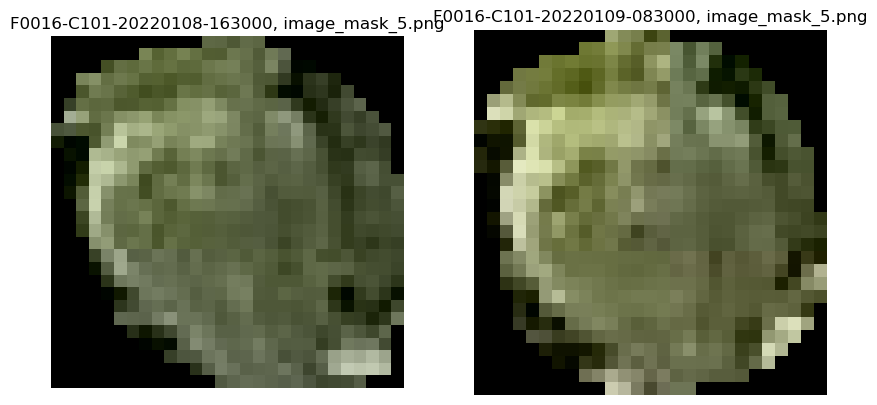

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220108-163000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220108-131500
mask_num_x                                  F0016-C101-20220108-163000_9
mask_id                                 971d06c85695c906eadb8f0fdac6d1ba
point_x_x                                                    1512.346558
point_y_x                                                     229.124573
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220109-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

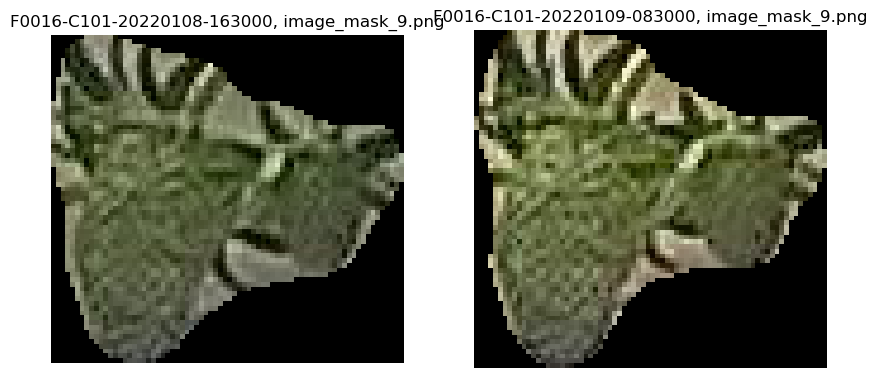

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220108-163000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220108-131500
mask_num_x                                  F0016-C101-20220108-163000_8
mask_id                                 99203b22b92de3fc34080a4d2c330a28
point_x_x                                                    1605.438843
point_y_x                                                     224.001007
output_image_path_x                                     image_mask_8.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220109-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

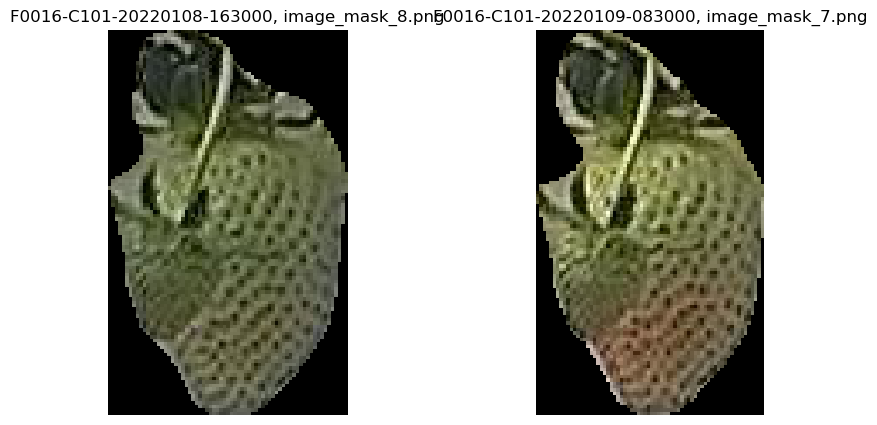

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220108-163000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220108-131500
mask_num_x                                  F0016-C101-20220108-163000_2
mask_id                                 a701a7b3fbce6893f6bb14c62302cc86
point_x_x                                                     422.871643
point_y_x                                                     109.026405
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220109-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

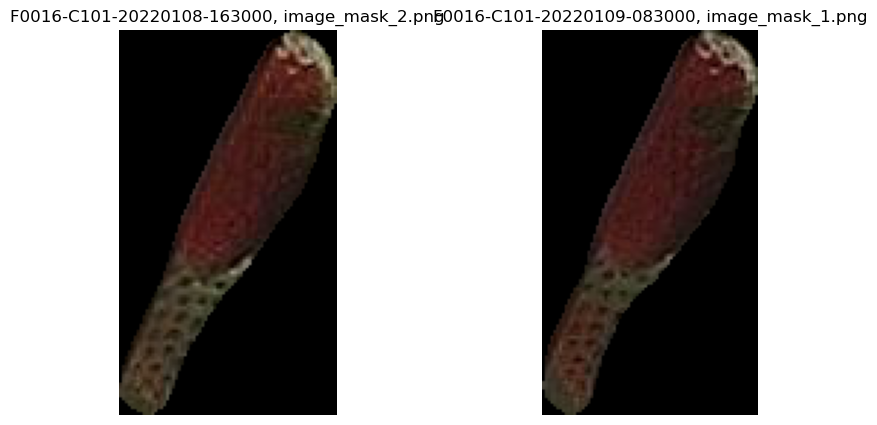

In [104]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                  F0016-C101-20220115-083000_2
mask_id                                 01574762d30ee73debd4f4db66265813
point_x_x                                                     283.473694
point_y_x                                                     515.731384
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

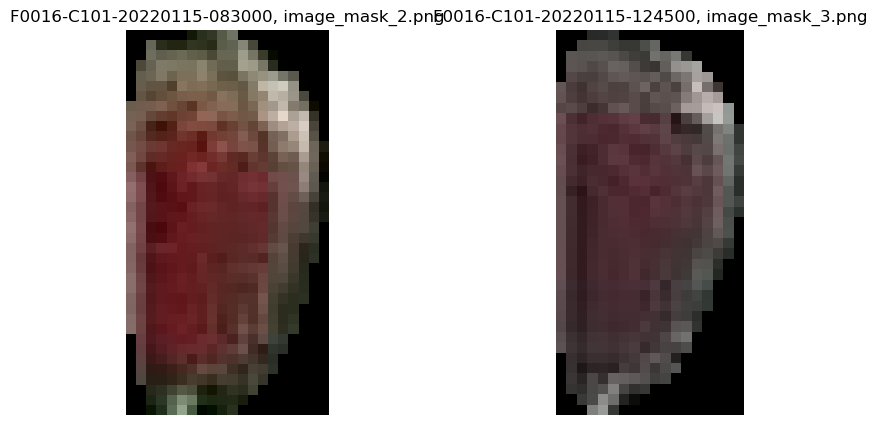

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_21
mask_id                                 029873338032abe5943f068a9abb8288
point_x_x                                                    1552.898804
point_y_x                                                       7.712876
output_image_path_x                                    image_mask_21.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

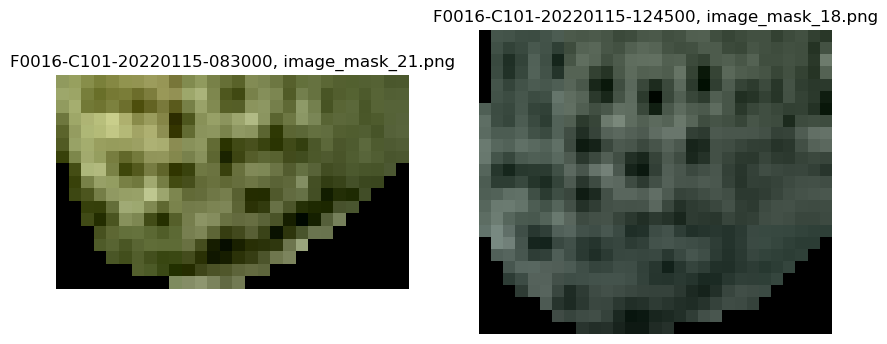

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                  F0016-C101-20220115-083000_4
mask_id                                 17803017b4d09f726495fcf2da023c96
point_x_x                                                      421.42395
point_y_x                                                     185.004257
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

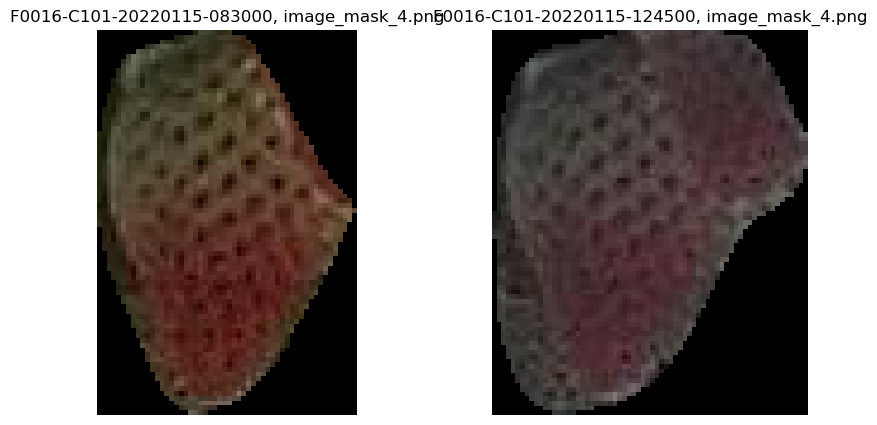

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                  F0016-C101-20220115-083000_1
mask_id                                 23009ae8ad48e62140105297cf267171
point_x_x                                                     547.497437
point_y_x                                                      29.361906
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

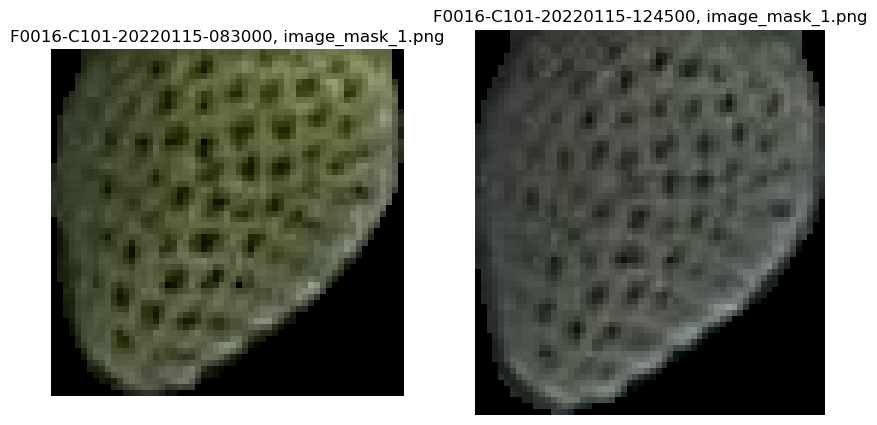

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                  F0016-C101-20220115-083000_6
mask_id                                 29b8a13c1b366dea1e8ad73656d38d22
point_x_x                                                     601.781372
point_y_x                                                      14.714314
output_image_path_x                                     image_mask_6.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

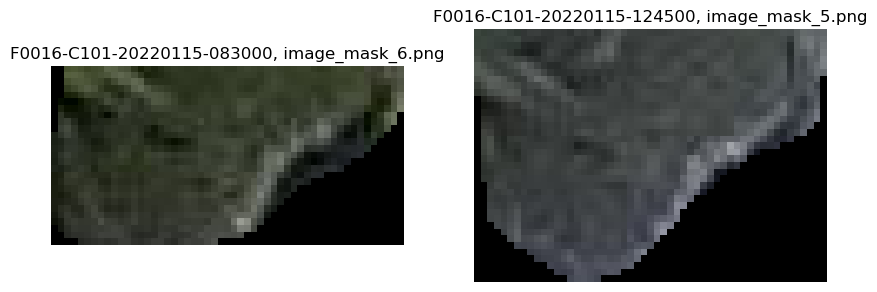

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_15
mask_id                                 2d598692fbcb925df8133e6ffa8e8b29
point_x_x                                                     1395.24292
point_y_x                                                     168.873322
output_image_path_x                                    image_mask_15.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

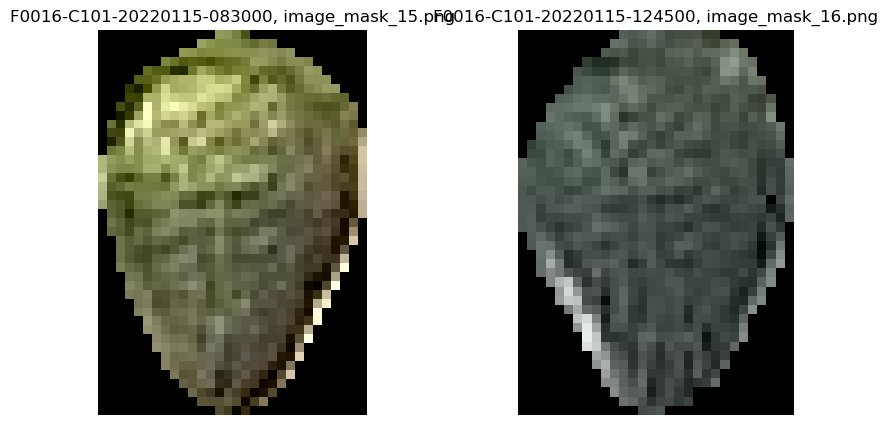

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                  F0016-C101-20220115-083000_9
mask_id                                 3fa2a50a9599dc6044fad2d318ae50e7
point_x_x                                                     695.550293
point_y_x                                                     649.596924
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

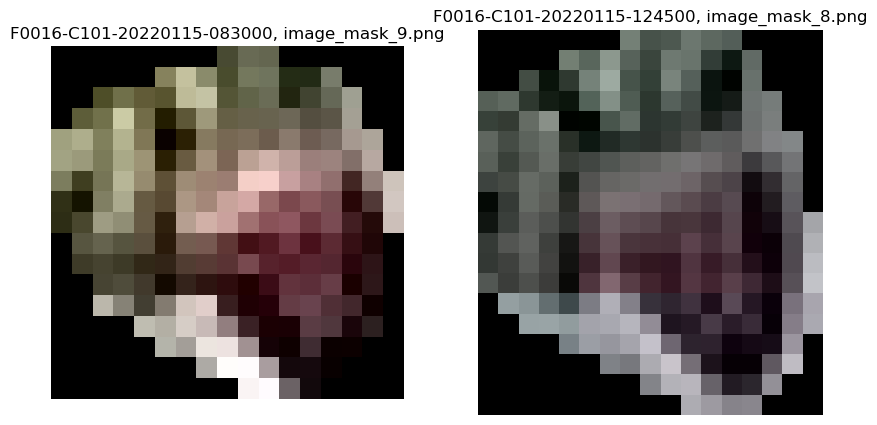

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_17
mask_id                                 714e4cd6b0753e7aacce077ea60083c8
point_x_x                                                    1437.927612
point_y_x                                                     142.349716
output_image_path_x                                    image_mask_17.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

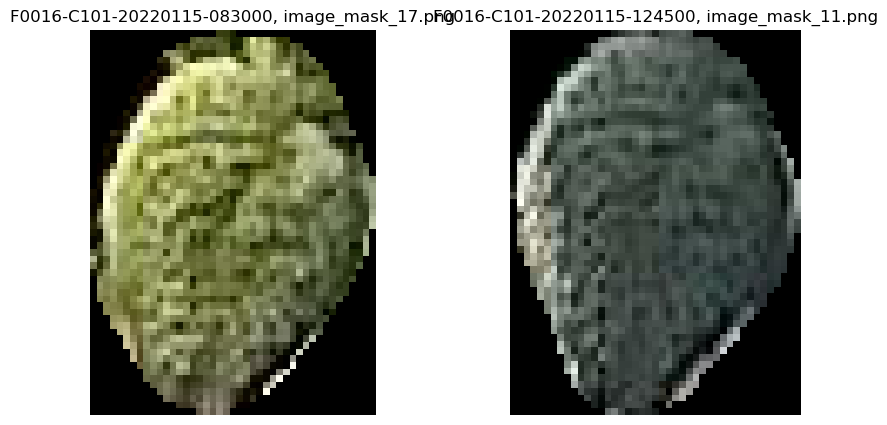

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_28
mask_id                                 71834d7b436cd49d6f895adf7b0d3169
point_x_x                                                    2041.381348
point_y_x                                                      35.568924
output_image_path_x                                    image_mask_28.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

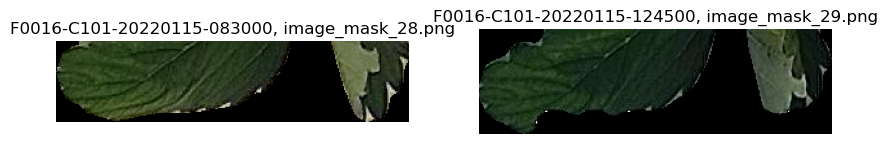

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                  F0016-C101-20220115-083000_8
mask_id                                 741deee37319e0b2ad496f3e3ee4e1bb
point_x_x                                                     884.437012
point_y_x                                                     620.860962
output_image_path_x                                     image_mask_8.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

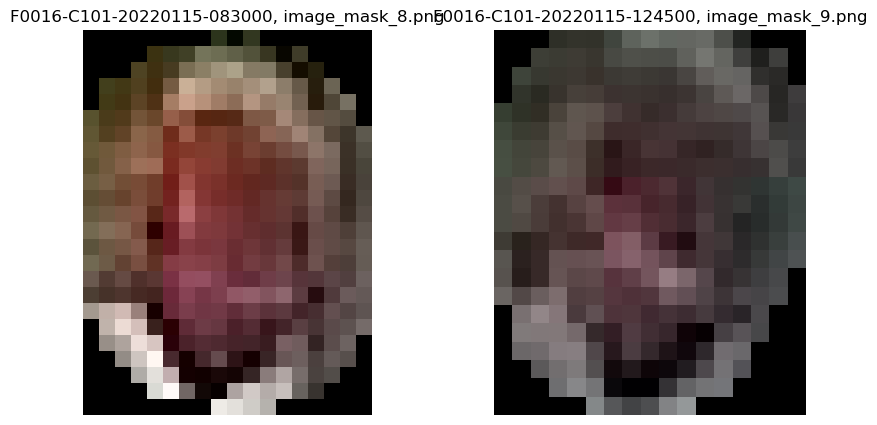

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_27
mask_id                                 877f8aa737e10814bed627017208d0f1
point_x_x                                                    1781.526733
point_y_x                                                      92.627846
output_image_path_x                                    image_mask_27.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

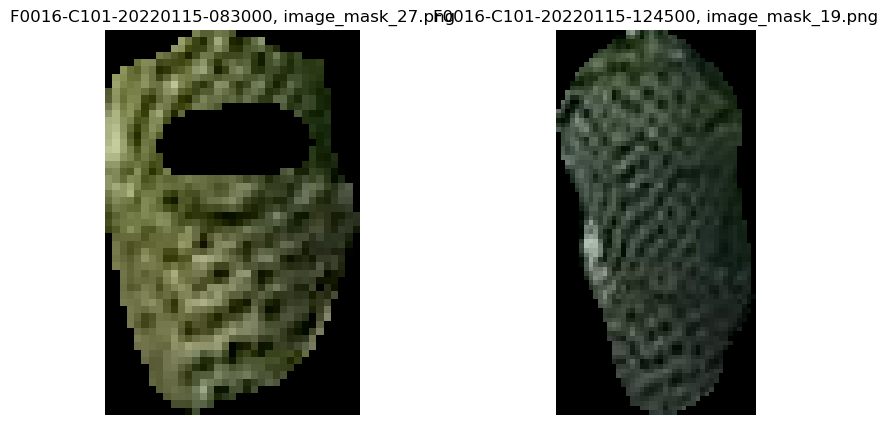

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_12
mask_id                                 94bf88bbca3ce07ff6bac70eaa5da03d
point_x_x                                                    1603.770508
point_y_x                                                     248.189026
output_image_path_x                                    image_mask_12.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

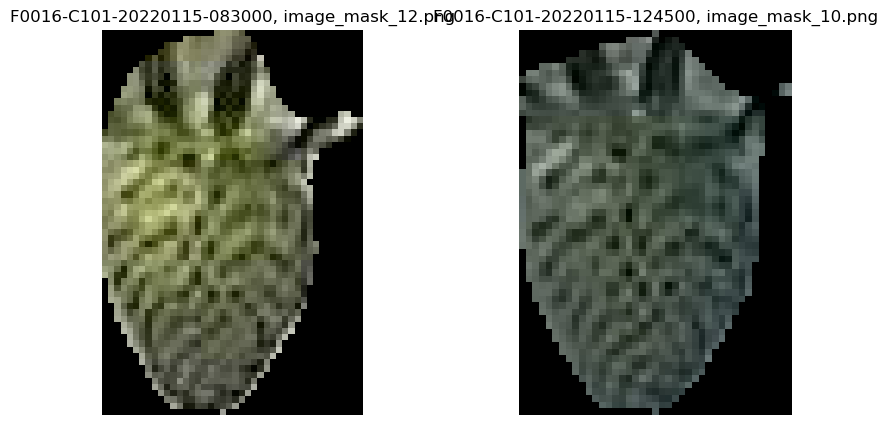

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_18
mask_id                                 971d06c85695c906eadb8f0fdac6d1ba
point_x_x                                                    1518.611084
point_y_x                                                     250.870743
output_image_path_x                                    image_mask_18.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

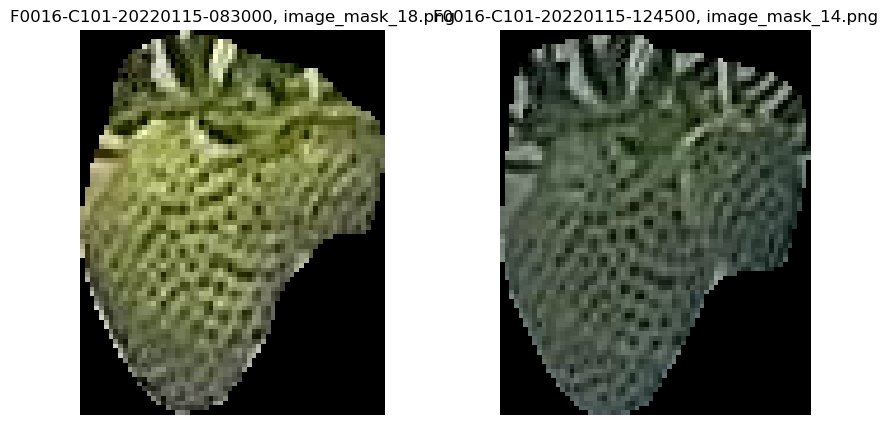

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_18
mask_id                                 971d06c85695c906eadb8f0fdac6d1ba
point_x_x                                                    1518.611084
point_y_x                                                     250.870743
output_image_path_x                                    image_mask_18.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

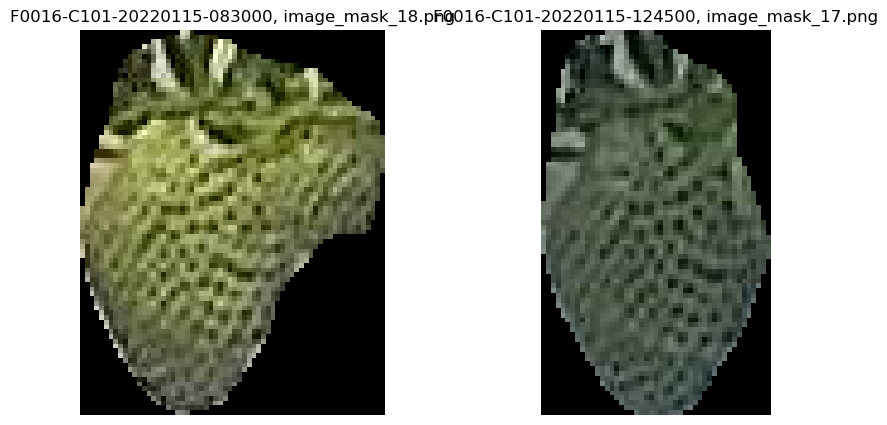

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_26
mask_id                                 971d06c85695c906eadb8f0fdac6d1ba
point_x_x                                                    1527.078979
point_y_x                                                     250.468231
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

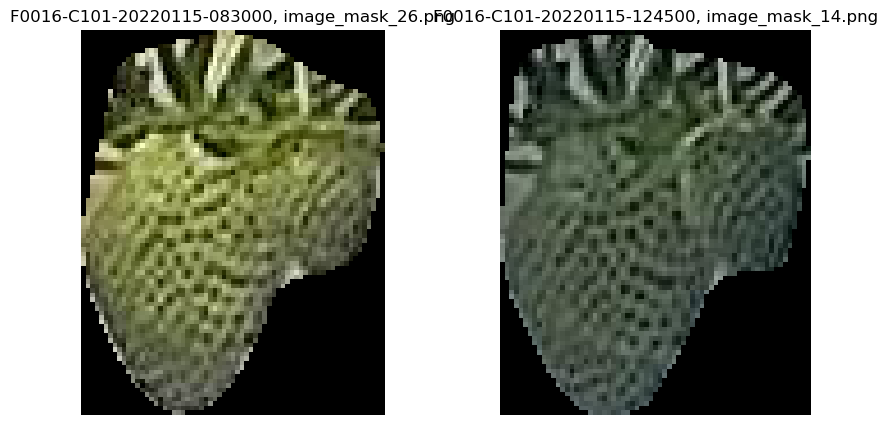

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_26
mask_id                                 971d06c85695c906eadb8f0fdac6d1ba
point_x_x                                                    1527.078979
point_y_x                                                     250.468231
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

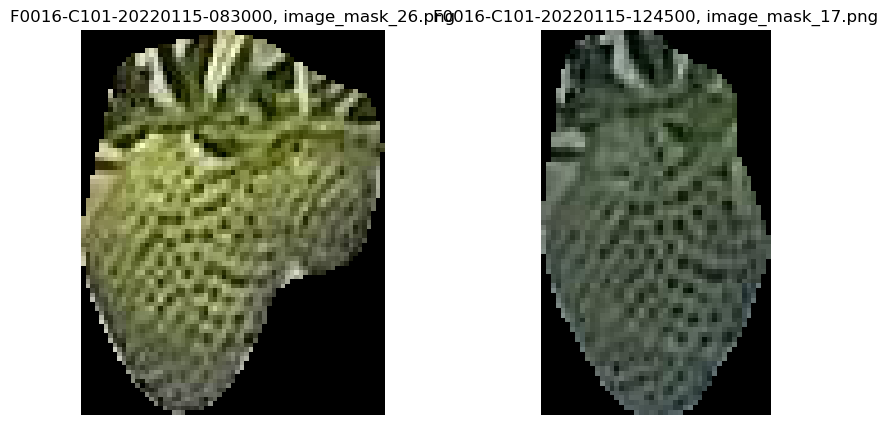

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                  F0016-C101-20220115-083000_5
mask_id                                 9c292a2940c1335cf8452d7be93b7ae6
point_x_x                                                     523.136597
point_y_x                                                     111.033829
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

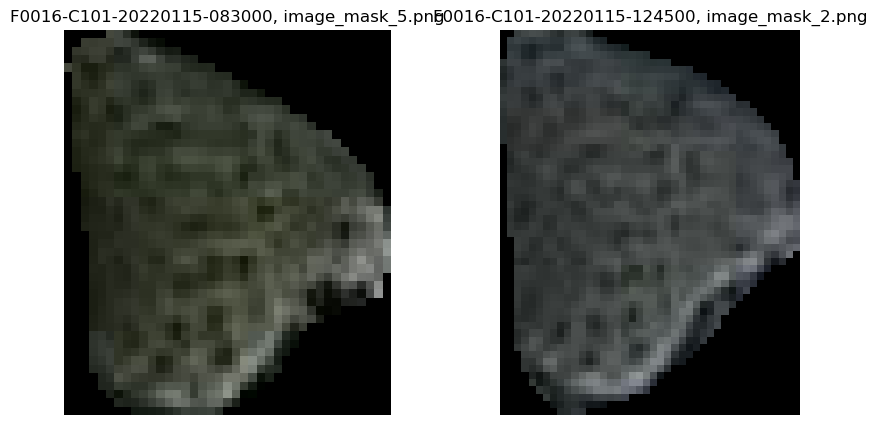

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_24
mask_id                                 c9d5b0ff284aa926dcc8105a57e6c702
point_x_x                                                    1367.664062
point_y_x                                                      138.33252
output_image_path_x                                    image_mask_24.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

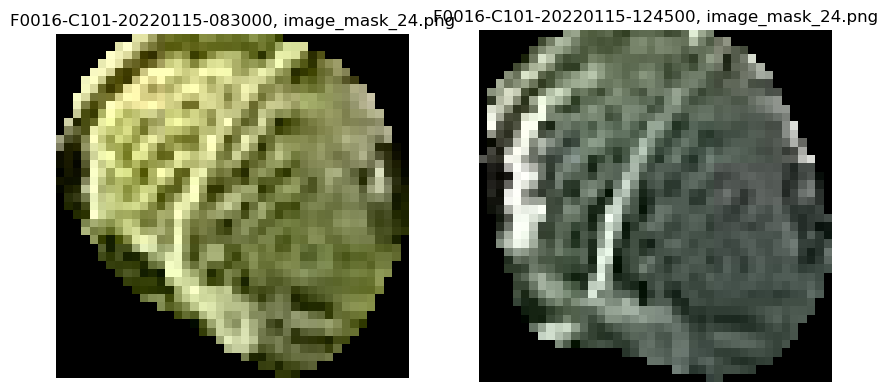

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_25
mask_id                                 e2f81dd5558eff0dc08a58d45fcba81a
point_x_x                                                    1546.521851
point_y_x                                                        239.638
output_image_path_x                                    image_mask_25.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

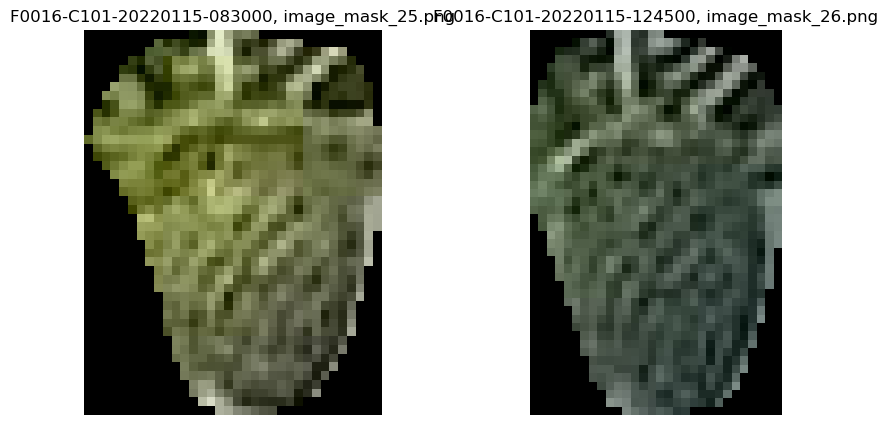

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_22
mask_id                                 f265ef0d690582f863183d6d183ac069
point_x_x                                                    1486.877197
point_y_x                                                      51.473625
output_image_path_x                                    image_mask_22.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

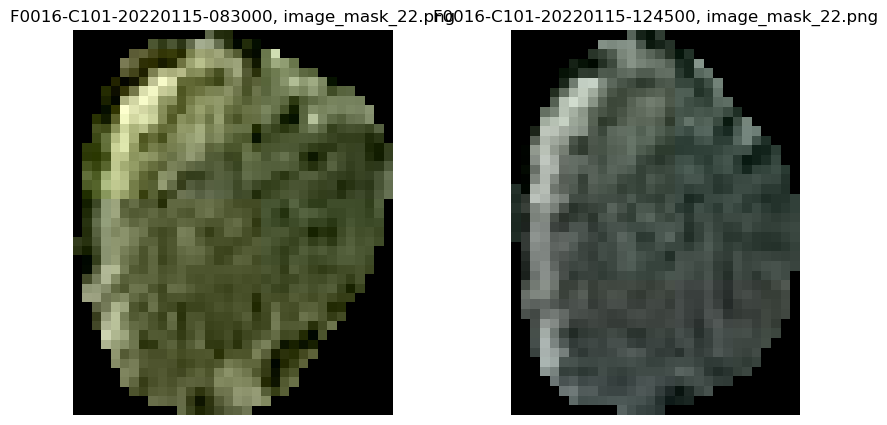

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220115-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220114-163000
mask_num_x                                 F0016-C101-20220115-083000_20
mask_id                                 f7e54b26fd84e2b8e0ed3e23f062c4fe
point_x_x                                                    1520.694092
point_y_x                                                      82.621552
output_image_path_x                                    image_mask_20.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220115-124500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

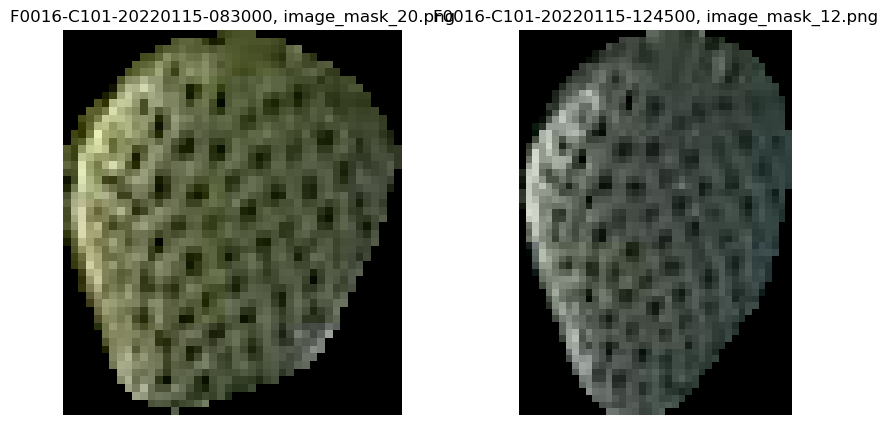

In [111]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                  F0016-C101-20220116-124600_3
mask_id                                 01574762d30ee73debd4f4db66265813
point_x_x                                                     280.136658
point_y_x                                                     521.945801
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

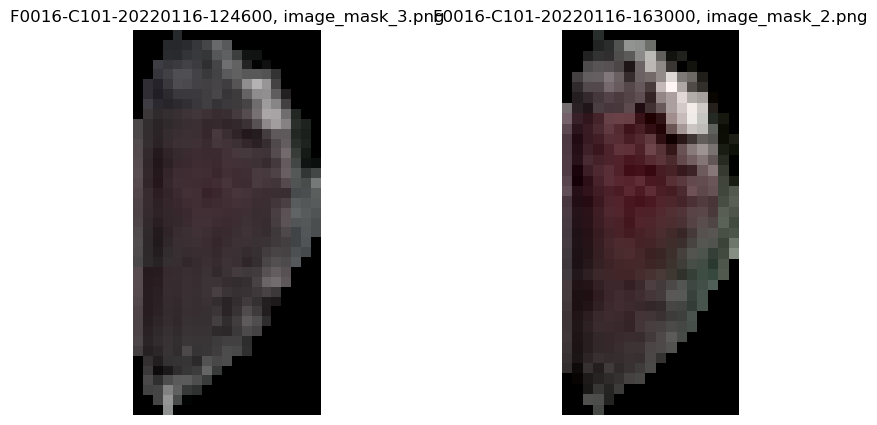

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_25
mask_id                                 0232d2ae09202c834d5dea9852ed2294
point_x_x                                                    1502.956543
point_y_x                                                      71.848747
output_image_path_x                                    image_mask_25.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

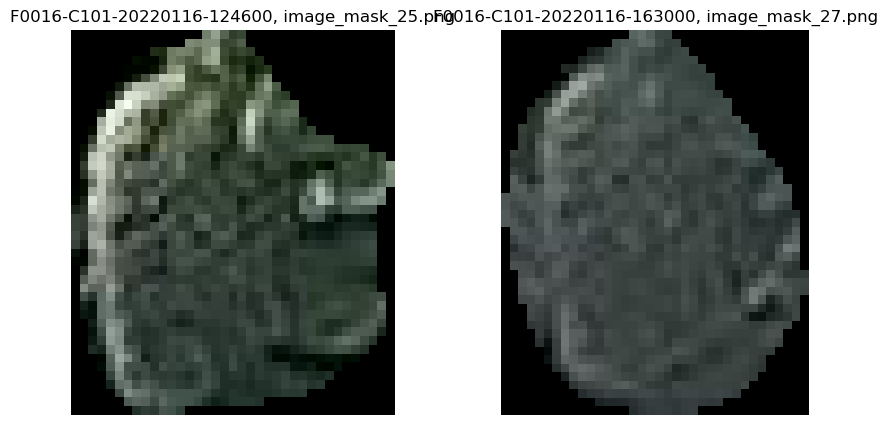

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_17
mask_id                                 029873338032abe5943f068a9abb8288
point_x_x                                                    1558.024658
point_y_x                                                      22.700333
output_image_path_x                                    image_mask_17.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

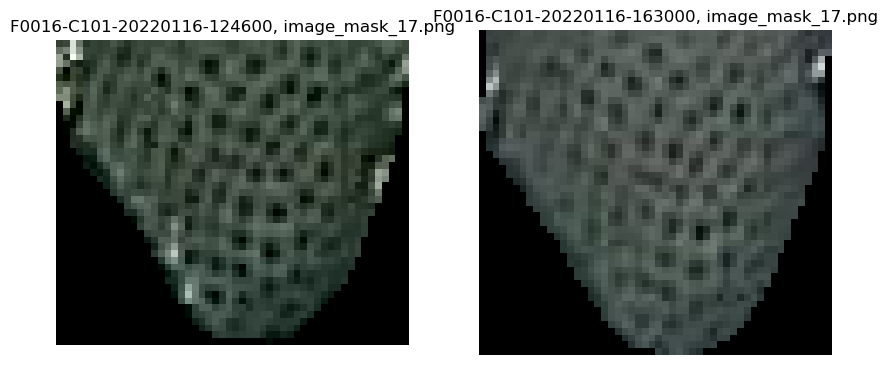

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_21
mask_id                                 03b4ad2d641ebc2619e9b21eea73c53a
point_x_x                                                    1795.217529
point_y_x                                                     106.303604
output_image_path_x                                    image_mask_21.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

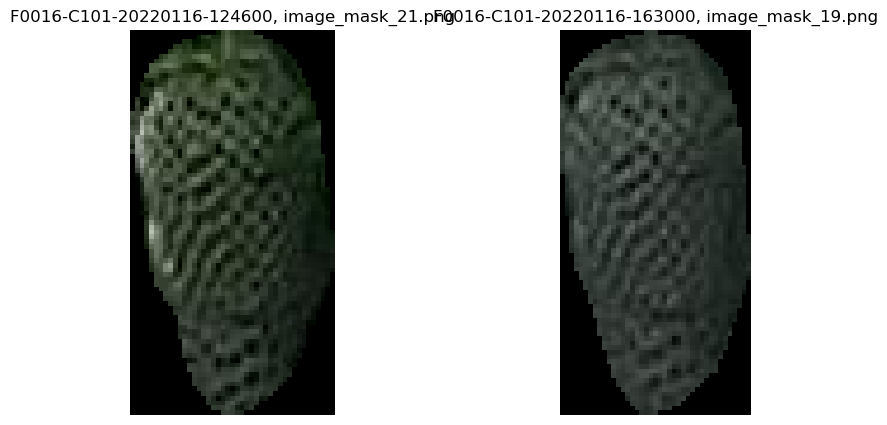

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_24
mask_id                                 12090d137b987ae1b5e9b658a80eef5c
point_x_x                                                    1821.990723
point_y_x                                                      20.307989
output_image_path_x                                    image_mask_24.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

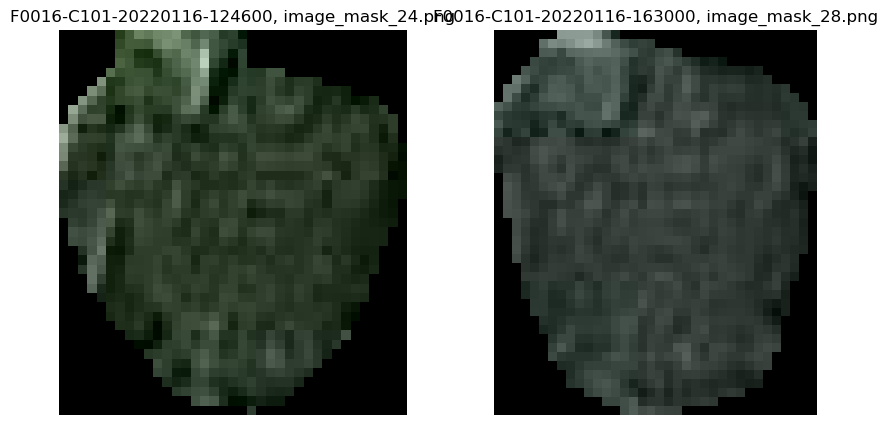

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                  F0016-C101-20220116-124600_5
mask_id                                 17803017b4d09f726495fcf2da023c96
point_x_x                                                     413.667358
point_y_x                                                     191.136139
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

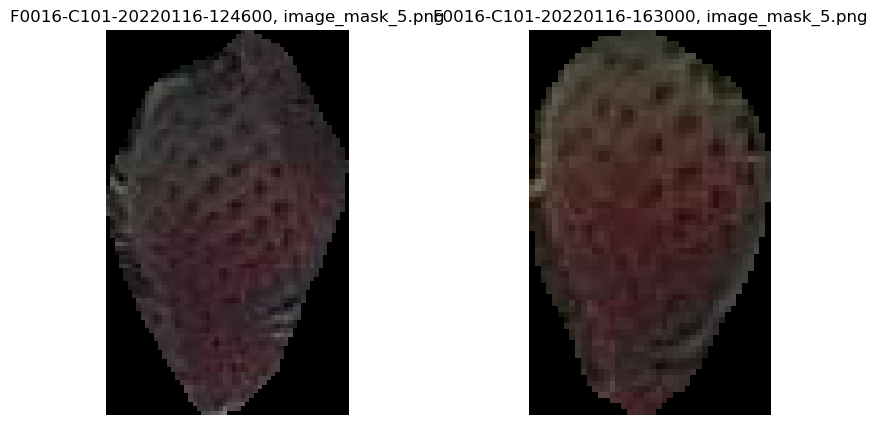

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_12
mask_id                                 1a644a40cf483330a7825a2410137fdf
point_x_x                                                    1249.331665
point_y_x                                                     208.485199
output_image_path_x                                    image_mask_12.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

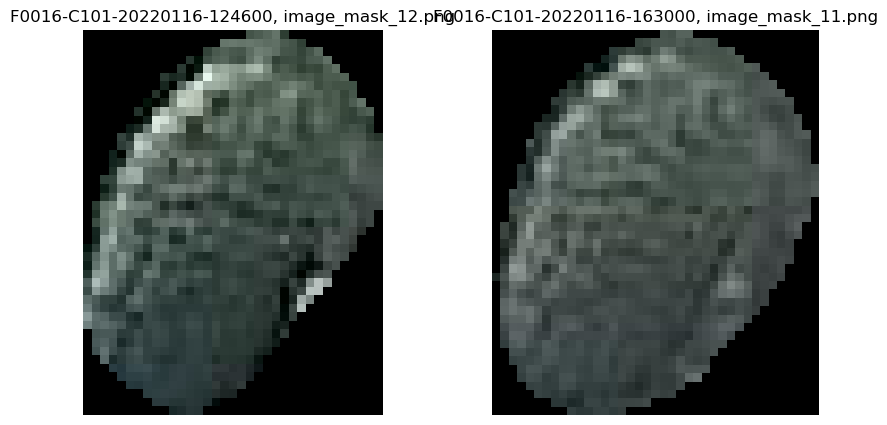

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_23
mask_id                                 1b75ccc12c15aada9736fc02d82e1f94
point_x_x                                                    1859.912109
point_y_x                                                      23.902044
output_image_path_x                                    image_mask_23.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

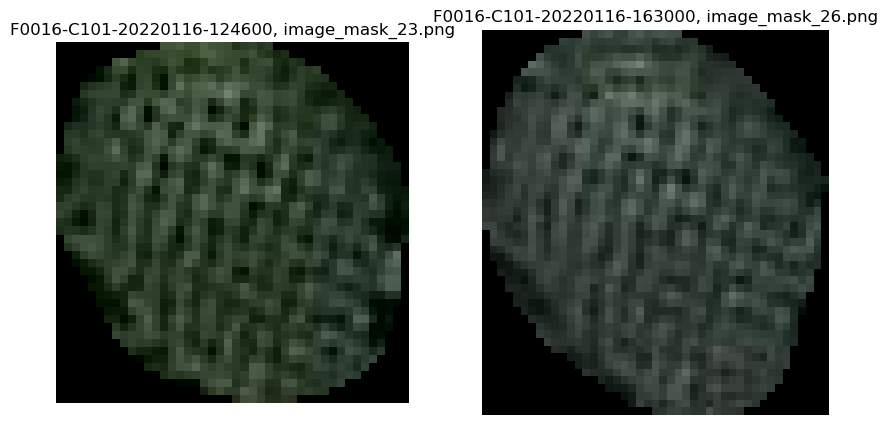

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_20
mask_id                                 277310af2ecf050d8a91a18d4fb448d2
point_x_x                                                    1377.933105
point_y_x                                                     178.809845
output_image_path_x                                    image_mask_20.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

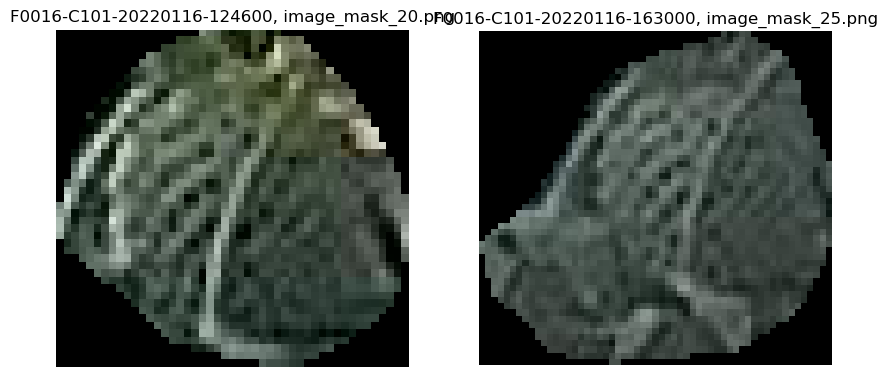

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_30
mask_id                                 335e77ee84bf4993d60328fee8ff42bd
point_x_x                                                    2040.970459
point_y_x                                                      47.428047
output_image_path_x                                    image_mask_30.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

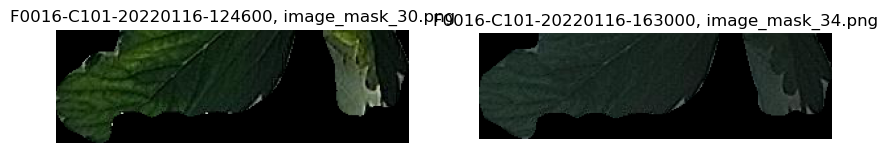

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_29
mask_id                                 3eff761e4aef7098d7838dce2a29711e
point_x_x                                                    1482.744141
point_y_x                                                     173.914185
output_image_path_x                                    image_mask_29.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

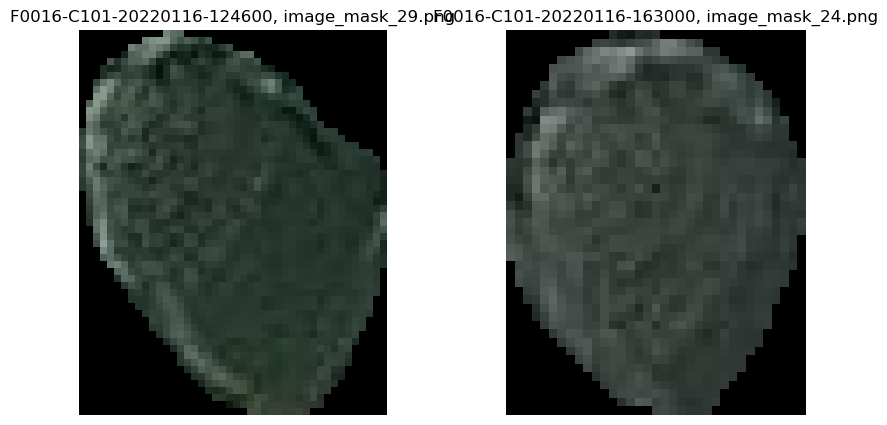

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                  F0016-C101-20220116-124600_4
mask_id                                 489b35d10d75cbf385e597c3dade4527
point_x_x                                                     487.818115
point_y_x                                                     194.428711
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

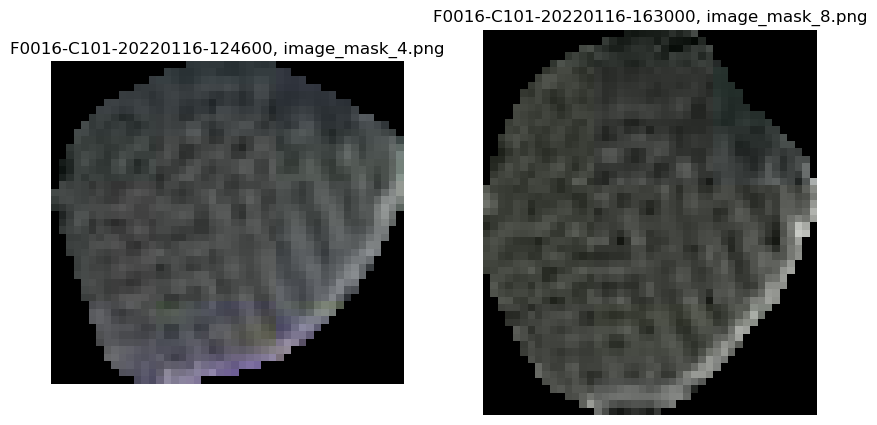

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_19
mask_id                                 4f10806263ea7e44befc38d8dcb596e0
point_x_x                                                    1833.852905
point_y_x                                                     102.891655
output_image_path_x                                    image_mask_19.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

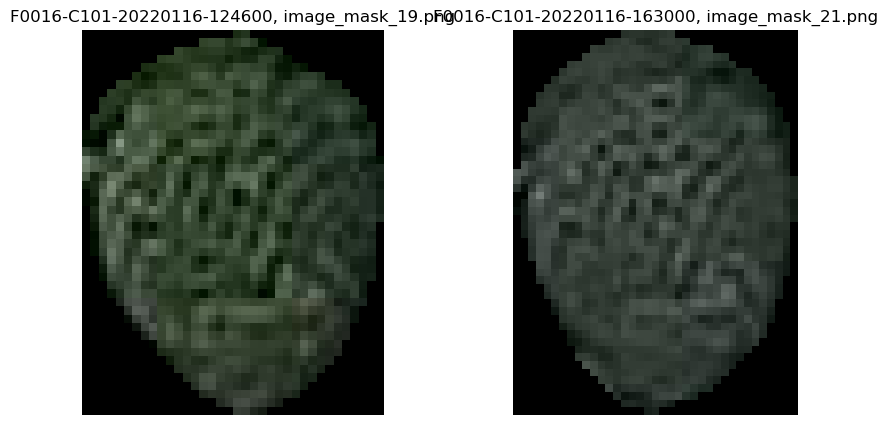

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_26
mask_id                                 6101c8d3aa13bfb2b466caa77470bde3
point_x_x                                                    1891.499268
point_y_x                                                      17.242508
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

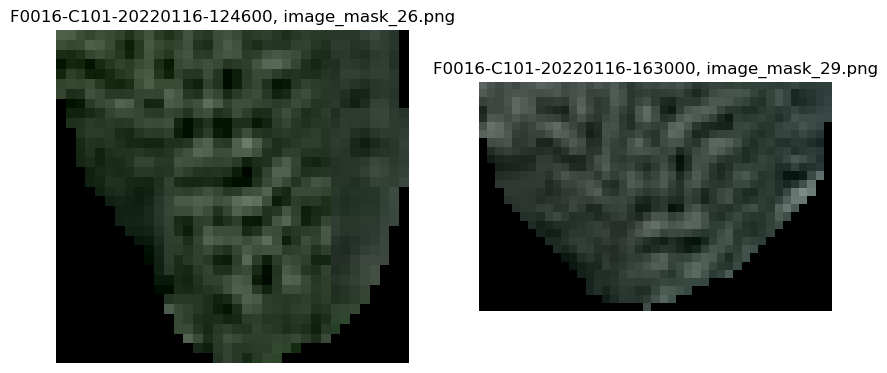

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_22
mask_id                                 611f6e403fd943ec641aaadc823560be
point_x_x                                                    1862.794922
point_y_x                                                      72.733322
output_image_path_x                                    image_mask_22.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

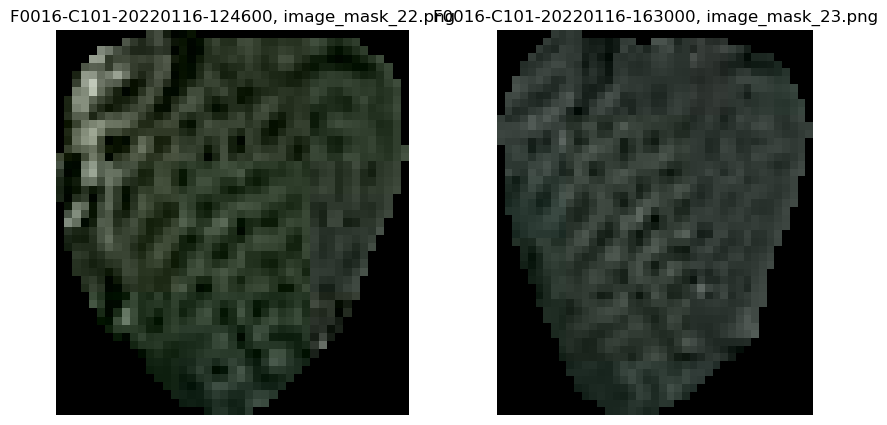

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                  F0016-C101-20220116-124600_9
mask_id                                 661219b901520d66f436eb66c521c33a
point_x_x                                                     957.408936
point_y_x                                                     400.569336
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

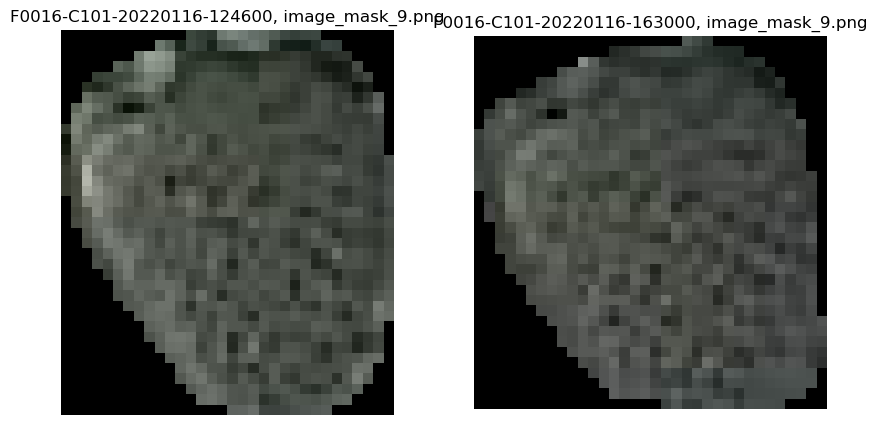

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_11
mask_id                                 741deee37319e0b2ad496f3e3ee4e1bb
point_x_x                                                     883.071228
point_y_x                                                     626.122192
output_image_path_x                                    image_mask_11.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

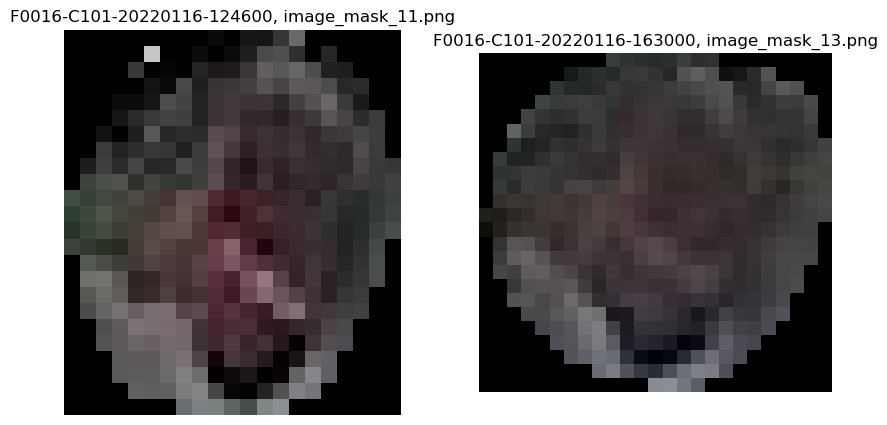

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_18
mask_id                                 783d8b4a0ad0a52f29d1d808ea832579
point_x_x                                                    1604.330566
point_y_x                                                     272.985229
output_image_path_x                                    image_mask_18.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

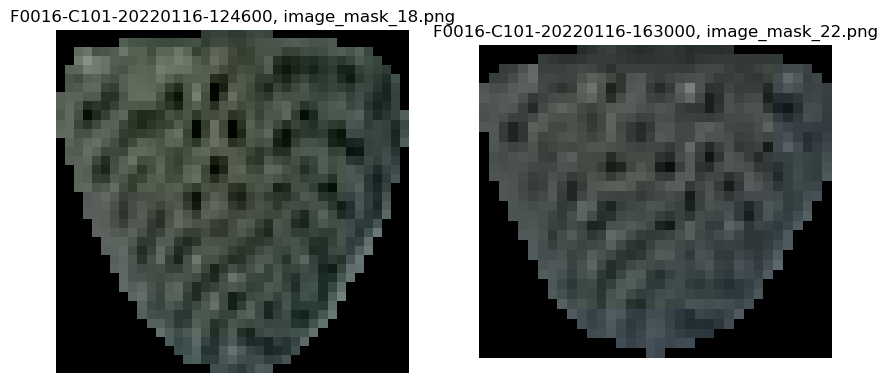

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_27
mask_id                                 78a709ff5f5c22a84a42406fa7f5b806
point_x_x                                                    1443.483032
point_y_x                                                     170.934235
output_image_path_x                                    image_mask_27.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

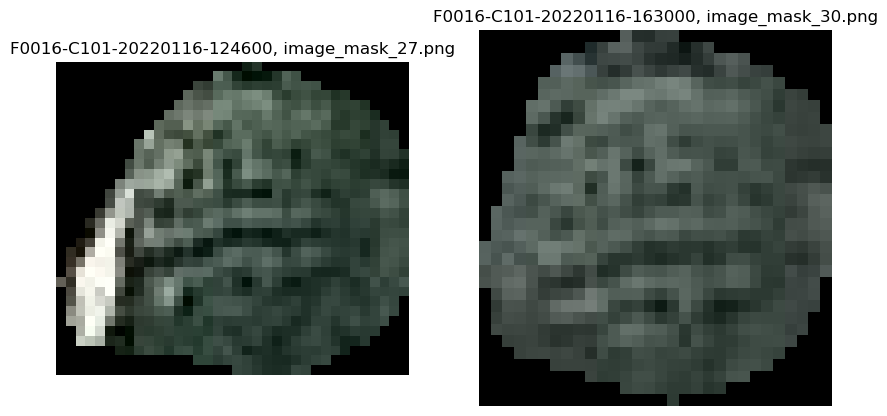

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_27
mask_id                                 78a709ff5f5c22a84a42406fa7f5b806
point_x_x                                                    1443.483032
point_y_x                                                     170.934235
output_image_path_x                                    image_mask_27.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

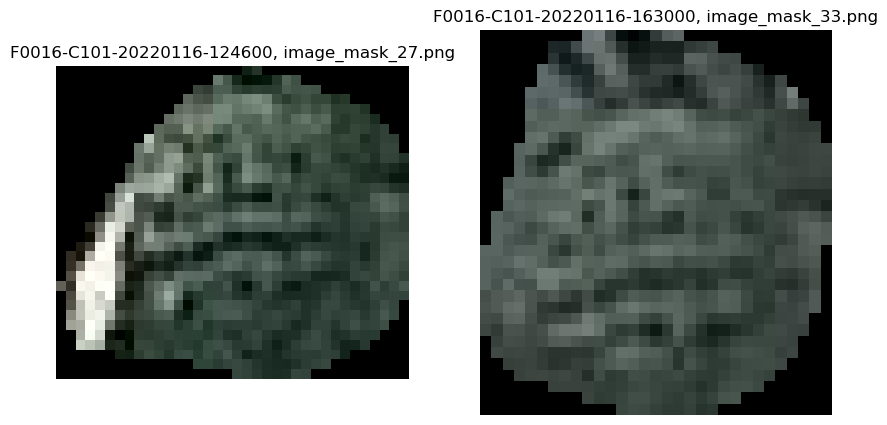

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                  F0016-C101-20220116-124600_1
mask_id                                 929d14b975664a47865cd041626d7c09
point_x_x                                                      536.06311
point_y_x                                                      38.471771
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

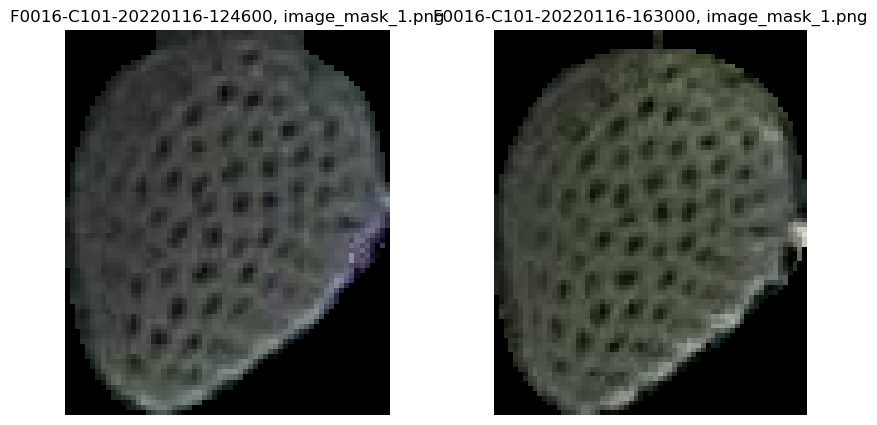

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_15
mask_id                                 971d06c85695c906eadb8f0fdac6d1ba
point_x_x                                                    1531.102417
point_y_x                                                     261.407959
output_image_path_x                                    image_mask_15.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

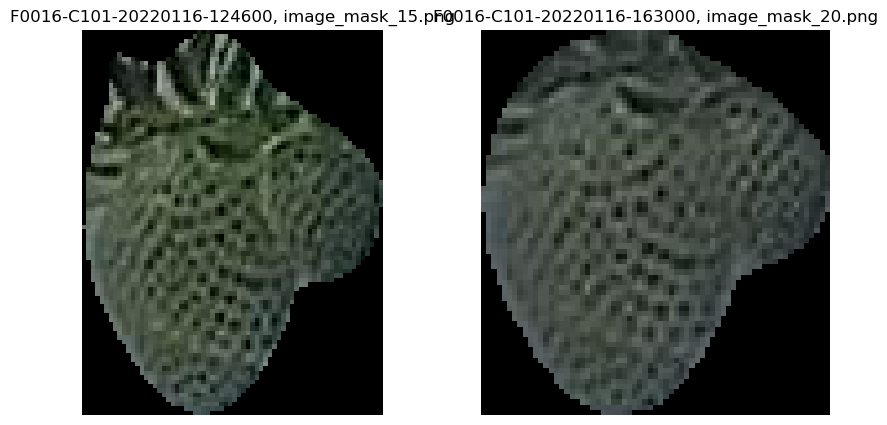

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_28
mask_id                                 c1d1b4c4f46b73a347ca5036c35ffae3
point_x_x                                                    1523.895264
point_y_x                                                     274.892151
output_image_path_x                                    image_mask_28.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

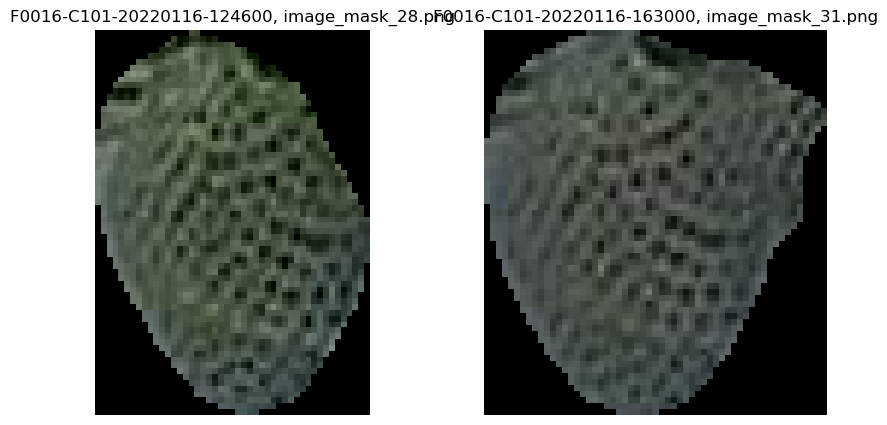

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_13
mask_id                                 df9cb91b87299953ed72a7268eb59620
point_x_x                                                    1098.287476
point_y_x                                                     195.930008
output_image_path_x                                    image_mask_13.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

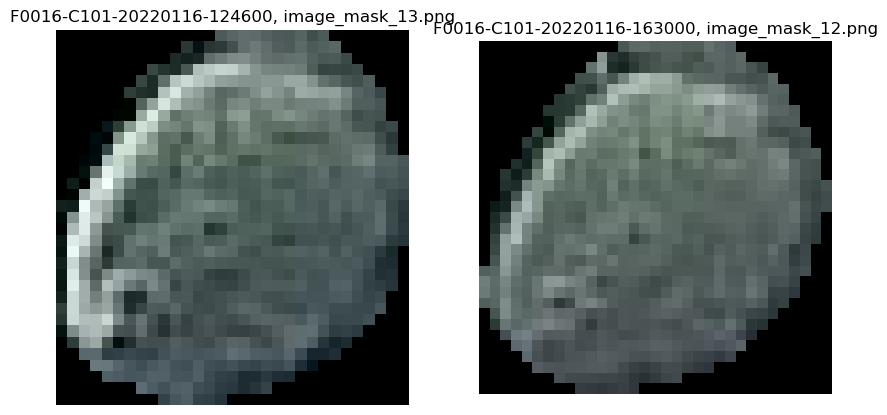

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                  F0016-C101-20220116-124600_6
mask_id                                 e2348cae92b9c08d51adf5d78bb9471c
point_x_x                                                     596.855713
point_y_x                                                     122.293388
output_image_path_x                                     image_mask_6.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

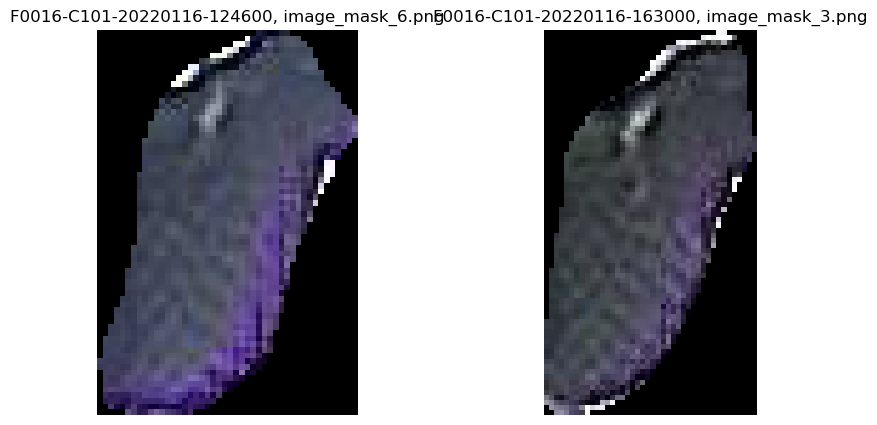

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220116-124600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220116-084600
mask_num_x                                 F0016-C101-20220116-124600_16
mask_id                                 f7e54b26fd84e2b8e0ed3e23f062c4fe
point_x_x                                                     1530.87854
point_y_x                                                     107.433945
output_image_path_x                                    image_mask_16.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220116-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

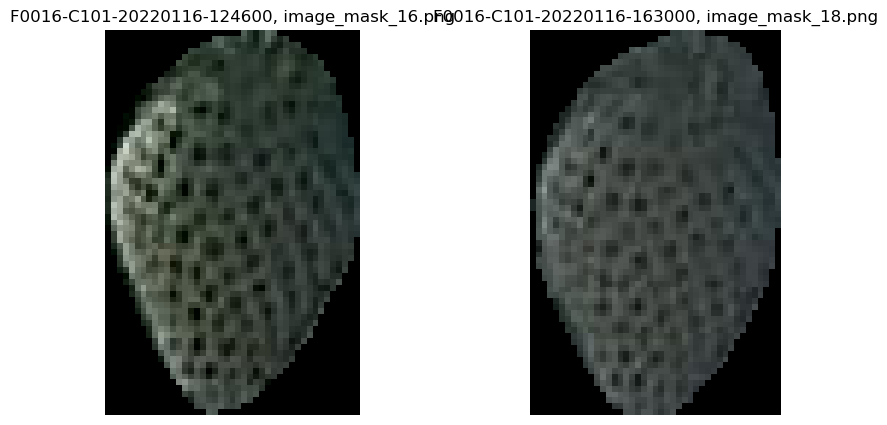

In [120]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_26
mask_id                                 028fed332d6c8246c995b2160e6718e9
point_x_x                                                    1448.123047
point_y_x                                                      545.34967
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

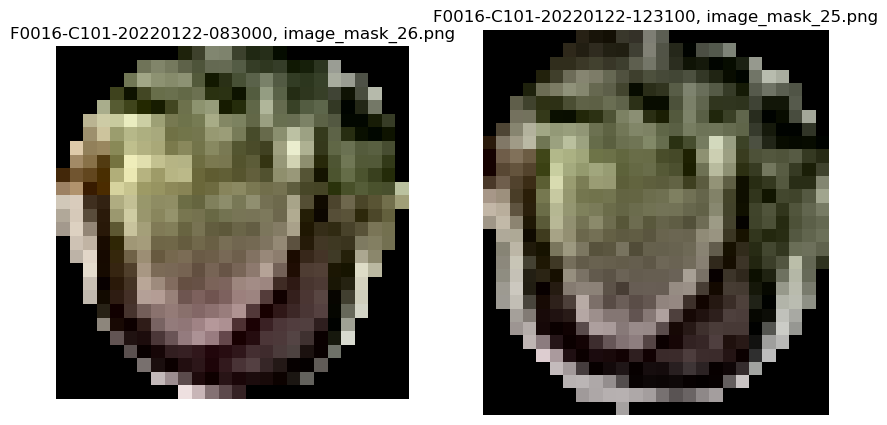

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_24
mask_id                                 03b4ad2d641ebc2619e9b21eea73c53a
point_x_x                                                    1824.244995
point_y_x                                                     147.069031
output_image_path_x                                    image_mask_24.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

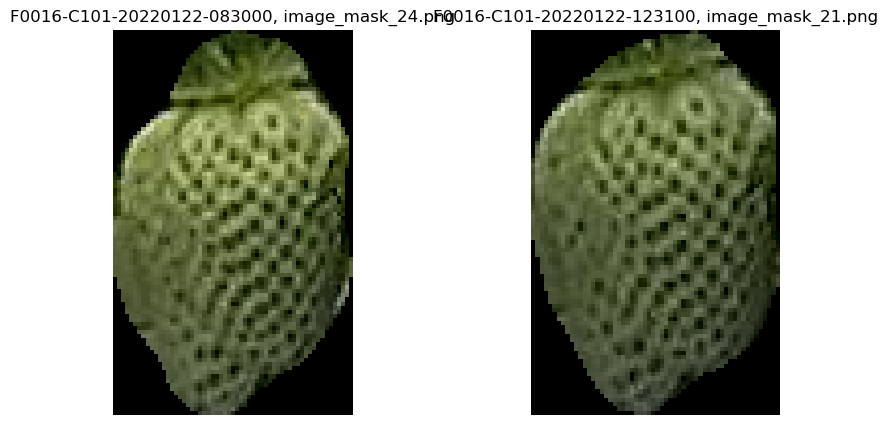

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_42
mask_id                                 0648b3734f27a5afadadb022a12d457c
point_x_x                                                    1874.189697
point_y_x                                                     156.079895
output_image_path_x                                    image_mask_42.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

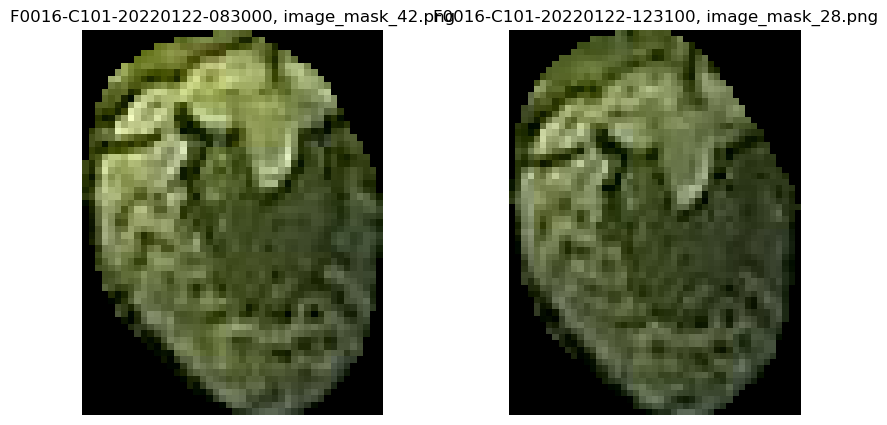

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                  F0016-C101-20220122-083000_5
mask_id                                 082e467814e19165a2221e16b66691a1
point_x_x                                                     517.880615
point_y_x                                                     180.558105
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

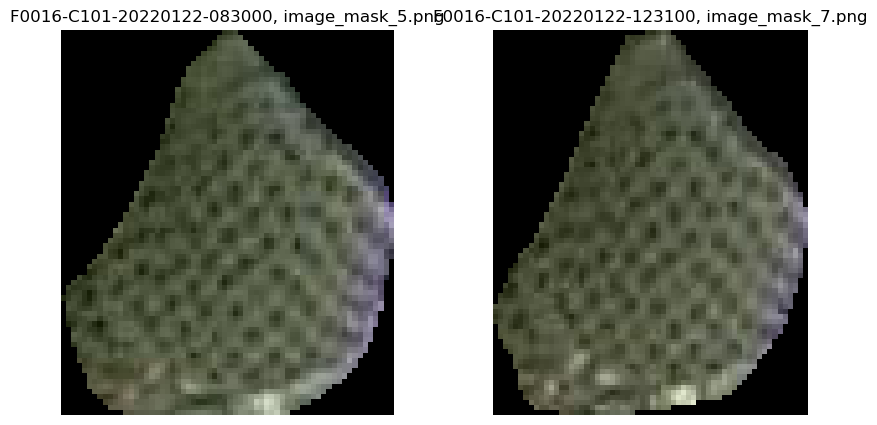

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_35
mask_id                                 16960418505c4cffa11fc24c40f64507
point_x_x                                                    1406.954346
point_y_x                                                        238.013
output_image_path_x                                    image_mask_35.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

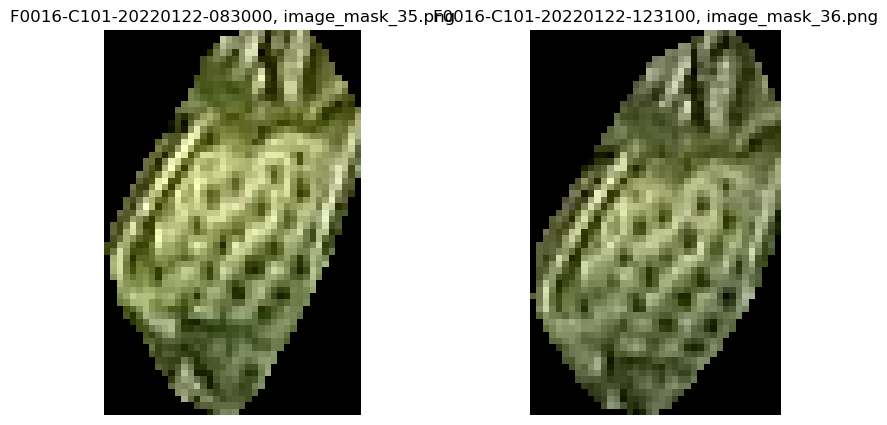

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_17
mask_id                                 1a644a40cf483330a7825a2410137fdf
point_x_x                                                    1267.898193
point_y_x                                                     245.135193
output_image_path_x                                    image_mask_17.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

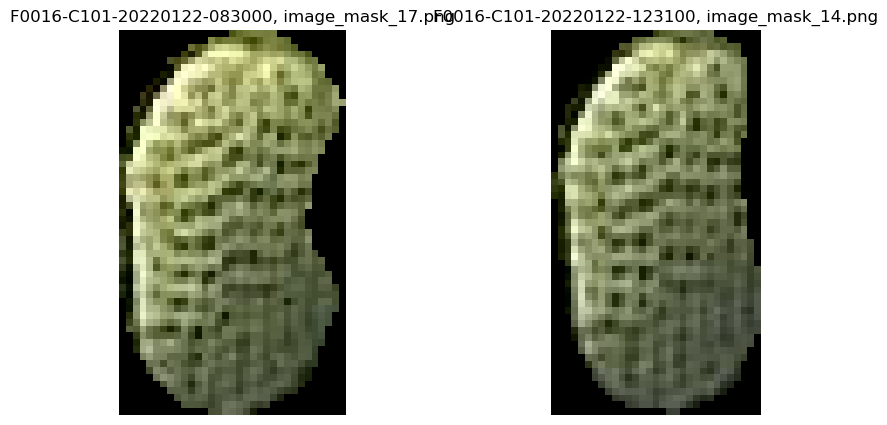

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_13
mask_id                                 27f1e9115d12c8461fb27e61bb2dd849
point_x_x                                                    1113.374878
point_y_x                                                     422.868347
output_image_path_x                                    image_mask_13.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

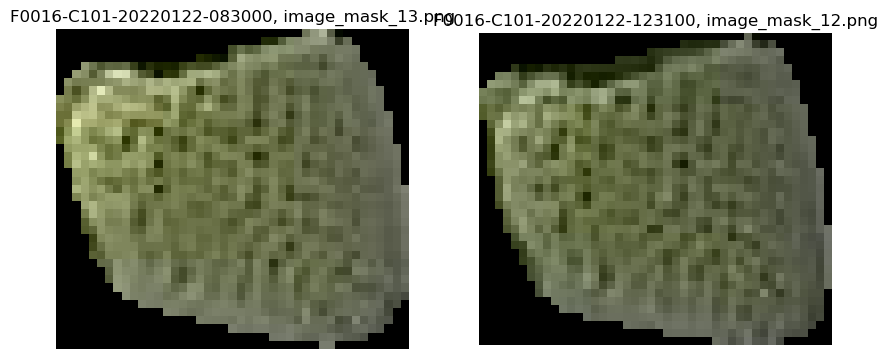

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_45
mask_id                                 2d4bda52216b3aace4b6c5f2ad0a7ff3
point_x_x                                                    2206.878418
point_y_x                                                      34.428925
output_image_path_x                                    image_mask_45.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

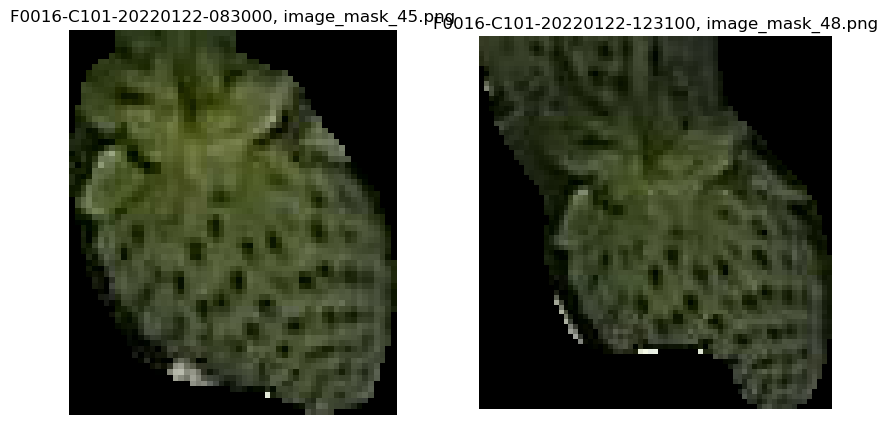

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_45
mask_id                                 2d4bda52216b3aace4b6c5f2ad0a7ff3
point_x_x                                                    2206.878418
point_y_x                                                      34.428925
output_image_path_x                                    image_mask_45.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

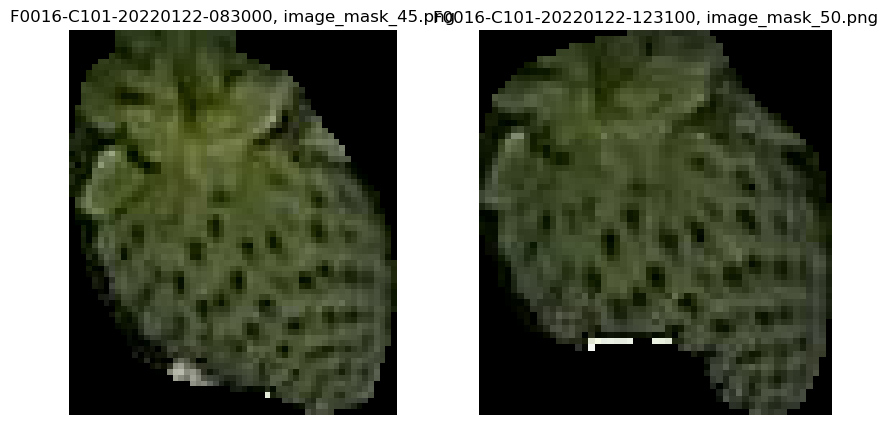

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_27
mask_id                                 2fdd4ce28f2e10bdb4e72dd346b6e245
point_x_x                                                    1438.179565
point_y_x                                                     515.925598
output_image_path_x                                    image_mask_27.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

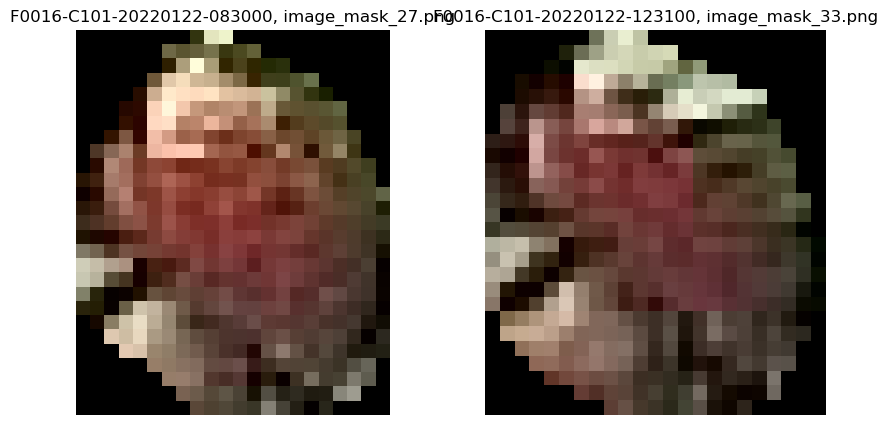

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_27
mask_id                                 2fdd4ce28f2e10bdb4e72dd346b6e245
point_x_x                                                    1438.179565
point_y_x                                                     515.925598
output_image_path_x                                    image_mask_27.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

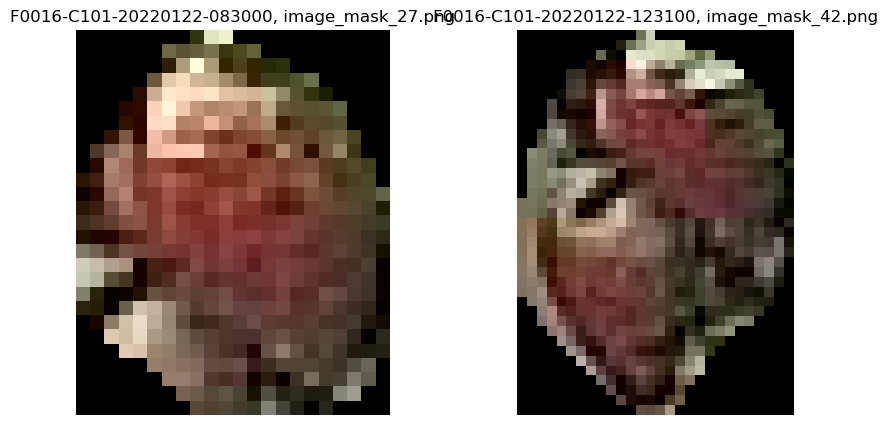

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_39
mask_id                                 3344fa3e05097b28dd22394ba950c01e
point_x_x                                                    1897.833252
point_y_x                                                     123.052826
output_image_path_x                                    image_mask_39.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

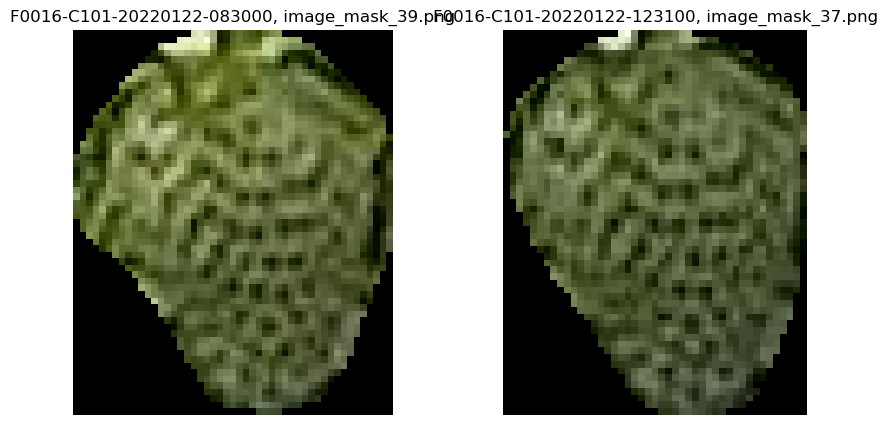

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_41
mask_id                                 3f6f815e14655e80d521791aa2086401
point_x_x                                                    1381.151123
point_y_x                                                     259.435242
output_image_path_x                                    image_mask_41.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

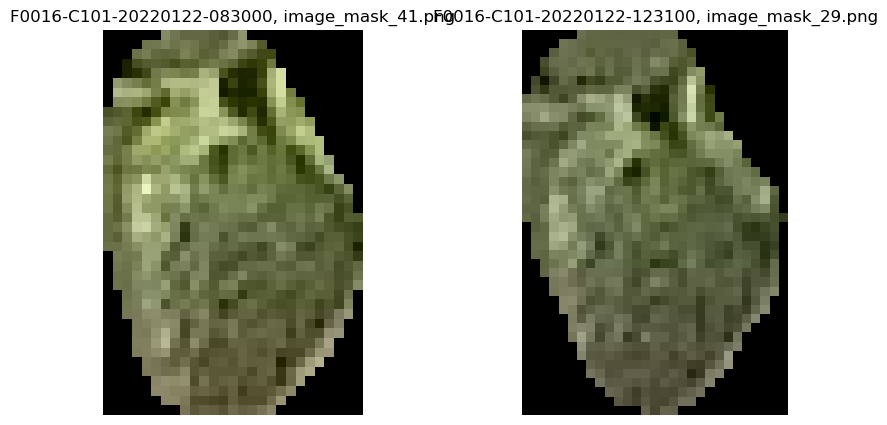

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_32
mask_id                                 43bcd2544ee723812e1837e968dffc90
point_x_x                                                    1509.344727
point_y_x                                                     209.735565
output_image_path_x                                    image_mask_32.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

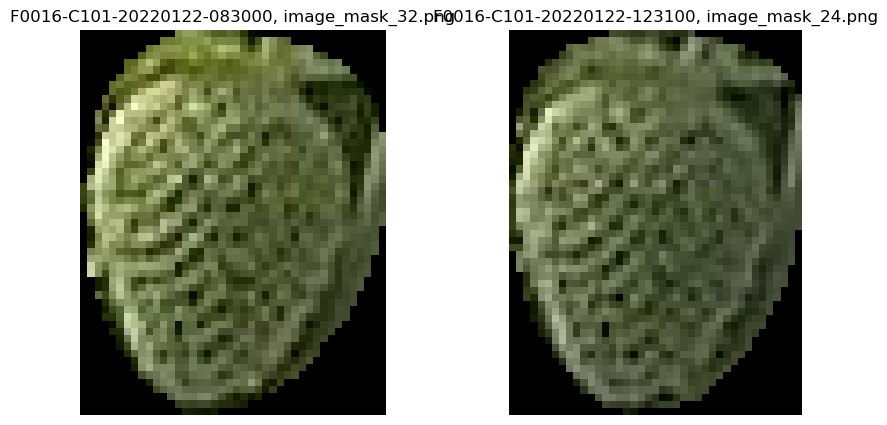

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_36
mask_id                                 4b7d3742a81f779f18a3c4c6c914ead2
point_x_x                                                    1473.271729
point_y_x                                                     219.817627
output_image_path_x                                    image_mask_36.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

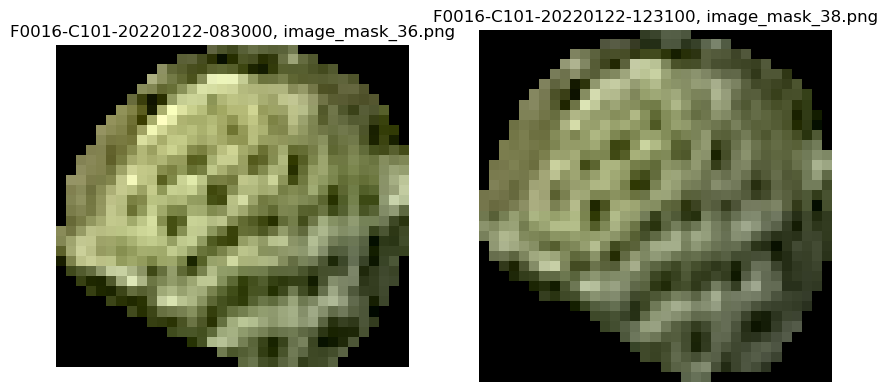

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                  F0016-C101-20220122-083000_6
mask_id                                 4c288b55cc361a9461fd1e659777b140
point_x_x                                                     398.825012
point_y_x                                                     252.901215
output_image_path_x                                     image_mask_6.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

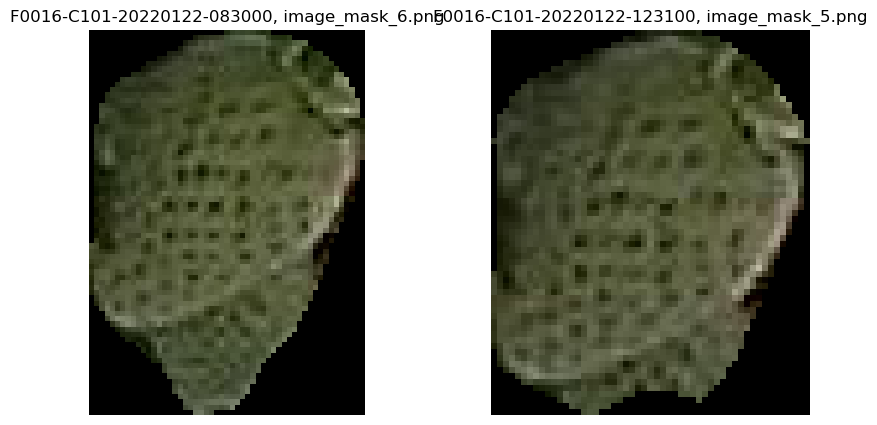

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_19
mask_id                                 4fca93b54f9a132fc325c0f6750848c4
point_x_x                                                     960.290527
point_y_x                                                     377.992004
output_image_path_x                                    image_mask_19.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

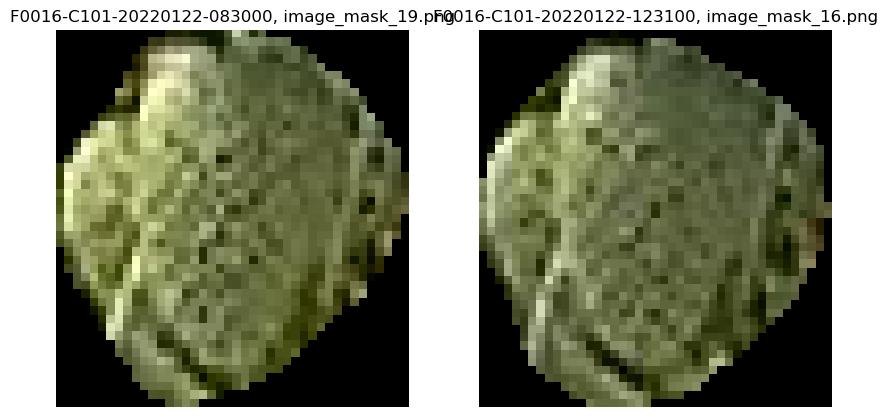

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_31
mask_id                                 52d17962664189ac31057eb35646bf7c
point_x_x                                                    1431.499268
point_y_x                                                     531.149231
output_image_path_x                                    image_mask_31.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

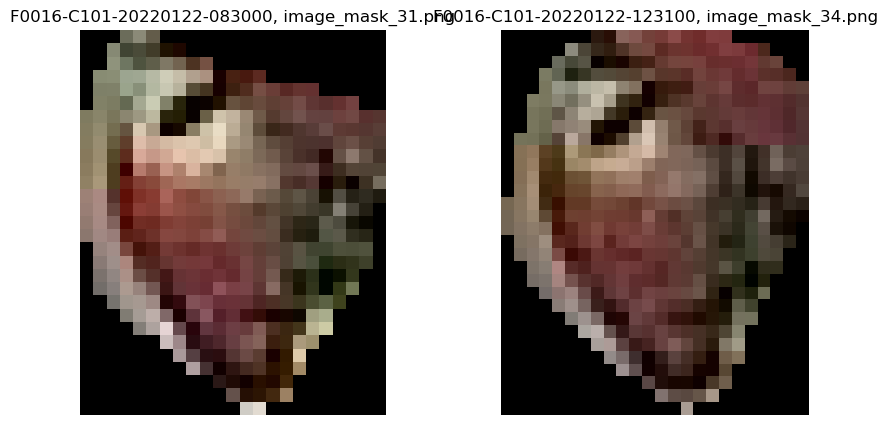

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_22
mask_id                                 546330e042247a7d7519c3c4d4590a85
point_x_x                                                    1592.517822
point_y_x                                                      93.003029
output_image_path_x                                    image_mask_22.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

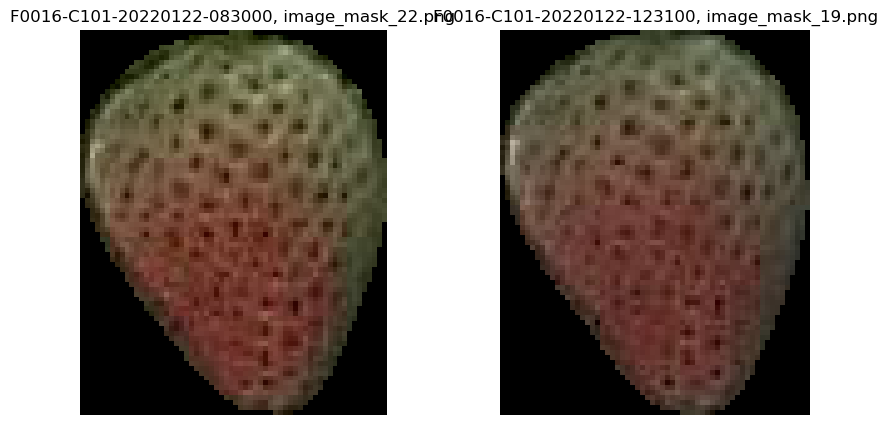

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                  F0016-C101-20220122-083000_4
mask_id                                 55ad62e4822df2a64792fd7d97ff293a
point_x_x                                                     349.185791
point_y_x                                                     272.666382
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

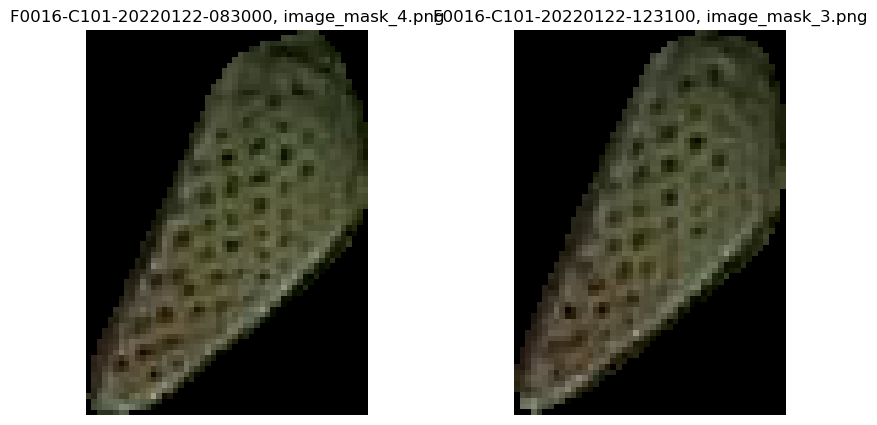

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_30
mask_id                                 6468a814bf70b8d0d38b8576af65eaab
point_x_x                                                    1580.990723
point_y_x                                                     298.098572
output_image_path_x                                    image_mask_30.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

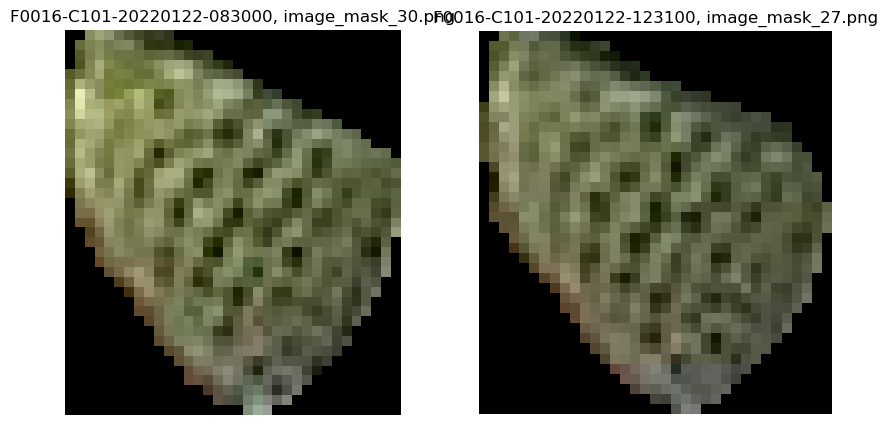

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_15
mask_id                                 661219b901520d66f436eb66c521c33a
point_x_x                                                     979.274658
point_y_x                                                     418.013245
output_image_path_x                                    image_mask_15.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

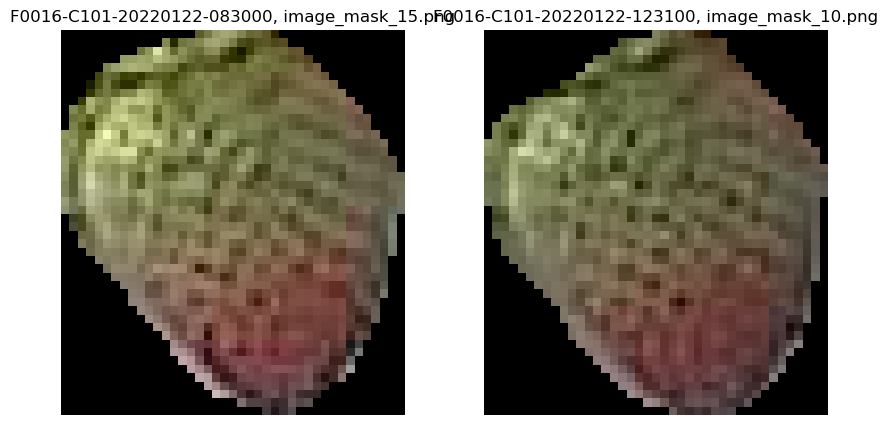

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_46
mask_id                                 7009b0322b81a972ea87b3cc15b993cf
point_x_x                                                    1947.879639
point_y_x                                                     147.391388
output_image_path_x                                    image_mask_46.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

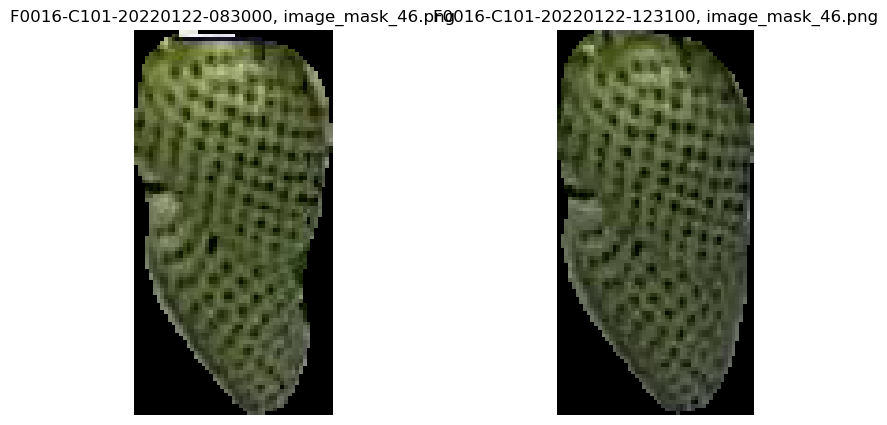

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_44
mask_id                                 7bf102c56c369f629af1fac1a3023222
point_x_x                                                    2269.156982
point_y_x                                                       32.29517
output_image_path_x                                    image_mask_44.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

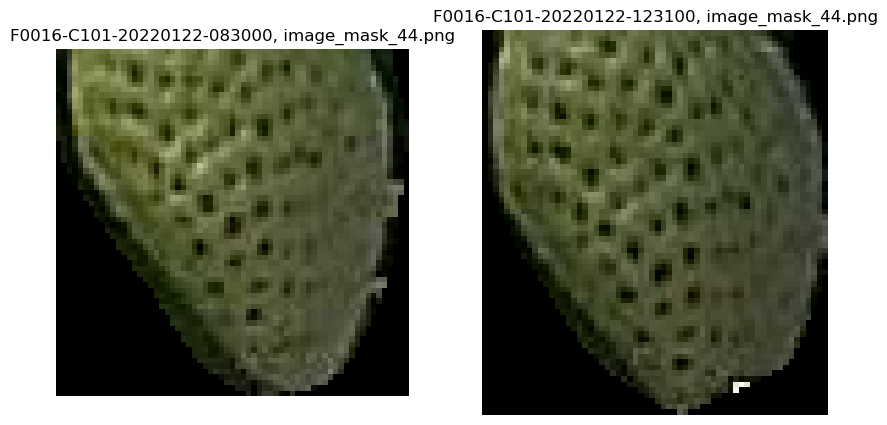

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_18
mask_id                                 7e14f9e2cb86cf9ae45486e65143970c
point_x_x                                                    1064.030518
point_y_x                                                     446.386414
output_image_path_x                                    image_mask_18.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

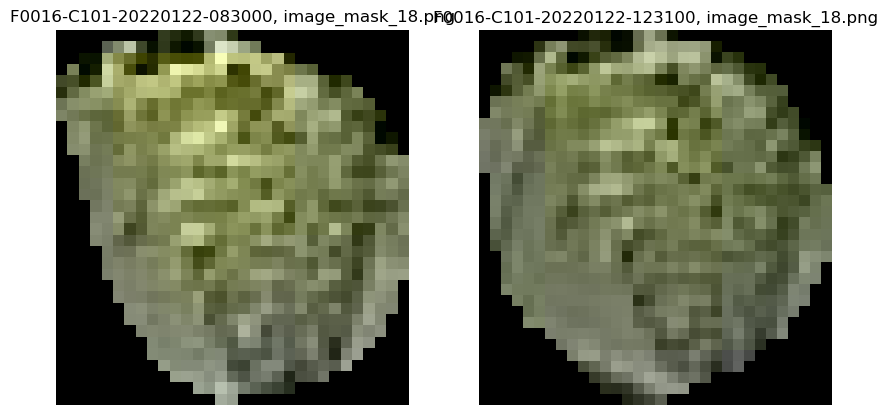

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_28
mask_id                                 82c8075a759d21999652c4c2193e6662
point_x_x                                                    1621.785645
point_y_x                                                     309.370728
output_image_path_x                                    image_mask_28.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

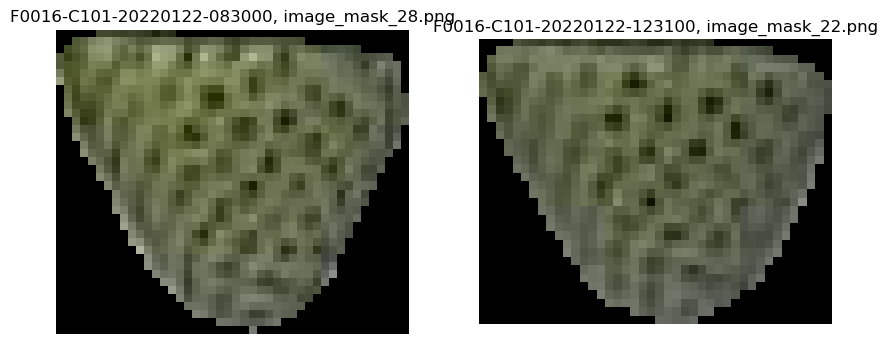

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_23
mask_id                                 8758d30e86cdbedacdda86b2d93f5ca2
point_x_x                                                    1565.175293
point_y_x                                                     170.171509
output_image_path_x                                    image_mask_23.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

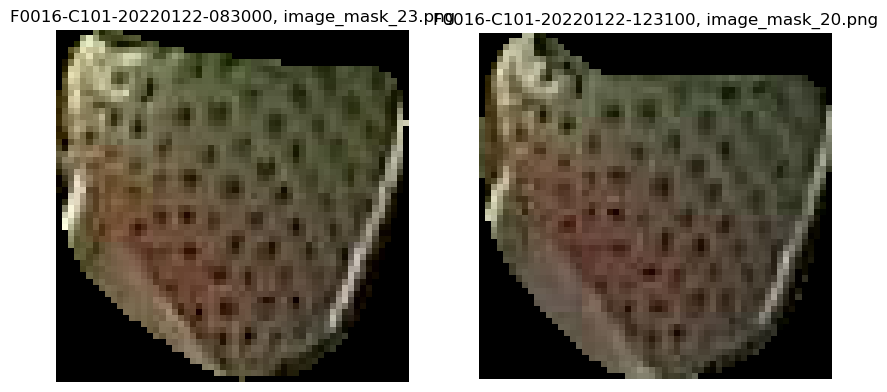

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_14
mask_id                                 8a6cb3e982caf173ad2d139976ec7fa6
point_x_x                                                    1120.785889
point_y_x                                                     243.972015
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

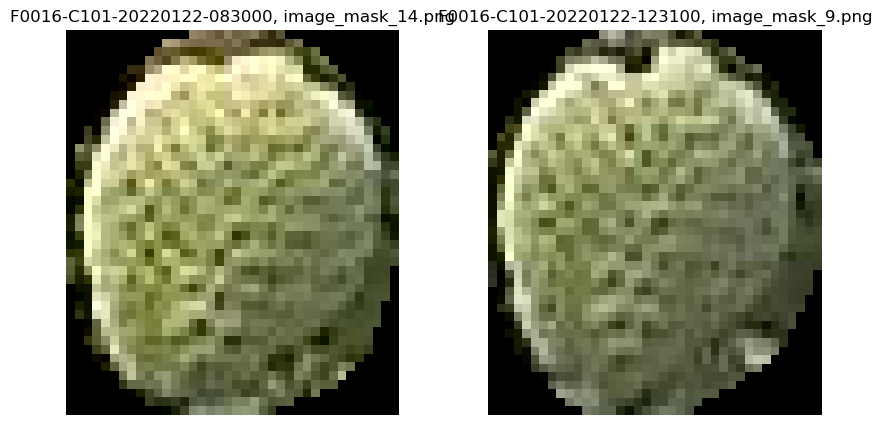

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_20
mask_id                                 8dc004a0512712405b12c1034650ce1d
point_x_x                                                    1075.719238
point_y_x                                                     416.419861
output_image_path_x                                    image_mask_20.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

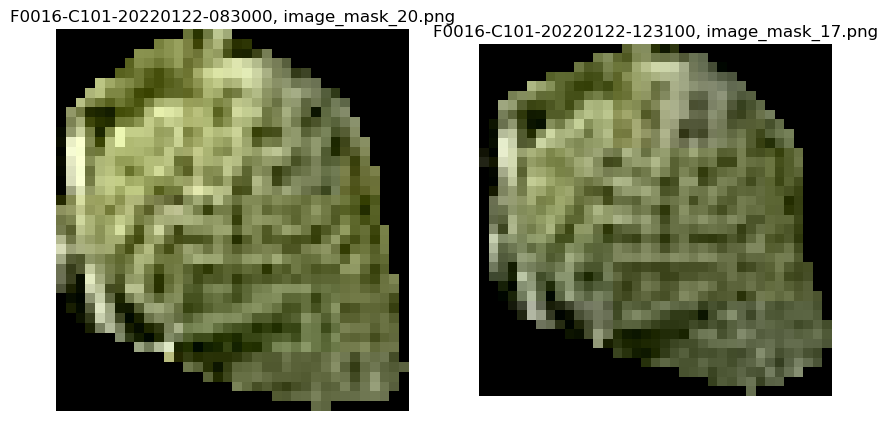

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_12
mask_id                                 9293afe4ad2ea898ba55439f32ca0c19
point_x_x                                                     1000.92395
point_y_x                                                       391.0578
output_image_path_x                                    image_mask_12.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

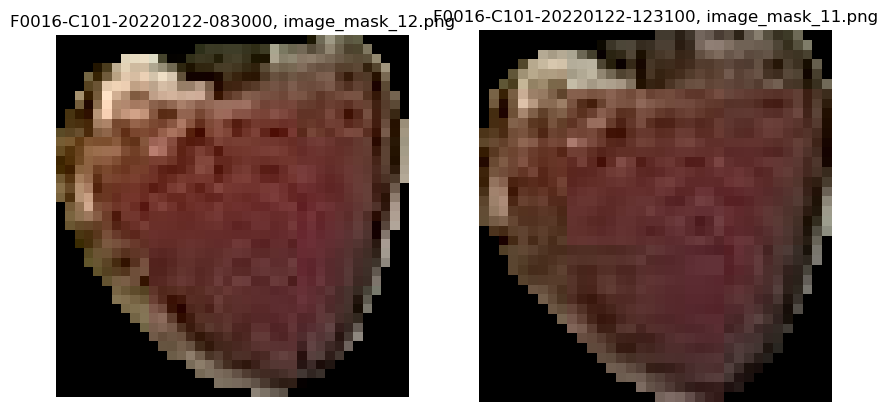

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_25
mask_id                                 971d06c85695c906eadb8f0fdac6d1ba
point_x_x                                                    1554.364502
point_y_x                                                     299.098022
output_image_path_x                                    image_mask_25.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

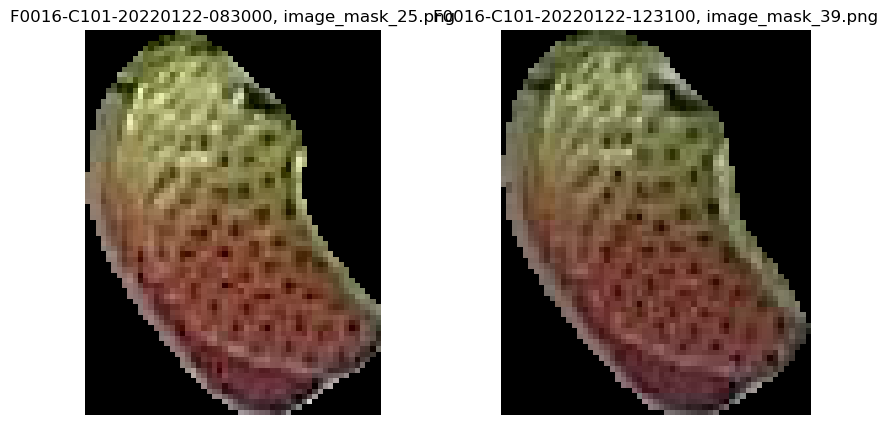

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_33
mask_id                                 986db48108836f14c3670e20d9bddfec
point_x_x                                                    1877.960693
point_y_x                                                     457.018494
output_image_path_x                                    image_mask_33.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

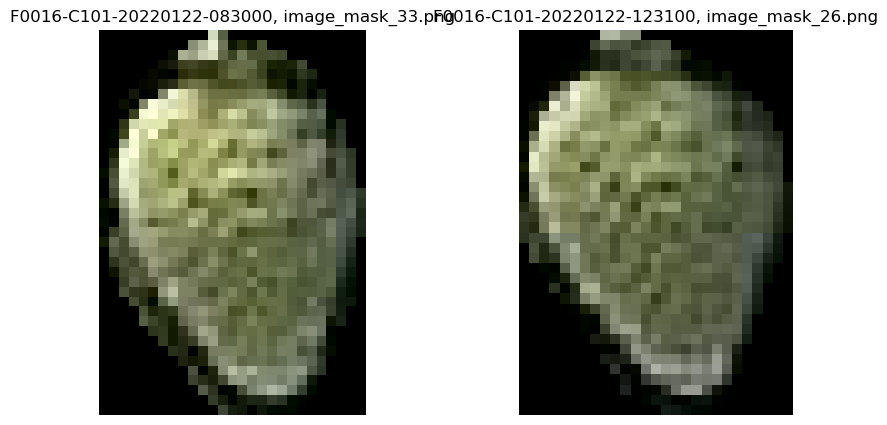

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_16
mask_id                                 9d580a25bb5c5fd7a854f7ad09d3c13e
point_x_x                                                     914.071655
point_y_x                                                     354.788025
output_image_path_x                                    image_mask_16.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

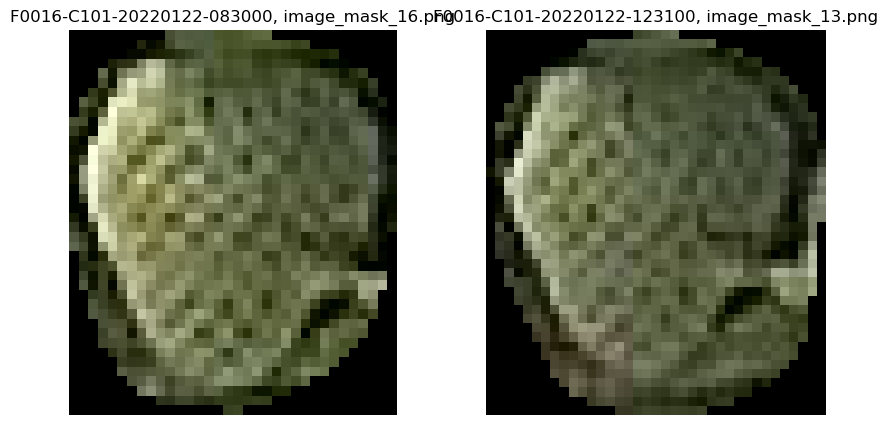

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                  F0016-C101-20220122-083000_3
mask_id                                 a10380fccbda5a4ae4d9b75336010cca
point_x_x                                                     476.872711
point_y_x                                                     151.967651
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

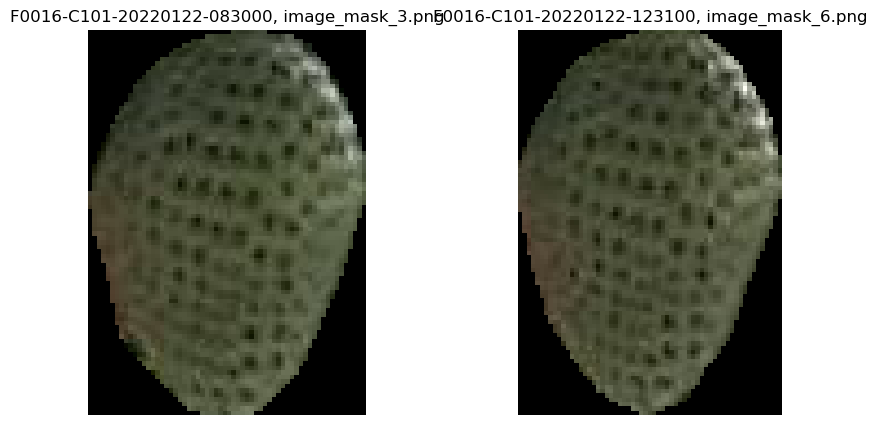

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_34
mask_id                                 a354c3b485d57d1c5e7fc48d8ba5af07
point_x_x                                                    1289.727051
point_y_x                                                     238.711472
output_image_path_x                                    image_mask_34.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

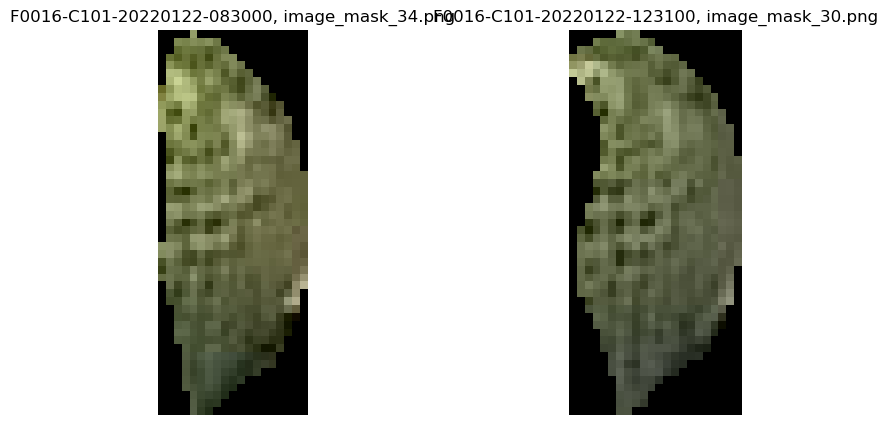

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_48
mask_id                                 b199d24b72e737cfb461dafab0e4fb81
point_x_x                                                    1979.709229
point_y_x                                                      89.625473
output_image_path_x                                    image_mask_48.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

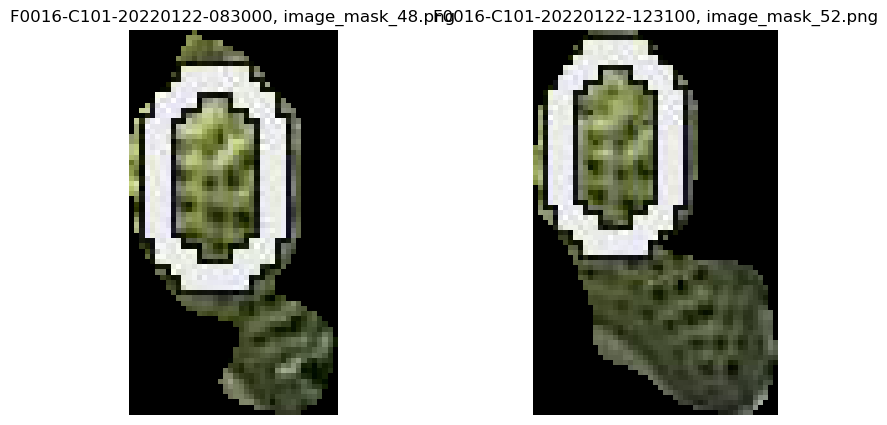

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_38
mask_id                                 b9f032cc07bd24936bc61e37d64d2e2a
point_x_x                                                    1736.266235
point_y_x                                                      108.45929
output_image_path_x                                    image_mask_38.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

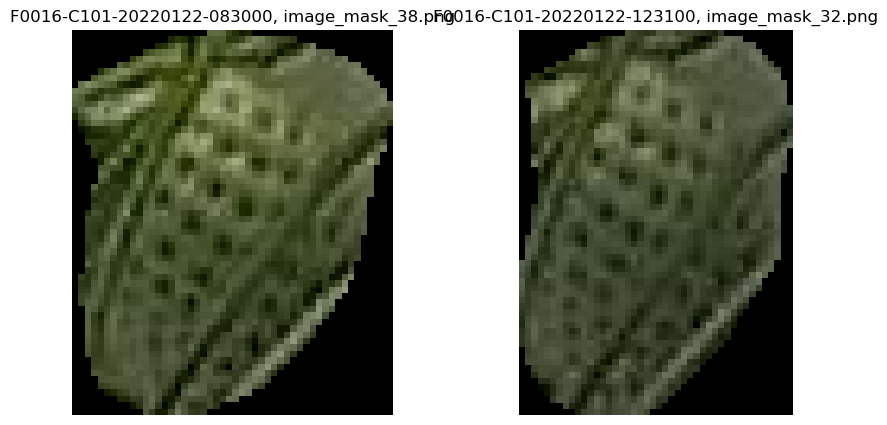

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_40
mask_id                                 b9f032cc07bd24936bc61e37d64d2e2a
point_x_x                                                    1738.100098
point_y_x                                                     112.986465
output_image_path_x                                    image_mask_40.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

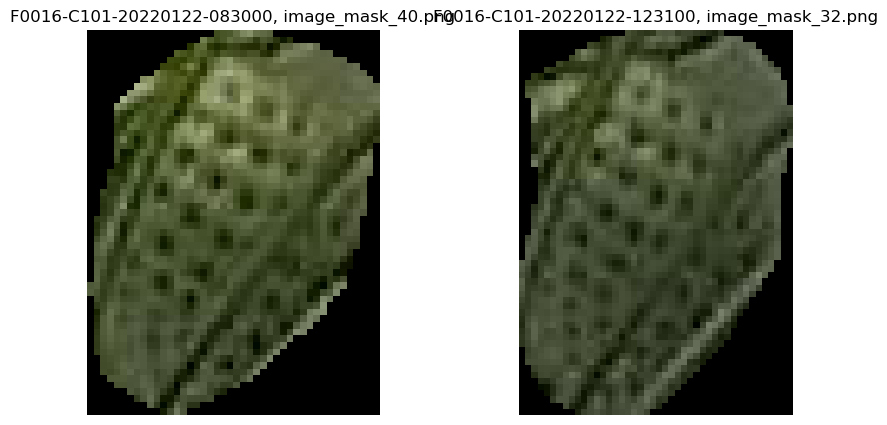

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_29
mask_id                                 d1a11364588b588a85bdc46b49ad9298
point_x_x                                                    1523.477783
point_y_x                                                     146.119019
output_image_path_x                                    image_mask_29.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

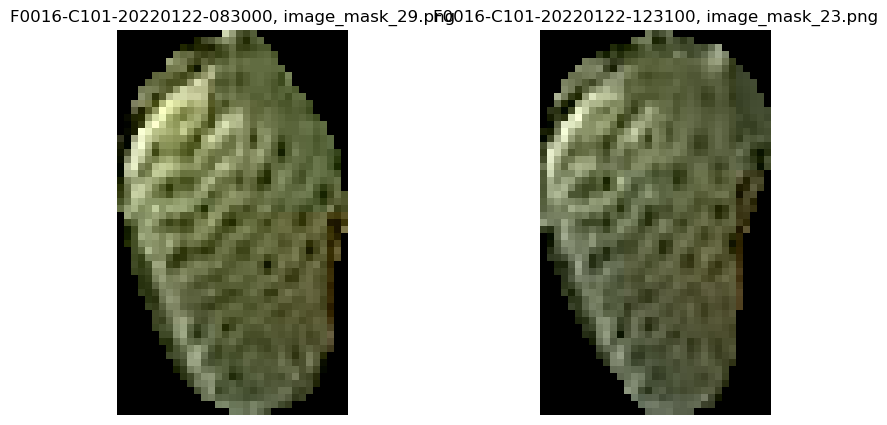

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_37
mask_id                                 d9d4c03a8b6b87b34ee8467b380f03c9
point_x_x                                                    1908.372559
point_y_x                                                     438.998138
output_image_path_x                                    image_mask_37.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

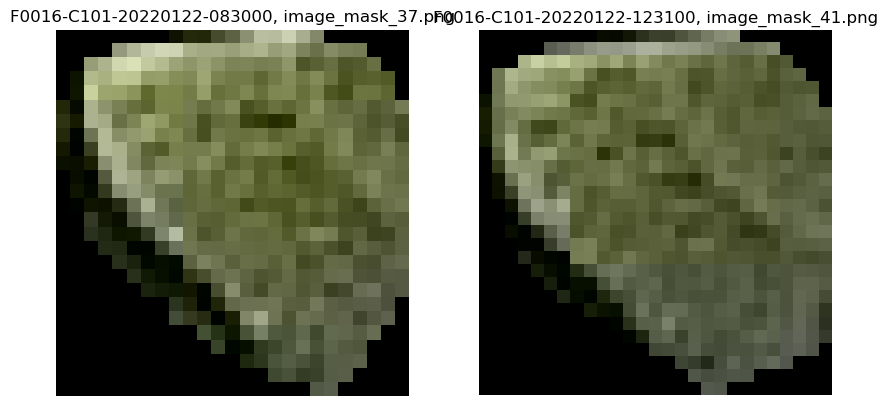

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220122-083000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220121-164500
mask_num_x                                 F0016-C101-20220122-083000_11
mask_id                                 ee5dea72534ec7afe9e933ce5004a5b5
point_x_x                                                     422.107056
point_y_x                                                     173.098267
output_image_path_x                                    image_mask_11.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220122-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

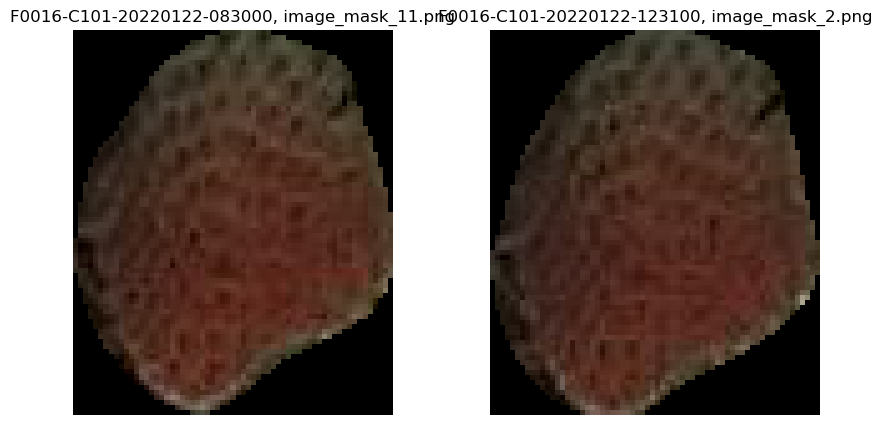

In [123]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_30
mask_id                                 067a480b75ed924d81d916362997bbfa
point_x_x                                                    1564.692383
point_y_x                                                     122.500359
output_image_path_x                                    image_mask_30.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

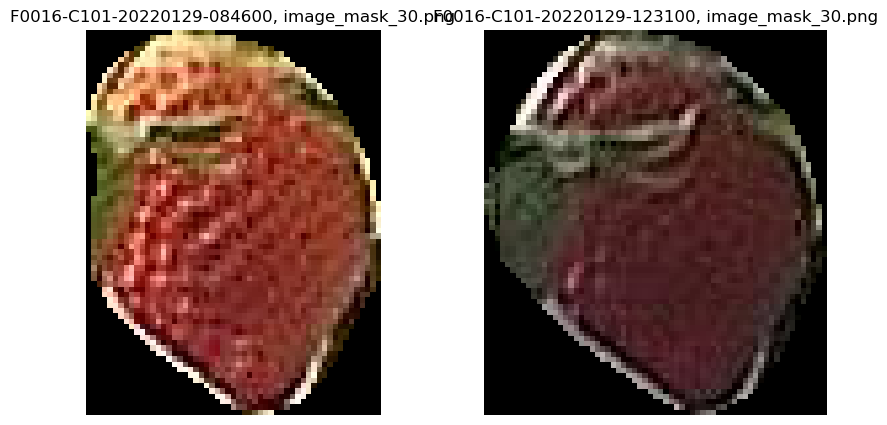

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_46
mask_id                                 09298242eb755c8a7ec55c2dcbe0764c
point_x_x                                                    1563.445068
point_y_x                                                     489.204956
output_image_path_x                                    image_mask_46.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

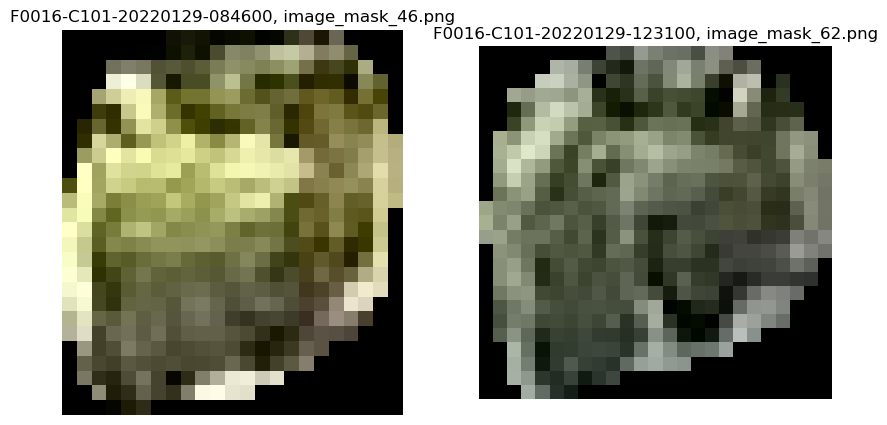

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                  F0016-C101-20220129-084600_4
mask_id                                 0f3218c4a180018c60848040a585449d
point_x_x                                                     338.687195
point_y_x                                                      351.43634
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

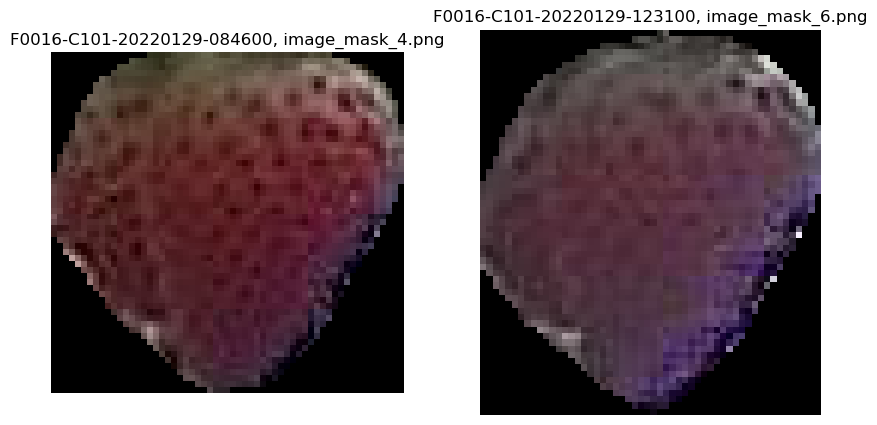

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_52
mask_id                                 116b9d6e37a233ebbb0e1a0f23340795
point_x_x                                                    1322.662231
point_y_x                                                     541.942688
output_image_path_x                                    image_mask_52.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

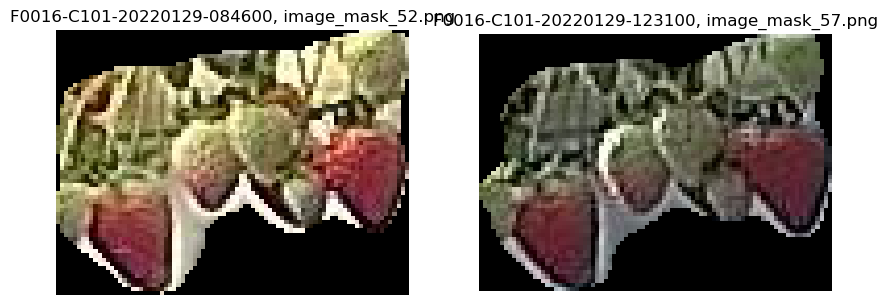

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_61
mask_id                                 116b9d6e37a233ebbb0e1a0f23340795
point_x_x                                                    1331.617798
point_y_x                                                     539.830261
output_image_path_x                                    image_mask_61.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

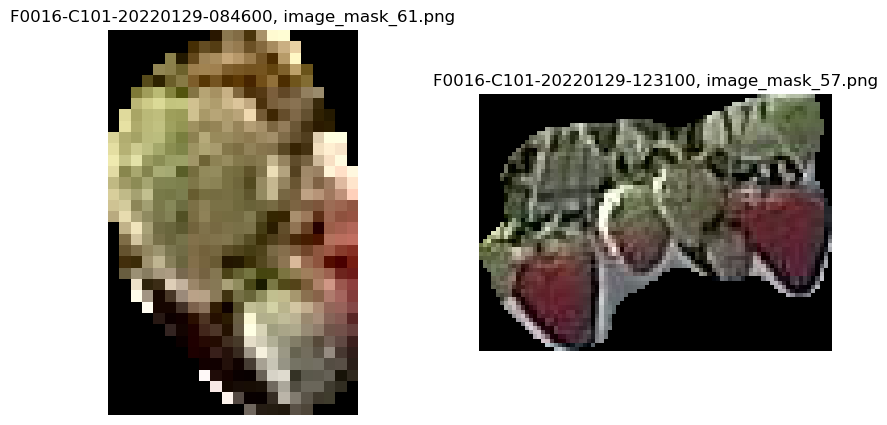

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_41
mask_id                                 145668bdc27f876716fabc37f55bad23
point_x_x                                                    1351.550171
point_y_x                                                     542.820312
output_image_path_x                                    image_mask_41.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

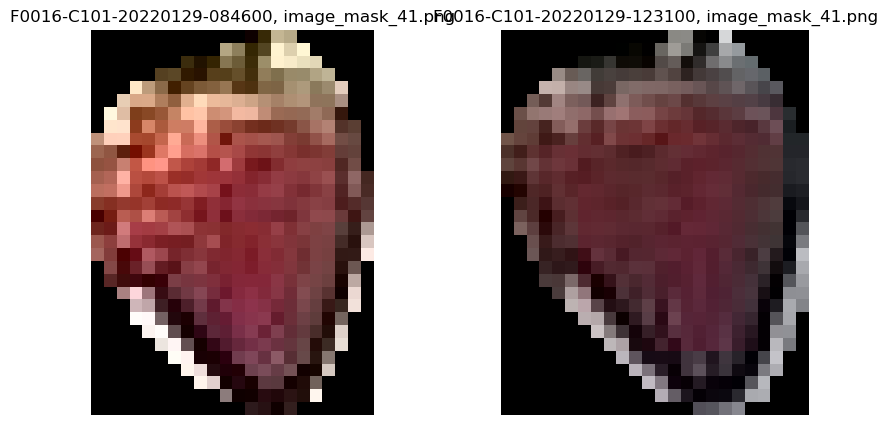

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_69
mask_id                                 18483c6e0a41f8b4f672890ac01bbe9c
point_x_x                                                    2530.016113
point_y_x                                                     428.849335
output_image_path_x                                    image_mask_69.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

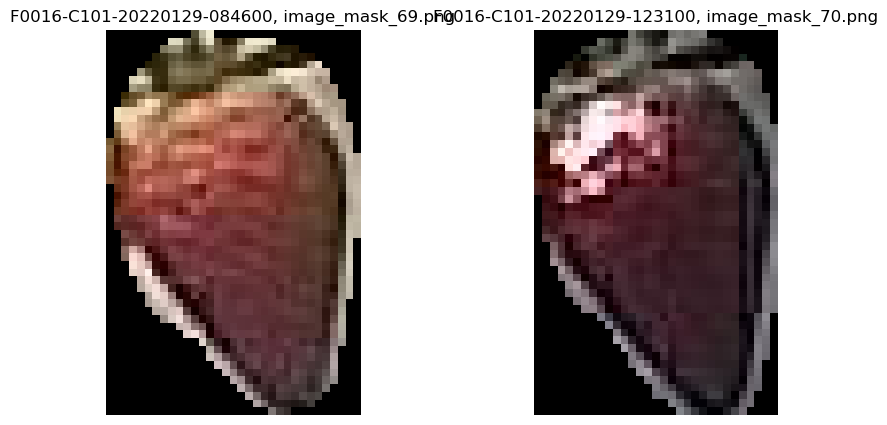

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_59
mask_id                                 1a7d75da2891d628c101818775e64105
point_x_x                                                    1296.038818
point_y_x                                                     559.913452
output_image_path_x                                    image_mask_59.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

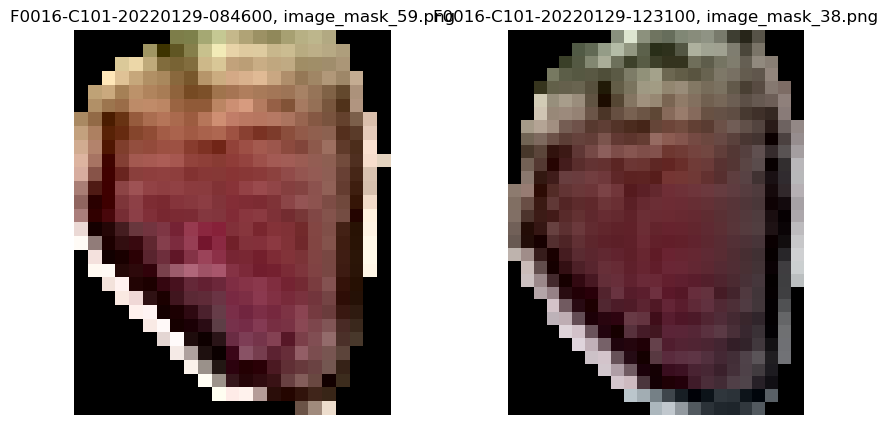

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_56
mask_id                                 1b75ccc12c15aada9736fc02d82e1f94
point_x_x                                                    1875.521729
point_y_x                                                      26.767159
output_image_path_x                                    image_mask_56.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

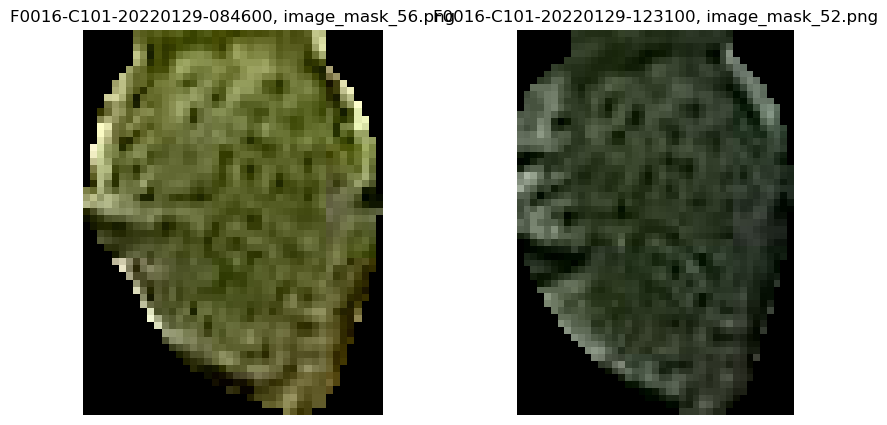

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_17
mask_id                                 277d15794214dd88cd6b15ad989fbe9e
point_x_x                                                     873.654663
point_y_x                                                      428.53894
output_image_path_x                                    image_mask_17.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

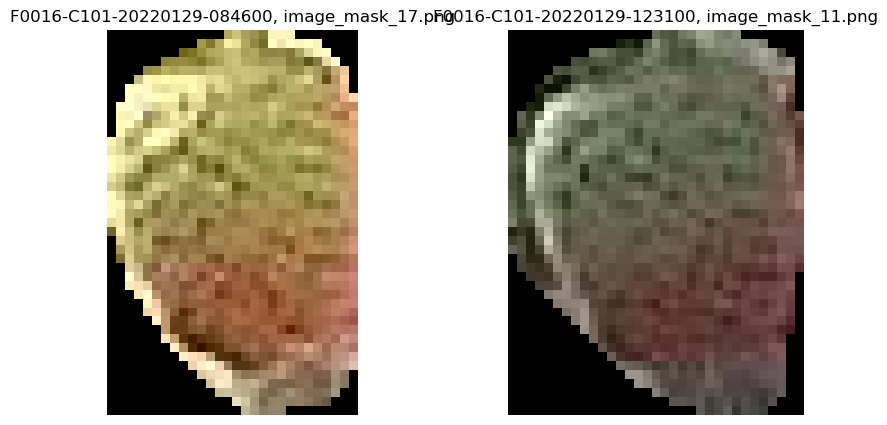

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_33
mask_id                                 28369e9925d841637d2a3195b25bfe82
point_x_x                                                    1310.813843
point_y_x                                                      276.31311
output_image_path_x                                    image_mask_33.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

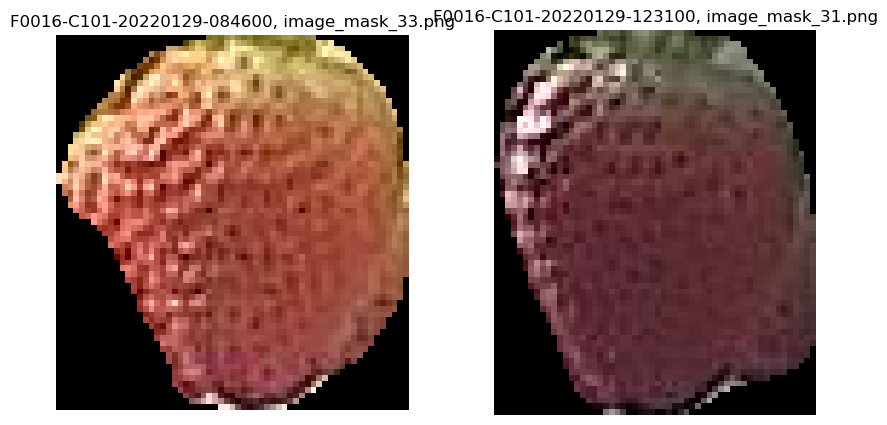

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_44
mask_id                                 289fdfed6c775da9492e3325ed66f097
point_x_x                                                    1873.041504
point_y_x                                                     182.229813
output_image_path_x                                    image_mask_44.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

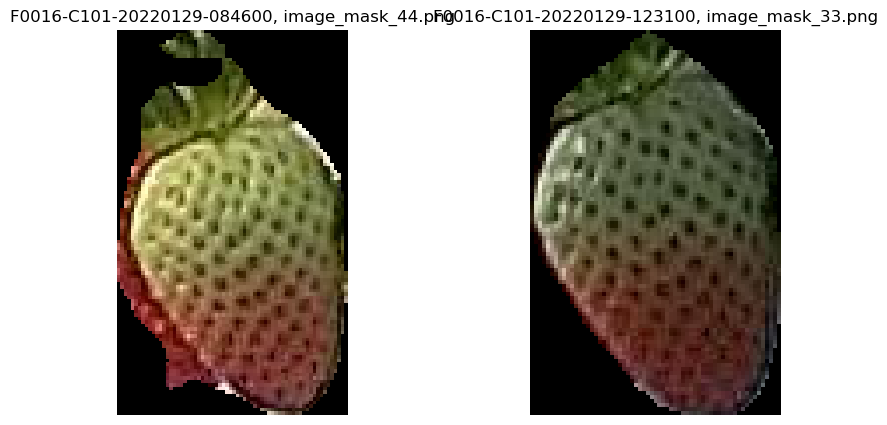

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_49
mask_id                                 289fdfed6c775da9492e3325ed66f097
point_x_x                                                    1866.393311
point_y_x                                                     182.721191
output_image_path_x                                    image_mask_49.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

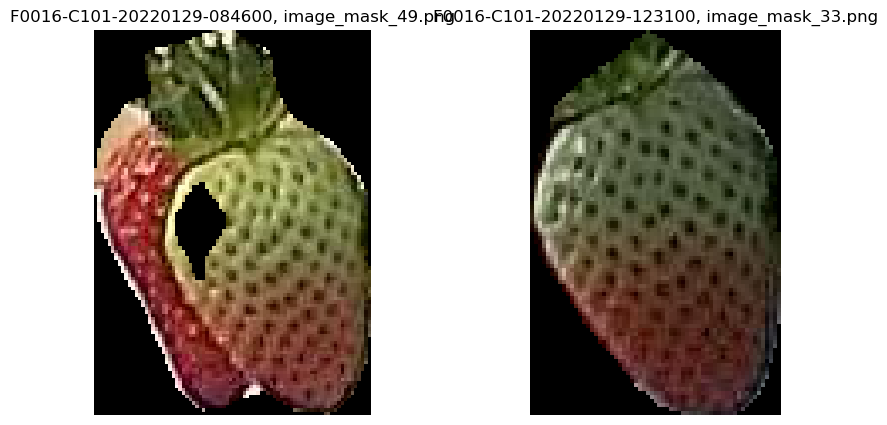

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_71
mask_id                                 2ddf428db9c52a420d9549201051ee92
point_x_x                                                    2127.287598
point_y_x                                                     415.742249
output_image_path_x                                    image_mask_71.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

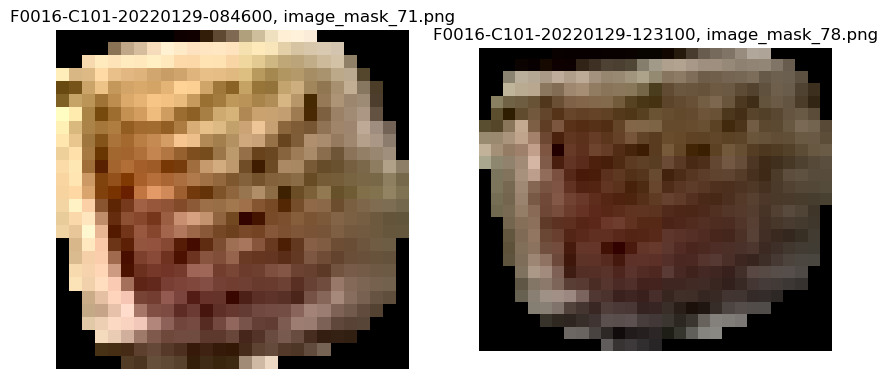

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_45
mask_id                                 2fdd4ce28f2e10bdb4e72dd346b6e245
point_x_x                                                    1434.999756
point_y_x                                                     527.660828
output_image_path_x                                    image_mask_45.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

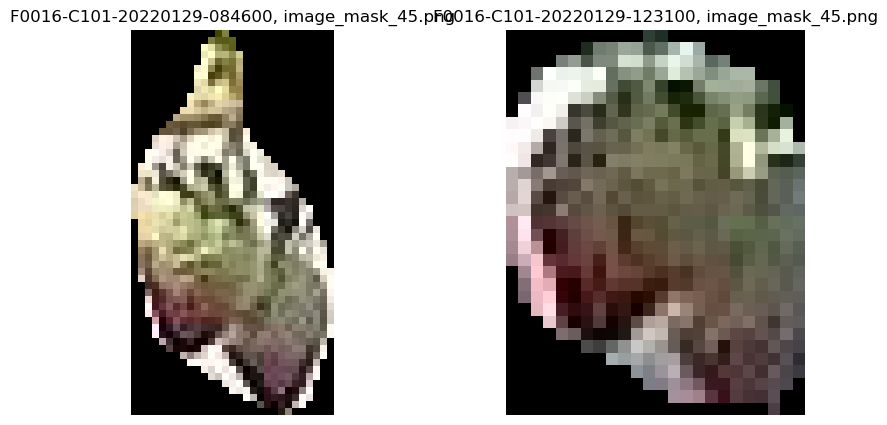

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_45
mask_id                                 2fdd4ce28f2e10bdb4e72dd346b6e245
point_x_x                                                    1434.999756
point_y_x                                                     527.660828
output_image_path_x                                    image_mask_45.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

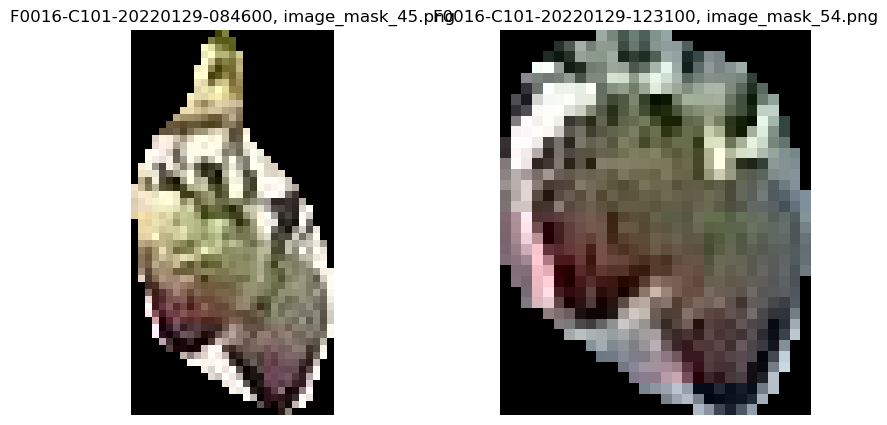

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_48
mask_id                                 2fdd4ce28f2e10bdb4e72dd346b6e245
point_x_x                                                     1429.74292
point_y_x                                                      534.99646
output_image_path_x                                    image_mask_48.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

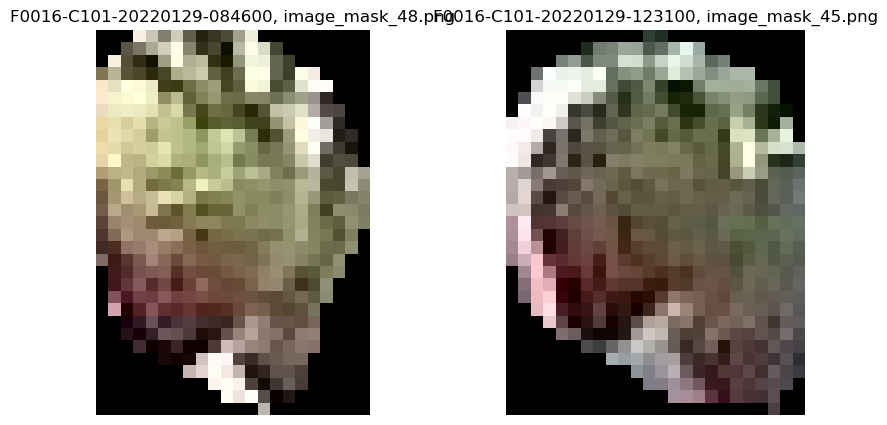

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_48
mask_id                                 2fdd4ce28f2e10bdb4e72dd346b6e245
point_x_x                                                     1429.74292
point_y_x                                                      534.99646
output_image_path_x                                    image_mask_48.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

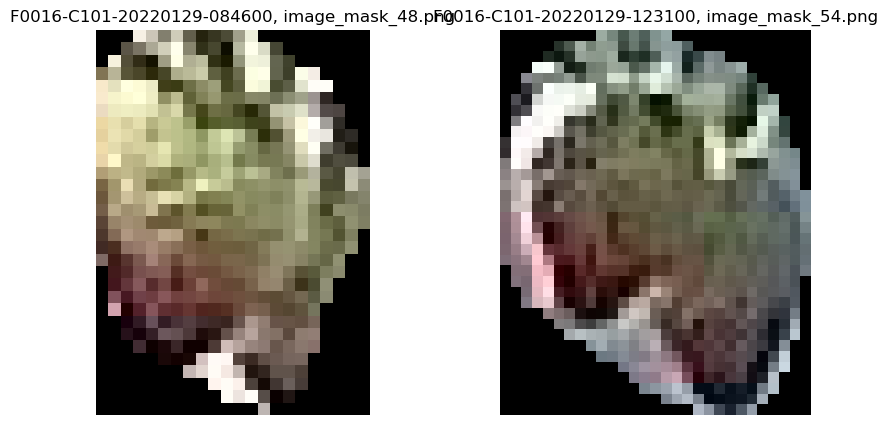

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_83
mask_id                                 3382530ccc307597971f4fa61350e7c7
point_x_x                                                    2053.278076
point_y_x                                                     194.737061
output_image_path_x                                    image_mask_83.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

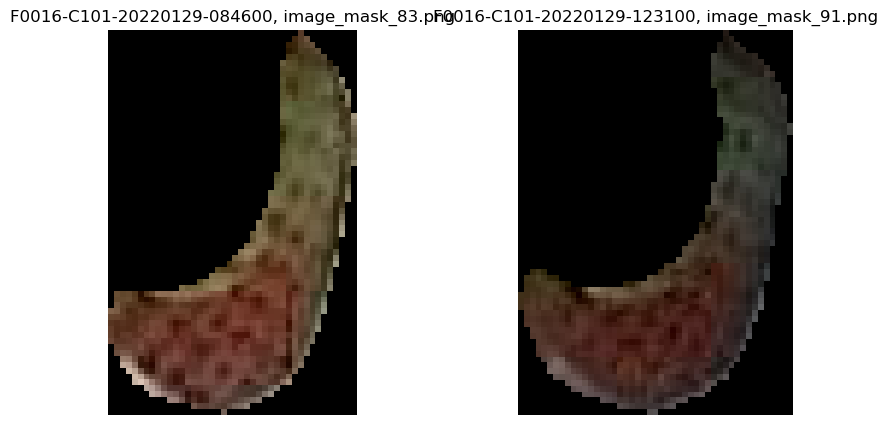

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_39
mask_id                                 37f449494e95ed5d844efd4e9d6a589e
point_x_x                                                    1601.486328
point_y_x                                                     493.527618
output_image_path_x                                    image_mask_39.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

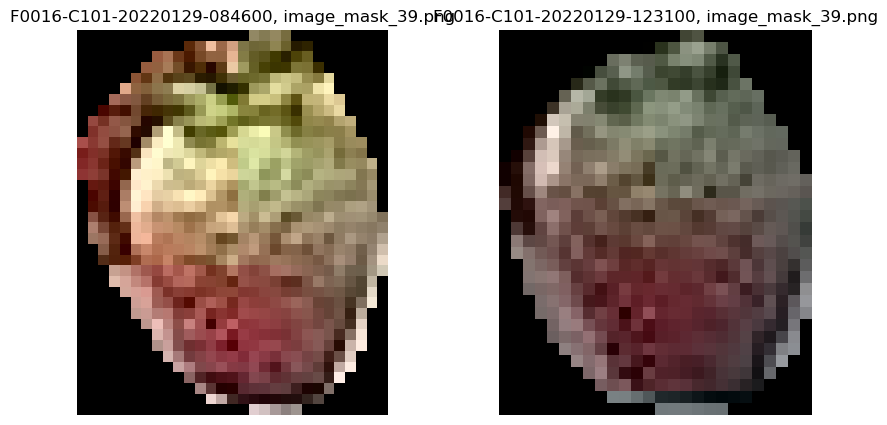

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_39
mask_id                                 37f449494e95ed5d844efd4e9d6a589e
point_x_x                                                    1601.486328
point_y_x                                                     493.527618
output_image_path_x                                    image_mask_39.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

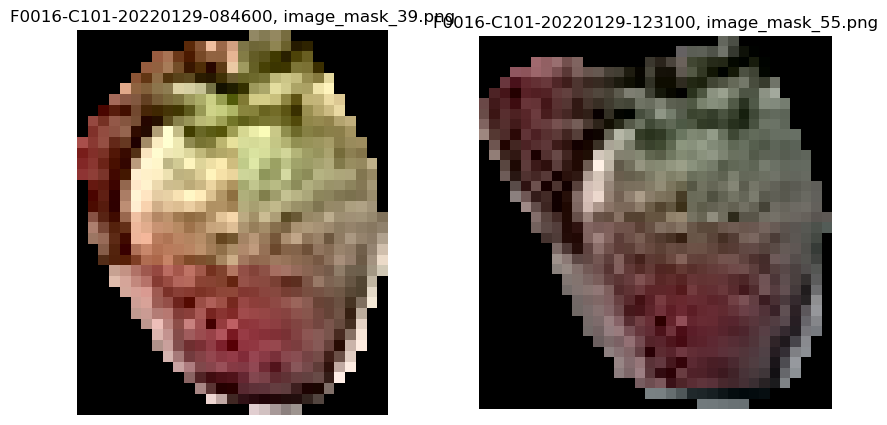

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_88
mask_id                                 3dc30a4dad232a6b337a4d558b47245c
point_x_x                                                     2052.46875
point_y_x                                                     452.614349
output_image_path_x                                    image_mask_88.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

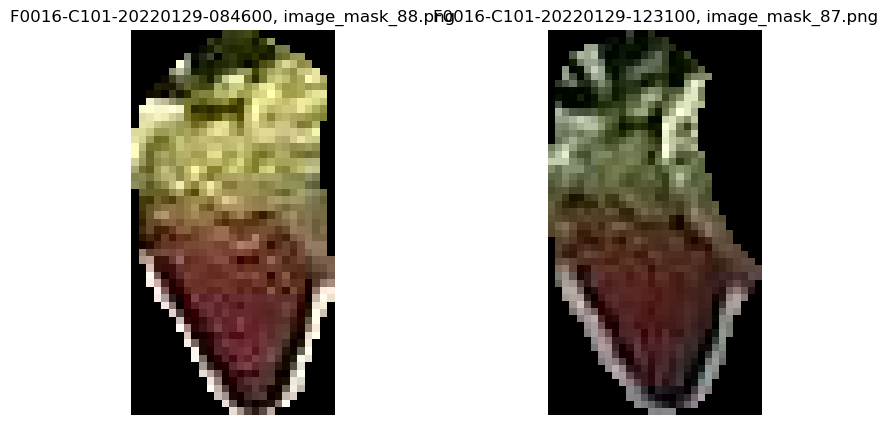

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_15
mask_id                                 3f0ab6c7b4ad3b01877996ceed23162a
point_x_x                                                     994.086426
point_y_x                                                     410.228333
output_image_path_x                                    image_mask_15.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

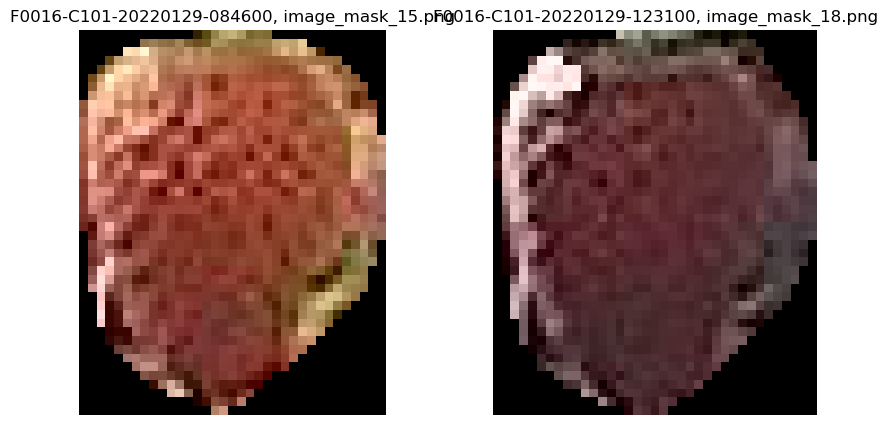

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_32
mask_id                                 3f6f815e14655e80d521791aa2086401
point_x_x                                                    1388.317017
point_y_x                                                     274.803345
output_image_path_x                                    image_mask_32.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

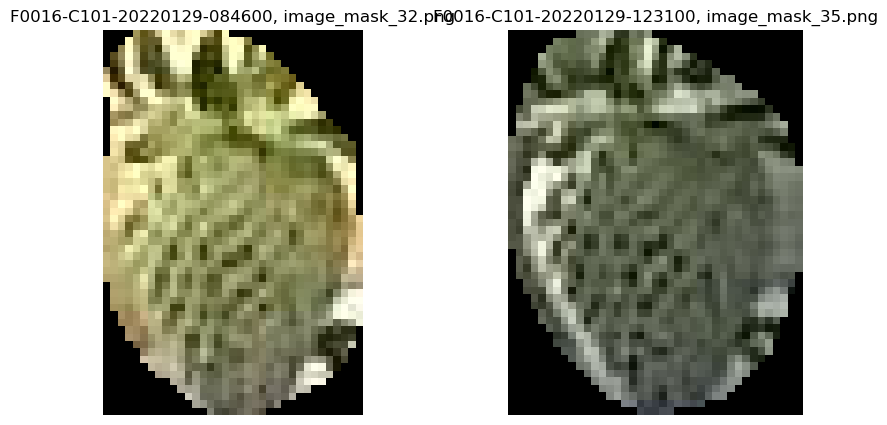

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_47
mask_id                                 40a4c3c743e56e61386f083e543f4bbc
point_x_x                                                    1420.333862
point_y_x                                                     303.906982
output_image_path_x                                    image_mask_47.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

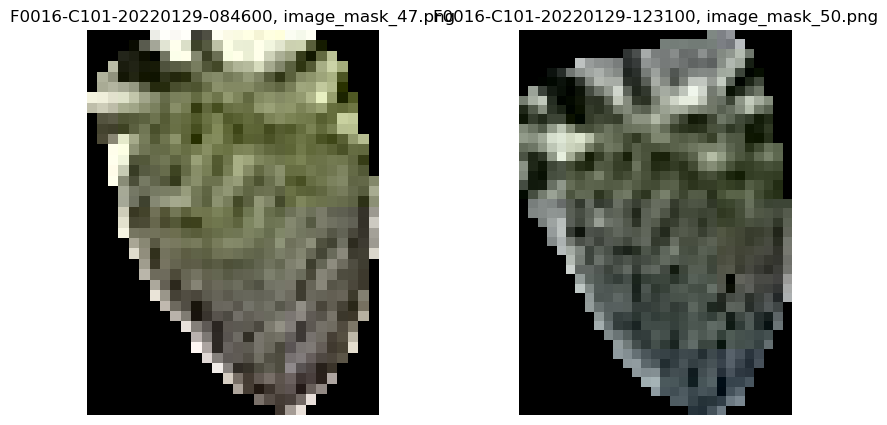

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_60
mask_id                                 41a8f91f1272668db471bb1b0954e314
point_x_x                                                    1334.520996
point_y_x                                                     293.213135
output_image_path_x                                    image_mask_60.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

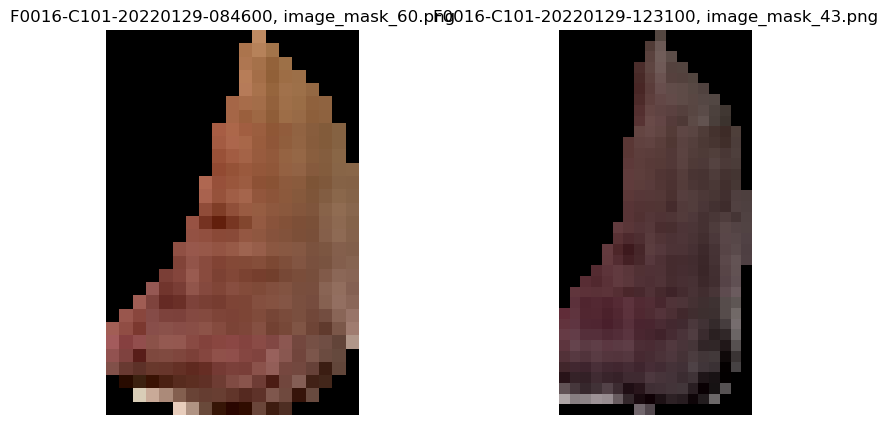

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_36
mask_id                                 42b755924f8868c54a81e7c84e22166a
point_x_x                                                    1811.719727
point_y_x                                                       234.6745
output_image_path_x                                    image_mask_36.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

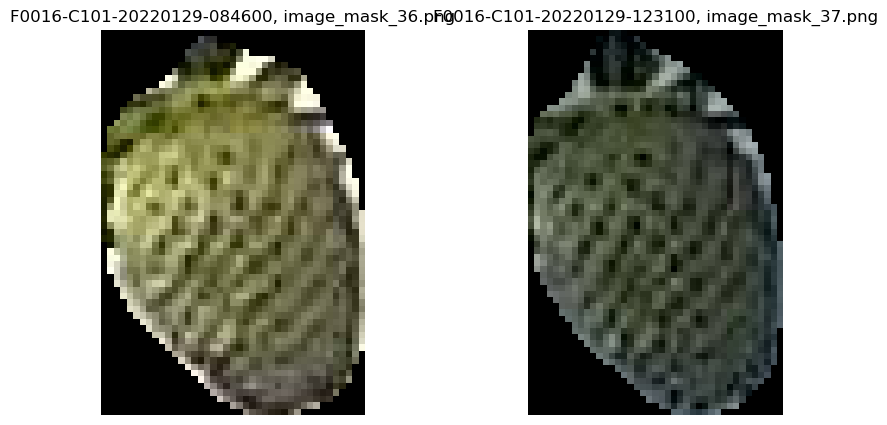

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_19
mask_id                                 4324212bf0c794ff90cd1276ee1d5621
point_x_x                                                      791.41095
point_y_x                                                     453.879395
output_image_path_x                                    image_mask_19.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

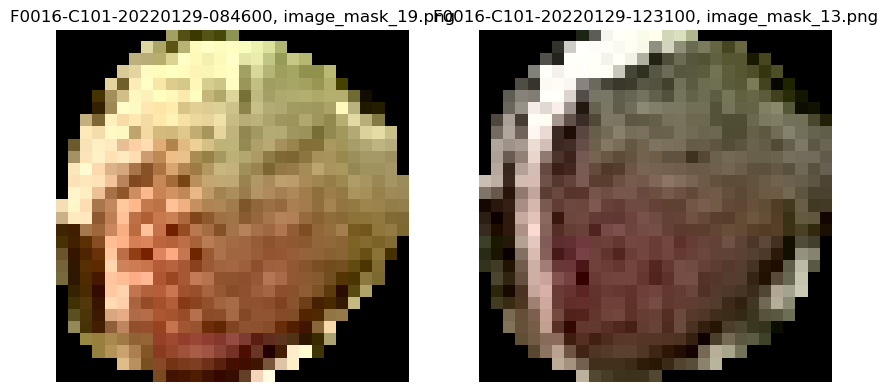

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_77
mask_id                                 45ad57036438c74b032507c0d8bf189e
point_x_x                                                    2012.967773
point_y_x                                                     423.442993
output_image_path_x                                    image_mask_77.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

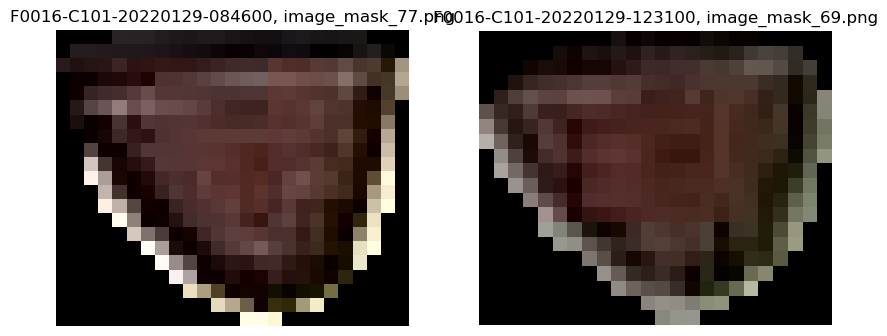

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_73
mask_id                                 4e06c5a157540a05bcdac96725fe36d6
point_x_x                                                    2104.009033
point_y_x                                                     430.057068
output_image_path_x                                    image_mask_73.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

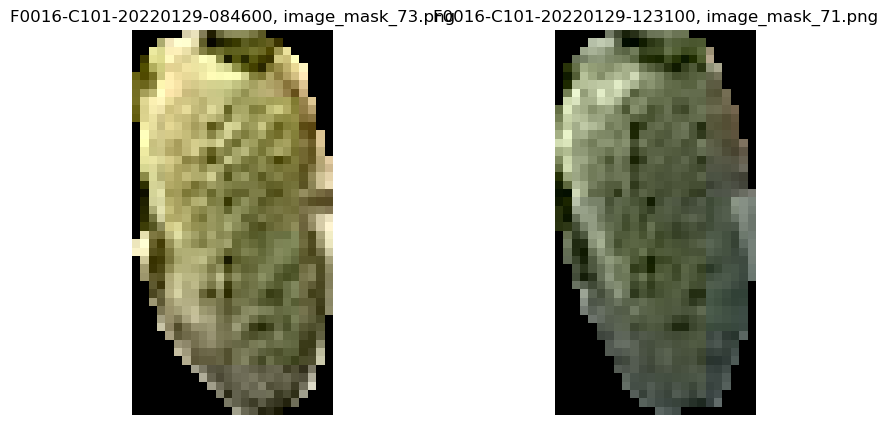

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_50
mask_id                                 546330e042247a7d7519c3c4d4590a85
point_x_x                                                      1614.4375
point_y_x                                                     113.394592
output_image_path_x                                    image_mask_50.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

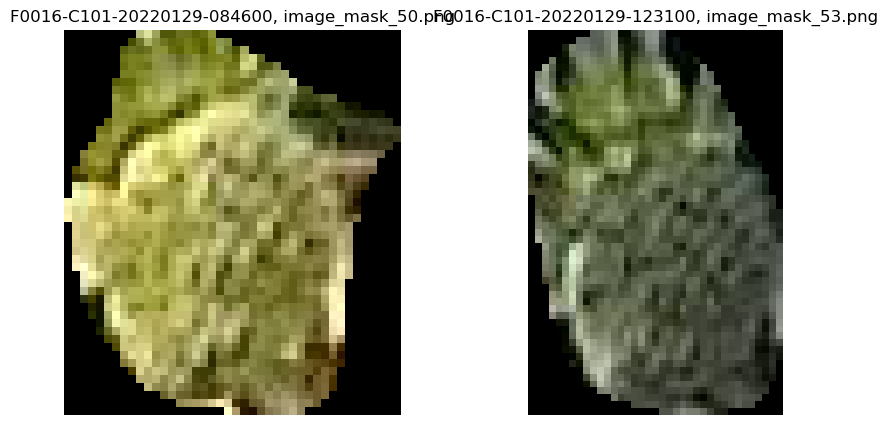

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_64
mask_id                                 54d3a82a27503b529dc629507880234c
point_x_x                                                    1848.173584
point_y_x                                                     197.574493
output_image_path_x                                    image_mask_64.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

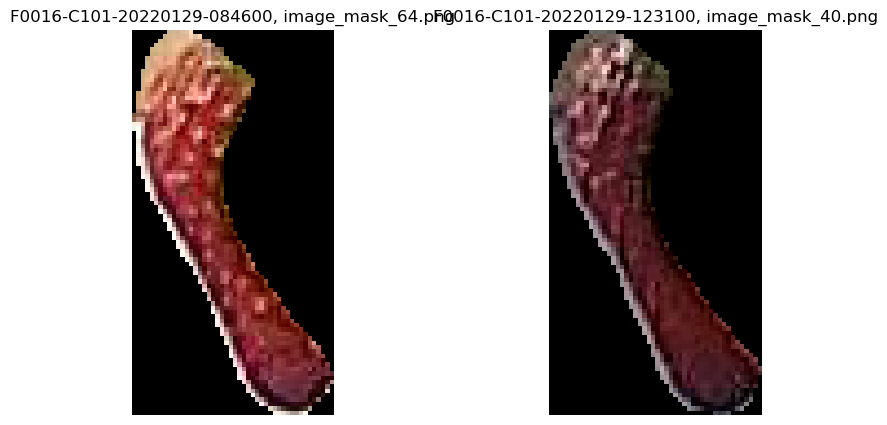

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_66
mask_id                                 572998da58ce05711f3b8fbf816e4afc
point_x_x                                                    2248.962891
point_y_x                                                     118.589142
output_image_path_x                                    image_mask_66.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

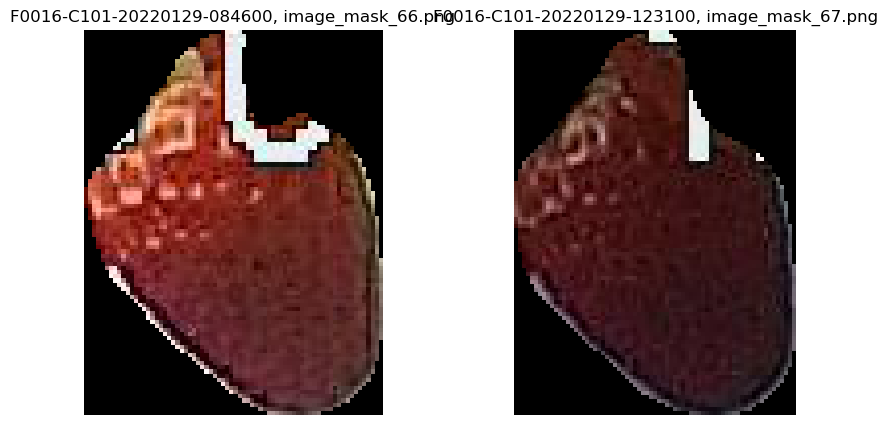

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_18
mask_id                                 661219b901520d66f436eb66c521c33a
point_x_x                                                    1010.210632
point_y_x                                                     445.154633
output_image_path_x                                    image_mask_18.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

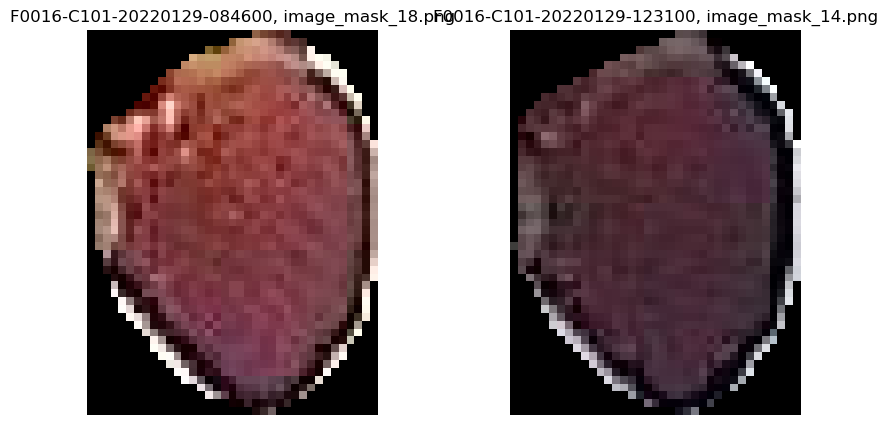

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_25
mask_id                                 661219b901520d66f436eb66c521c33a
point_x_x                                                    1003.565125
point_y_x                                                     444.672607
output_image_path_x                                    image_mask_25.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

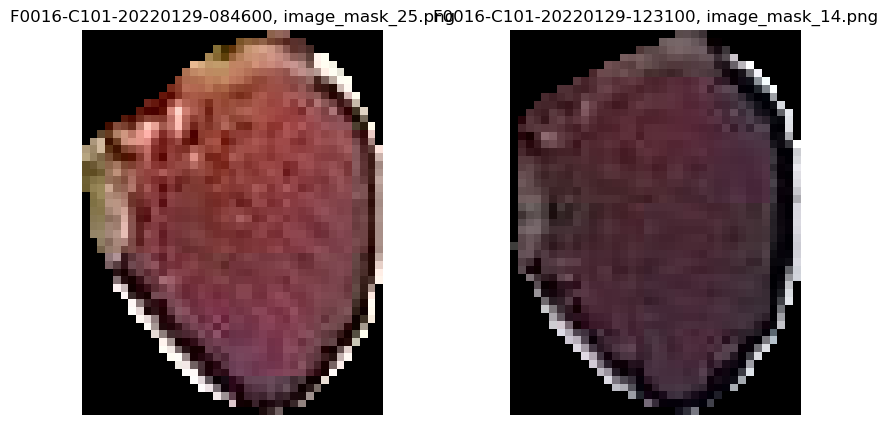

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_11
mask_id                                 698ef0c1d268bf4a8603f59f40148a00
point_x_x                                                     587.775208
point_y_x                                                      47.849144
output_image_path_x                                    image_mask_11.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

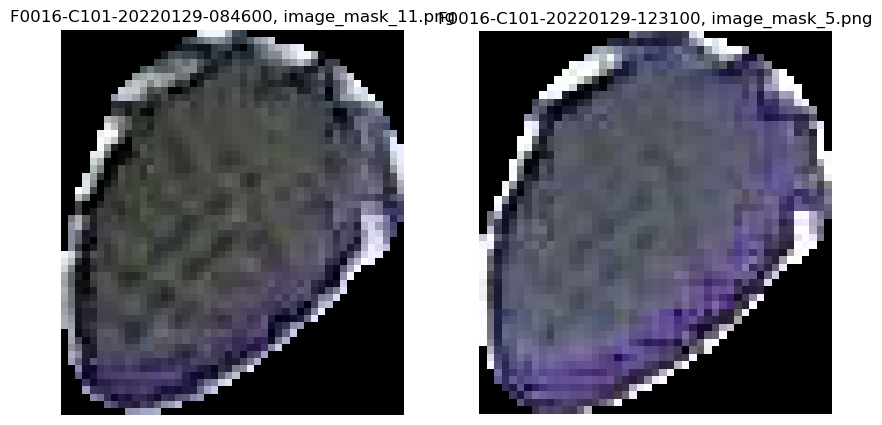

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_54
mask_id                                 6c3a7fca309cf761a6e3d0c0eabc6118
point_x_x                                                    1827.537109
point_y_x                                                      37.237225
output_image_path_x                                    image_mask_54.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

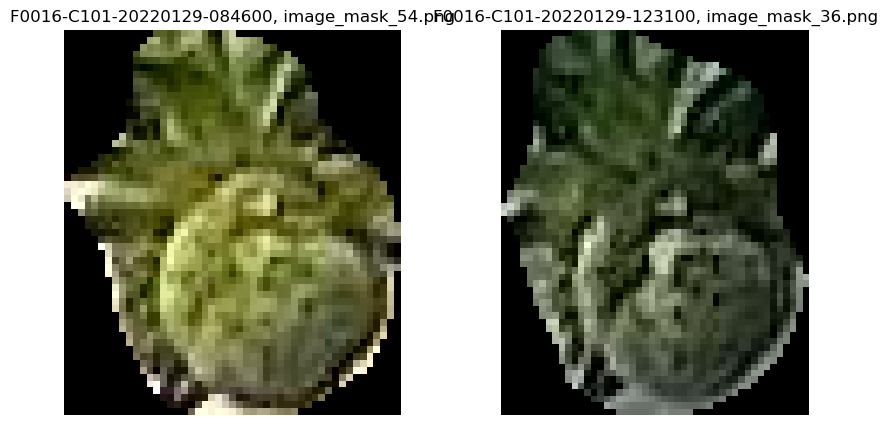

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_31
mask_id                                 6c76c90aa2dac6c06cb537cf18f7e238
point_x_x                                                    1496.549561
point_y_x                                                     254.082565
output_image_path_x                                    image_mask_31.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

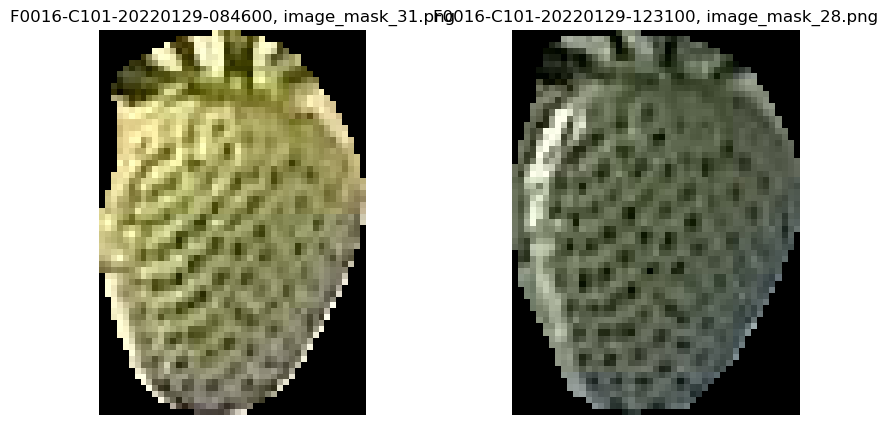

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_24
mask_id                                 70e08d34cf0c734da0c94cd8cfb10c3f
point_x_x                                                    1099.391357
point_y_x                                                     401.222229
output_image_path_x                                    image_mask_24.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

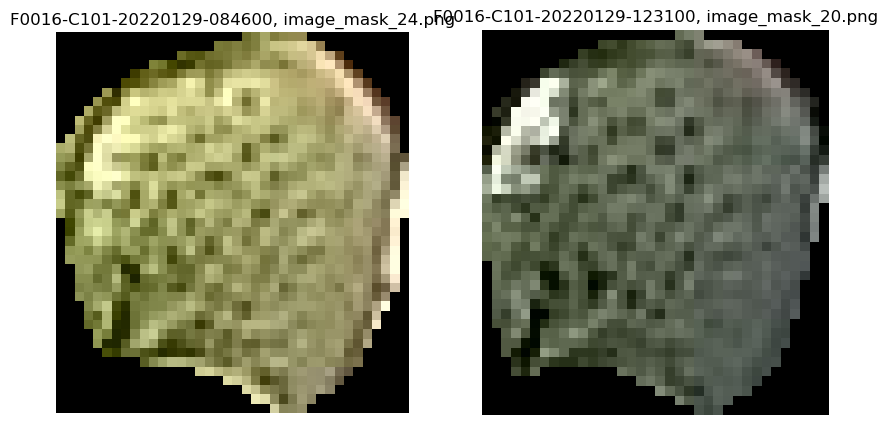

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_93
mask_id                                 7b5c63f2c876b9b8c7ab2db7e45dc50c
point_x_x                                                    2188.460449
point_y_x                                                      94.141396
output_image_path_x                                    image_mask_93.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

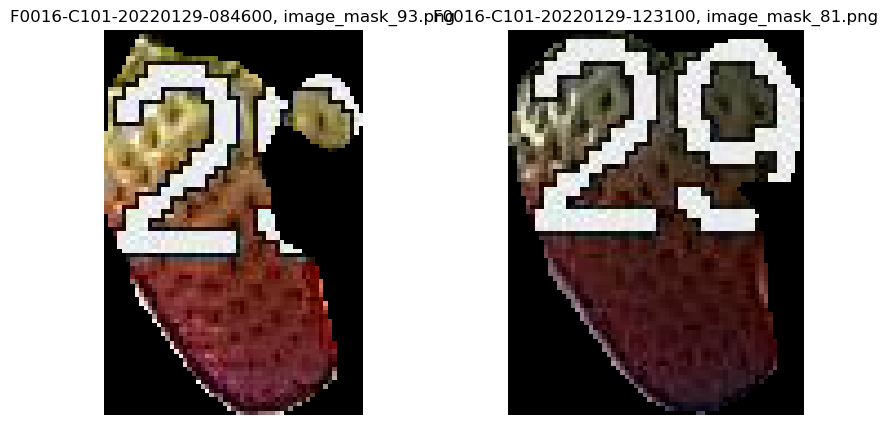

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_80
mask_id                                 7bf102c56c369f629af1fac1a3023222
point_x_x                                                       2301.125
point_y_x                                                      67.608215
output_image_path_x                                    image_mask_80.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

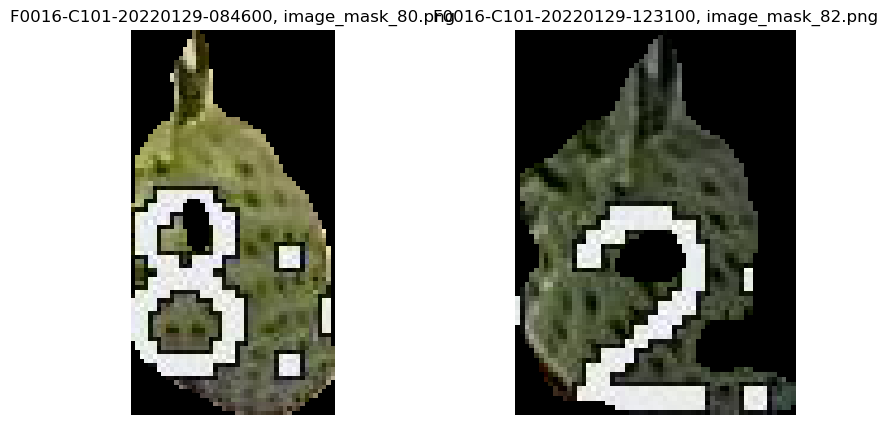

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_92
mask_id                                 8d2bcaee8880dafa889363b28ba9be9f
point_x_x                                                    2067.665039
point_y_x                                                     443.457214
output_image_path_x                                    image_mask_92.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

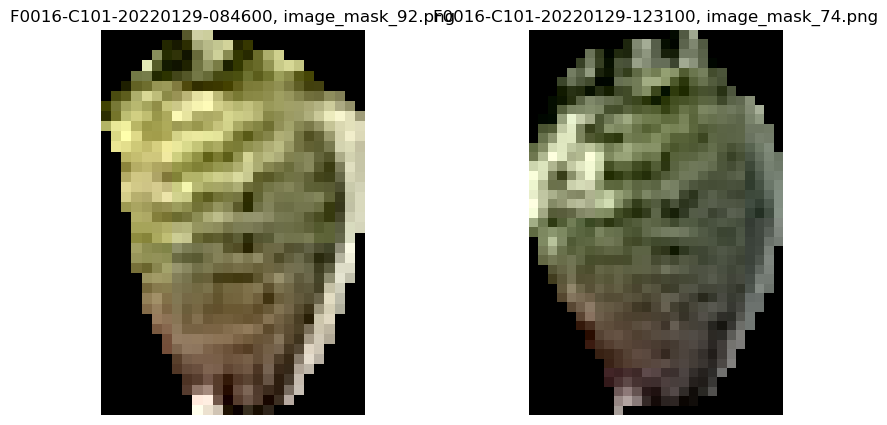

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_16
mask_id                                 8dc004a0512712405b12c1034650ce1d
point_x_x                                                    1092.718506
point_y_x                                                     441.400818
output_image_path_x                                    image_mask_16.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

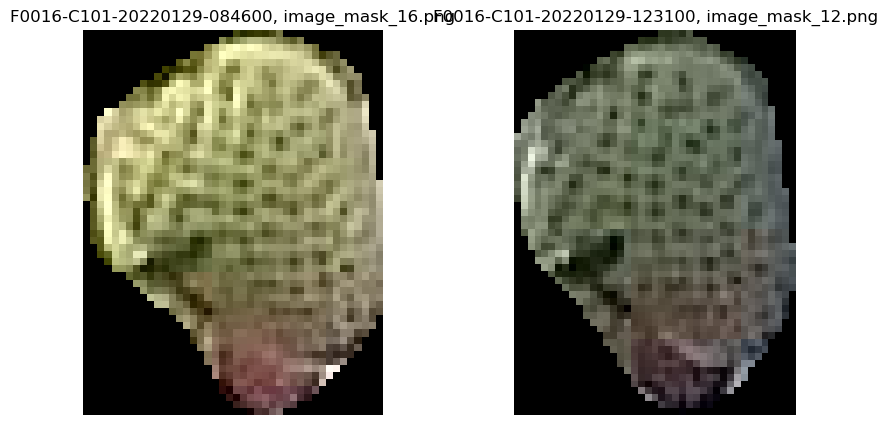

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_81
mask_id                                 923e1da268ba876a38ac0d15ed7cf9e6
point_x_x                                                    2149.313965
point_y_x                                                     408.598877
output_image_path_x                                    image_mask_81.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

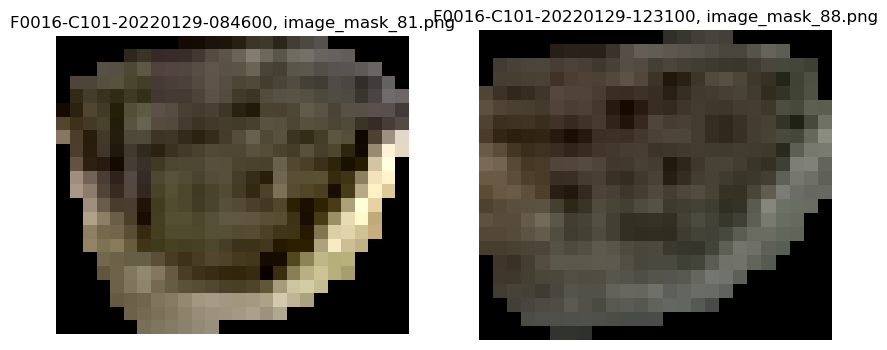

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_40
mask_id                                 971d06c85695c906eadb8f0fdac6d1ba
point_x_x                                                    1561.665894
point_y_x                                                     299.036133
output_image_path_x                                    image_mask_40.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

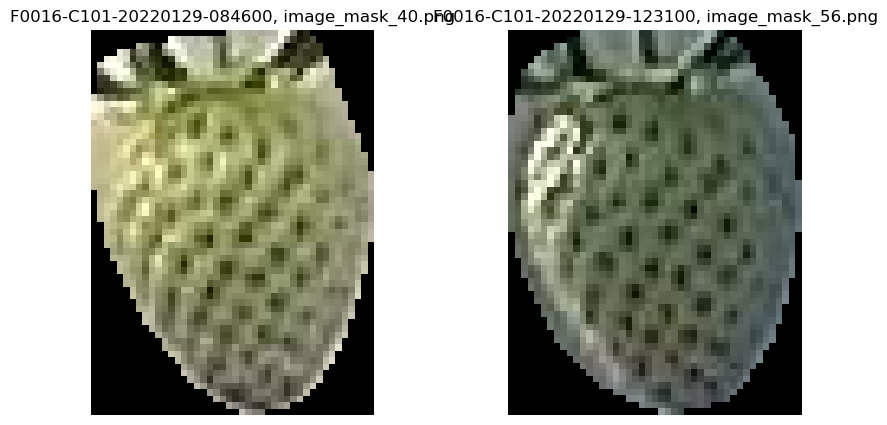

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_65
mask_id                                 9b23ca6fd334b4daecdee2bd34126062
point_x_x                                                    1906.120239
point_y_x                                                     182.899384
output_image_path_x                                    image_mask_65.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

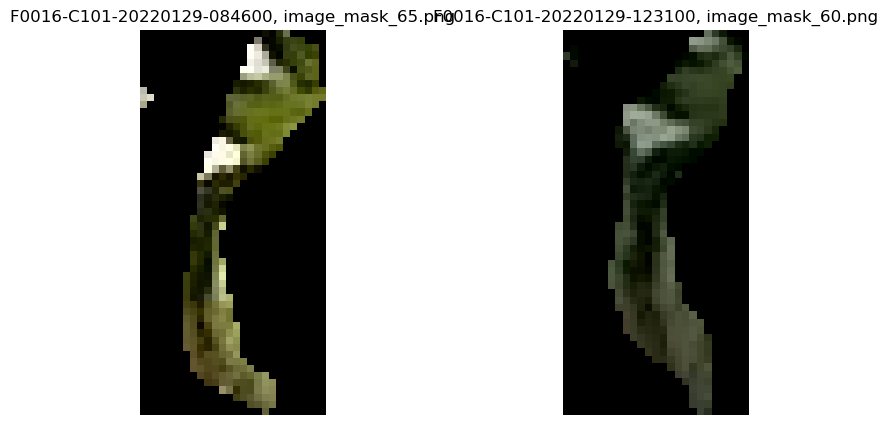

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_42
mask_id                                 a0a2ee683b41a6cdd2b61df45c2079a7
point_x_x                                                    1679.767456
point_y_x                                                     473.116058
output_image_path_x                                    image_mask_42.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

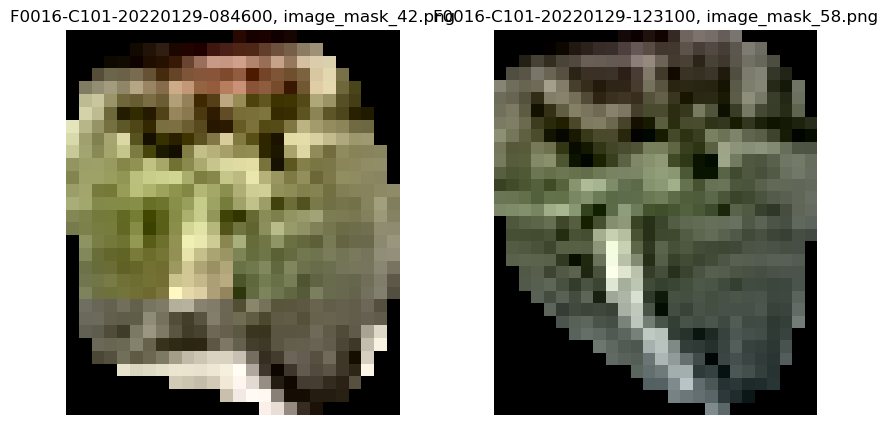

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_14
mask_id                                 a7317caee3d4527908d0615ddb01809f
point_x_x                                                     652.869263
point_y_x                                                     566.642944
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

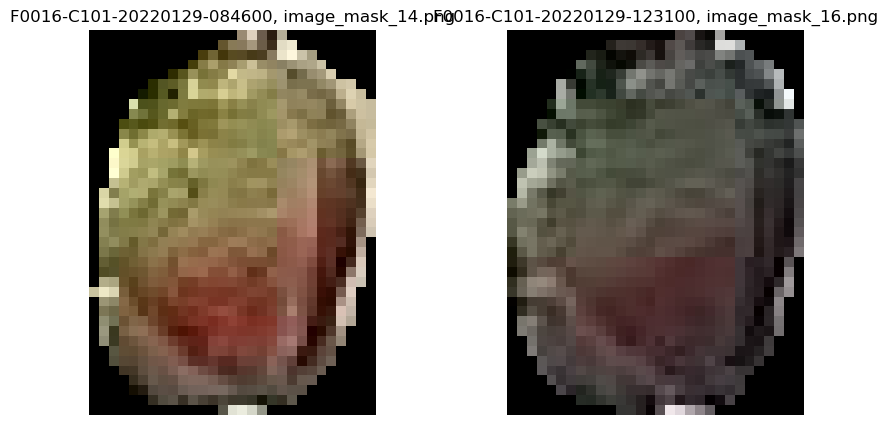

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_68
mask_id                                 b3849048ddbd05bee94622b4eb671845
point_x_x                                                    2074.282471
point_y_x                                                     136.724121
output_image_path_x                                    image_mask_68.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

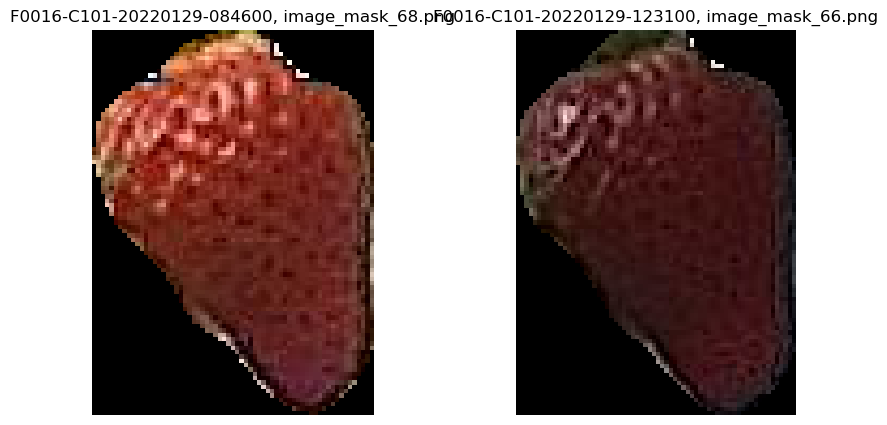

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_86
mask_id                                 b385814f48cbffb4559a453616504f58
point_x_x                                                    2536.283691
point_y_x                                                     375.351929
output_image_path_x                                    image_mask_86.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

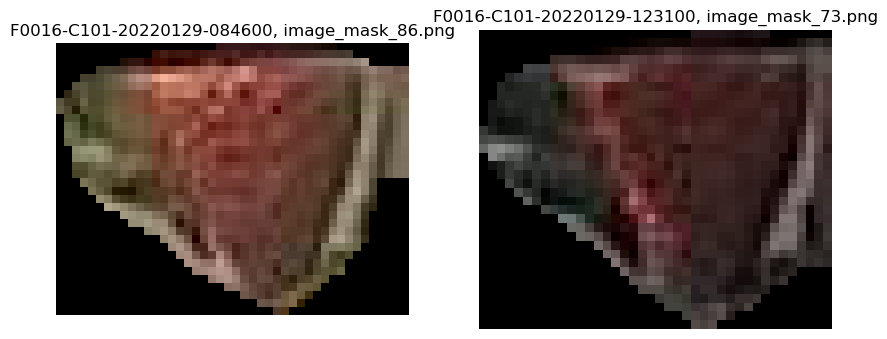

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_67
mask_id                                 b4720602b377bacde44539fba49926d8
point_x_x                                                    1942.307617
point_y_x                                                     188.930939
output_image_path_x                                    image_mask_67.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

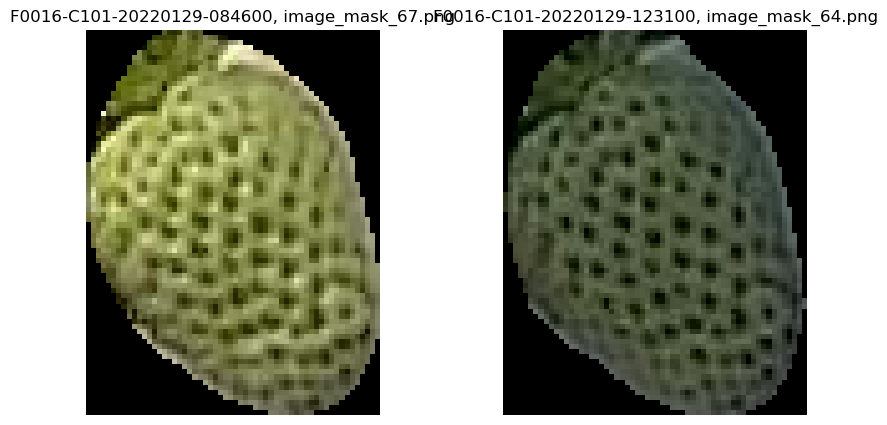

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_75
mask_id                                 b79a7cf3d31ef9753564e24245ee7db3
point_x_x                                                    2484.006836
point_y_x                                                     446.704773
output_image_path_x                                    image_mask_75.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

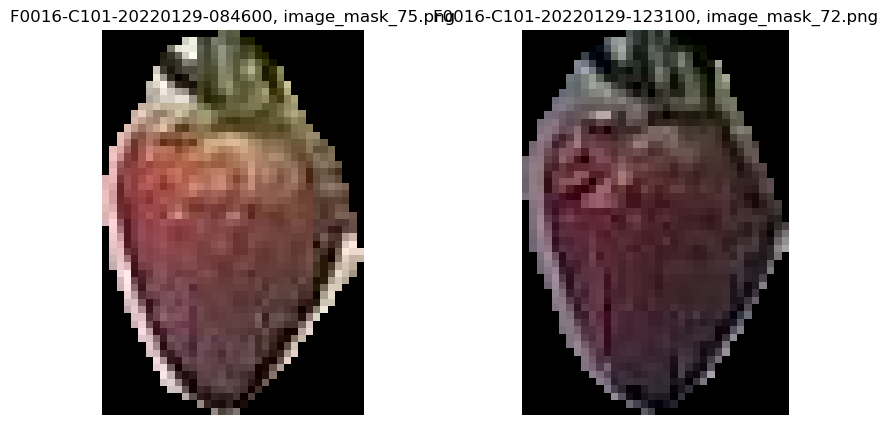

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_21
mask_id                                 ba68da91dea457857c64e5947b887b0e
point_x_x                                                     832.118225
point_y_x                                                     474.521179
output_image_path_x                                    image_mask_21.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

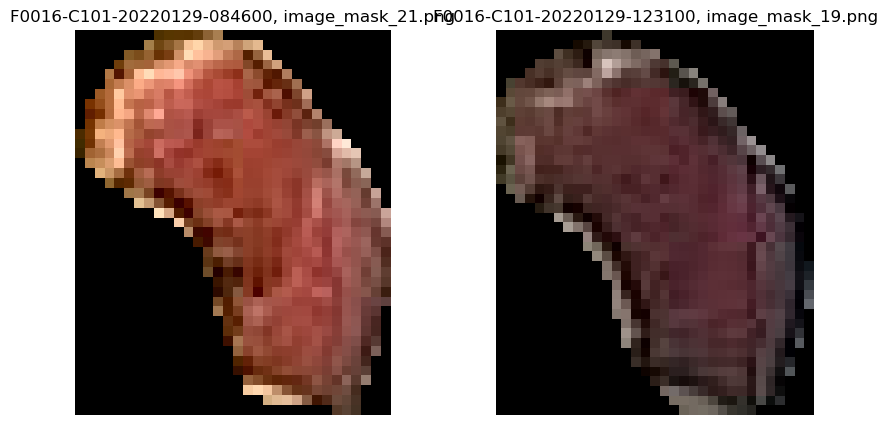

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_35
mask_id                                 c0743485c9da0b624366c665fe9dd42f
point_x_x                                                    1763.119873
point_y_x                                                     228.707642
output_image_path_x                                    image_mask_35.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

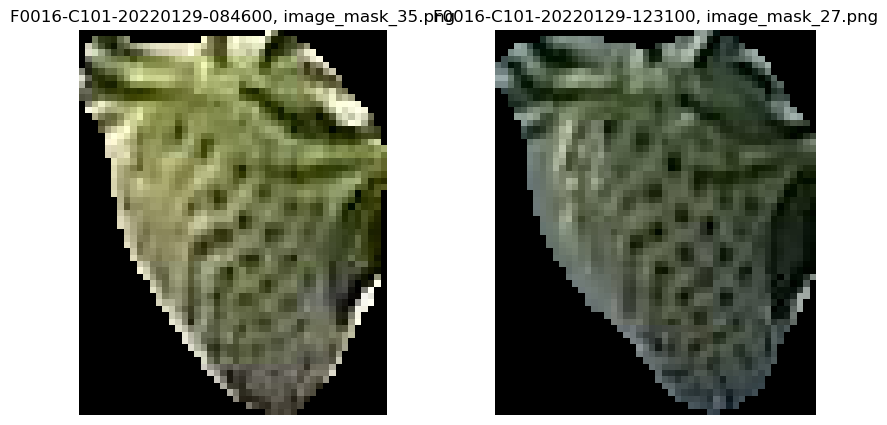

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                  F0016-C101-20220129-084600_2
mask_id                                 c266931fb5984e935ca50001181700a0
point_x_x                                                     486.035645
point_y_x                                                      205.68277
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

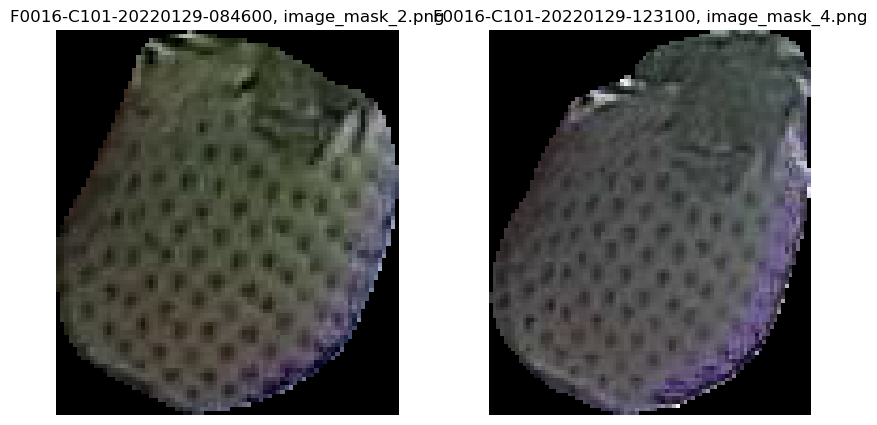

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_87
mask_id                                 da63c36cd9d9612160e29597c569c2d6
point_x_x                                                    2195.810059
point_y_x                                                     413.958923
output_image_path_x                                    image_mask_87.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

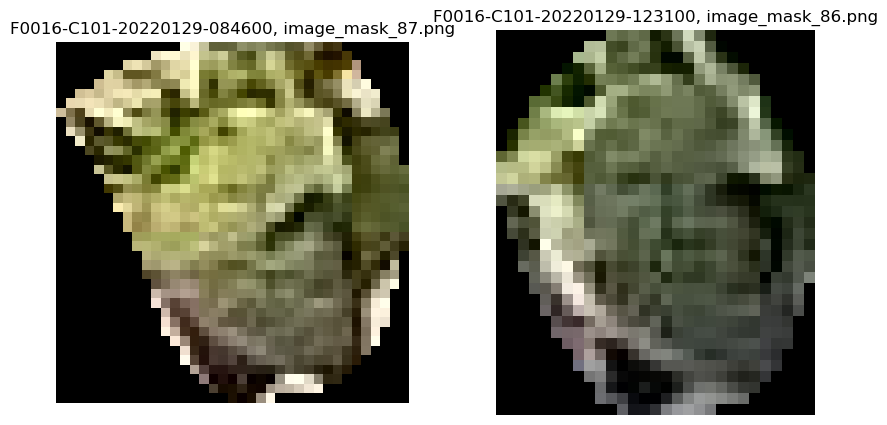

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_87
mask_id                                 da63c36cd9d9612160e29597c569c2d6
point_x_x                                                    2195.810059
point_y_x                                                     413.958923
output_image_path_x                                    image_mask_87.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

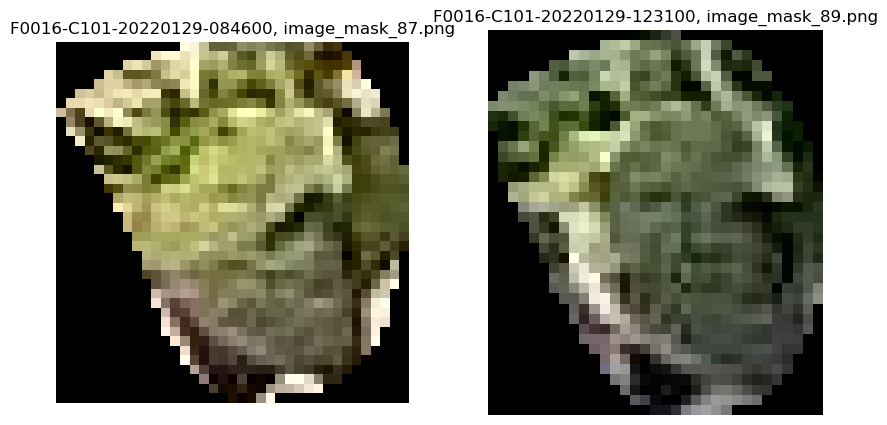

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_89
mask_id                                 de3341b5f5402ba3ead27233ab692de2
point_x_x                                                    2229.911133
point_y_x                                                     414.487457
output_image_path_x                                    image_mask_89.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

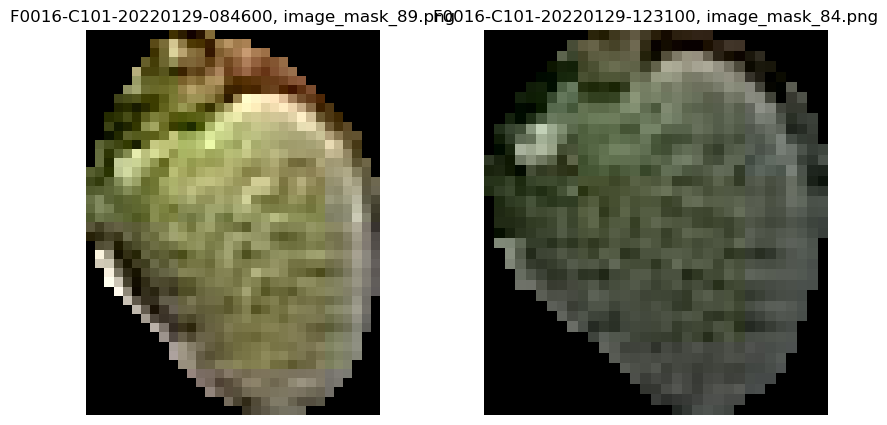

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_28
mask_id                                 ded49c7723d1e33f445245f10e2612b6
point_x_x                                                     897.526367
point_y_x                                                     423.947205
output_image_path_x                                    image_mask_28.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

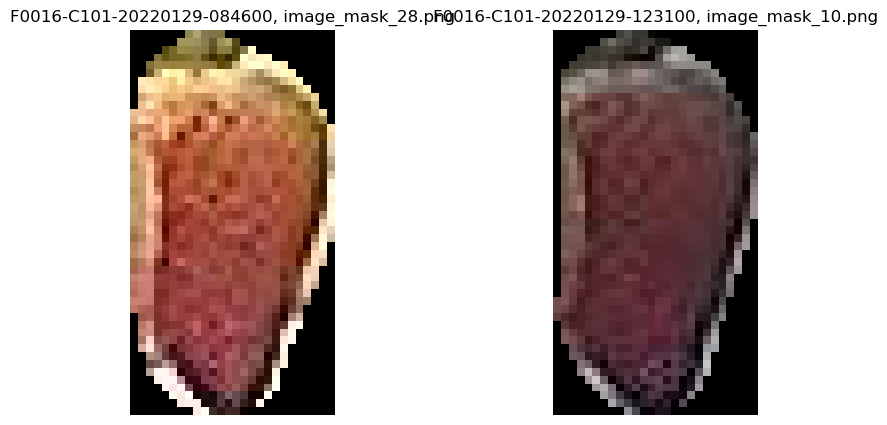

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_38
mask_id                                 dfe6011ee08944d5dcd888ec7ae3c5ea
point_x_x                                                    1452.401367
point_y_x                                                     293.474701
output_image_path_x                                    image_mask_38.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

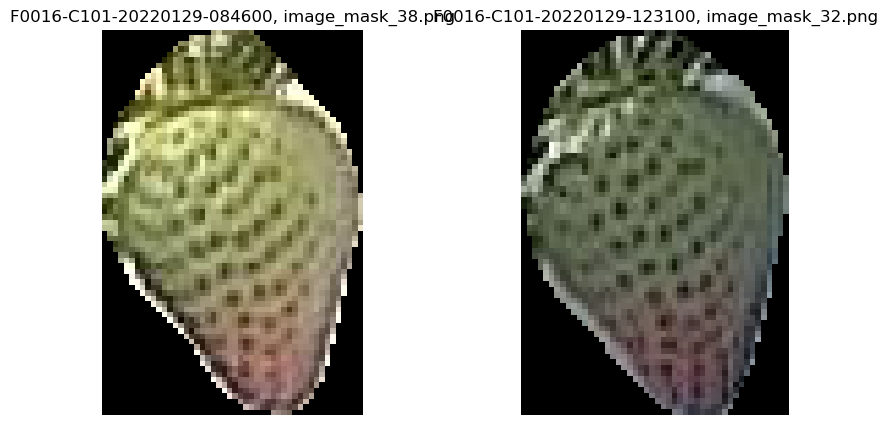

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_76
mask_id                                 e0f96d917577ddf4df52cc4b4aff3bae
point_x_x                                                    1932.927612
point_y_x                                                     439.708618
output_image_path_x                                    image_mask_76.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

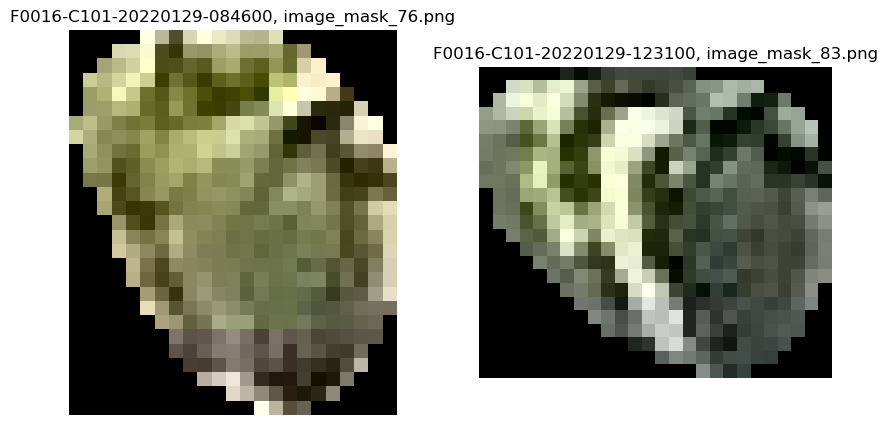

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_78
mask_id                                 e7f0bdc9d33073330b027b8ef8f1e328
point_x_x                                                    2006.325073
point_y_x                                                       214.8526
output_image_path_x                                    image_mask_78.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

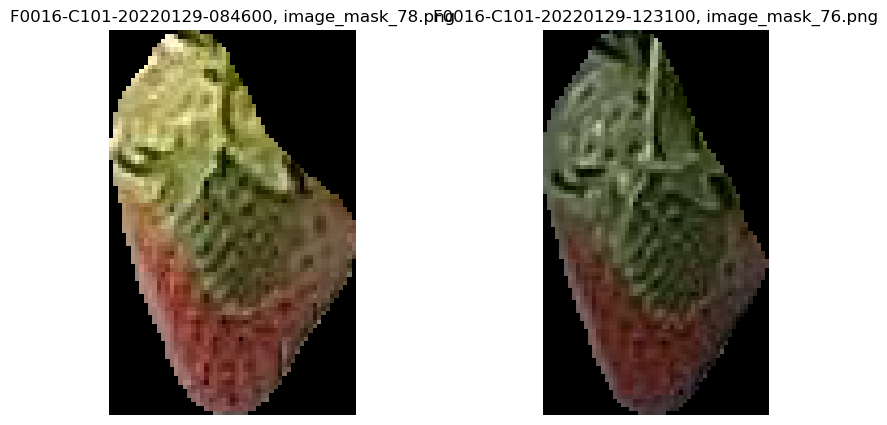

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_26
mask_id                                 e801a194cac949d955eedc5052e03832
point_x_x                                                    1268.357666
point_y_x                                                     288.683228
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

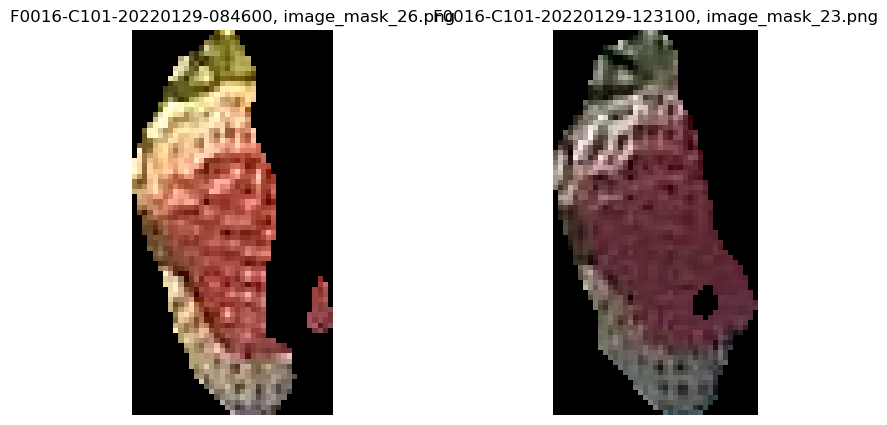

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_84
mask_id                                 eb663da7a56800343c0548a807acf1f7
point_x_x                                                    2023.937988
point_y_x                                                     450.803162
output_image_path_x                                    image_mask_84.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

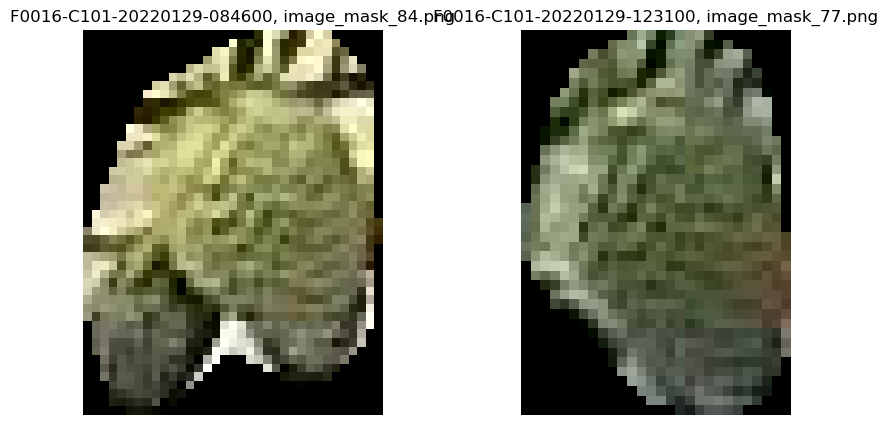

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_34
mask_id                                 efaaa063fa8d1c6b3409db70b1b225d8
point_x_x                                                    1525.424316
point_y_x                                                     181.633667
output_image_path_x                                    image_mask_34.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

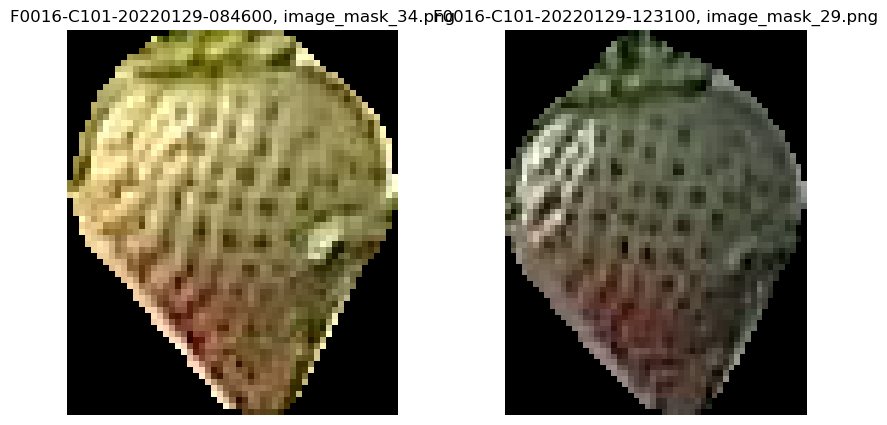

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_43
mask_id                                 f232d6dbcdf460dc945cca06d030e52a
point_x_x                                                    1511.993896
point_y_x                                                     501.610626
output_image_path_x                                    image_mask_43.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

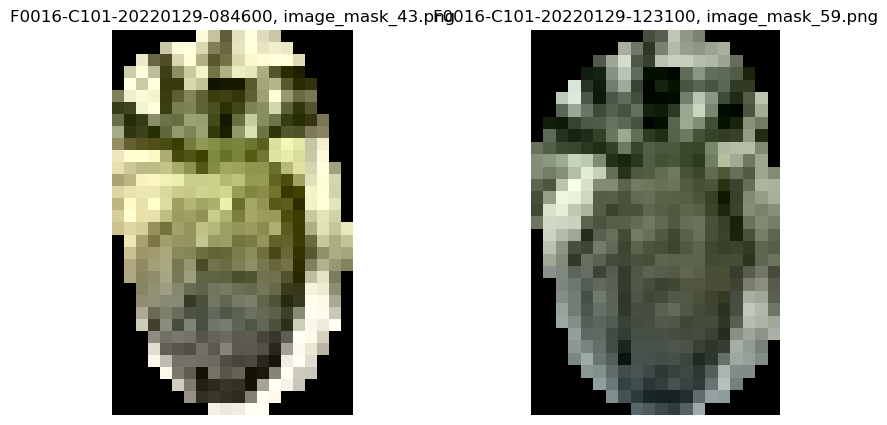

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                 F0016-C101-20220129-084600_72
mask_id                                 f477efcc4b1ad12196cbc60d46b48b47
point_x_x                                                    2503.413086
point_y_x                                                     427.617432
output_image_path_x                                    image_mask_72.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

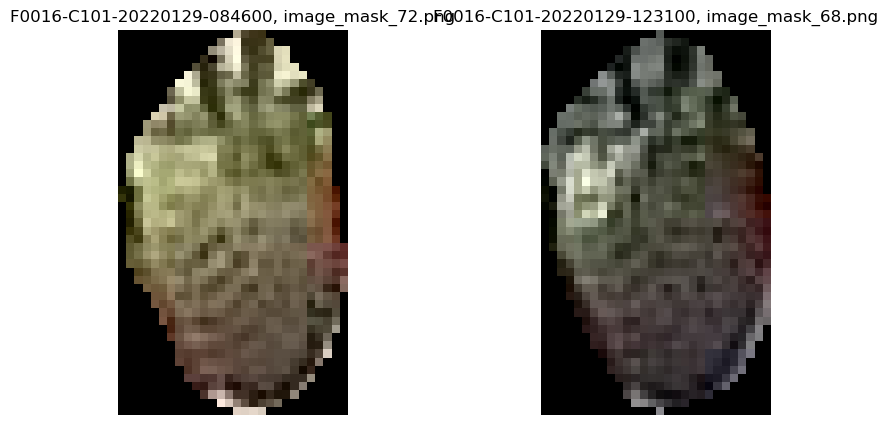

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-084600
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220128-170000
mask_num_x                                  F0016-C101-20220129-084600_7
mask_id                                 f49500569b020fb2fd0fc61e13cf8303
point_x_x                                                      324.53595
point_y_x                                                     405.750427
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220129-123100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

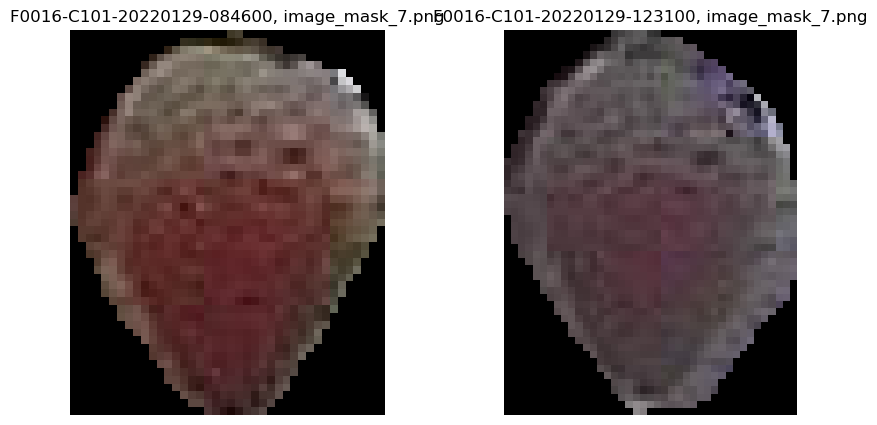

In [135]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_50
mask_id                                 1b75ccc12c15aada9736fc02d82e1f94
point_x_x                                                    1876.588013
point_y_x                                                      29.487858
output_image_path_x                                    image_mask_50.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

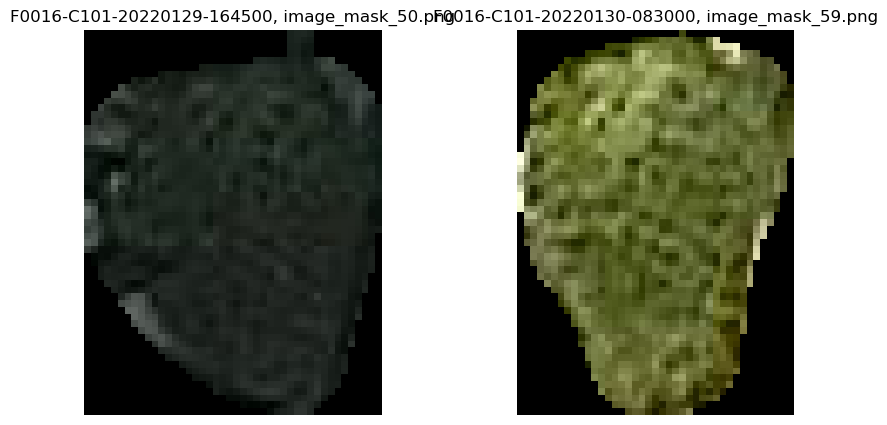

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_16
mask_id                                 277d15794214dd88cd6b15ad989fbe9e
point_x_x                                                     870.459717
point_y_x                                                     431.677124
output_image_path_x                                    image_mask_16.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

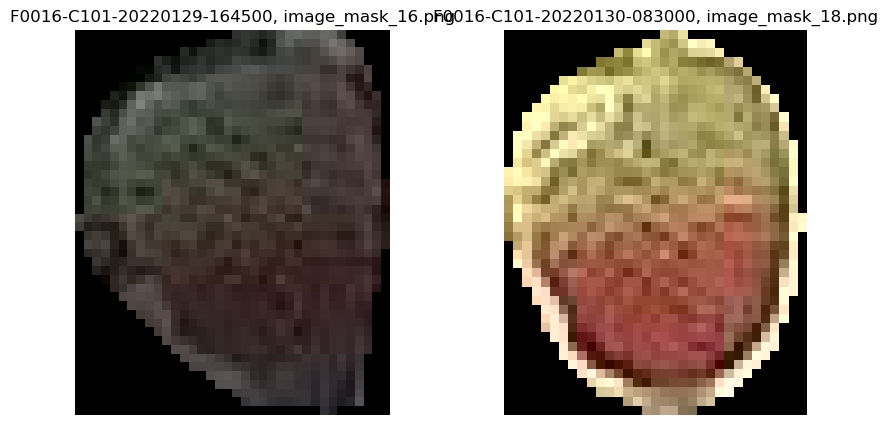

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_61
mask_id                                 2ddf428db9c52a420d9549201051ee92
point_x_x                                                     2129.98877
point_y_x                                                     418.657196
output_image_path_x                                    image_mask_61.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

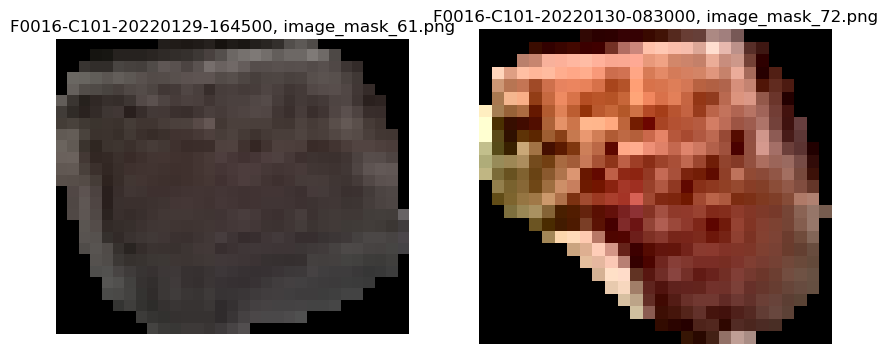

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_70
mask_id                                 3dc30a4dad232a6b337a4d558b47245c
point_x_x                                                    2054.500488
point_y_x                                                     455.954651
output_image_path_x                                    image_mask_70.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

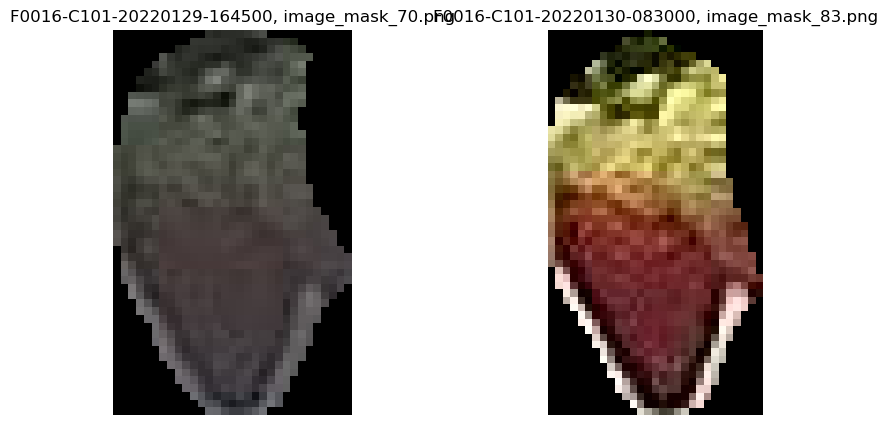

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_32
mask_id                                 3f6f815e14655e80d521791aa2086401
point_x_x                                                    1388.371094
point_y_x                                                     277.891327
output_image_path_x                                    image_mask_32.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

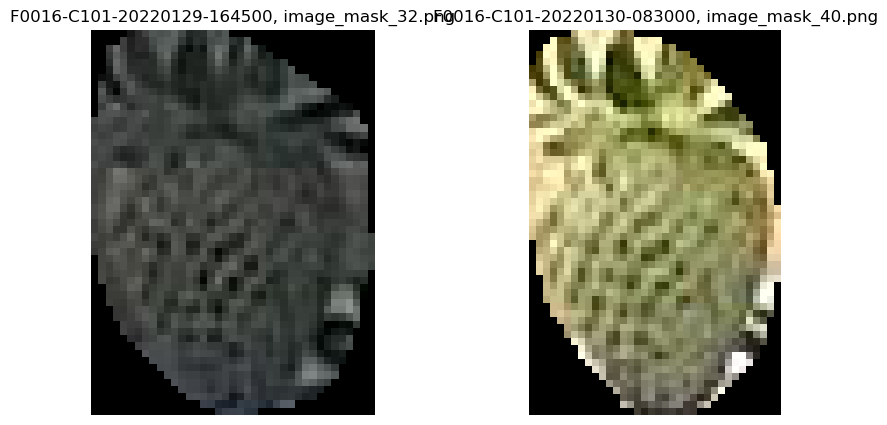

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_41
mask_id                                 40a4c3c743e56e61386f083e543f4bbc
point_x_x                                                    1417.626953
point_y_x                                                     304.476929
output_image_path_x                                    image_mask_41.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

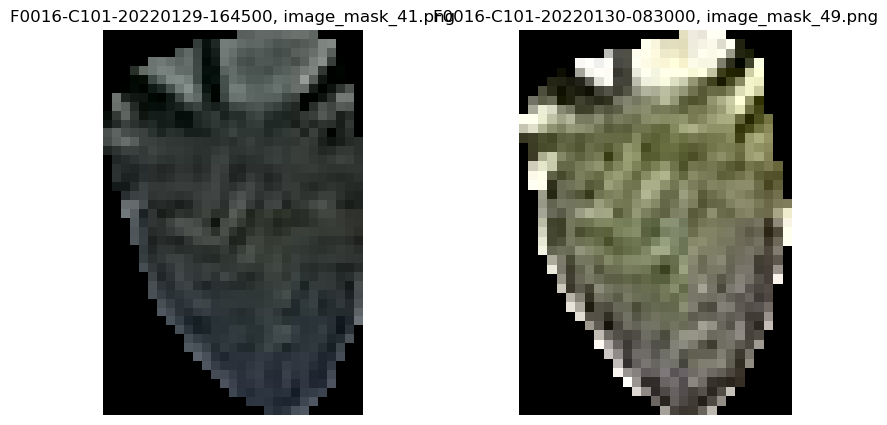

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_56
mask_id                                 4741028c57c0ac30995c2b94299c06e7
point_x_x                                                    1978.885986
point_y_x                                                     449.066284
output_image_path_x                                    image_mask_56.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

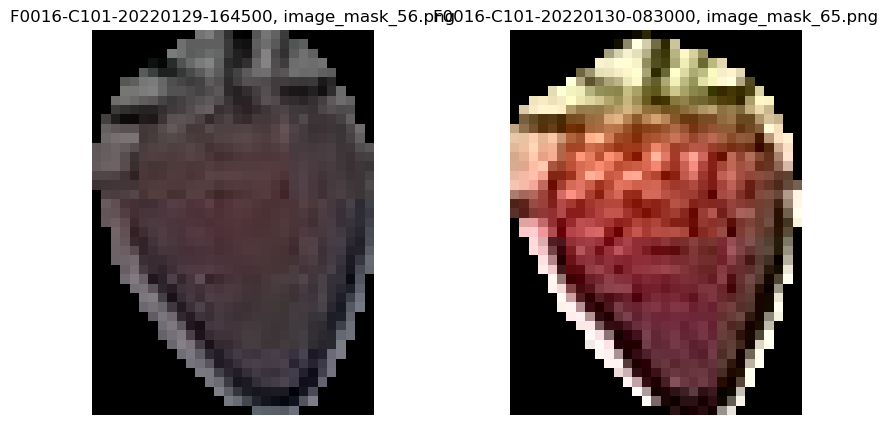

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_24
mask_id                                 4fca93b54f9a132fc325c0f6750848c4
point_x_x                                                     966.346436
point_y_x                                                     408.446167
output_image_path_x                                    image_mask_24.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

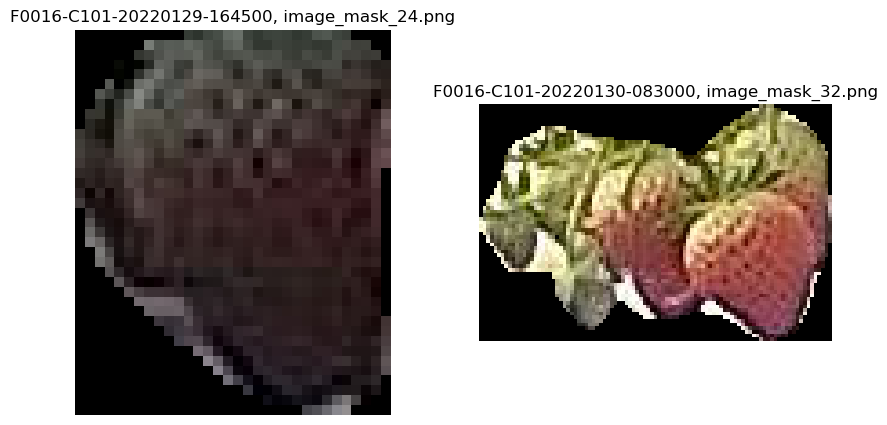

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_11
mask_id                                 55ad62e4822df2a64792fd7d97ff293a
point_x_x                                                     341.884705
point_y_x                                                     288.274597
output_image_path_x                                    image_mask_11.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

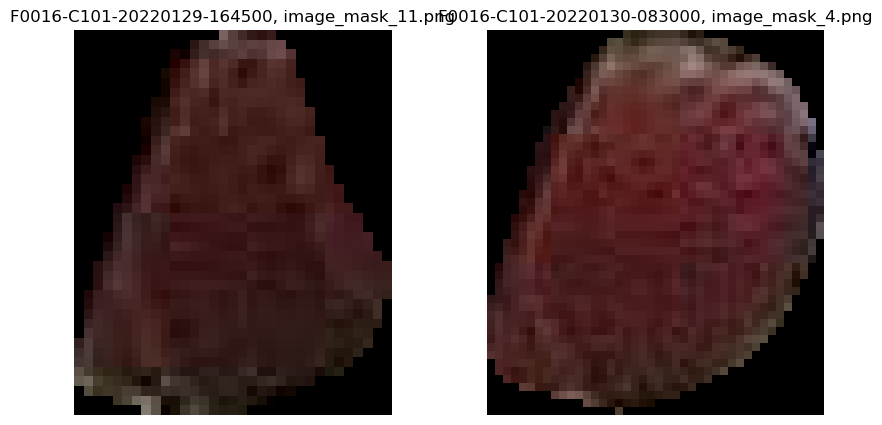

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_57
mask_id                                 68be9045ef8ed05832b2a80aedb5f458
point_x_x                                                    2039.261475
point_y_x                                                     168.180496
output_image_path_x                                    image_mask_57.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

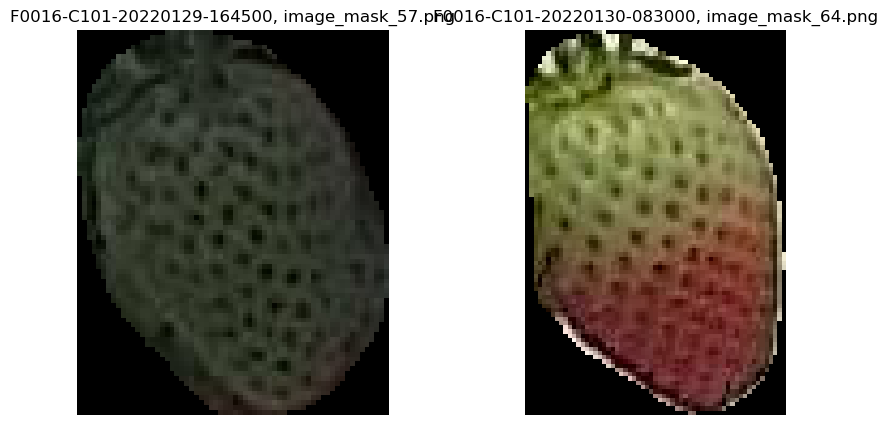

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_12
mask_id                                 698ef0c1d268bf4a8603f59f40148a00
point_x_x                                                     581.684326
point_y_x                                                      53.318111
output_image_path_x                                    image_mask_12.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

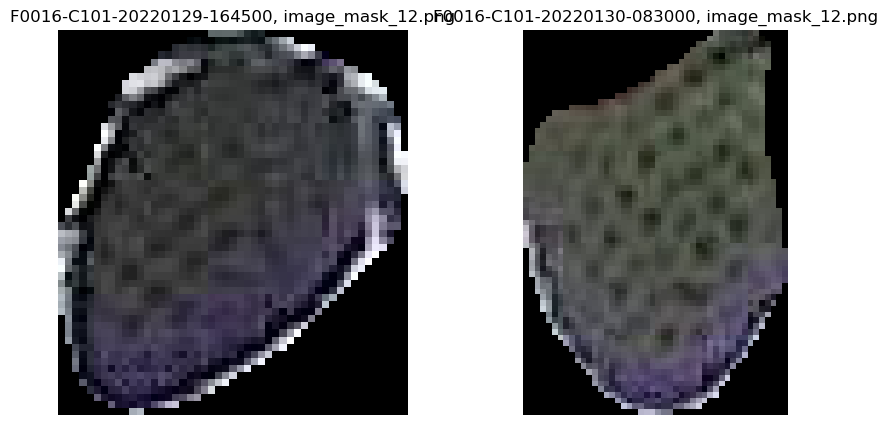

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_30
mask_id                                 6c76c90aa2dac6c06cb537cf18f7e238
point_x_x                                                    1496.219727
point_y_x                                                     258.290192
output_image_path_x                                    image_mask_30.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

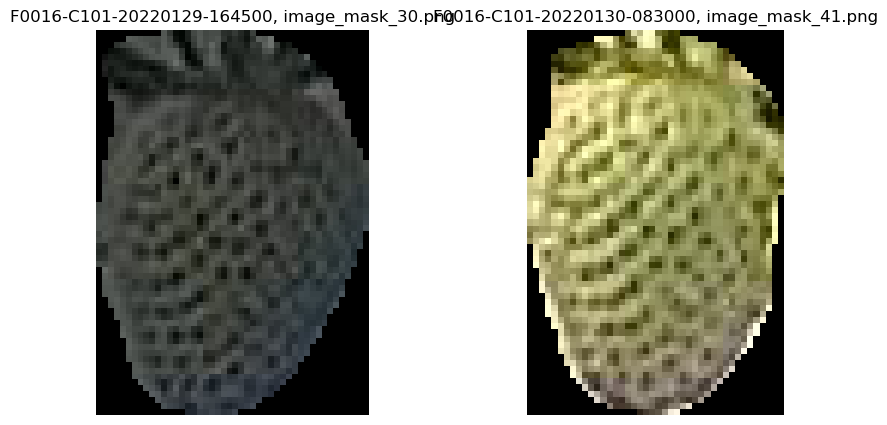

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_66
mask_id                                 7b5c63f2c876b9b8c7ab2db7e45dc50c
point_x_x                                                    2192.549316
point_y_x                                                      99.215828
output_image_path_x                                    image_mask_66.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

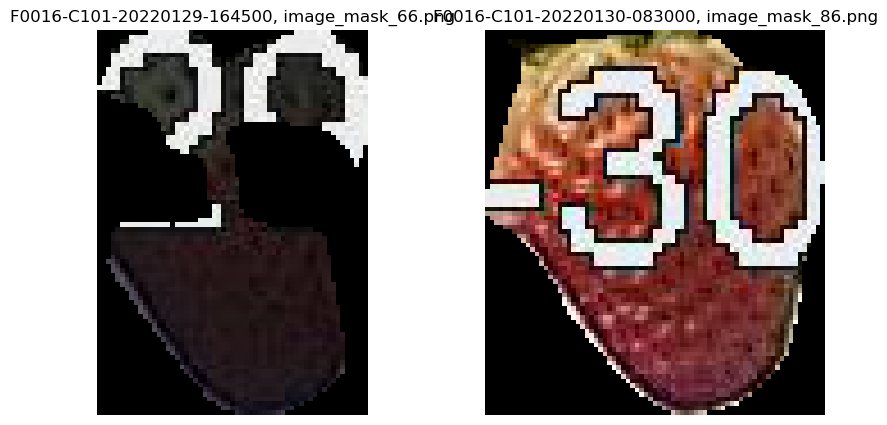

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_65
mask_id                                 8d2bcaee8880dafa889363b28ba9be9f
point_x_x                                                    2070.416992
point_y_x                                                     446.812134
output_image_path_x                                    image_mask_65.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

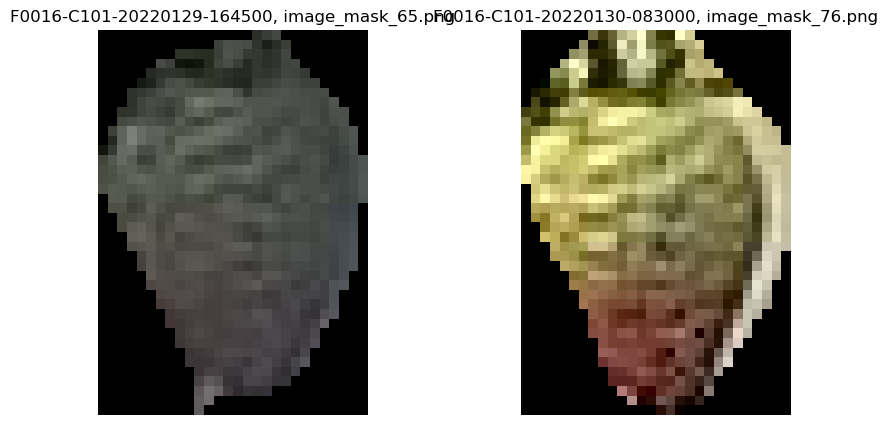

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_15
mask_id                                 8dc004a0512712405b12c1034650ce1d
point_x_x                                                    1093.204346
point_y_x                                                     447.055847
output_image_path_x                                    image_mask_15.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

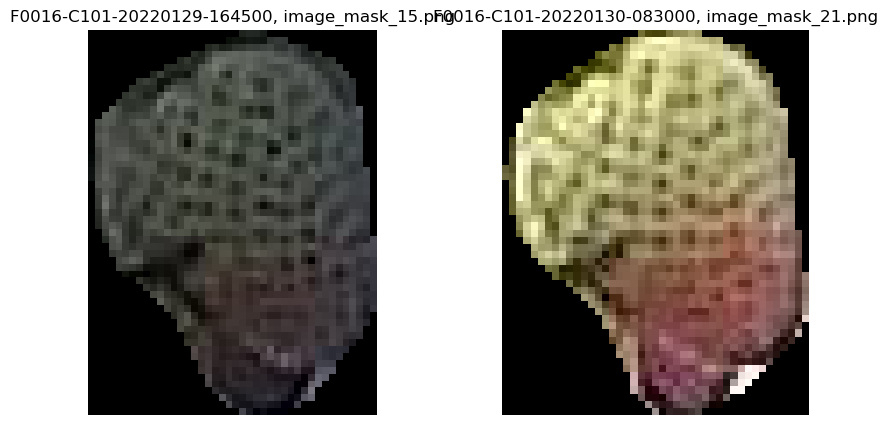

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_64
mask_id                                 923e1da268ba876a38ac0d15ed7cf9e6
point_x_x                                                    2150.496582
point_y_x                                                     411.914185
output_image_path_x                                    image_mask_64.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

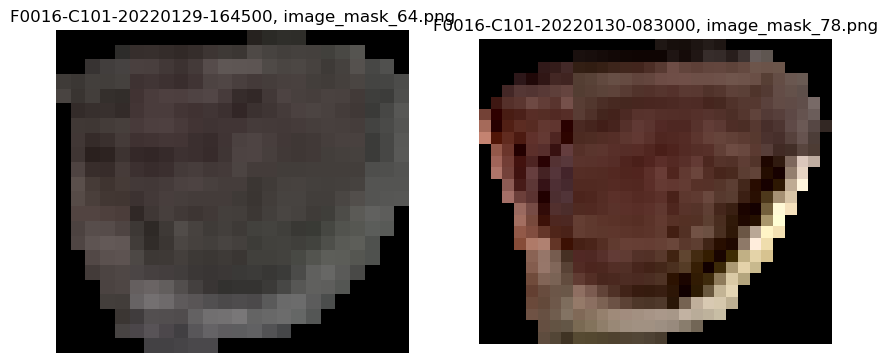

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                  F0016-C101-20220129-164500_2
mask_id                                 9fe08f1acad79e981aa24e959d73d9b5
point_x_x                                                     542.877319
point_y_x                                                     142.698929
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

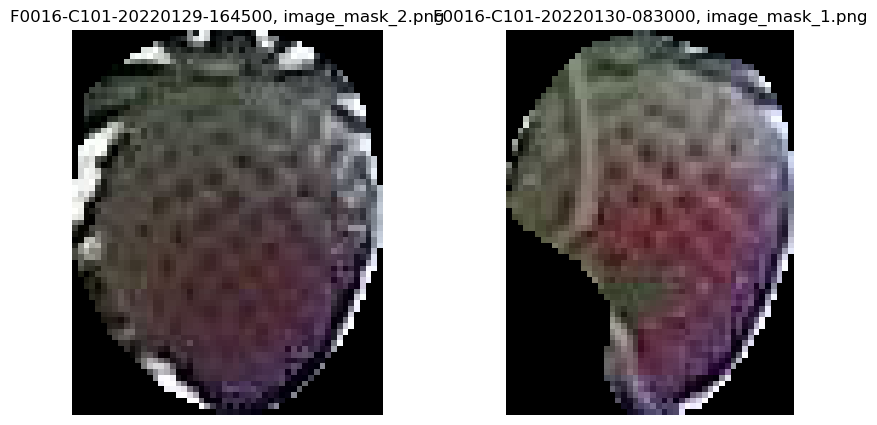

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_14
mask_id                                 9fe08f1acad79e981aa24e959d73d9b5
point_x_x                                                     543.053223
point_y_x                                                     151.808472
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

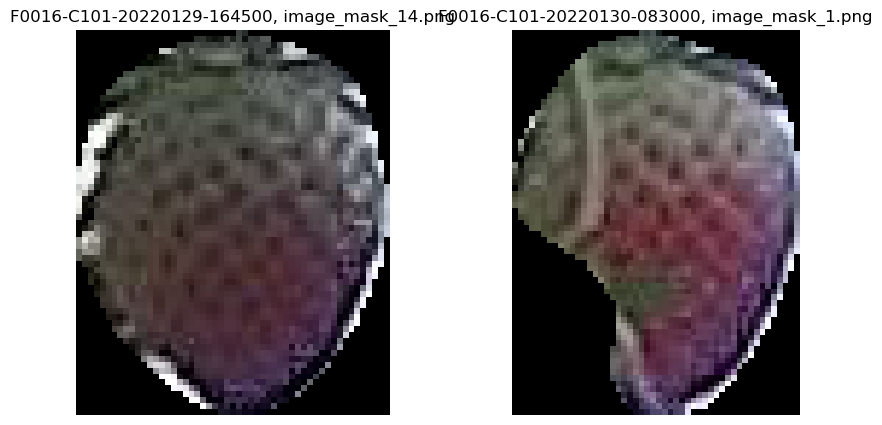

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_17
mask_id                                 a3cb2605ce09103f9910a809f2cdde2c
point_x_x                                                    1246.351074
point_y_x                                                     301.156891
output_image_path_x                                    image_mask_17.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

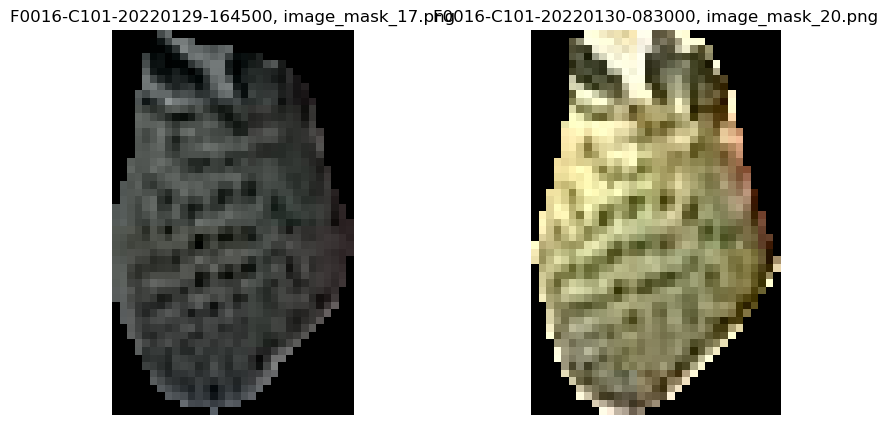

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_22
mask_id                                 a7317caee3d4527908d0615ddb01809f
point_x_x                                                     652.079102
point_y_x                                                     571.323242
output_image_path_x                                    image_mask_22.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

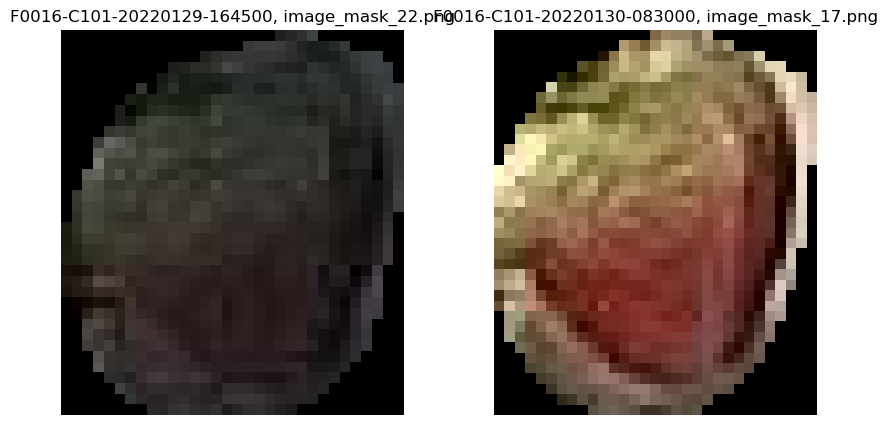

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_27
mask_id                                 ba68da91dea457857c64e5947b887b0e
point_x_x                                                     831.788086
point_y_x                                                     478.824219
output_image_path_x                                    image_mask_27.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

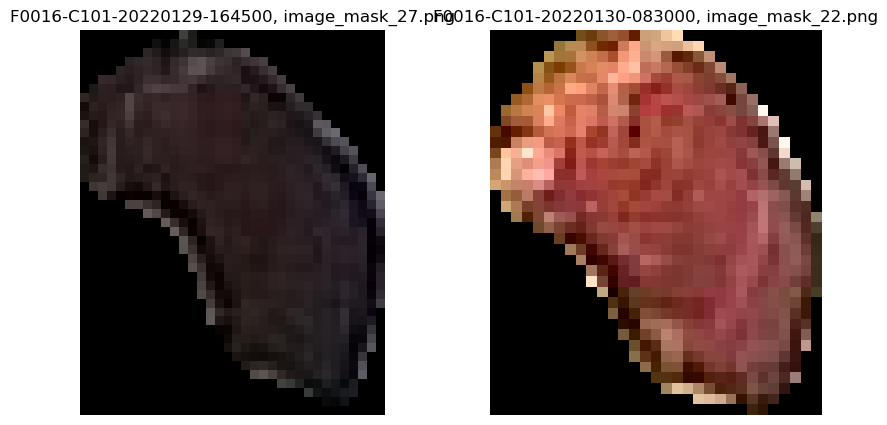

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_31
mask_id                                 c0743485c9da0b624366c665fe9dd42f
point_x_x                                                    1766.940918
point_y_x                                                     234.568466
output_image_path_x                                    image_mask_31.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

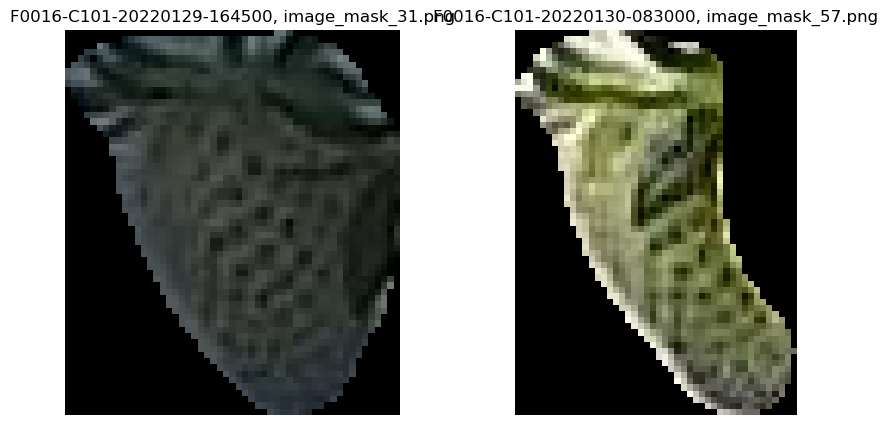

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                  F0016-C101-20220129-164500_4
mask_id                                 c266931fb5984e935ca50001181700a0
point_x_x                                                      476.09137
point_y_x                                                     212.756638
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

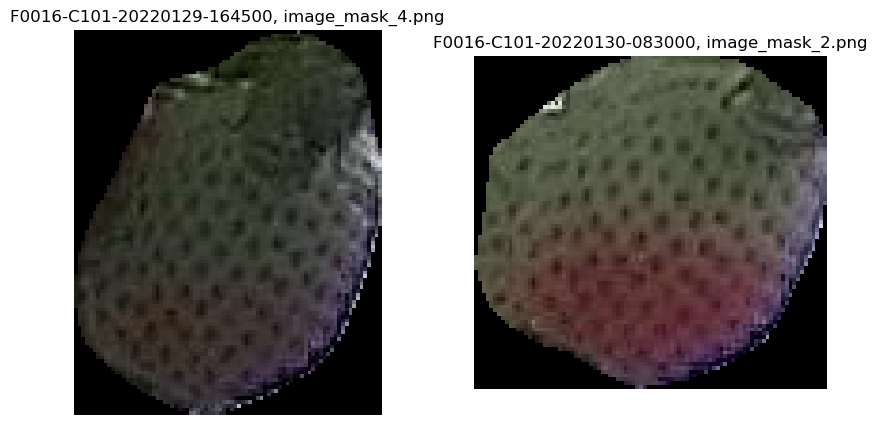

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_39
mask_id                                 c653891acf7d8584116ee4d4e8c8c0a7
point_x_x                                                    1739.762939
point_y_x                                                     121.578003
output_image_path_x                                    image_mask_39.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

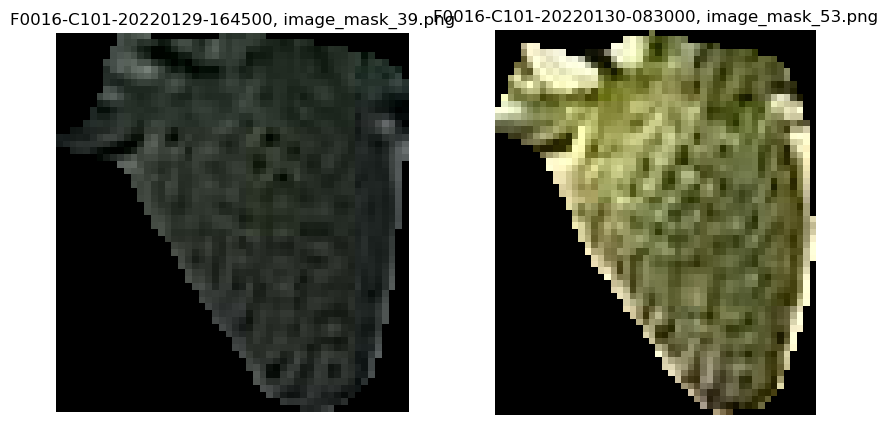

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_59
mask_id                                 c83b5ac7613f9a84b81e1f2cc3a6301c
point_x_x                                                    2012.104248
point_y_x                                                     427.463104
output_image_path_x                                    image_mask_59.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

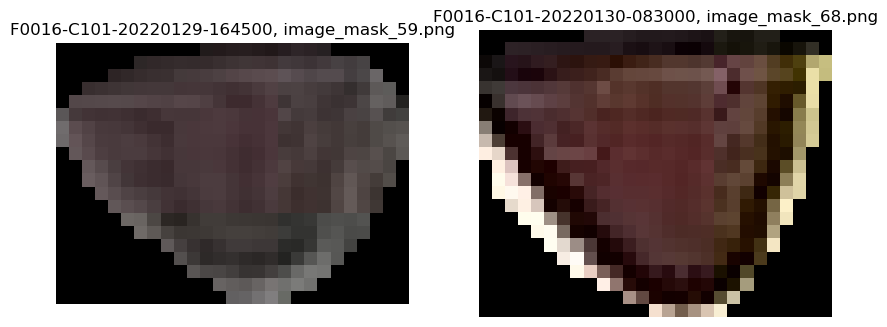

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_36
mask_id                                 dfe6011ee08944d5dcd888ec7ae3c5ea
point_x_x                                                    1450.633301
point_y_x                                                     295.584351
output_image_path_x                                    image_mask_36.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

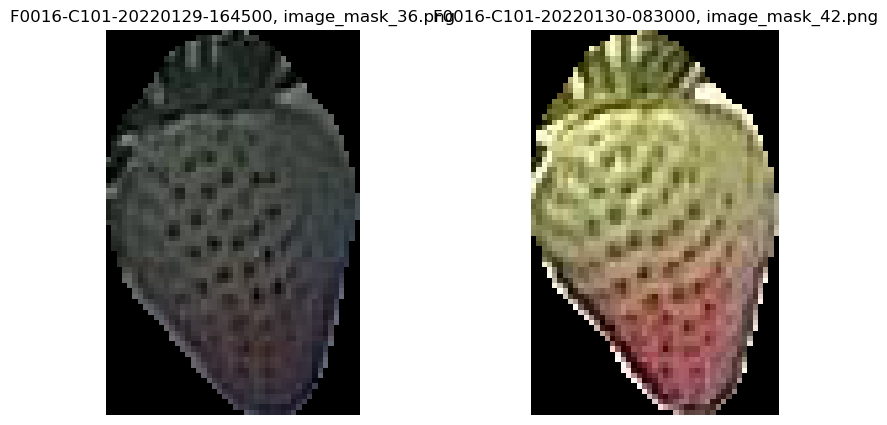

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_55
mask_id                                 e7f0bdc9d33073330b027b8ef8f1e328
point_x_x                                                    2006.805664
point_y_x                                                     207.874069
output_image_path_x                                    image_mask_55.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

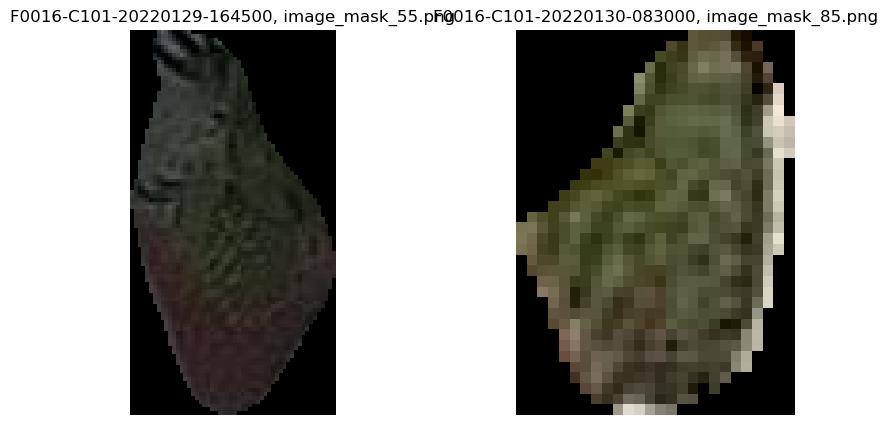

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_26
mask_id                                 e801a194cac949d955eedc5052e03832
point_x_x                                                    1268.952393
point_y_x                                                     296.608398
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

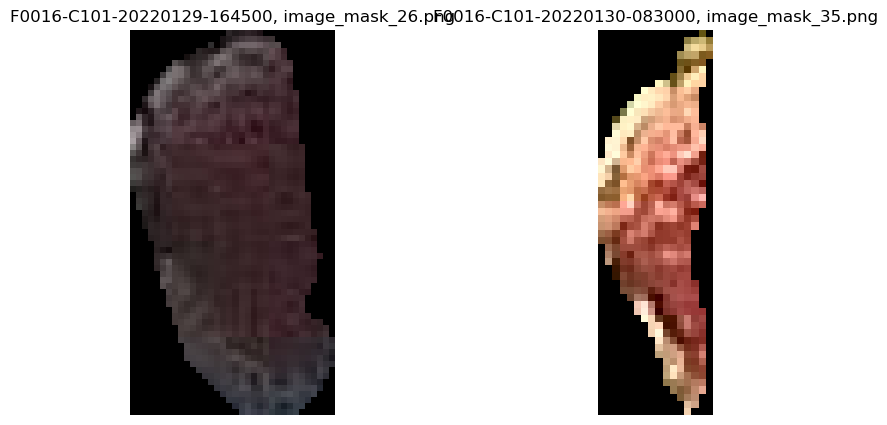

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_63
mask_id                                 eb663da7a56800343c0548a807acf1f7
point_x_x                                                    2028.249756
point_y_x                                                     452.654572
output_image_path_x                                    image_mask_63.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

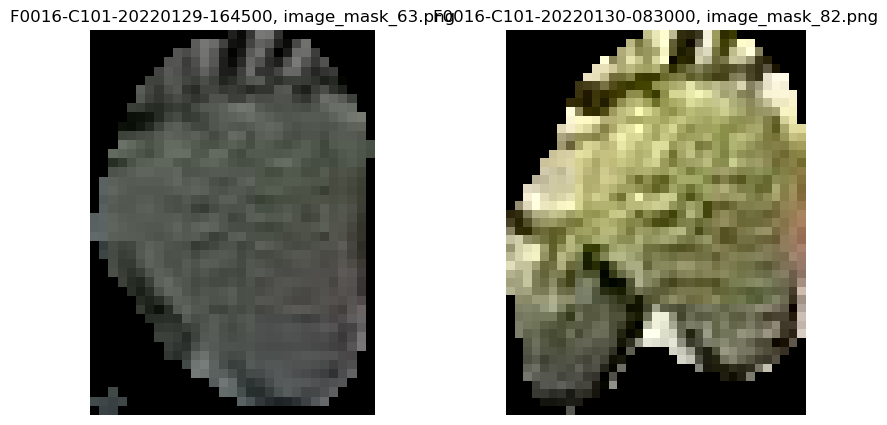

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                 F0016-C101-20220129-164500_45
mask_id                                 f06e5fb5d4240427e7e0c0ef92fb4318
point_x_x                                                    1752.284668
point_y_x                                                      86.722282
output_image_path_x                                    image_mask_45.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

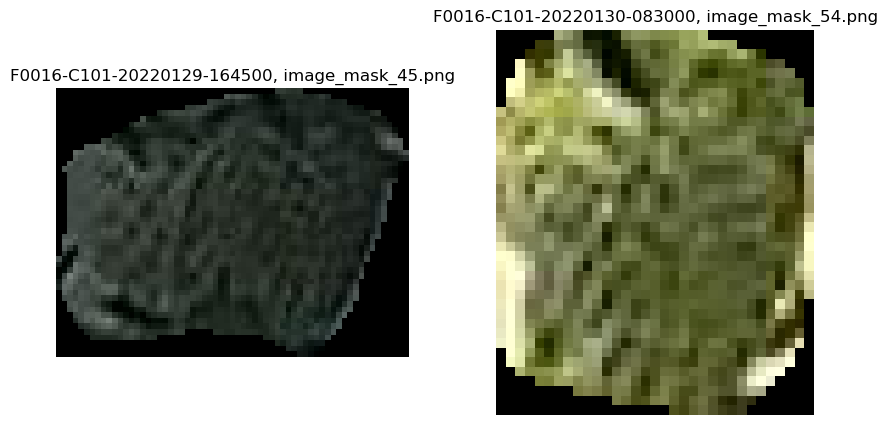

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                  F0016-C101-20220129-164500_7
mask_id                                 f49500569b020fb2fd0fc61e13cf8303
point_x_x                                                     318.248535
point_y_x                                                      410.70285
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

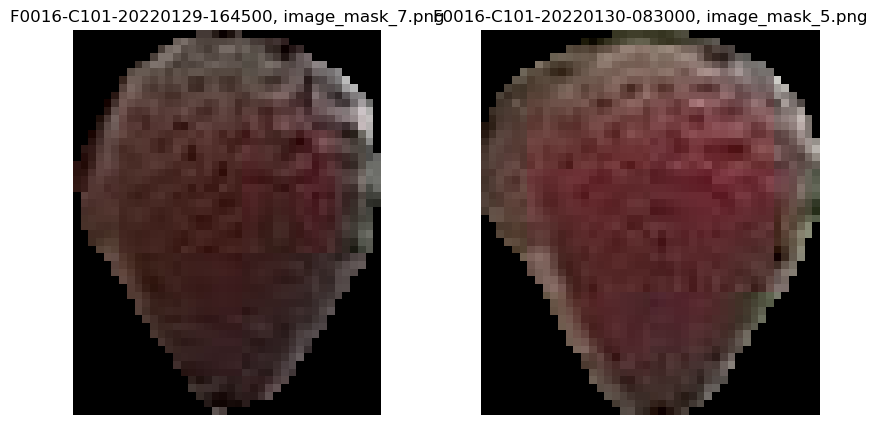

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220129-164500
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220129-123100
mask_num_x                                  F0016-C101-20220129-164500_9
mask_id                                 fc8811c4fe1787d2095d8fc876c2c0d1
point_x_x                                                     289.592468
point_y_x                                                     474.474731
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220130-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

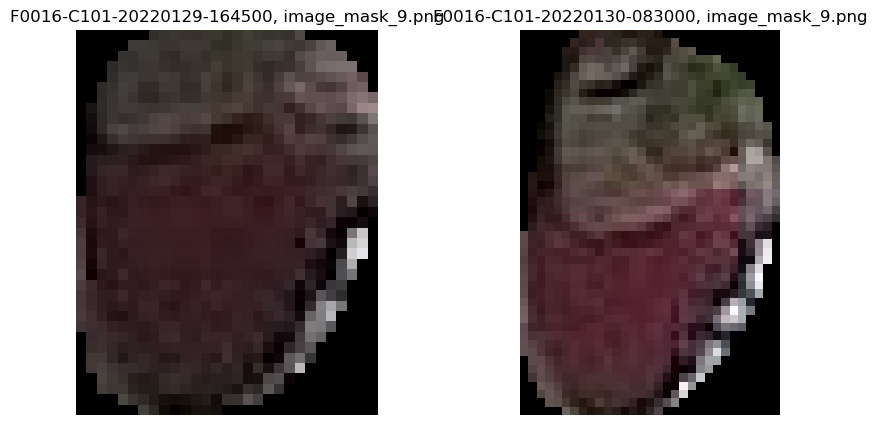

In [140]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_24
mask_id                                 00715d5ec46b3d94a8ee5e41cf21613e
point_x_x                                                    1262.626221
point_y_x                                                     549.525635
output_image_path_x                                    image_mask_24.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

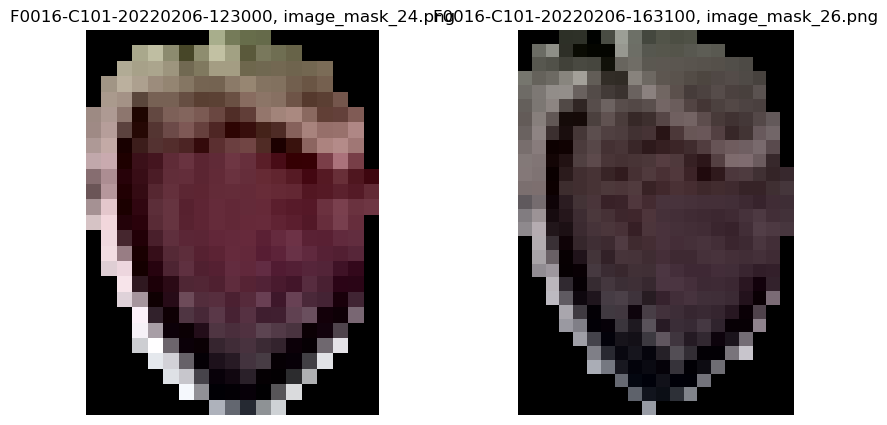

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_62
mask_id                                 0ade7053301eab2f33e4ab1783396e80
point_x_x                                                    1640.405518
point_y_x                                                      22.009043
output_image_path_x                                    image_mask_62.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

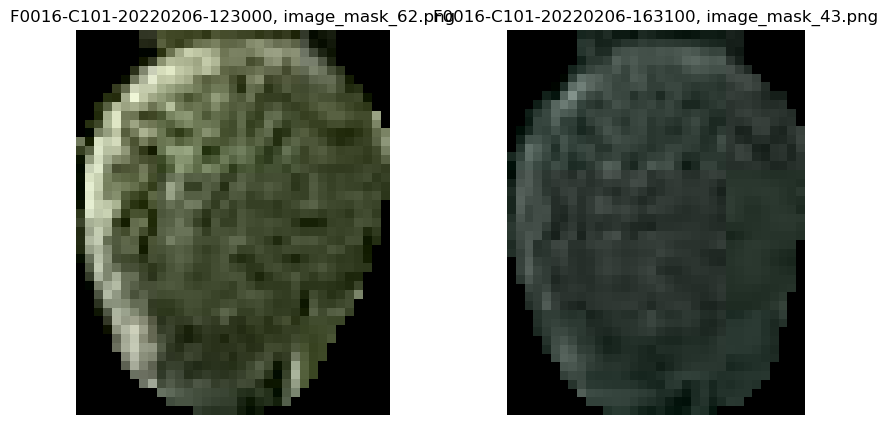

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_45
mask_id                                 21ba11973e5a3ae29e33d0c2260cb8f4
point_x_x                                                    1902.103027
point_y_x                                                     445.184998
output_image_path_x                                    image_mask_45.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

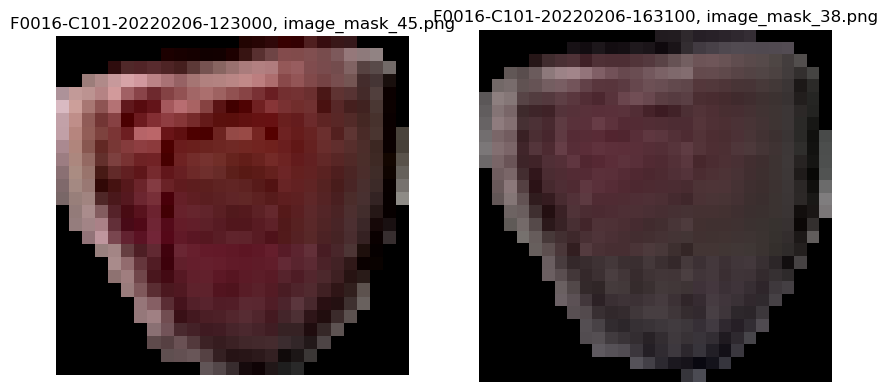

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_17
mask_id                                 277d15794214dd88cd6b15ad989fbe9e
point_x_x                                                     879.177612
point_y_x                                                     442.074615
output_image_path_x                                    image_mask_17.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

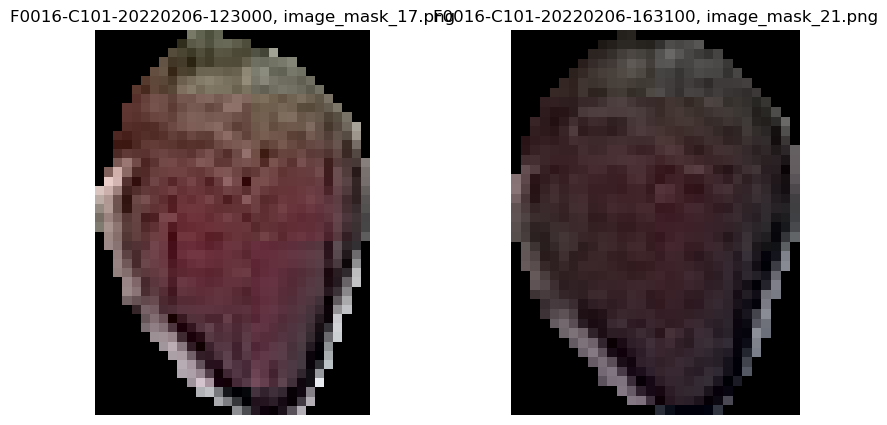

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_65
mask_id                                 2d4bda52216b3aace4b6c5f2ad0a7ff3
point_x_x                                                    2221.909668
point_y_x                                                      48.826172
output_image_path_x                                    image_mask_65.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

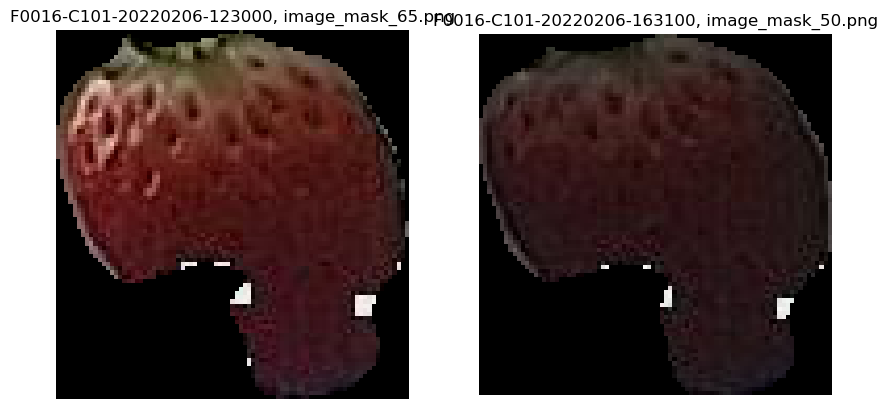

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_47
mask_id                                 2f46b323f6579f722f66e558d5baa5e2
point_x_x                                                    1604.934448
point_y_x                                                     149.057098
output_image_path_x                                    image_mask_47.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

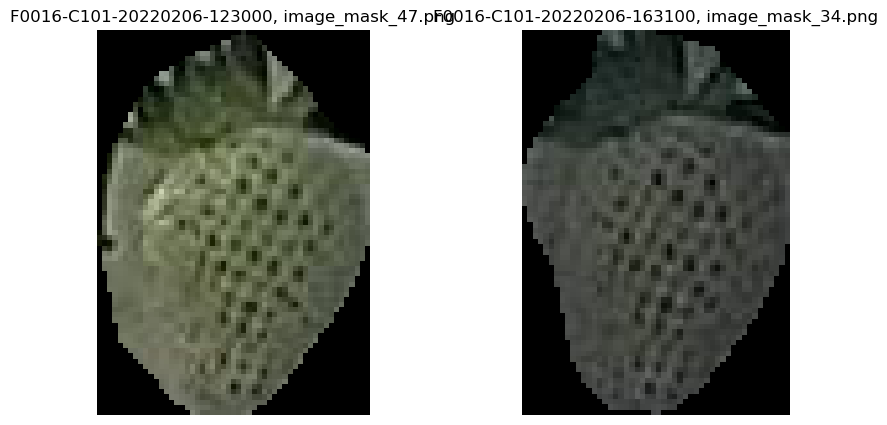

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                  F0016-C101-20220206-123000_7
mask_id                                 382aaa8e475aca30d44445d190be5c02
point_x_x                                                     310.959473
point_y_x                                                     449.268127
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

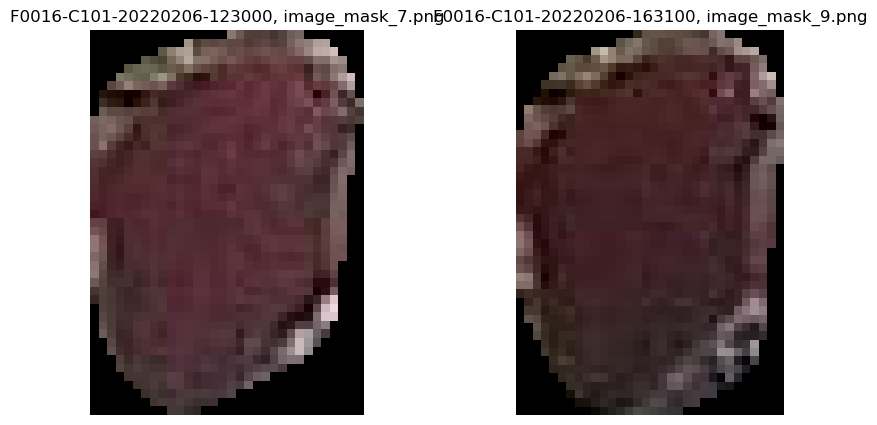

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_23
mask_id                                 38a4fa43e63eba2eecfd322ed8d9b44f
point_x_x                                                    1064.041504
point_y_x                                                     409.731201
output_image_path_x                                    image_mask_23.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

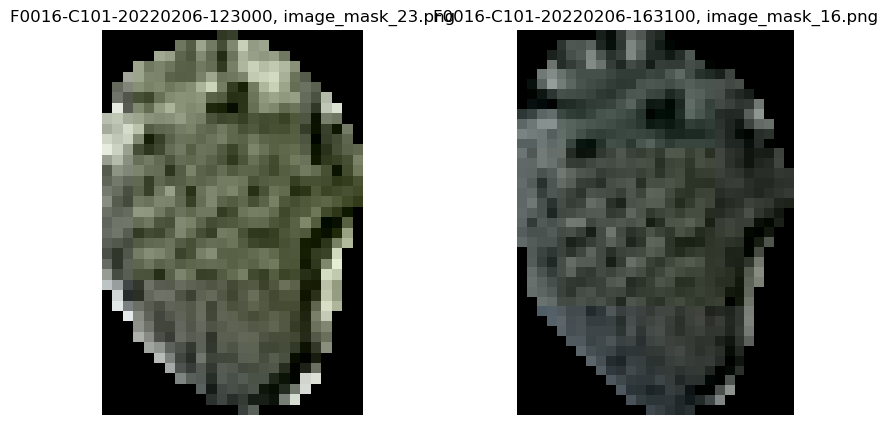

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_49
mask_id                                 3bf9367d622a84ddbfe3e95ddd0b83dc
point_x_x                                                    1845.600342
point_y_x                                                     262.180634
output_image_path_x                                    image_mask_49.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

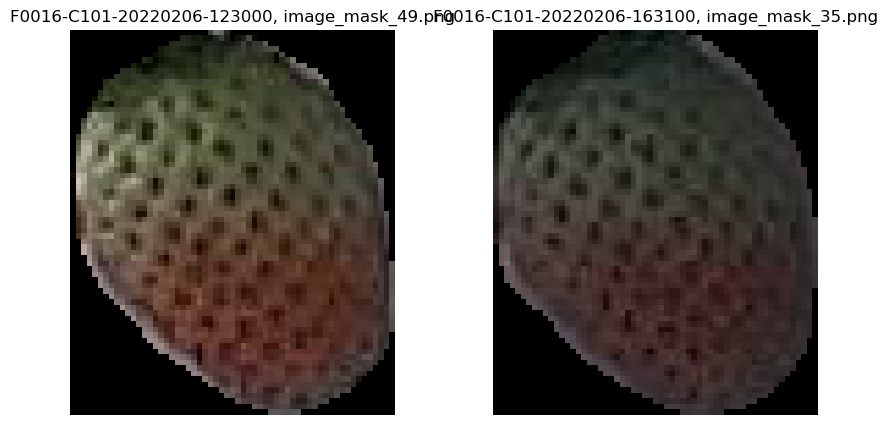

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_13
mask_id                                 3cda9b69fc4a3f8f8b2ee3fdc53c4faa
point_x_x                                                     285.786316
point_y_x                                                     448.758148
output_image_path_x                                    image_mask_13.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

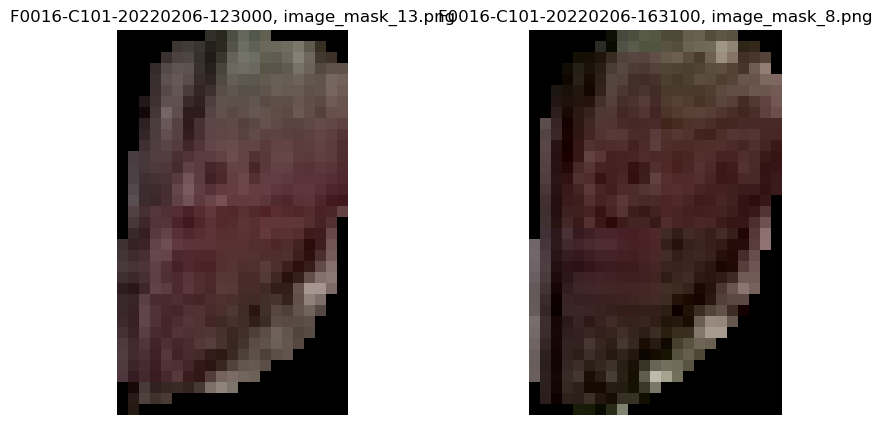

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_73
mask_id                                 3dc30a4dad232a6b337a4d558b47245c
point_x_x                                                      2053.5271
point_y_x                                                     457.080353
output_image_path_x                                    image_mask_73.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

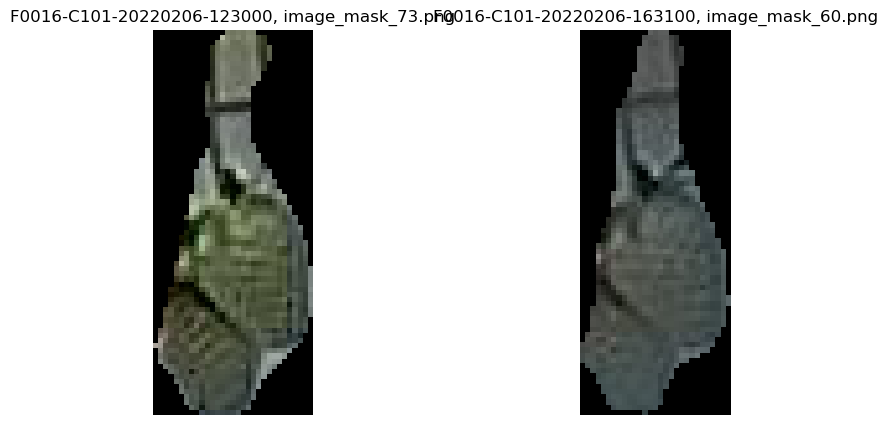

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_50
mask_id                                 3eff761e4aef7098d7838dce2a29711e
point_x_x                                                    1485.969116
point_y_x                                                     180.763687
output_image_path_x                                    image_mask_50.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

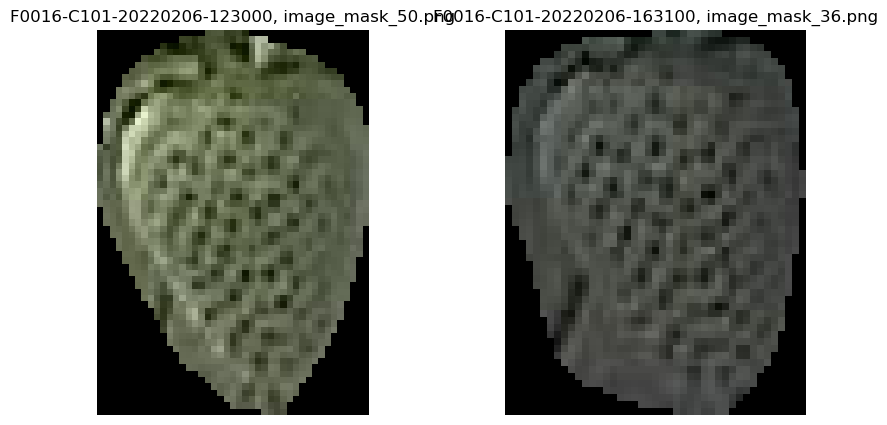

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_50
mask_id                                 3eff761e4aef7098d7838dce2a29711e
point_x_x                                                    1485.969116
point_y_x                                                     180.763687
output_image_path_x                                    image_mask_50.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

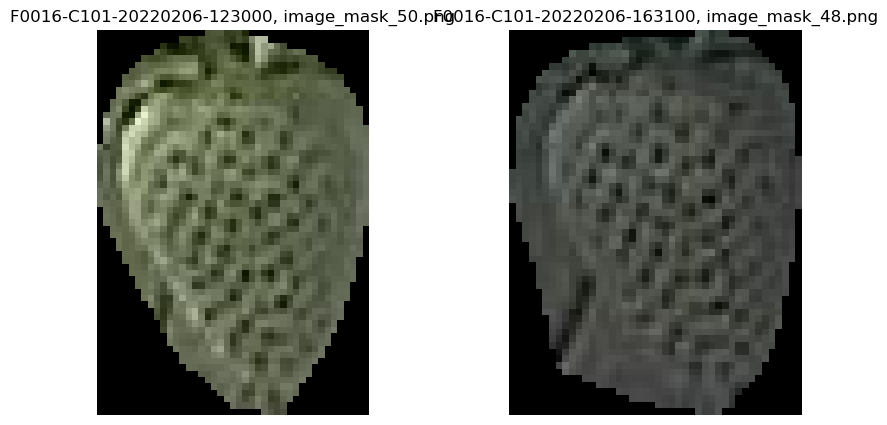

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_72
mask_id                                 45ad57036438c74b032507c0d8bf189e
point_x_x                                                    2013.922607
point_y_x                                                     420.713867
output_image_path_x                                    image_mask_72.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

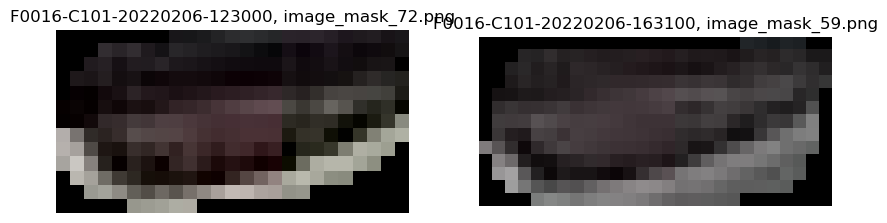

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_74
mask_id                                 47553f1b7ab2ae507acf37ddb4d8563b
point_x_x                                                    1977.766357
point_y_x                                                     167.057831
output_image_path_x                                    image_mask_74.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

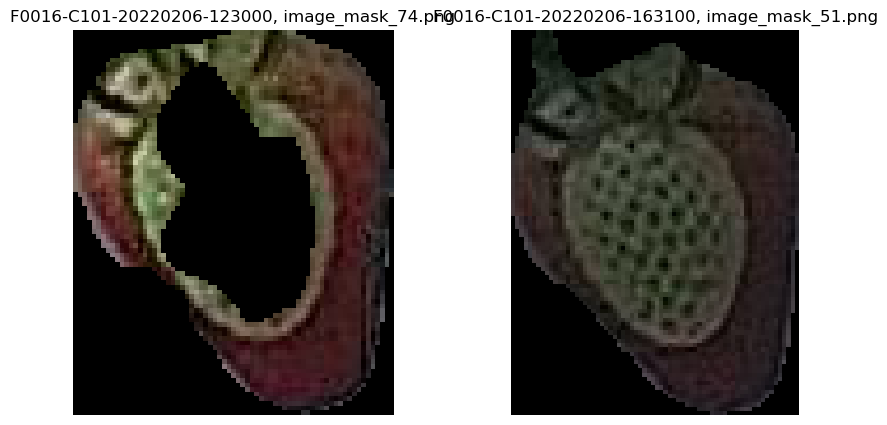

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_67
mask_id                                 4e06c5a157540a05bcdac96725fe36d6
point_x_x                                                    2102.995117
point_y_x                                                     441.153015
output_image_path_x                                    image_mask_67.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

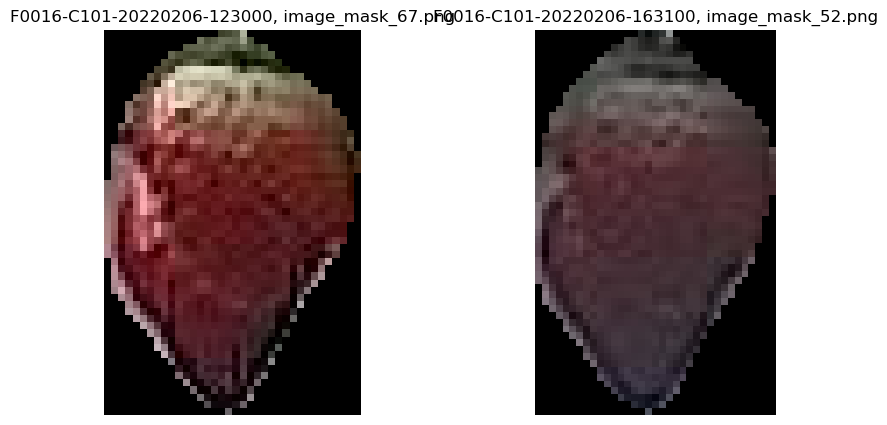

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_22
mask_id                                 4fca93b54f9a132fc325c0f6750848c4
point_x_x                                                     983.629761
point_y_x                                                     429.947327
output_image_path_x                                    image_mask_22.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

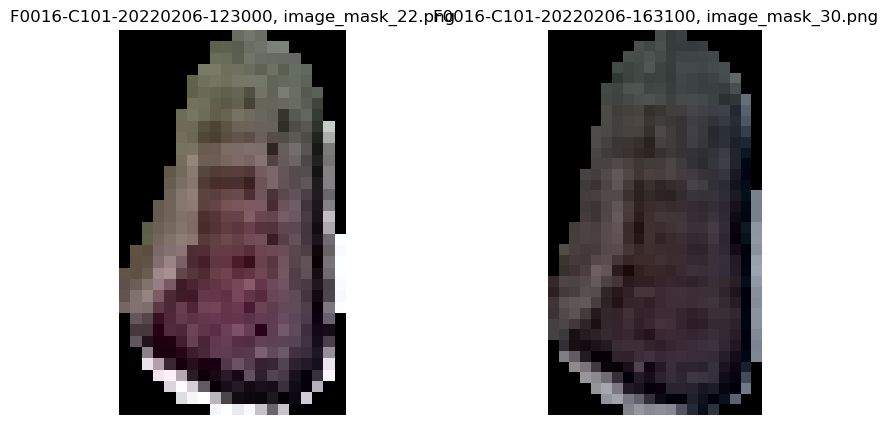

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_38
mask_id                                 5083ec7b5b227ff6614a2871aa95218d
point_x_x                                                    1069.645508
point_y_x                                                     488.854858
output_image_path_x                                    image_mask_38.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

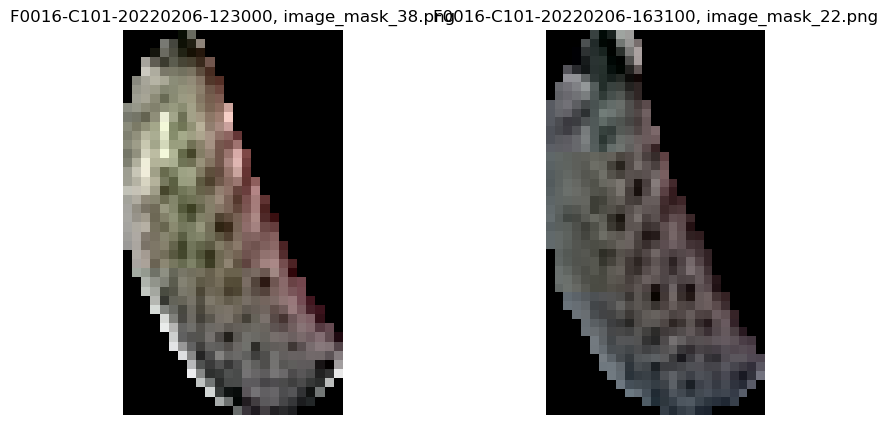

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_68
mask_id                                 65802ad16a9c7a8134cac956b4221b36
point_x_x                                                    2132.738525
point_y_x                                                      442.59848
output_image_path_x                                    image_mask_68.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

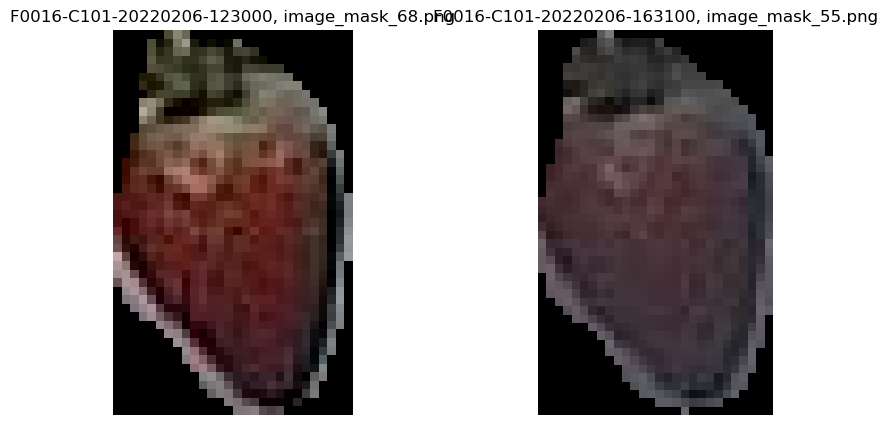

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_28
mask_id                                 67bf37e69b08dac4cbc26df4cce78188
point_x_x                                                    1209.606445
point_y_x                                                     567.141235
output_image_path_x                                    image_mask_28.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

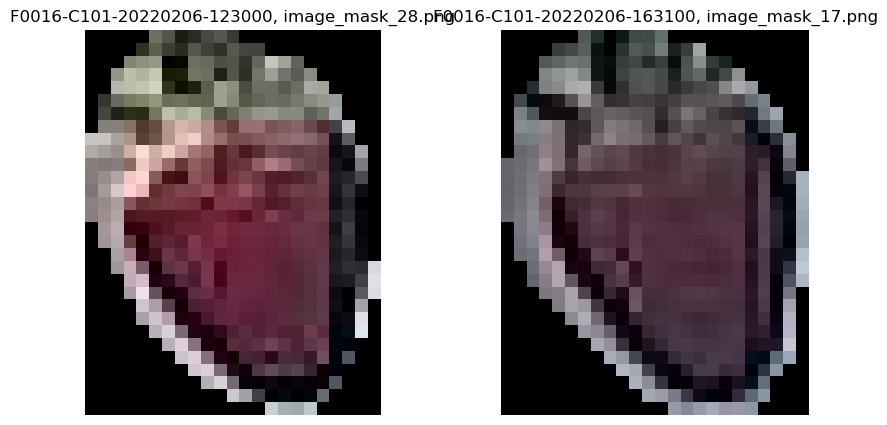

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_15
mask_id                                 70e08d34cf0c734da0c94cd8cfb10c3f
point_x_x                                                    1116.582275
point_y_x                                                     411.925415
output_image_path_x                                    image_mask_15.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

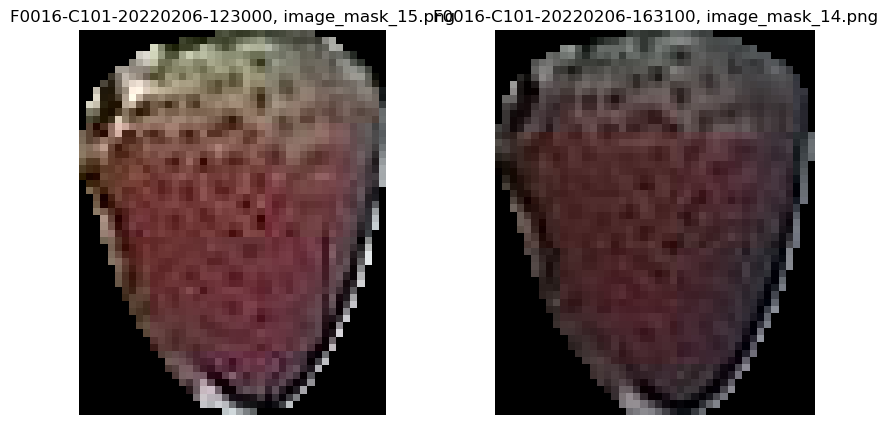

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                  F0016-C101-20220206-123000_2
mask_id                                 710f5d17cc5f14b0e0f14f897396c40e
point_x_x                                                     566.674316
point_y_x                                                      46.584667
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

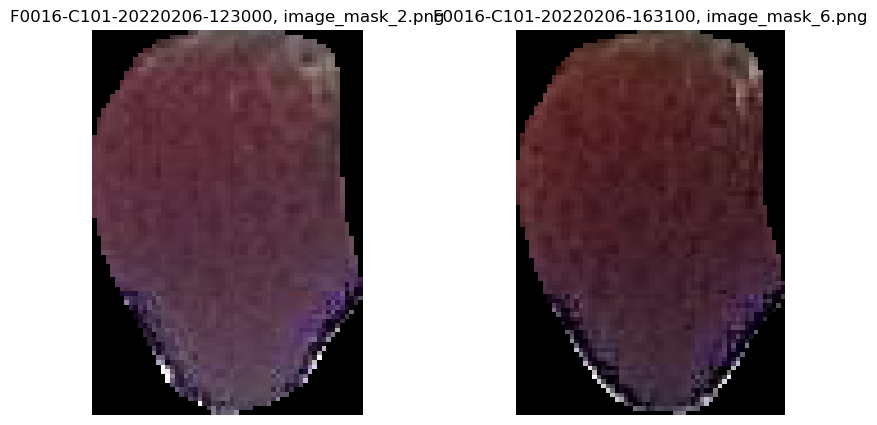

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_63
mask_id                                 77a0fc7371195626b55a65d03dfdc4b3
point_x_x                                                    1548.015381
point_y_x                                                     515.223328
output_image_path_x                                    image_mask_63.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

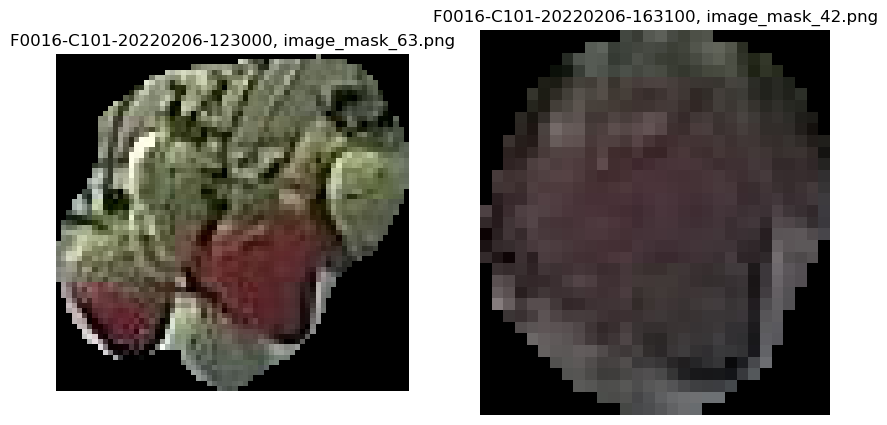

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_69
mask_id                                 7a775eff0e2ff602da1713ccfef4f67e
point_x_x                                                    2064.562744
point_y_x                                                      28.996323
output_image_path_x                                    image_mask_69.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

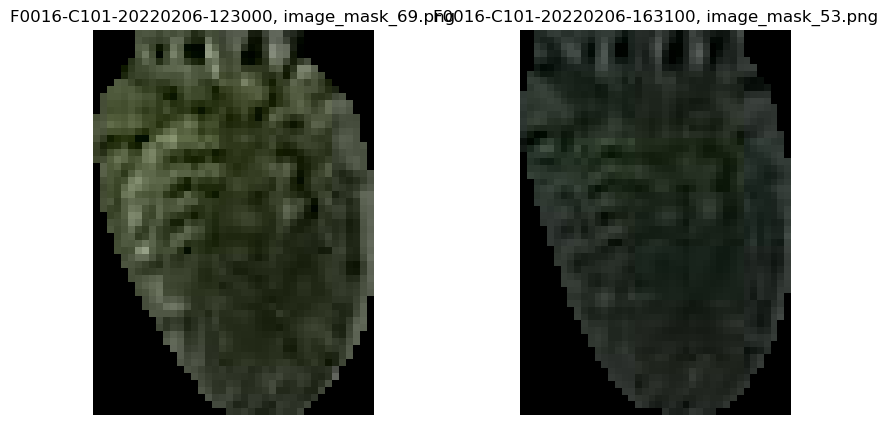

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_19
mask_id                                 7e14f9e2cb86cf9ae45486e65143970c
point_x_x                                                    1082.274902
point_y_x                                                     480.367126
output_image_path_x                                    image_mask_19.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

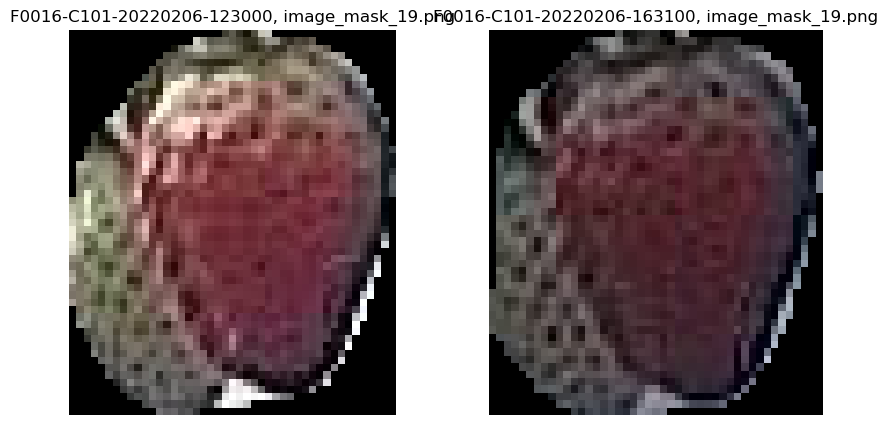

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_36
mask_id                                 7e14f9e2cb86cf9ae45486e65143970c
point_x_x                                                    1088.094238
point_y_x                                                     482.420654
output_image_path_x                                    image_mask_36.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

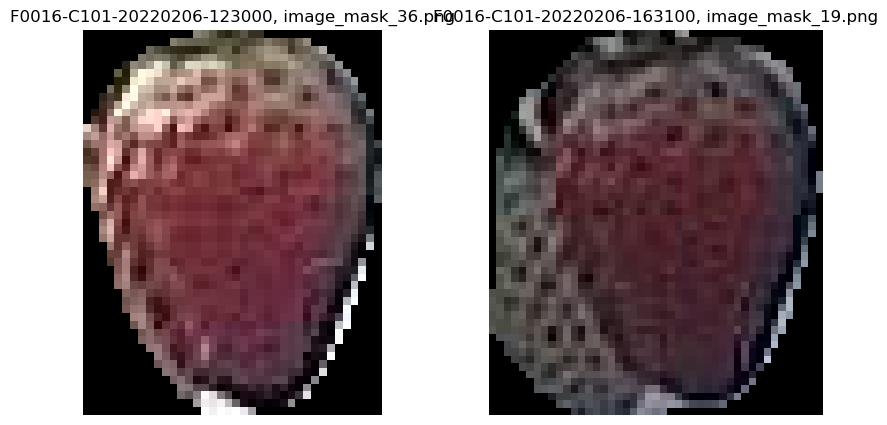

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_51
mask_id                                 84a9a70c3a6a862da2790a752246d786
point_x_x                                                    1809.655762
point_y_x                                                     184.993851
output_image_path_x                                    image_mask_51.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

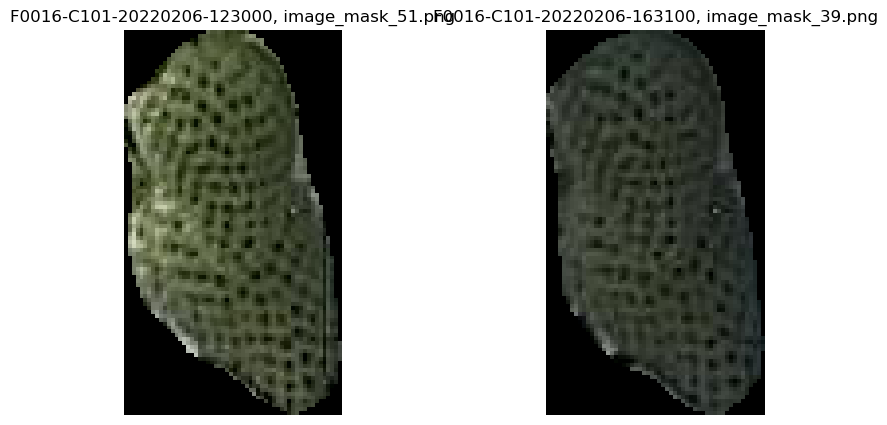

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_20
mask_id                                 8baa9f15875f7203bf4a9222bb1b7257
point_x_x                                                     855.970825
point_y_x                                                     427.790771
output_image_path_x                                    image_mask_20.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

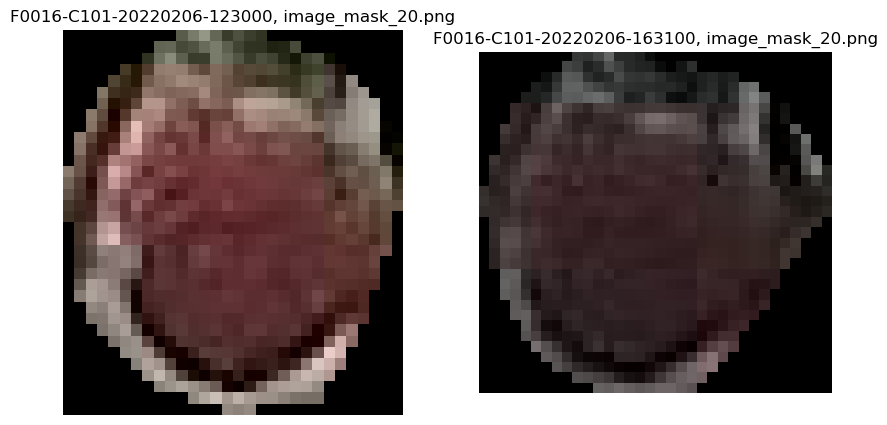

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_35
mask_id                                 8e0db106a7ae776a03360e75f57d3af2
point_x_x                                                     803.300415
point_y_x                                                     514.550415
output_image_path_x                                    image_mask_35.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

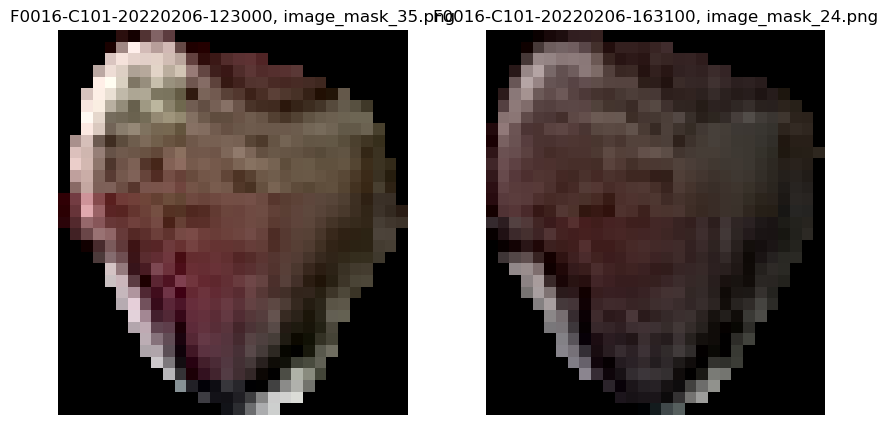

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                  F0016-C101-20220206-123000_1
mask_id                                 a0ba2dcd717f8f924e7bda1fc59b648f
point_x_x                                                     615.037415
point_y_x                                                      35.787659
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

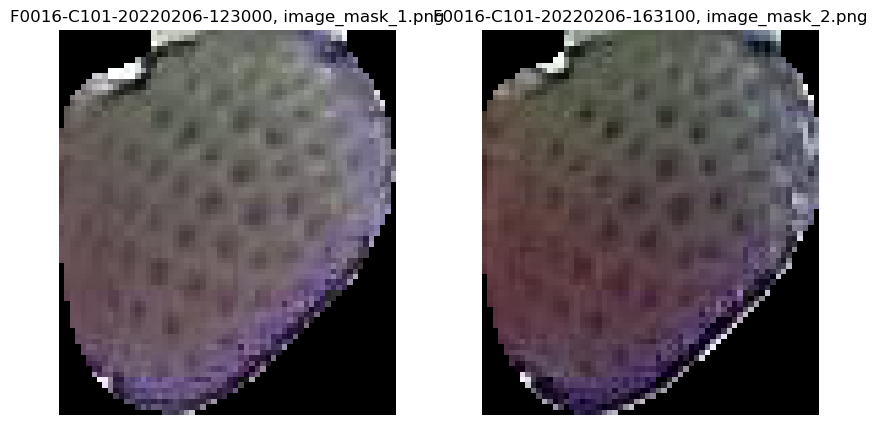

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                  F0016-C101-20220206-123000_5
mask_id                                 a8b851c21fb14271691f98c3892b2303
point_x_x                                                     338.207977
point_y_x                                                     452.425476
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

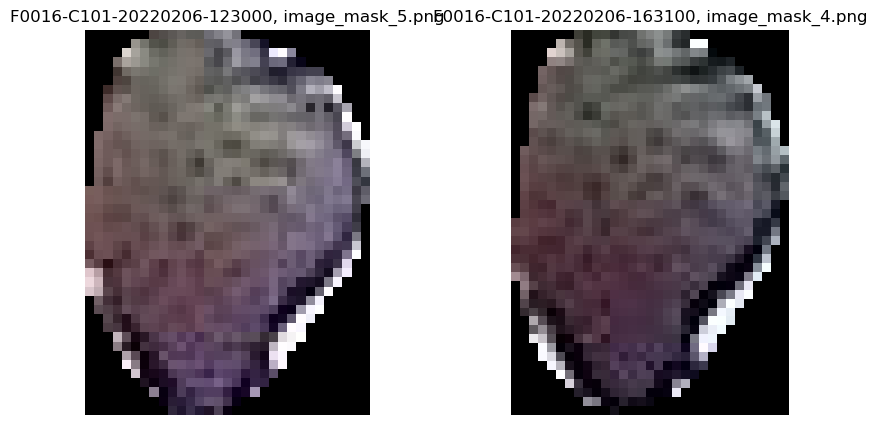

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_48
mask_id                                 bb3571acc935cf351684e9f5b7e20f62
point_x_x                                                    1859.869385
point_y_x                                                     457.168884
output_image_path_x                                    image_mask_48.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

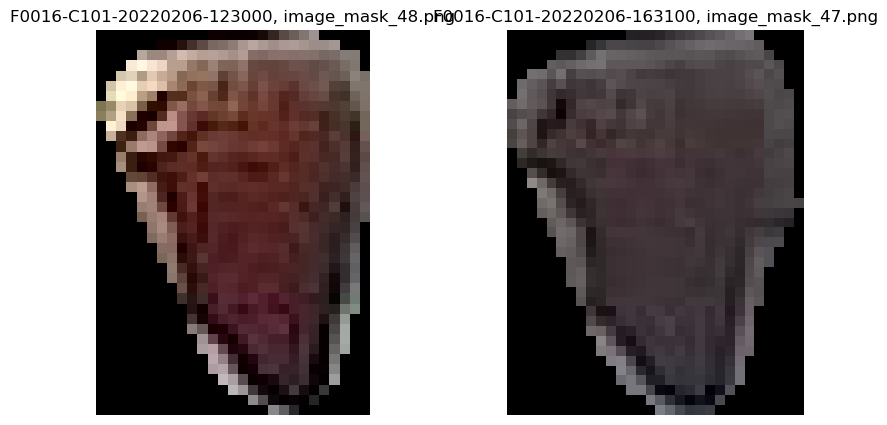

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_54
mask_id                                 be9823ad019eabcfb15b2038eb120a0c
point_x_x                                                    1885.928223
point_y_x                                                     211.199158
output_image_path_x                                    image_mask_54.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

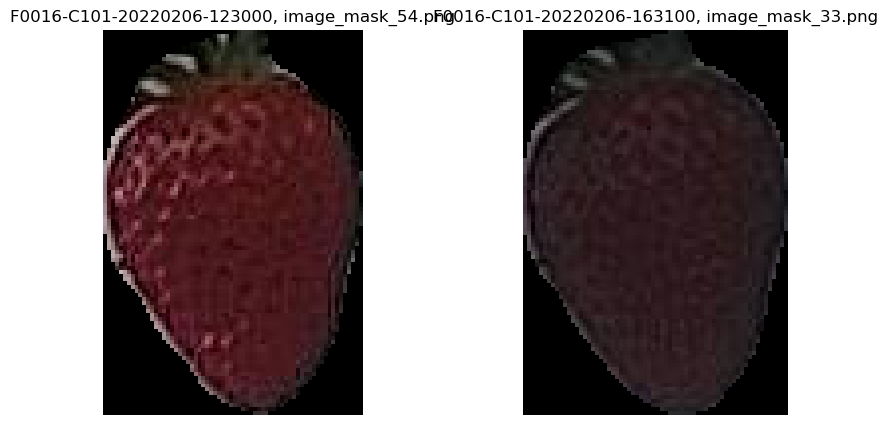

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_42
mask_id                                 c0743485c9da0b624366c665fe9dd42f
point_x_x                                                    1786.002686
point_y_x                                                     255.357941
output_image_path_x                                    image_mask_42.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

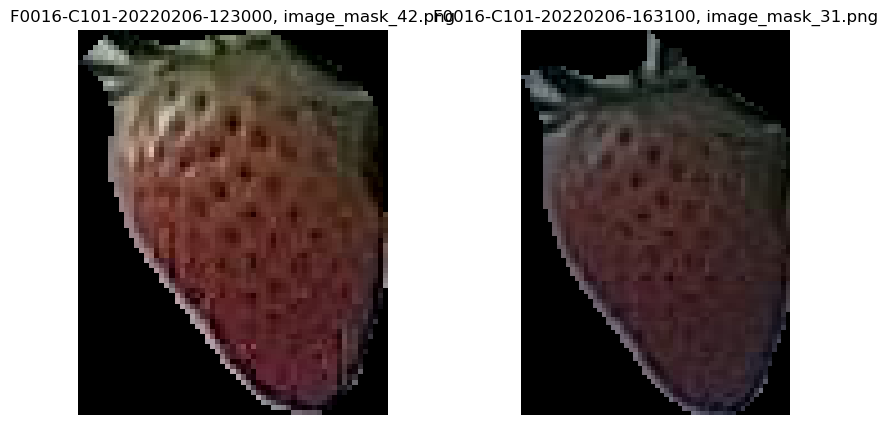

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_75
mask_id                                 c1b4de57c6da697cf7d76f849ea4de8d
point_x_x                                                     1944.55835
point_y_x                                                     469.394653
output_image_path_x                                    image_mask_75.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

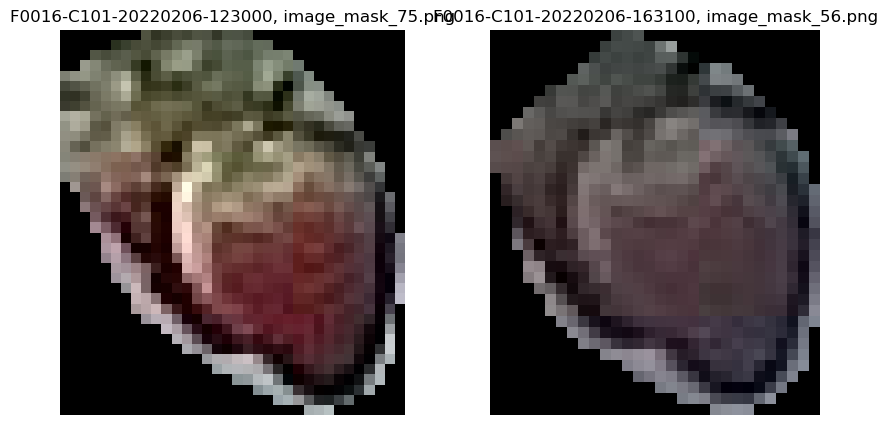

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_75
mask_id                                 c1b4de57c6da697cf7d76f849ea4de8d
point_x_x                                                     1944.55835
point_y_x                                                     469.394653
output_image_path_x                                    image_mask_75.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

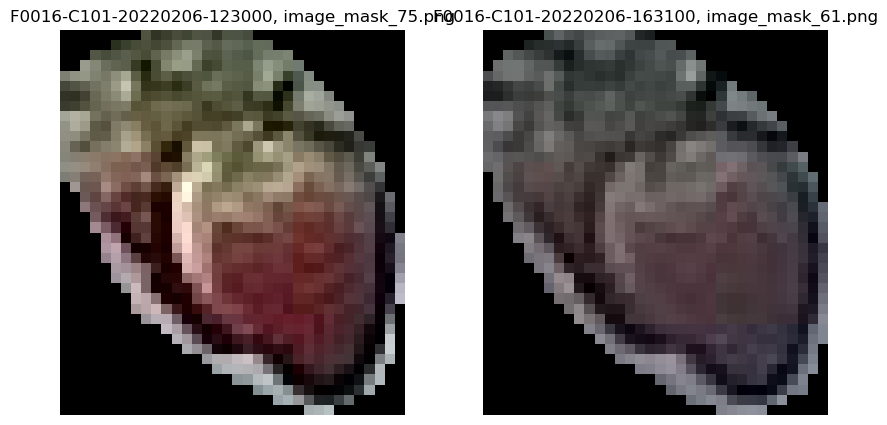

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_33
mask_id                                 c52c069973a82e16a6d5b90892065f60
point_x_x                                                     806.649841
point_y_x                                                     488.944702
output_image_path_x                                    image_mask_33.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

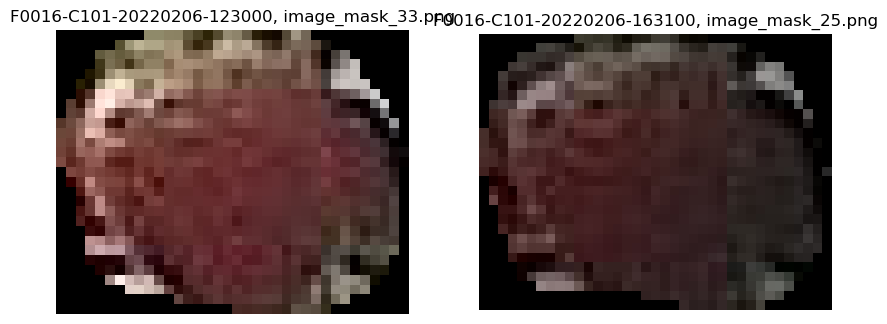

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                  F0016-C101-20220206-123000_4
mask_id                                 d52b0e27627039363f52fcf176ac35eb
point_x_x                                                      536.76001
point_y_x                                                      35.631763
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

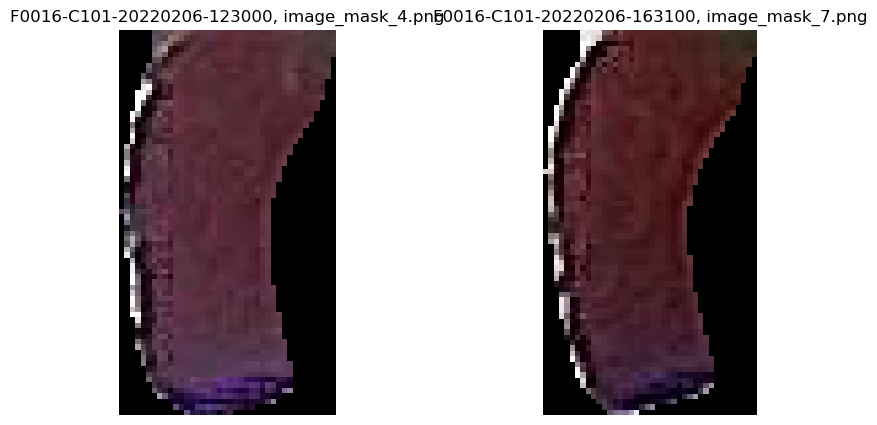

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_27
mask_id                                 d8085a5605667ef51aca65c7b3dde3c7
point_x_x                                                    1091.912231
point_y_x                                                     431.331726
output_image_path_x                                    image_mask_27.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

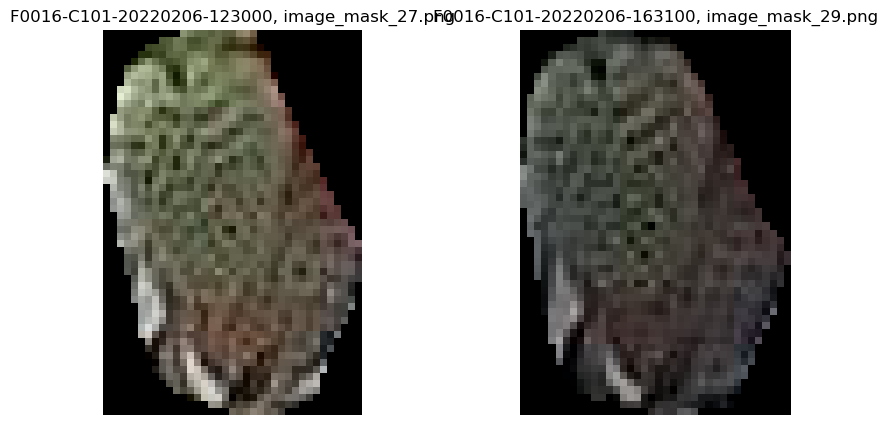

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_66
mask_id                                 da63c36cd9d9612160e29597c569c2d6
point_x_x                                                       2201.375
point_y_x                                                     420.825867
output_image_path_x                                    image_mask_66.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

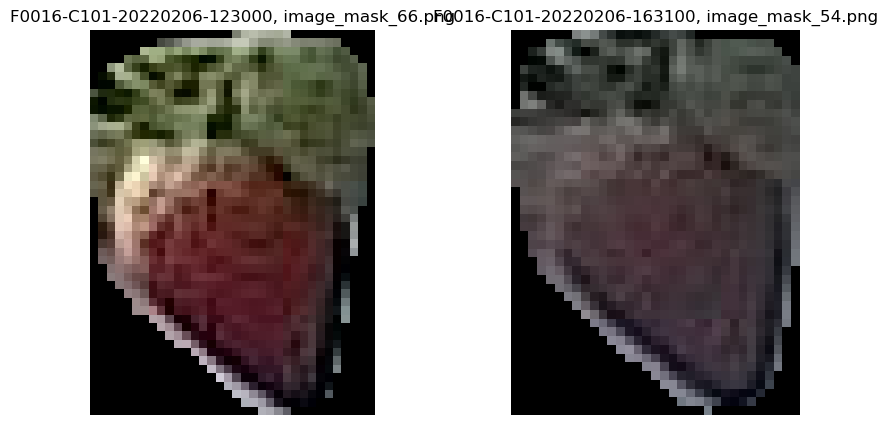

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_18
mask_id                                 e1bc5f96da1d3ddfe006e2df50014b32
point_x_x                                                     840.300171
point_y_x                                                     512.101318
output_image_path_x                                    image_mask_18.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

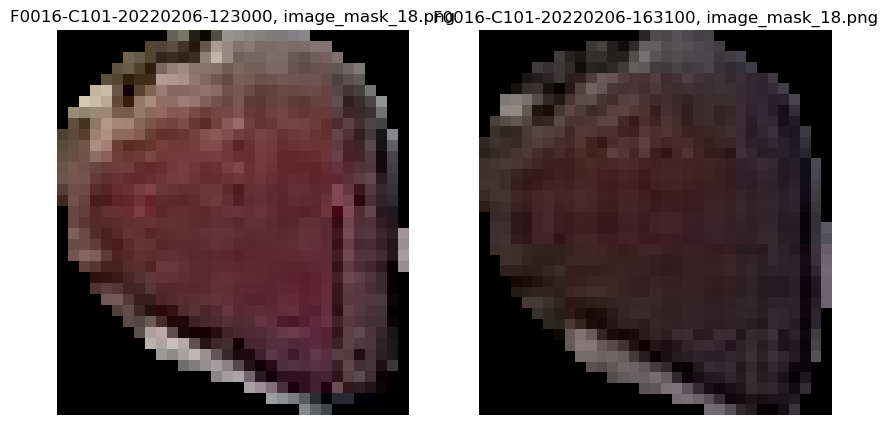

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_26
mask_id                                 e4c0c52df7d20301b679e48ea88835d5
point_x_x                                                      783.42041
point_y_x                                                     498.984772
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

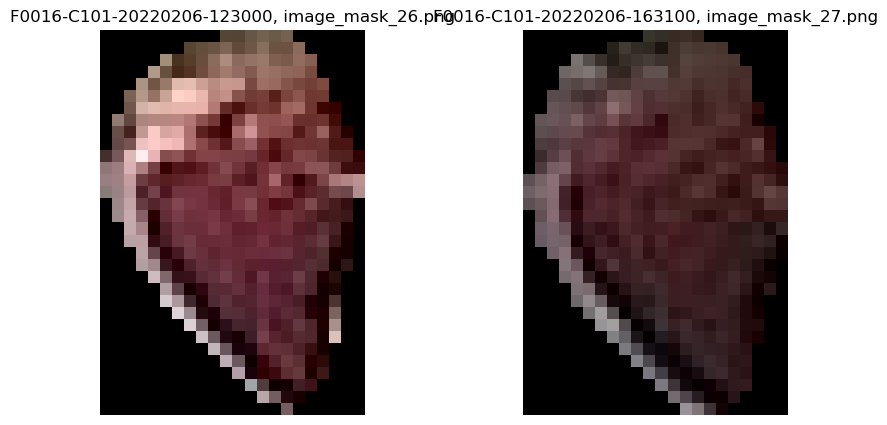

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_77
mask_id                                 eb663da7a56800343c0548a807acf1f7
point_x_x                                                    2026.481567
point_y_x                                                     452.064209
output_image_path_x                                    image_mask_77.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

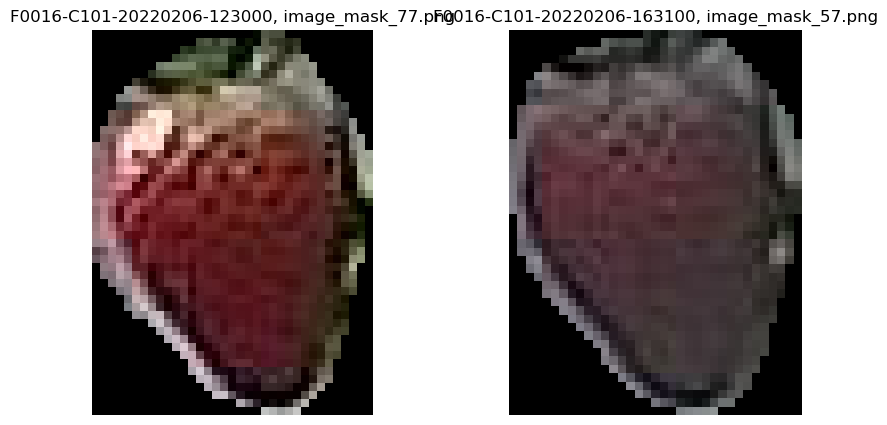

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_77
mask_id                                 eb663da7a56800343c0548a807acf1f7
point_x_x                                                    2026.481567
point_y_x                                                     452.064209
output_image_path_x                                    image_mask_77.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

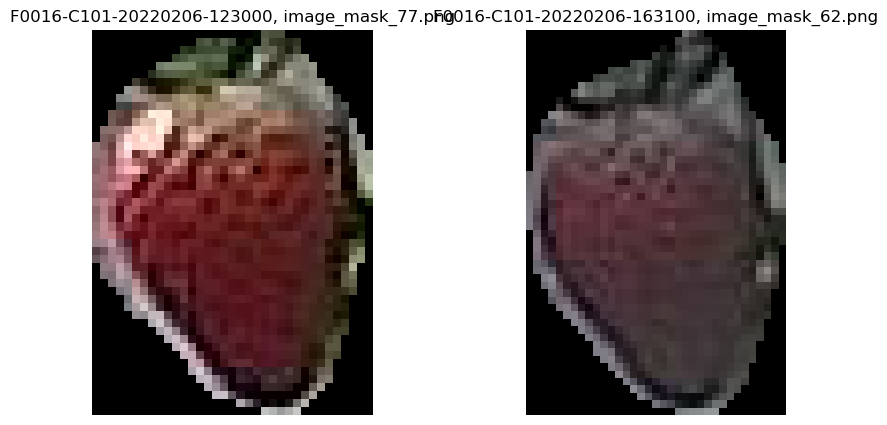

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_37
mask_id                                 ebbed5c86107c5bf275d0d5cc6391b20
point_x_x                                                     951.649658
point_y_x                                                     429.294617
output_image_path_x                                    image_mask_37.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

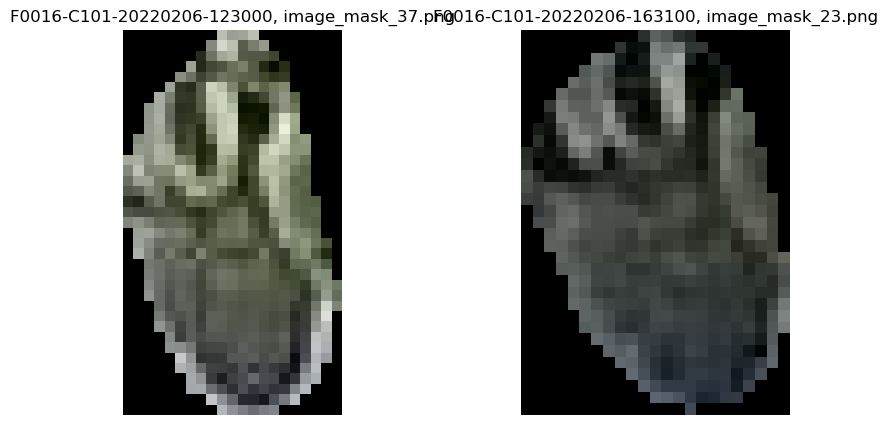

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_52
mask_id                                 f232d6dbcdf460dc945cca06d030e52a
point_x_x                                                    1525.349365
point_y_x                                                     527.816895
output_image_path_x                                    image_mask_52.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

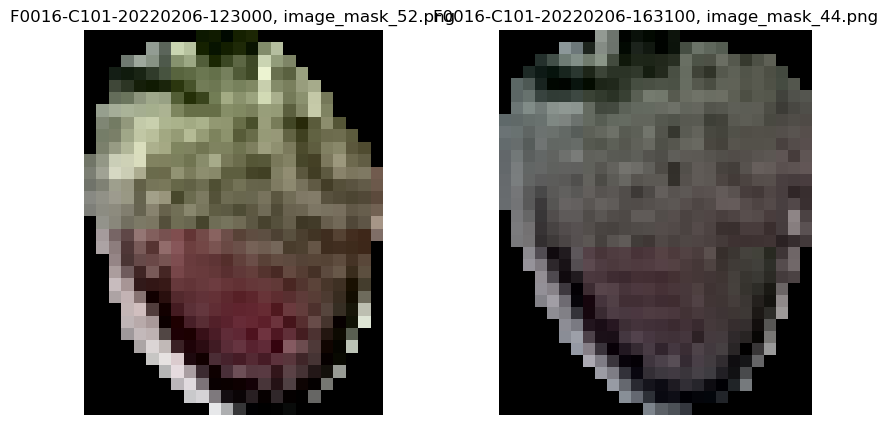

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                  F0016-C101-20220206-123000_3
mask_id                                 f553791a33cc10d05b2e1359e88106ff
point_x_x                                                     451.310791
point_y_x                                                     234.173767
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

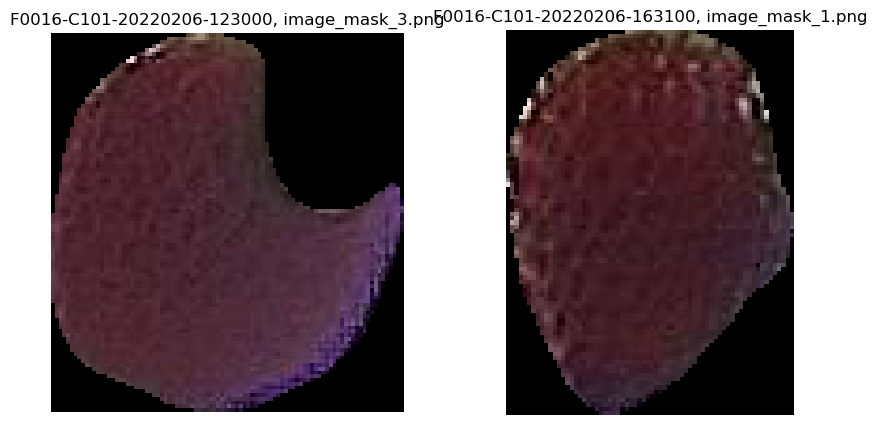

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_14
mask_id                                 f57a626eda2d73e6eb7177e1e0649524
point_x_x                                                    1263.813965
point_y_x                                                     304.217407
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

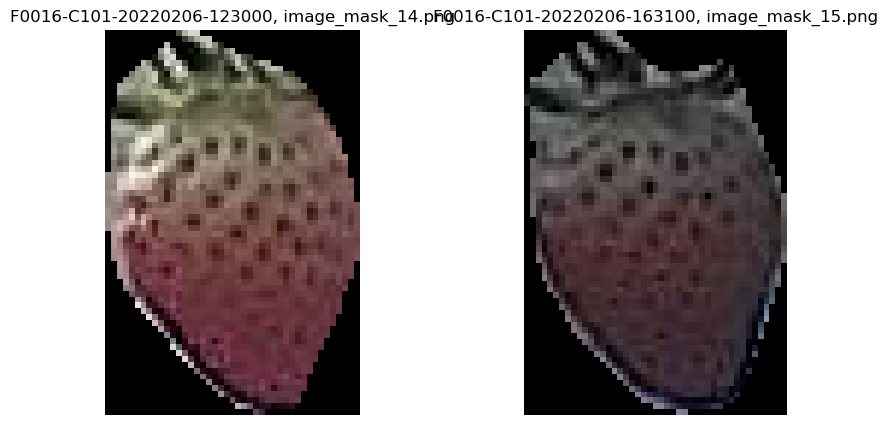

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220206-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220206-083000
mask_num_x                                 F0016-C101-20220206-123000_64
mask_id                                 fc8855f51151abe17a3d63d27436cdc6
point_x_x                                                    1852.318115
point_y_x                                                     135.757385
output_image_path_x                                    image_mask_64.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220206-163100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

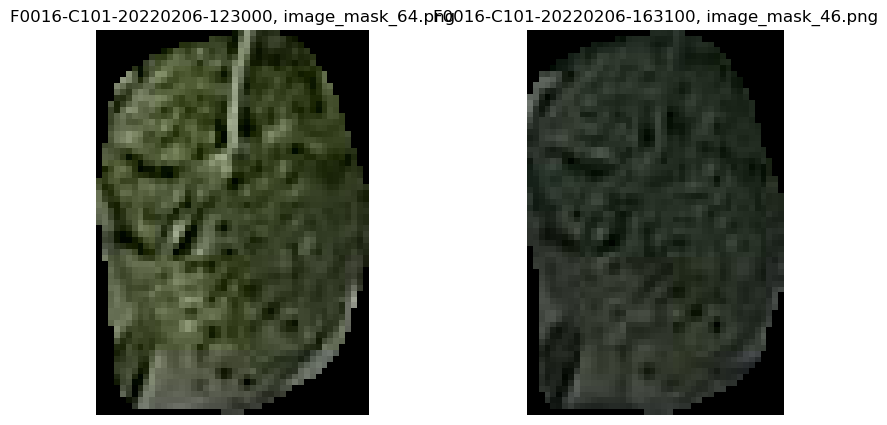

In [157]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_14
mask_id                                 194504b80d753c9411f42416ed633e96
point_x_x                                                    1183.820435
point_y_x                                                     547.066833
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

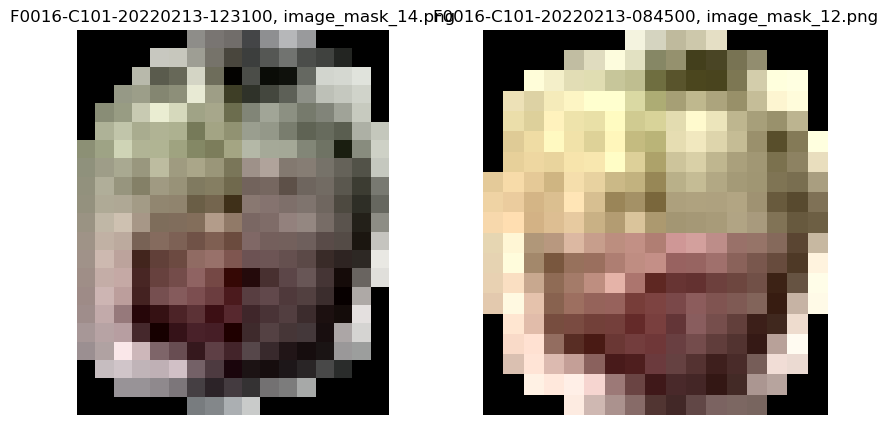

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_1
mask_id                                 2babb793c3bf1581c95a9ae3a652f343
point_x_x                                                     494.997955
point_y_x                                                     267.914246
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

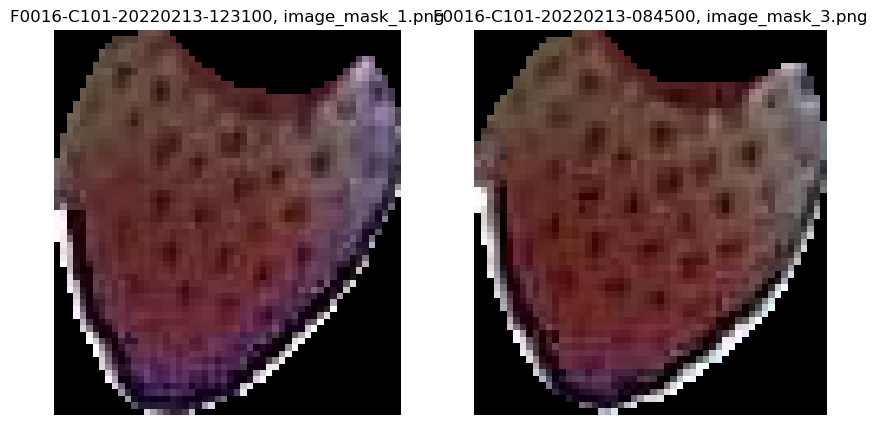

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_26
mask_id                                 2e7f969d13c37517eb03c16dab43753c
point_x_x                                                     915.347107
point_y_x                                                     630.490356
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

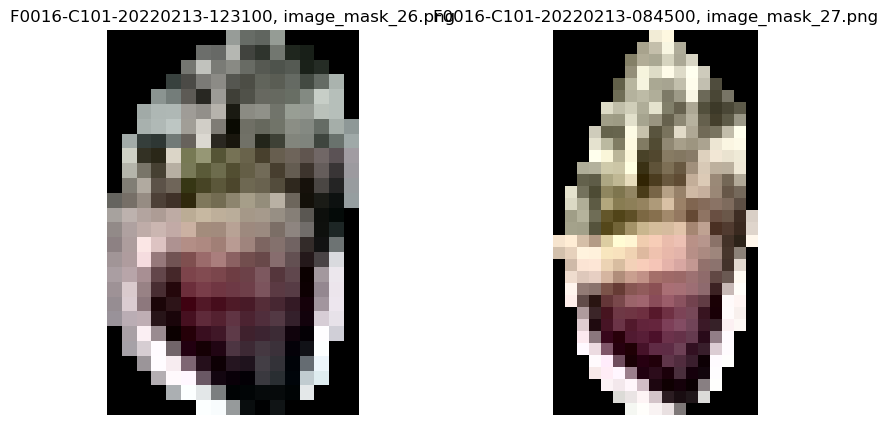

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_37
mask_id                                 3300d25a36f5129b91f774c87ffd516e
point_x_x                                                    1520.768555
point_y_x                                                     204.026978
output_image_path_x                                    image_mask_37.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

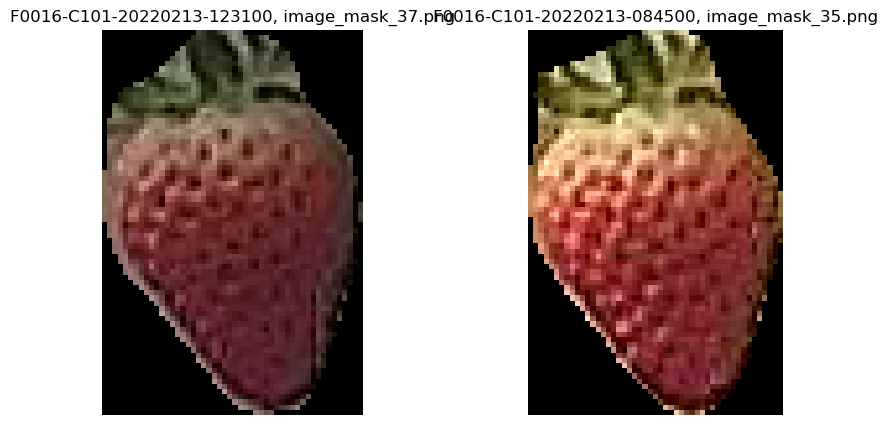

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_40
mask_id                                 367c2aee3c00ae73ab2a2653c018a216
point_x_x                                                    1358.682007
point_y_x                                                     248.637085
output_image_path_x                                    image_mask_40.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

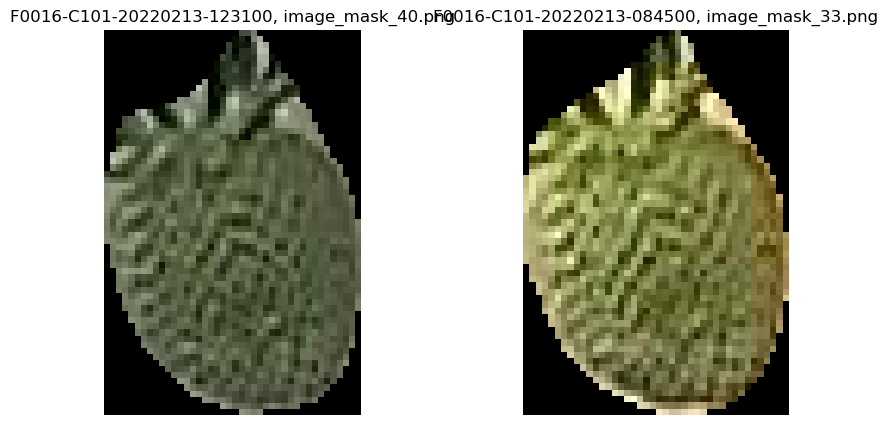

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_15
mask_id                                 38a4fa43e63eba2eecfd322ed8d9b44f
point_x_x                                                    1059.203247
point_y_x                                                     419.996948
output_image_path_x                                    image_mask_15.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

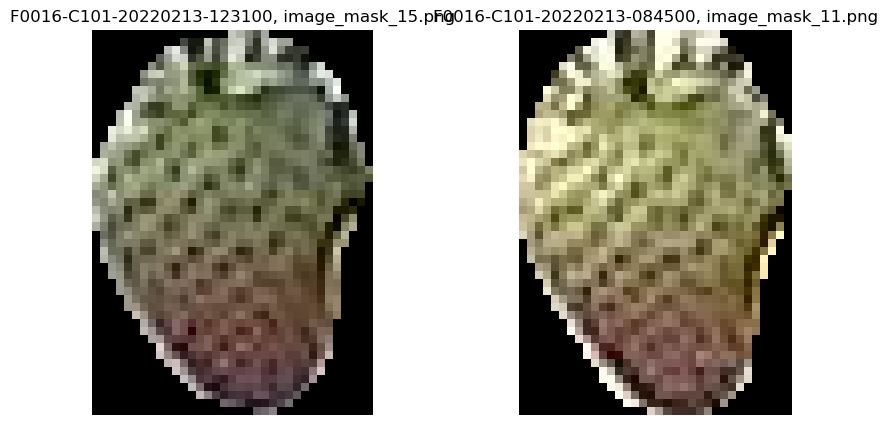

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_18
mask_id                                 3cfada29cd4ed7a0e209c3ba320ac3de
point_x_x                                                    1142.102661
point_y_x                                                     638.550659
output_image_path_x                                    image_mask_18.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

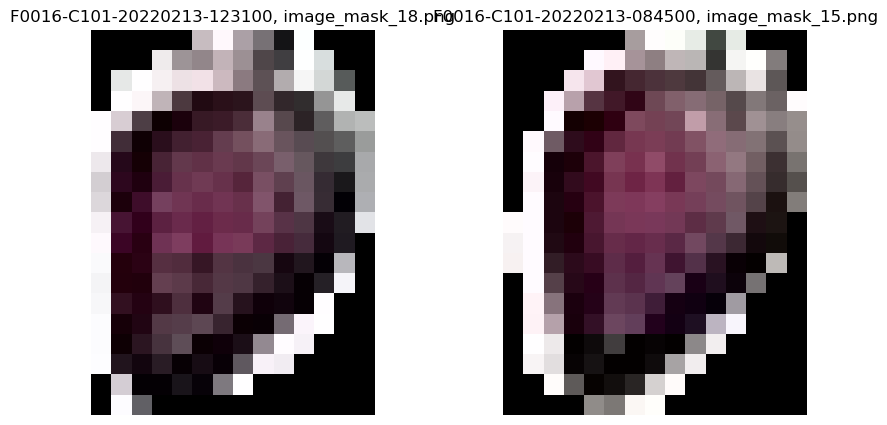

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_11
mask_id                                 421200111c7d3804a5f9e83354e41bec
point_x_x                                                      437.68634
point_y_x                                                     603.420044
output_image_path_x                                    image_mask_11.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

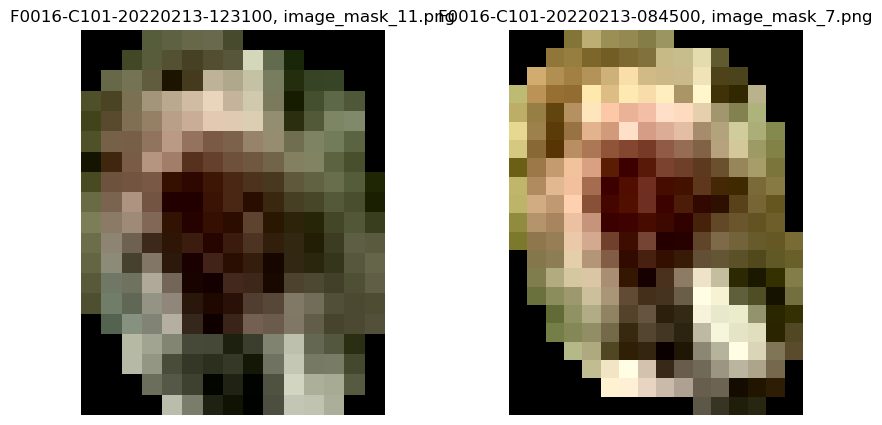

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_24
mask_id                                 42e3d2cab0cf7f9e5129117b9e34e07f
point_x_x                                                     772.925781
point_y_x                                                     487.491058
output_image_path_x                                    image_mask_24.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

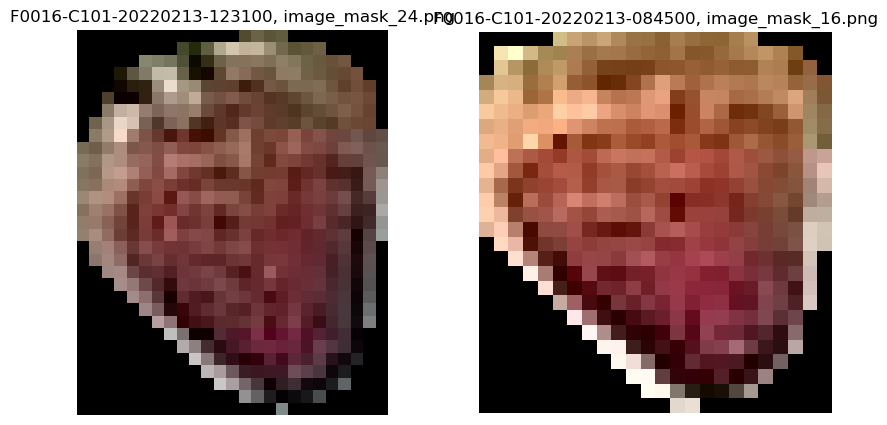

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_16
mask_id                                 4324212bf0c794ff90cd1276ee1d5621
point_x_x                                                      795.62146
point_y_x                                                     473.908264
output_image_path_x                                    image_mask_16.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

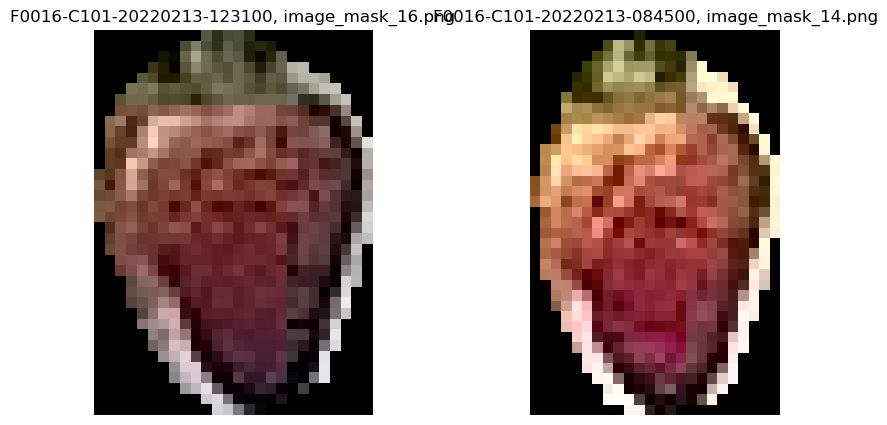

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_43
mask_id                                 4a483e5c3ce019b09af531759f4748fc
point_x_x                                                    1727.163452
point_y_x                                                      55.417305
output_image_path_x                                    image_mask_43.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

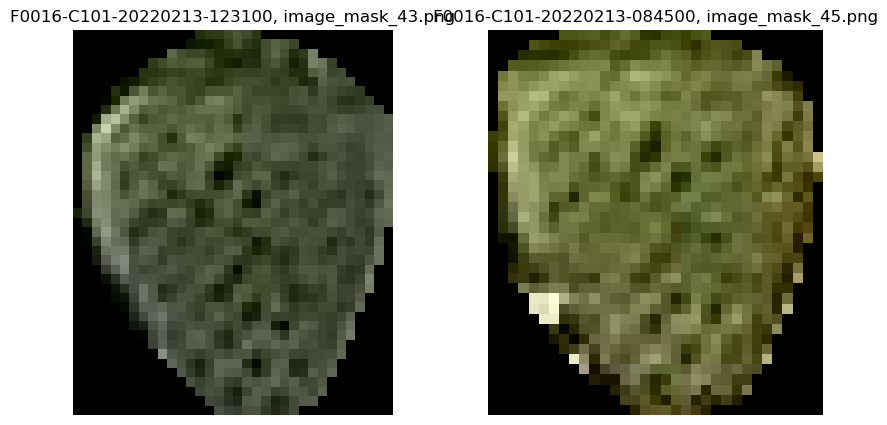

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_4
mask_id                                 50398c67658de31585564db8871709ac
point_x_x                                                     517.746521
point_y_x                                                     197.689972
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

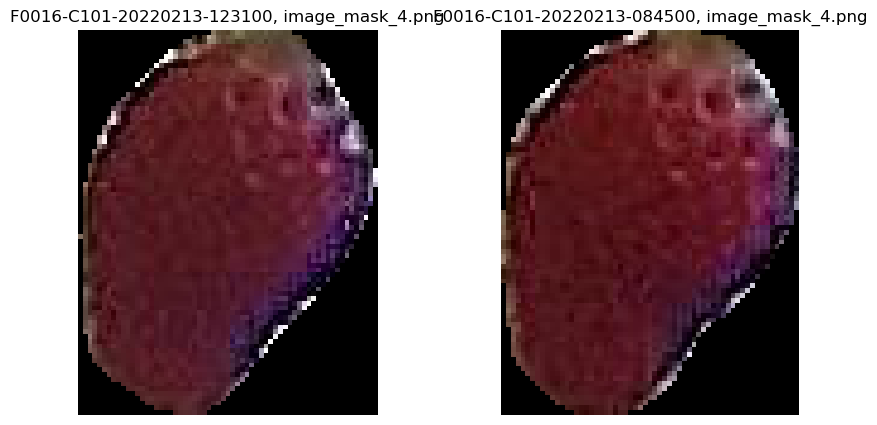

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_25
mask_id                                 51189564b91cc830f88514bc03df2f2c
point_x_x                                                     954.196106
point_y_x                                                     577.582642
output_image_path_x                                    image_mask_25.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

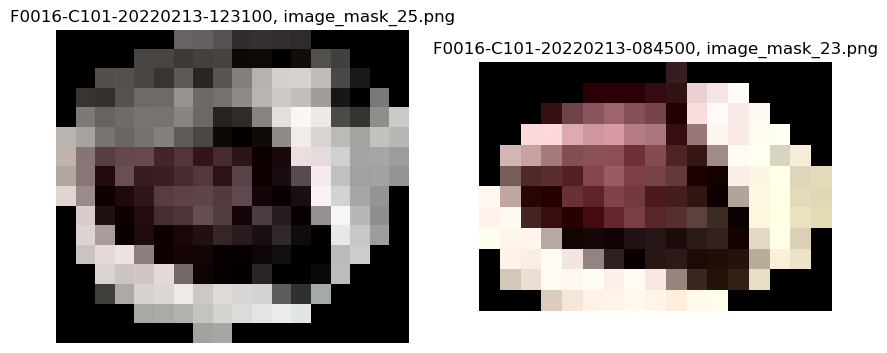

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_2
mask_id                                 57b6be28b2a15dc323ae2fdeac740075
point_x_x                                                     625.318359
point_y_x                                                      578.09314
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

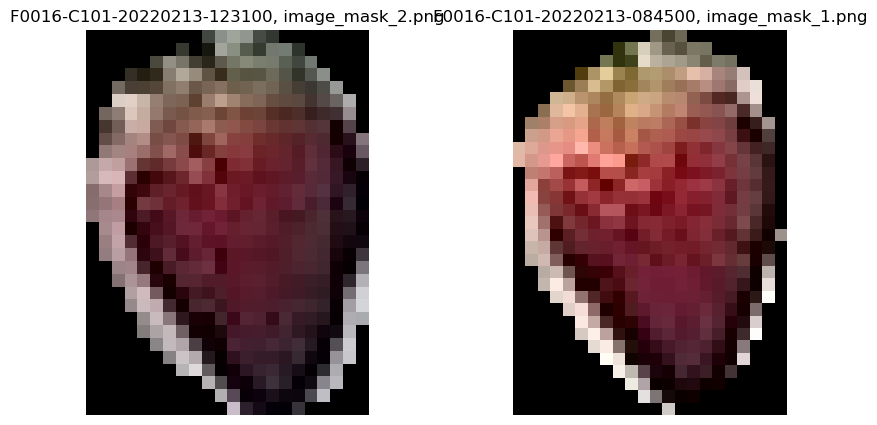

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_49
mask_id                                 63c09cbbb662f61afe675b72f96e905b
point_x_x                                                    1355.984131
point_y_x                                                     175.316986
output_image_path_x                                    image_mask_49.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

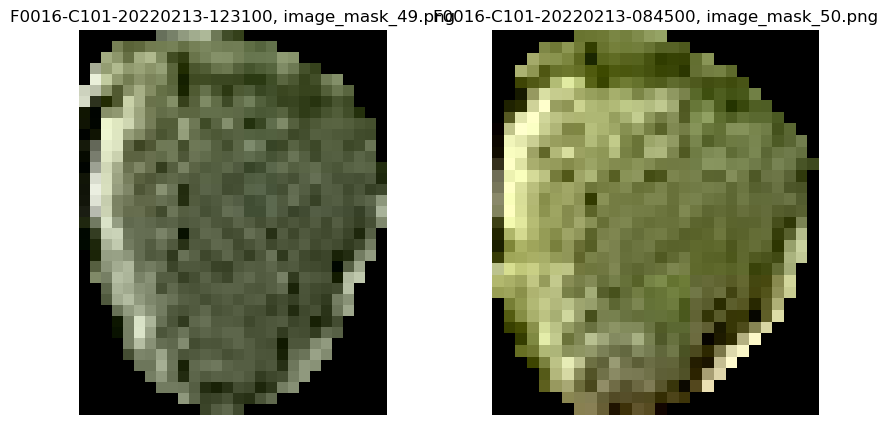

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_45
mask_id                                 6c0f515ff4df1b54b6364512c542baff
point_x_x                                                    1898.543213
point_y_x                                                      75.857681
output_image_path_x                                    image_mask_45.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

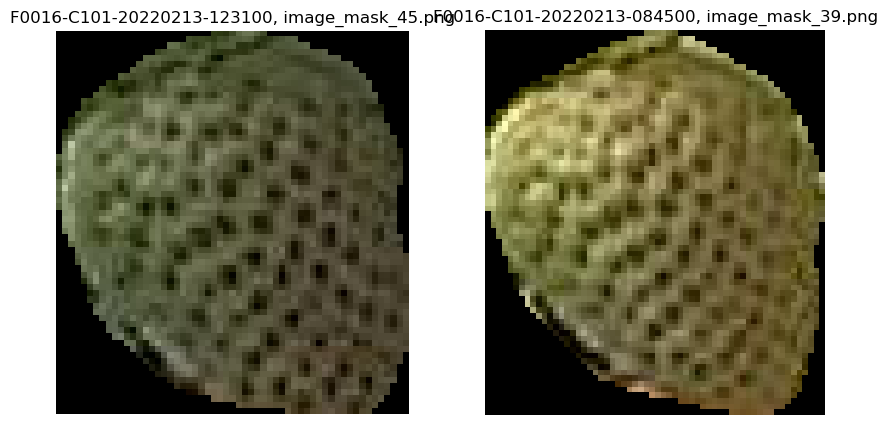

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_20
mask_id                                 72b2f6651cdf576903b5cd64de66eaee
point_x_x                                                     982.413086
point_y_x                                                     440.766357
output_image_path_x                                    image_mask_20.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

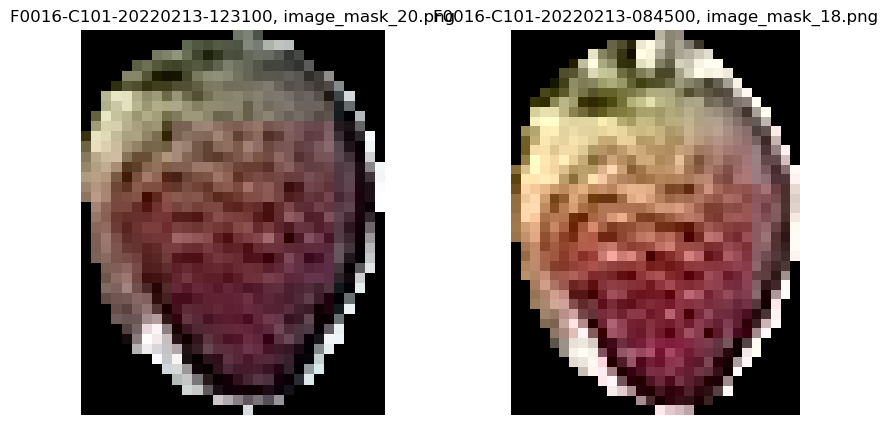

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_67
mask_id                                 7a775eff0e2ff602da1713ccfef4f67e
point_x_x                                                    2070.019531
point_y_x                                                      41.014019
output_image_path_x                                    image_mask_67.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

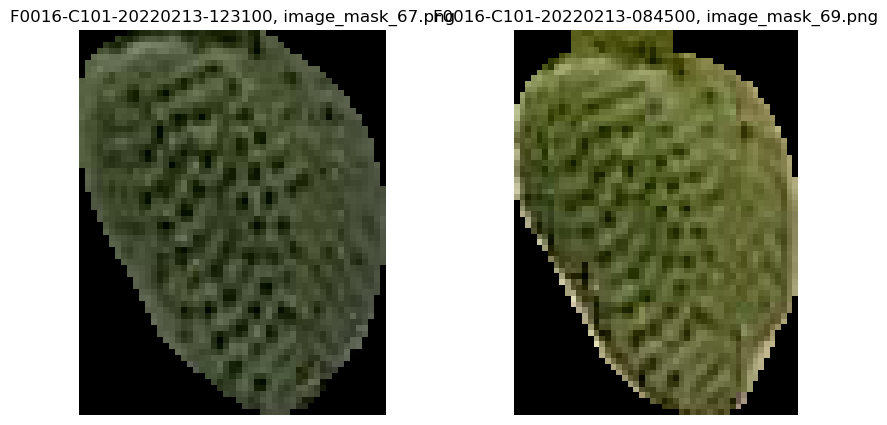

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_65
mask_id                                 7d78902ab2ef05dfe489937a97aa69c5
point_x_x                                                    2308.498535
point_y_x                                                     392.717407
output_image_path_x                                    image_mask_65.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

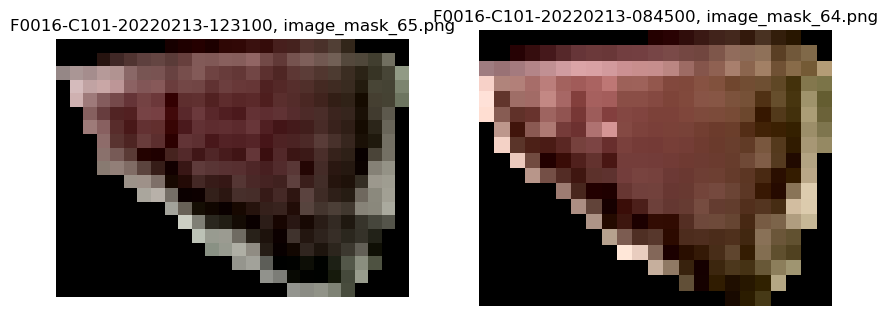

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_60
mask_id                                 7f7e34c1ece92fff3bd7ff13d0ec42db
point_x_x                                                    1953.606934
point_y_x                                                      167.92392
output_image_path_x                                    image_mask_60.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

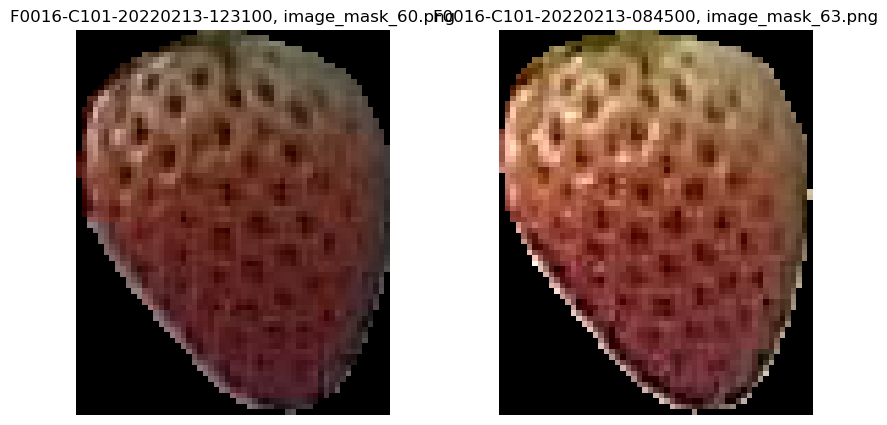

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_21
mask_id                                 7f89d470fd4679c1aa9a84654e96d388
point_x_x                                                     718.288147
point_y_x                                                     502.686157
output_image_path_x                                    image_mask_21.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

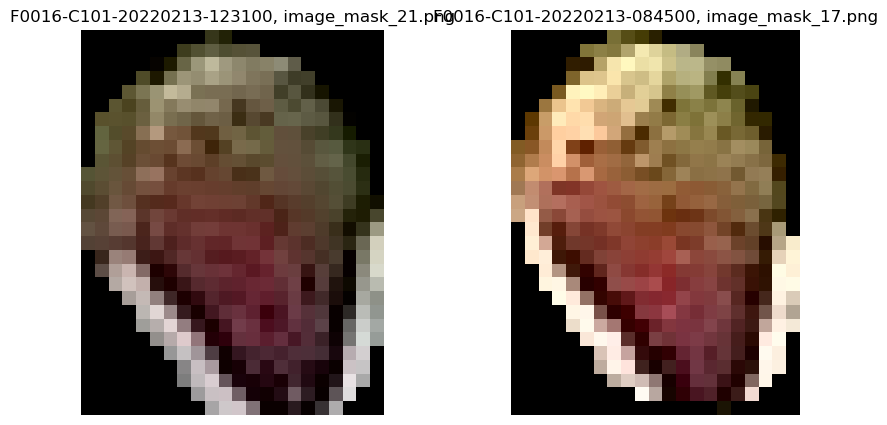

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_57
mask_id                                 9181d56215ac08d4d8e72e18e8f0404d
point_x_x                                                    1792.569092
point_y_x                                                     460.349915
output_image_path_x                                    image_mask_57.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

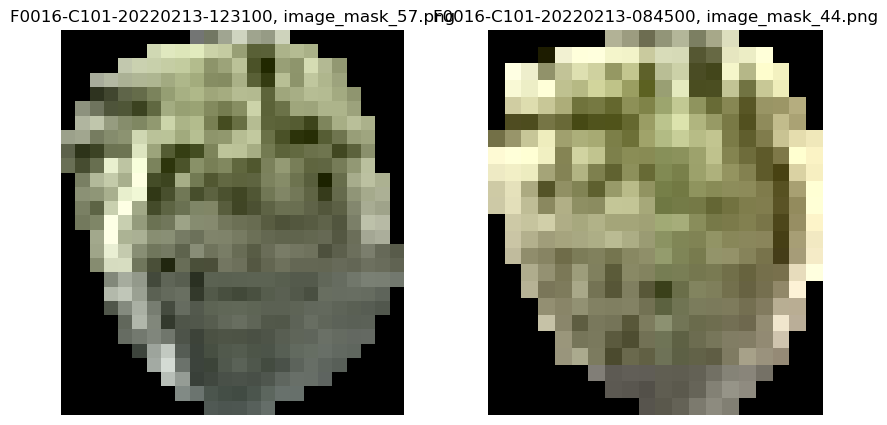

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_33
mask_id                                 96afe30f9f21b30917c1fc45a094d515
point_x_x                                                     922.841309
point_y_x                                                     586.761658
output_image_path_x                                    image_mask_33.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

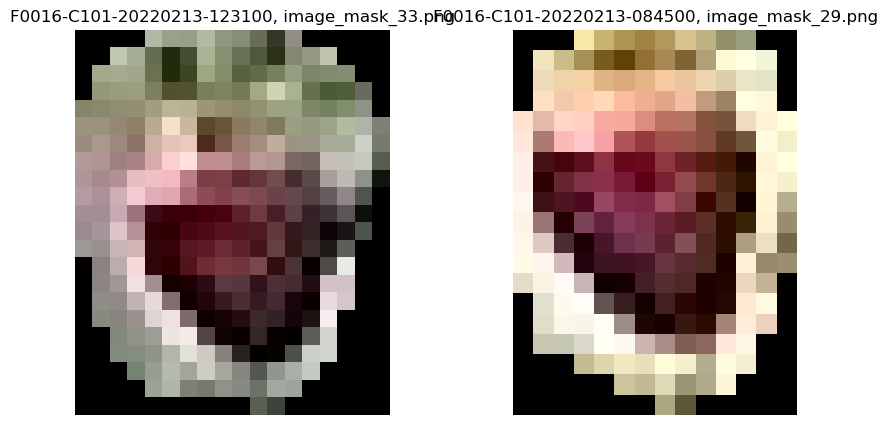

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_61
mask_id                                 9df4a1f7158196de71d9dd679640e9fe
point_x_x                                                    2346.083252
point_y_x                                                     398.009705
output_image_path_x                                    image_mask_61.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

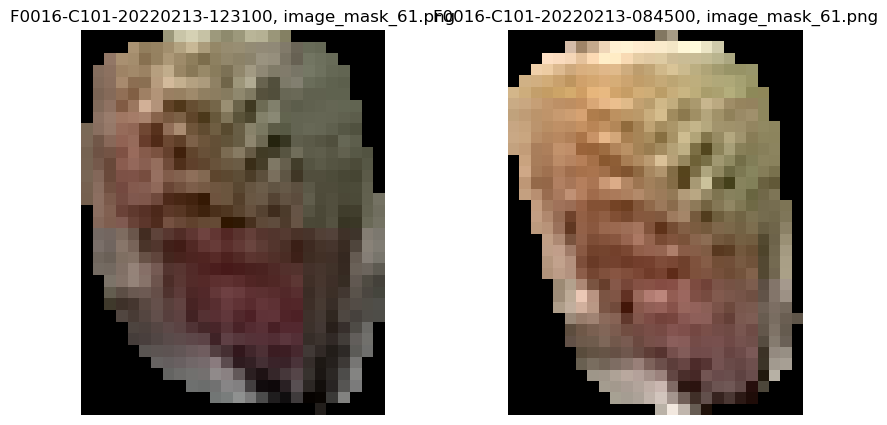

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_19
mask_id                                 9f2da9630ed75d8201f65a1b9f595bd1
point_x_x                                                    1155.710449
point_y_x                                                      553.19397
output_image_path_x                                    image_mask_19.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

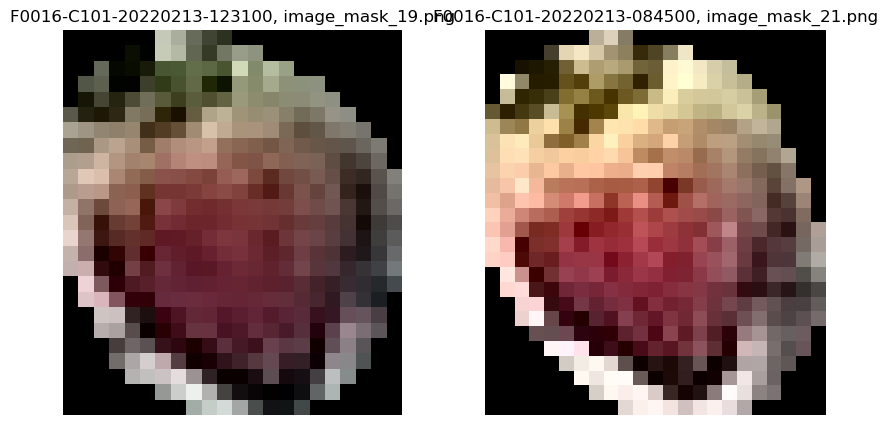

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_46
mask_id                                 9fd15f9f7f4163ceb240783c05d566eb
point_x_x                                                    1822.664551
point_y_x                                                     169.075836
output_image_path_x                                    image_mask_46.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

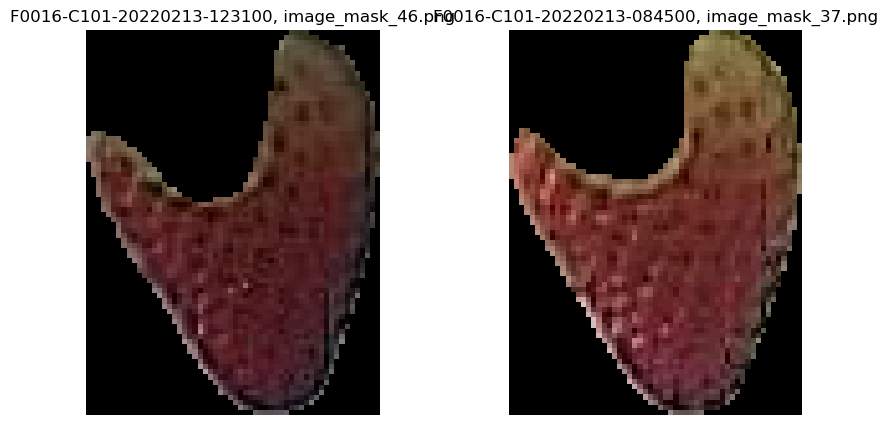

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_3
mask_id                                 a0be4c324fea847382e5eb418c941d2a
point_x_x                                                     601.782227
point_y_x                                                     580.521912
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

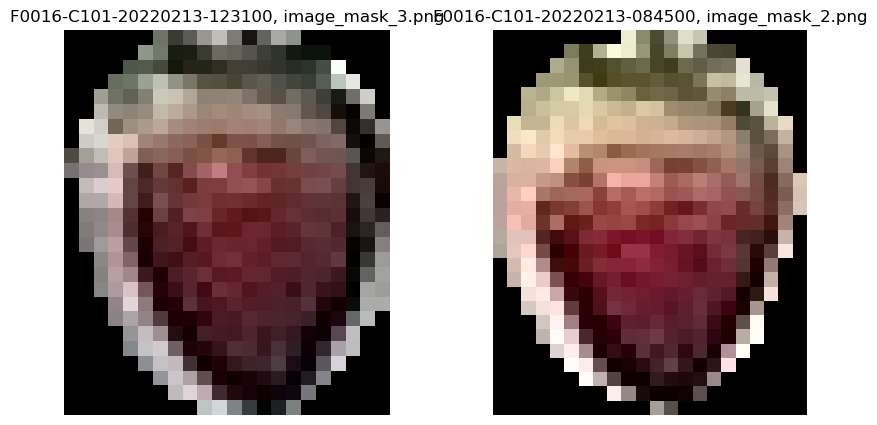

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_42
mask_id                                 a2844b868e00882a26d5699094abe290
point_x_x                                                    1424.169678
point_y_x                                                      523.46814
output_image_path_x                                    image_mask_42.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

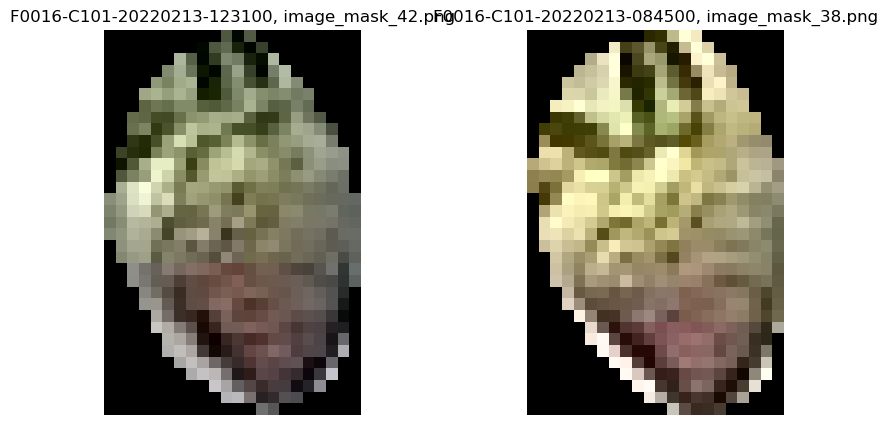

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_63
mask_id                                 aeeefcebaeba820a3be73cfbf76e99af
point_x_x                                                    2378.879395
point_y_x                                                     408.833374
output_image_path_x                                    image_mask_63.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

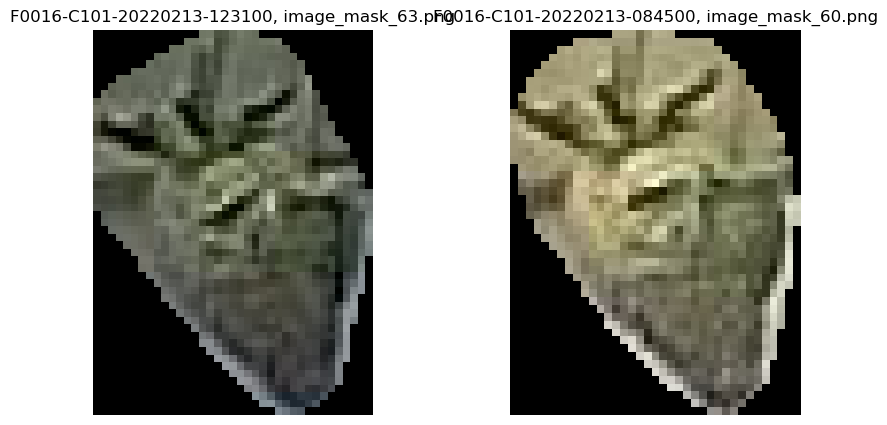

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_64
mask_id                                 b199d24b72e737cfb461dafab0e4fb81
point_x_x                                                    1991.425903
point_y_x                                                     103.620766
output_image_path_x                                    image_mask_64.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

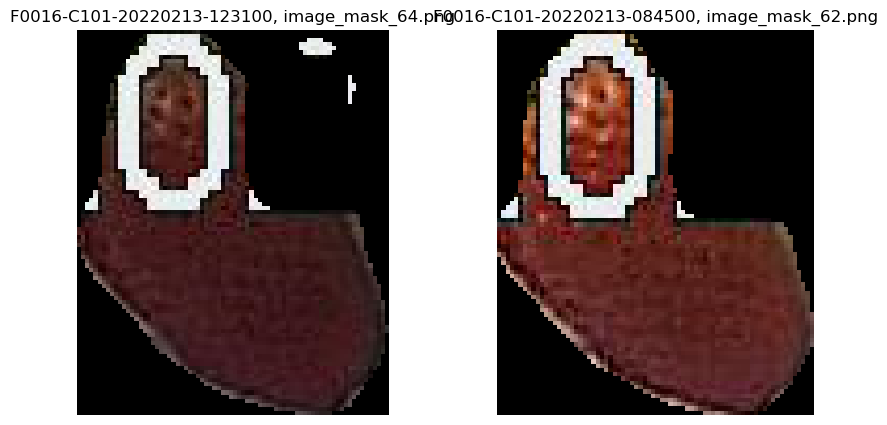

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_51
mask_id                                 b954235faf812ca861870073c87288d1
point_x_x                                                    1455.137085
point_y_x                                                     528.406494
output_image_path_x                                    image_mask_51.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

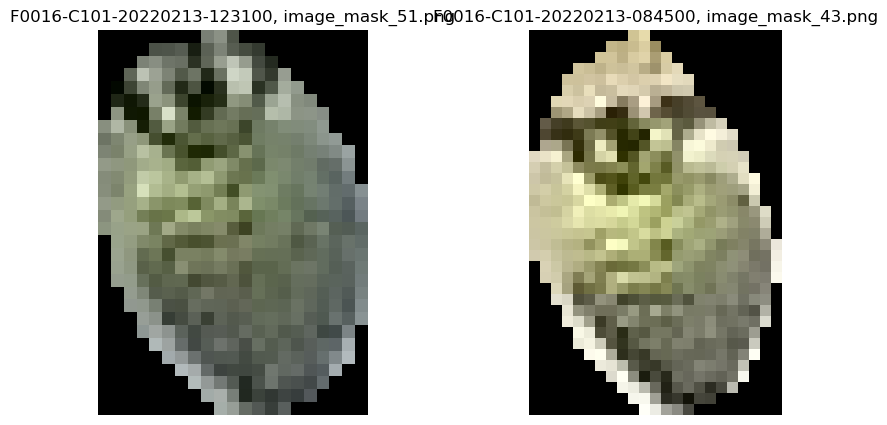

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_51
mask_id                                 b954235faf812ca861870073c87288d1
point_x_x                                                    1455.137085
point_y_x                                                     528.406494
output_image_path_x                                    image_mask_51.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

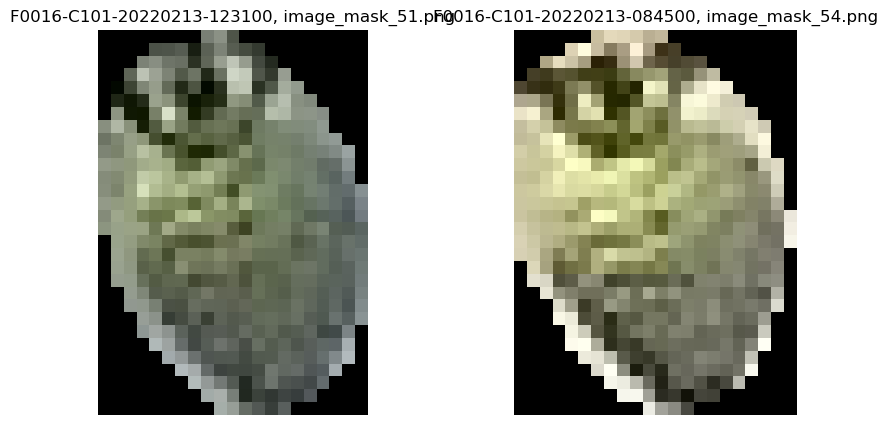

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_27
mask_id                                 c0459b302be9802c0578977d6b168efc
point_x_x                                                    1224.921875
point_y_x                                                     252.808563
output_image_path_x                                    image_mask_27.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

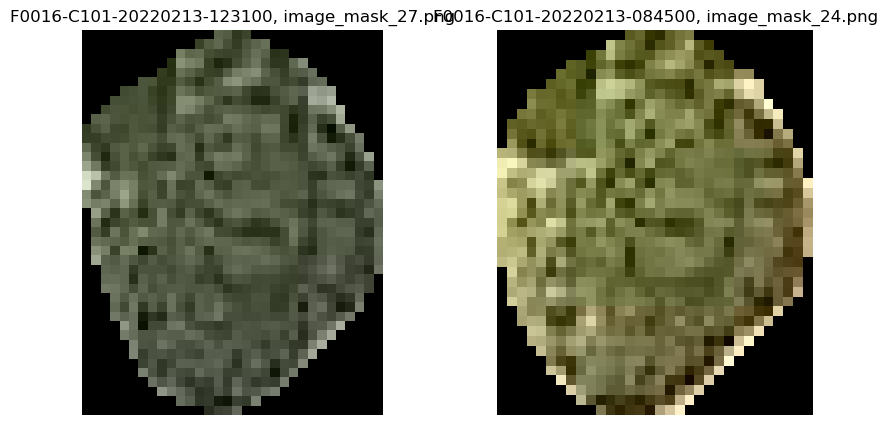

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_50
mask_id                                 c7523a61c1235d029671cf6f7cd603dc
point_x_x                                                    1541.463623
point_y_x                                                     504.781647
output_image_path_x                                    image_mask_50.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

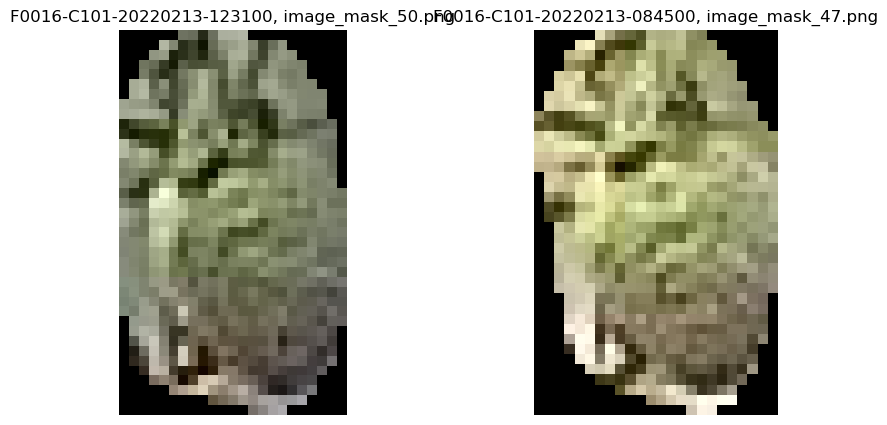

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_50
mask_id                                 c7523a61c1235d029671cf6f7cd603dc
point_x_x                                                    1541.463623
point_y_x                                                     504.781647
output_image_path_x                                    image_mask_50.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

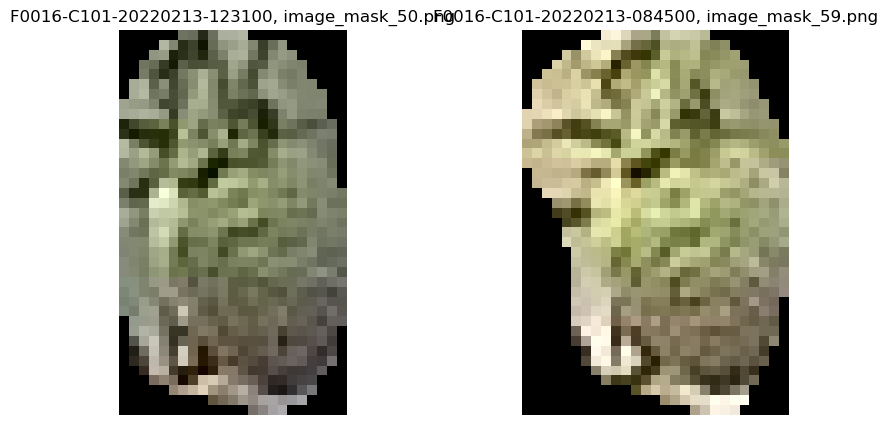

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_31
mask_id                                 c83256c46c57597229270d4aba5e36e1
point_x_x                                                    1037.152588
point_y_x                                                     574.397888
output_image_path_x                                    image_mask_31.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

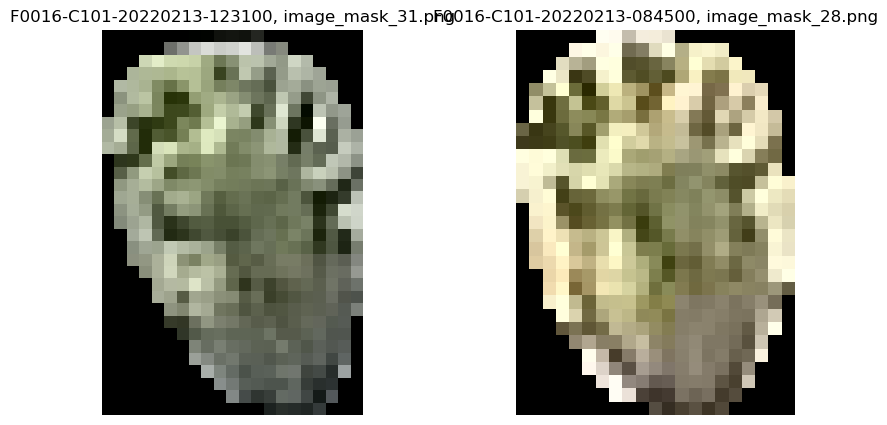

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_59
mask_id                                 c83b5ac7613f9a84b81e1f2cc3a6301c
point_x_x                                                    1974.366333
point_y_x                                                     440.888672
output_image_path_x                                    image_mask_59.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

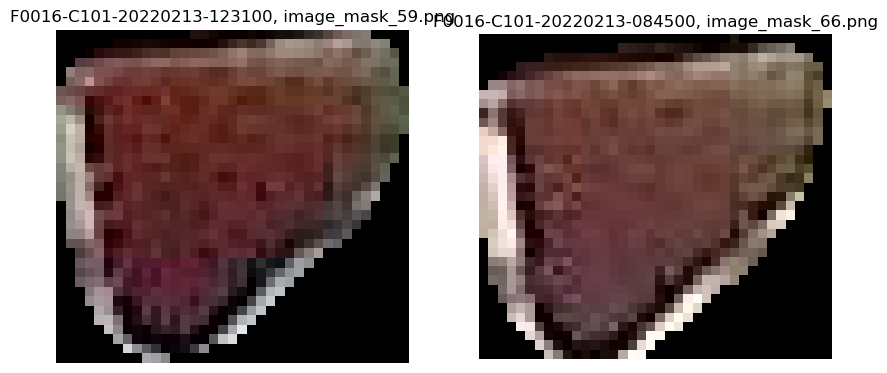

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_41
mask_id                                 ccf400a6a135984615b41b5cc72a724b
point_x_x                                                     1833.05957
point_y_x                                                     461.666382
output_image_path_x                                    image_mask_41.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

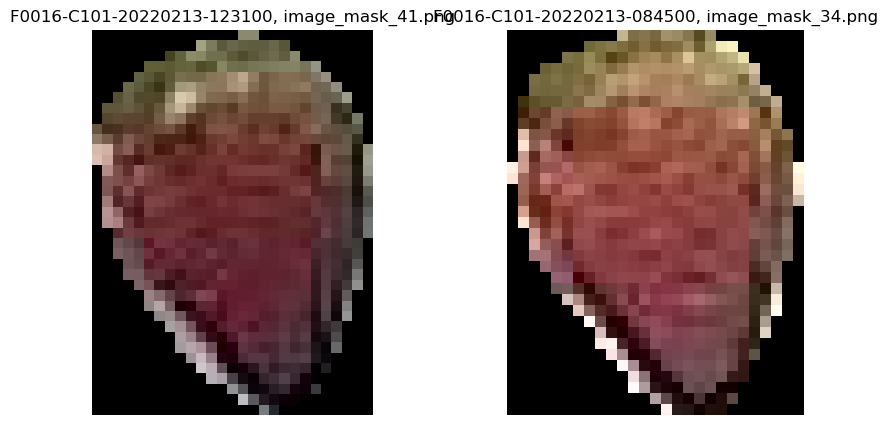

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_30
mask_id                                 cd4a539d7a19e4873c92e86583e5bdd0
point_x_x                                                    1099.376465
point_y_x                                                     552.460815
output_image_path_x                                    image_mask_30.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

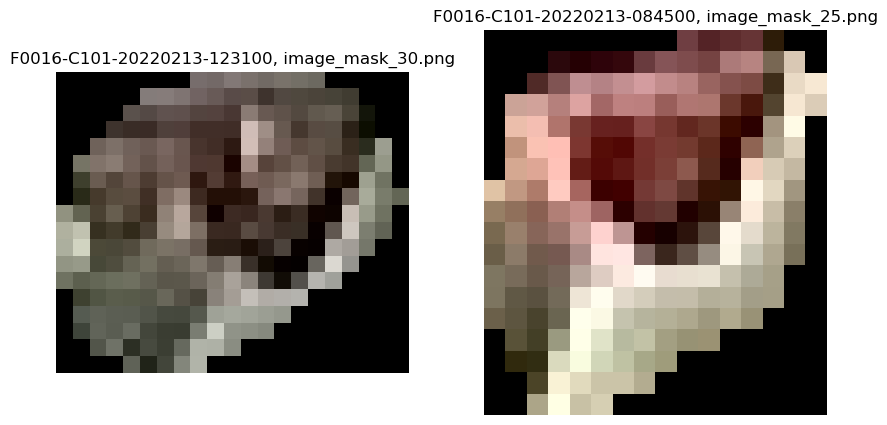

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_30
mask_id                                 cd4a539d7a19e4873c92e86583e5bdd0
point_x_x                                                    1099.376465
point_y_x                                                     552.460815
output_image_path_x                                    image_mask_30.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

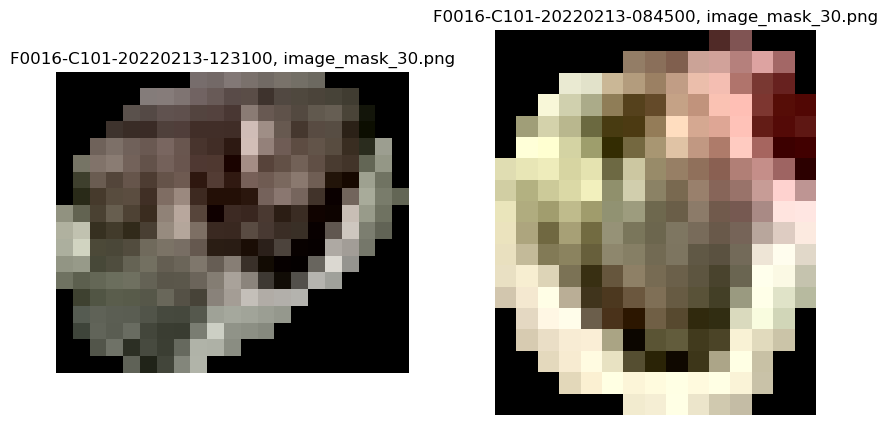

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_34
mask_id                                 cd4a539d7a19e4873c92e86583e5bdd0
point_x_x                                                    1090.028076
point_y_x                                                     558.206665
output_image_path_x                                    image_mask_34.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

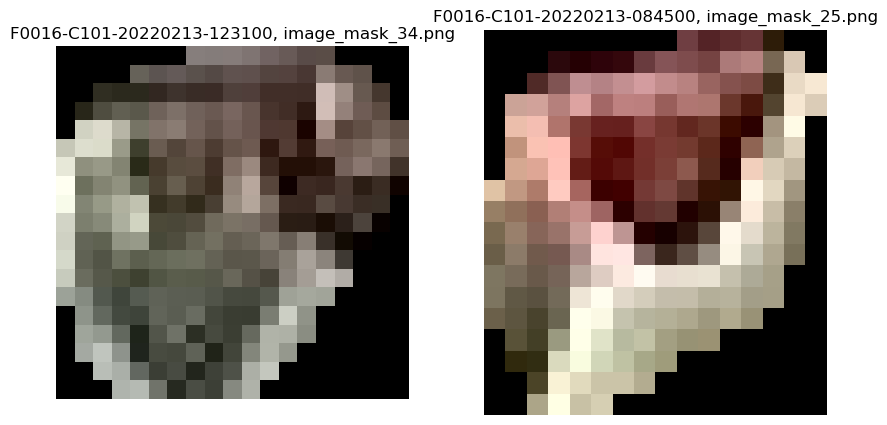

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_34
mask_id                                 cd4a539d7a19e4873c92e86583e5bdd0
point_x_x                                                    1090.028076
point_y_x                                                     558.206665
output_image_path_x                                    image_mask_34.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

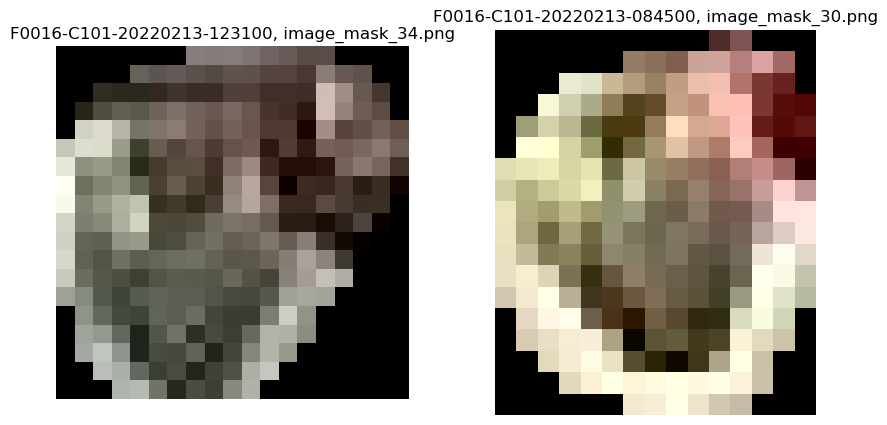

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_36
mask_id                                 d752e48adef773146987bfe1c3527fa0
point_x_x                                                    1582.638062
point_y_x                                                     185.965271
output_image_path_x                                    image_mask_36.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

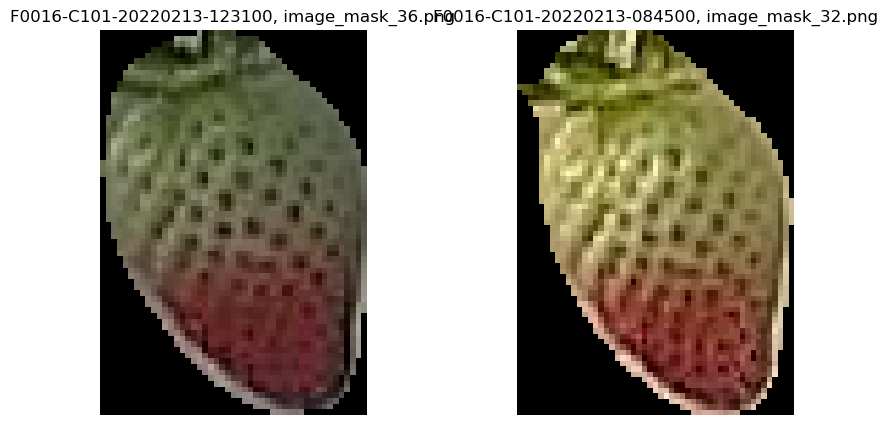

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_66
mask_id                                 e0f96d917577ddf4df52cc4b4aff3bae
point_x_x                                                    1924.652832
point_y_x                                                     449.581421
output_image_path_x                                    image_mask_66.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

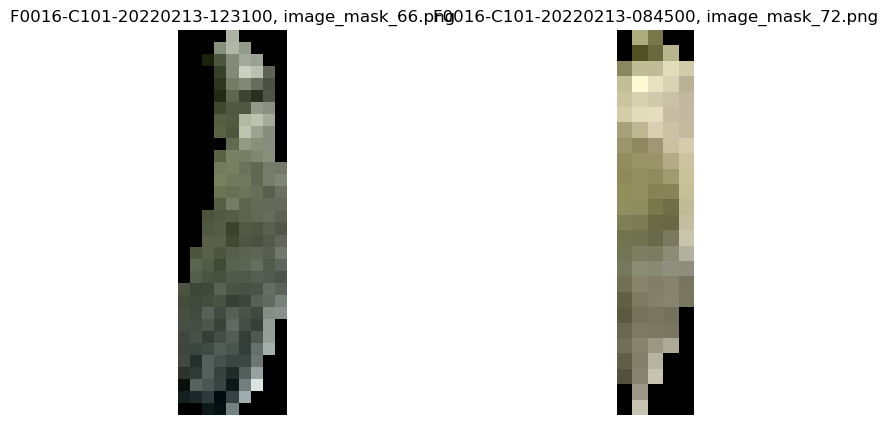

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_23
mask_id                                 ebbed5c86107c5bf275d0d5cc6391b20
point_x_x                                                     961.437317
point_y_x                                                     436.994263
output_image_path_x                                    image_mask_23.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

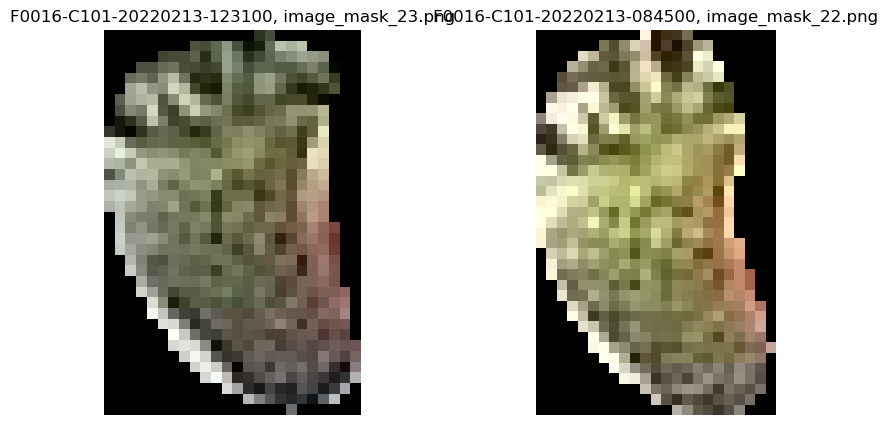

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_39
mask_id                                 f232d6dbcdf460dc945cca06d030e52a
point_x_x                                                    1534.602539
point_y_x                                                     532.968384
output_image_path_x                                    image_mask_39.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

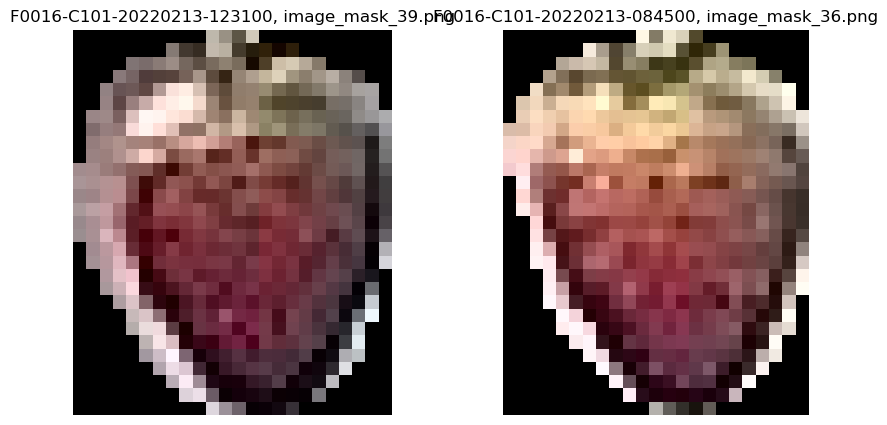

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_47
mask_id                                 f7e54b26fd84e2b8e0ed3e23f062c4fe
point_x_x                                                    1559.416016
point_y_x                                                     131.445221
output_image_path_x                                    image_mask_47.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-084500
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

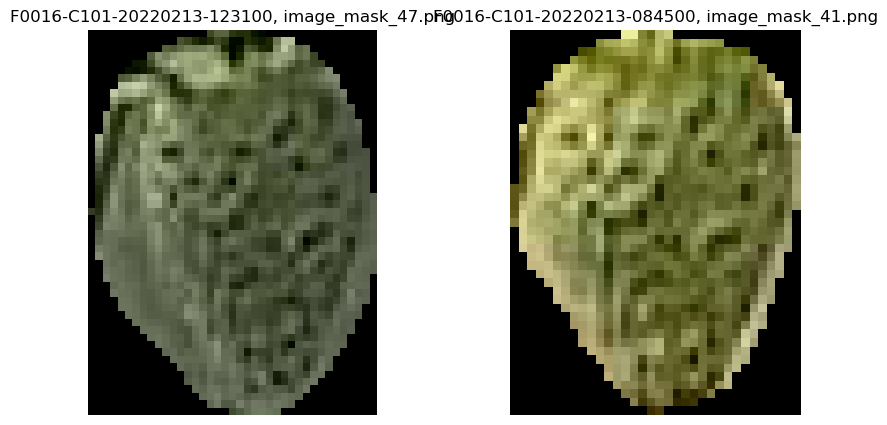

In [19]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

image_35 있는거 잘못 맵핑됨

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_14
mask_id                                 194504b80d753c9411f42416ed633e96
point_x_x                                                    1183.820435
point_y_x                                                     547.066833
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

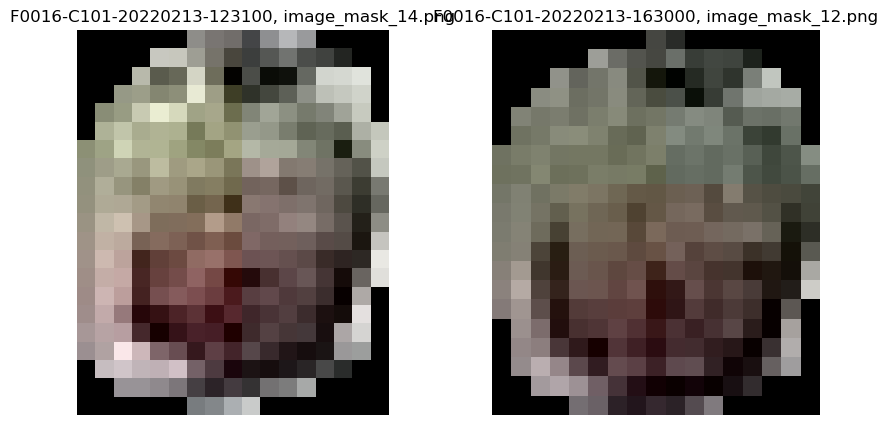

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_17
mask_id                                 24efd47294005fffe8274a0e33b018fd
point_x_x                                                    1088.908203
point_y_x                                                     432.389587
output_image_path_x                                    image_mask_17.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

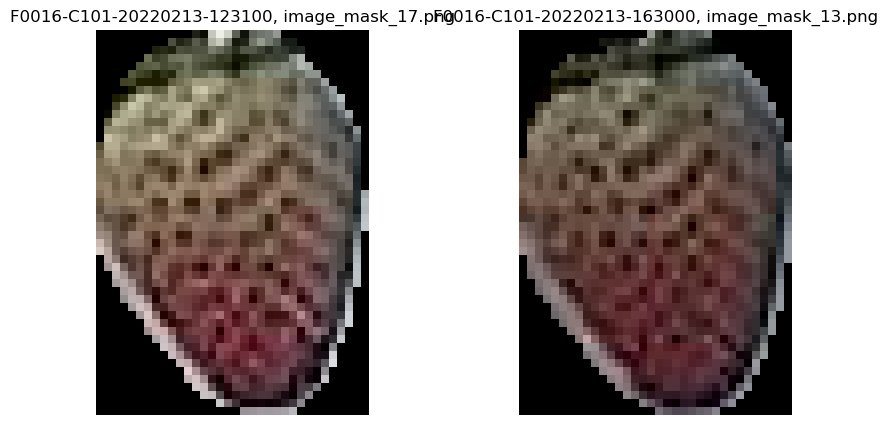

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_1
mask_id                                 2babb793c3bf1581c95a9ae3a652f343
point_x_x                                                     494.997955
point_y_x                                                     267.914246
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

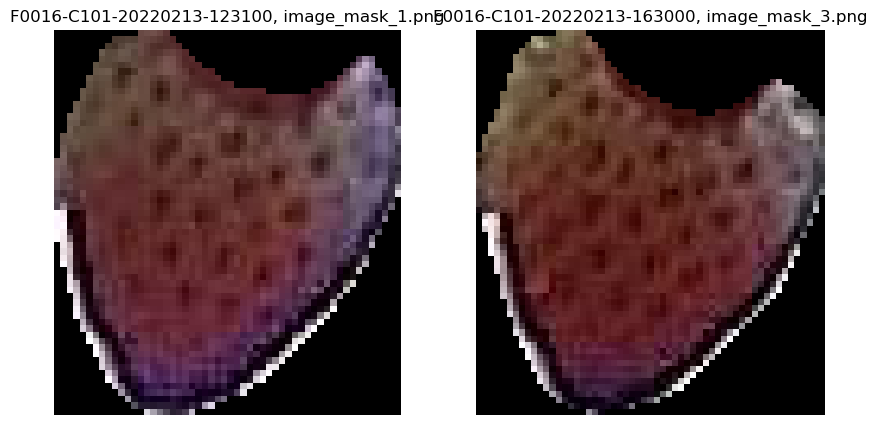

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_26
mask_id                                 2e7f969d13c37517eb03c16dab43753c
point_x_x                                                     915.347107
point_y_x                                                     630.490356
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

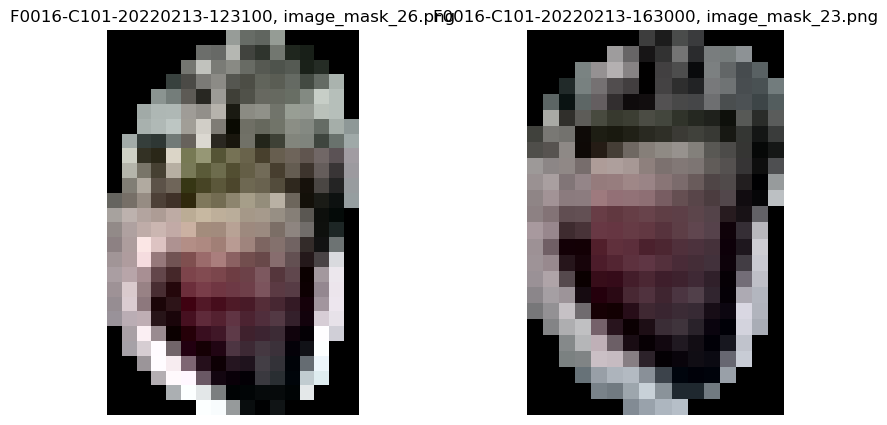

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_26
mask_id                                 2e7f969d13c37517eb03c16dab43753c
point_x_x                                                     915.347107
point_y_x                                                     630.490356
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

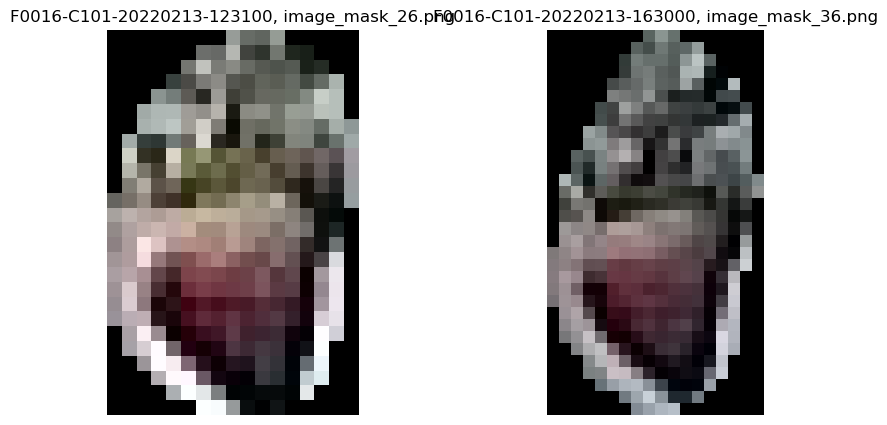

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_37
mask_id                                 3300d25a36f5129b91f774c87ffd516e
point_x_x                                                    1520.768555
point_y_x                                                     204.026978
output_image_path_x                                    image_mask_37.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

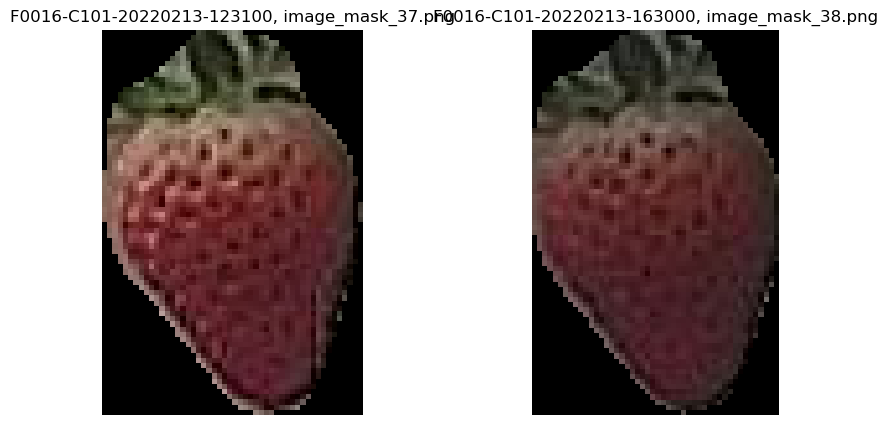

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_38
mask_id                                 3344fa3e05097b28dd22394ba950c01e
point_x_x                                                    1902.480957
point_y_x                                                     139.517471
output_image_path_x                                    image_mask_38.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

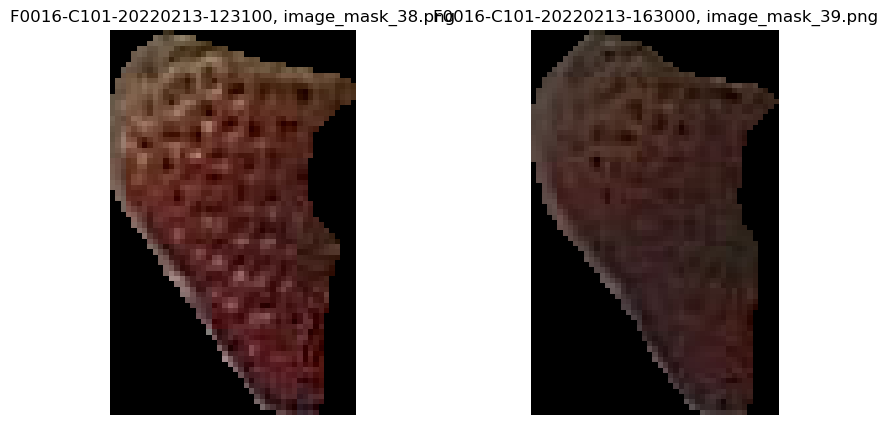

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_40
mask_id                                 367c2aee3c00ae73ab2a2653c018a216
point_x_x                                                    1358.682007
point_y_x                                                     248.637085
output_image_path_x                                    image_mask_40.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

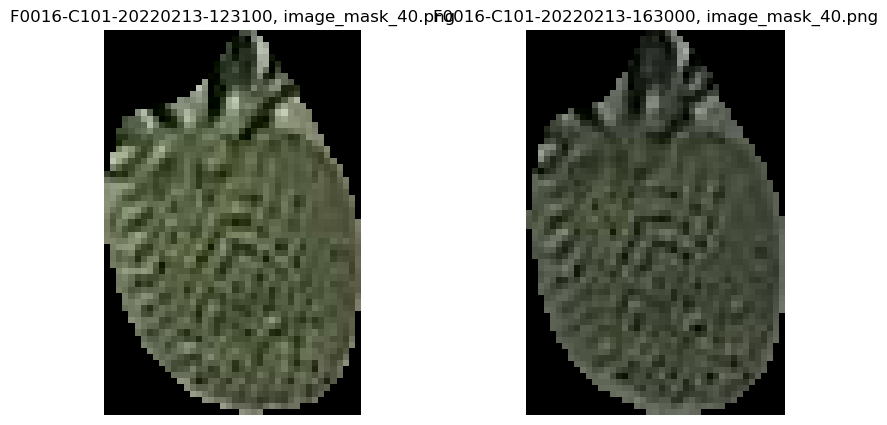

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_15
mask_id                                 38a4fa43e63eba2eecfd322ed8d9b44f
point_x_x                                                    1059.203247
point_y_x                                                     419.996948
output_image_path_x                                    image_mask_15.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

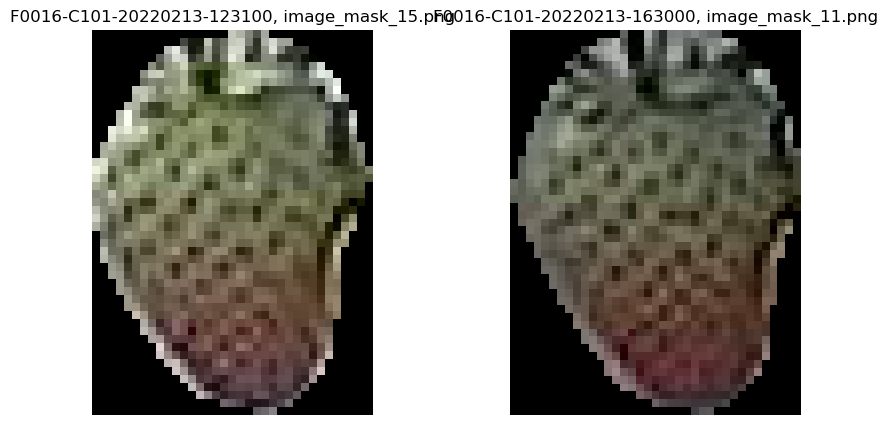

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_18
mask_id                                 3cfada29cd4ed7a0e209c3ba320ac3de
point_x_x                                                    1142.102661
point_y_x                                                     638.550659
output_image_path_x                                    image_mask_18.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

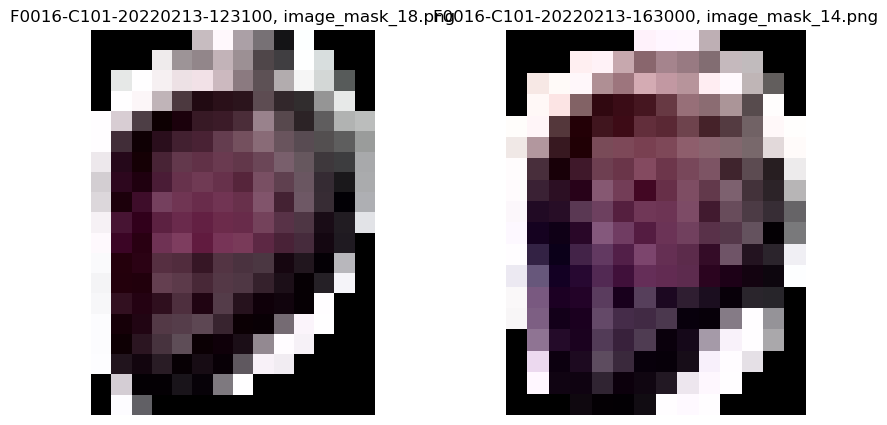

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_24
mask_id                                 42e3d2cab0cf7f9e5129117b9e34e07f
point_x_x                                                     772.925781
point_y_x                                                     487.491058
output_image_path_x                                    image_mask_24.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

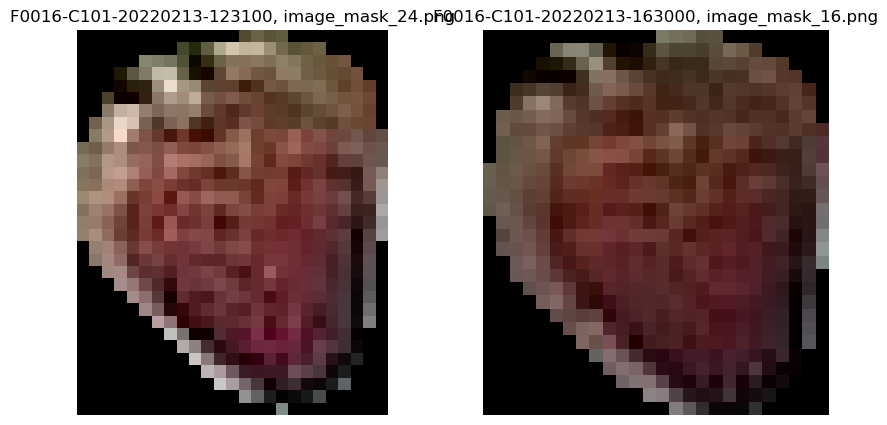

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_16
mask_id                                 4324212bf0c794ff90cd1276ee1d5621
point_x_x                                                      795.62146
point_y_x                                                     473.908264
output_image_path_x                                    image_mask_16.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

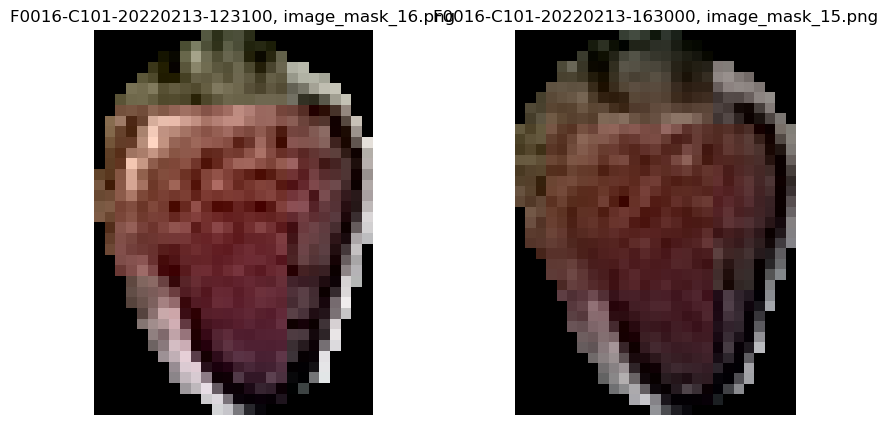

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_7
mask_id                                 4a134221c7eea2438e69bbcd467575db
point_x_x                                                     623.234741
point_y_x                                                      66.408463
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

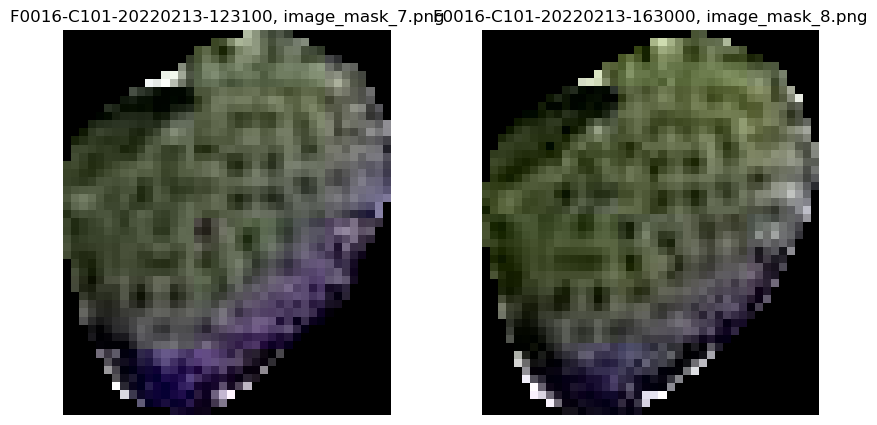

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_43
mask_id                                 4a483e5c3ce019b09af531759f4748fc
point_x_x                                                    1727.163452
point_y_x                                                      55.417305
output_image_path_x                                    image_mask_43.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

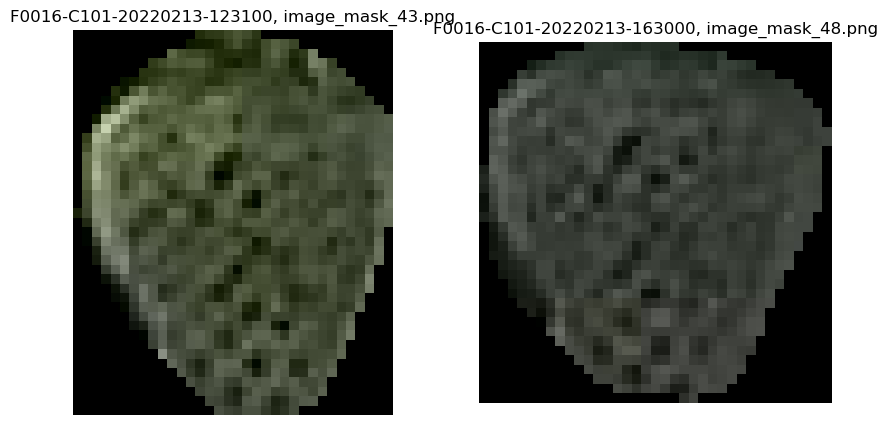

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_4
mask_id                                 50398c67658de31585564db8871709ac
point_x_x                                                     517.746521
point_y_x                                                     197.689972
output_image_path_x                                     image_mask_4.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

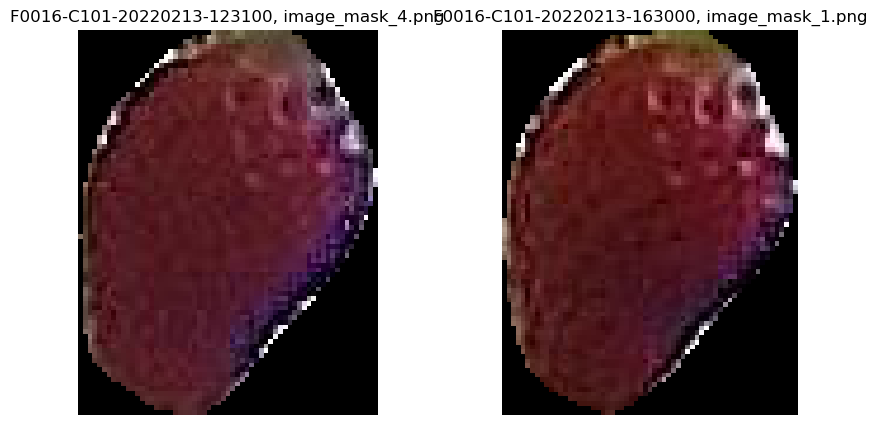

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_25
mask_id                                 51189564b91cc830f88514bc03df2f2c
point_x_x                                                     954.196106
point_y_x                                                     577.582642
output_image_path_x                                    image_mask_25.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

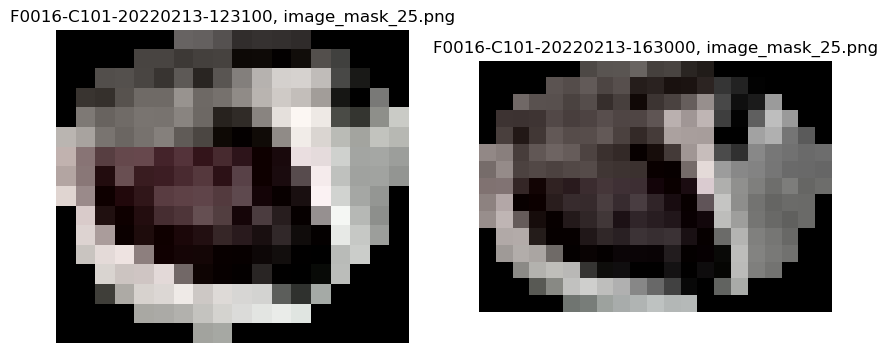

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_2
mask_id                                 57b6be28b2a15dc323ae2fdeac740075
point_x_x                                                     625.318359
point_y_x                                                      578.09314
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

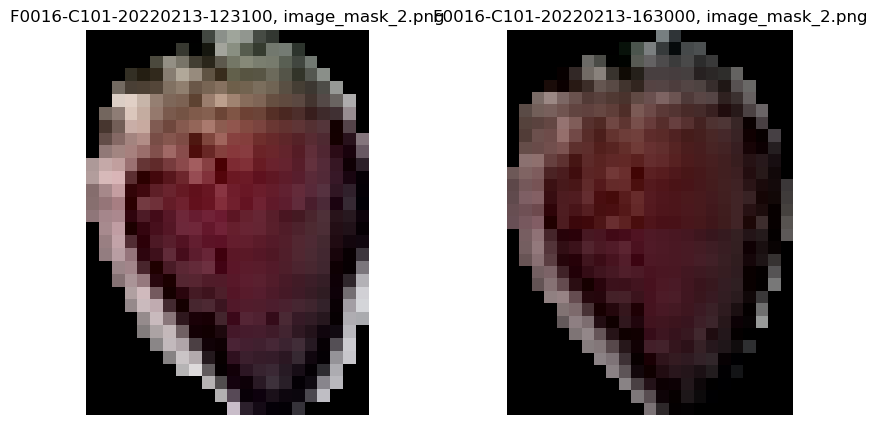

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_6
mask_id                                 5e64f8a5e6c9c7c5fa3e1b66ad103595
point_x_x                                                     621.233521
point_y_x                                                     529.951416
output_image_path_x                                     image_mask_6.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

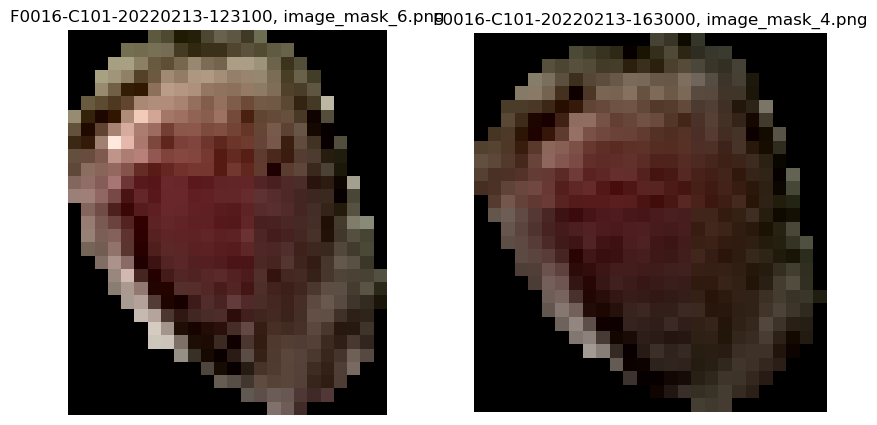

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_28
mask_id                                 63895e5ff4b3015a062ca8e551a2008d
point_x_x                                                    1148.431885
point_y_x                                                     315.989746
output_image_path_x                                    image_mask_28.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

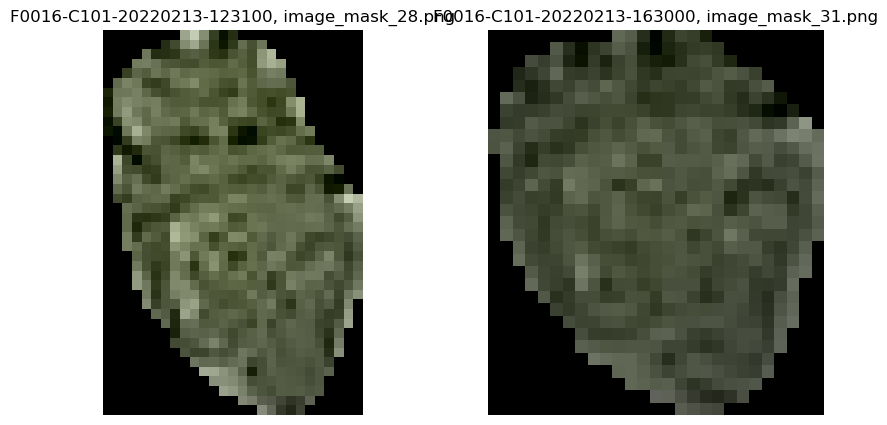

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_28
mask_id                                 63895e5ff4b3015a062ca8e551a2008d
point_x_x                                                    1148.431885
point_y_x                                                     315.989746
output_image_path_x                                    image_mask_28.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

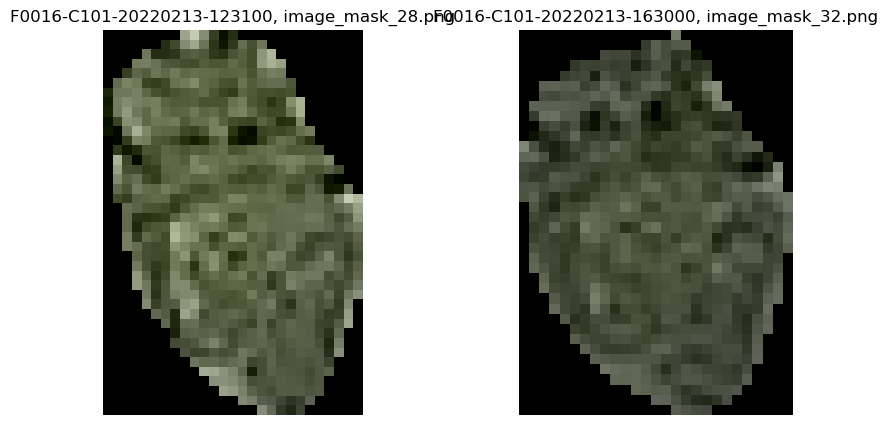

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_45
mask_id                                 6c0f515ff4df1b54b6364512c542baff
point_x_x                                                    1898.543213
point_y_x                                                      75.857681
output_image_path_x                                    image_mask_45.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

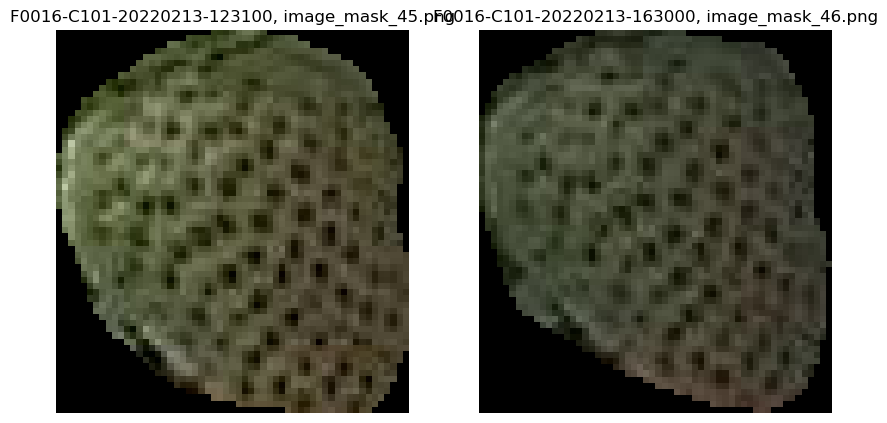

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_20
mask_id                                 72b2f6651cdf576903b5cd64de66eaee
point_x_x                                                     982.413086
point_y_x                                                     440.766357
output_image_path_x                                    image_mask_20.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

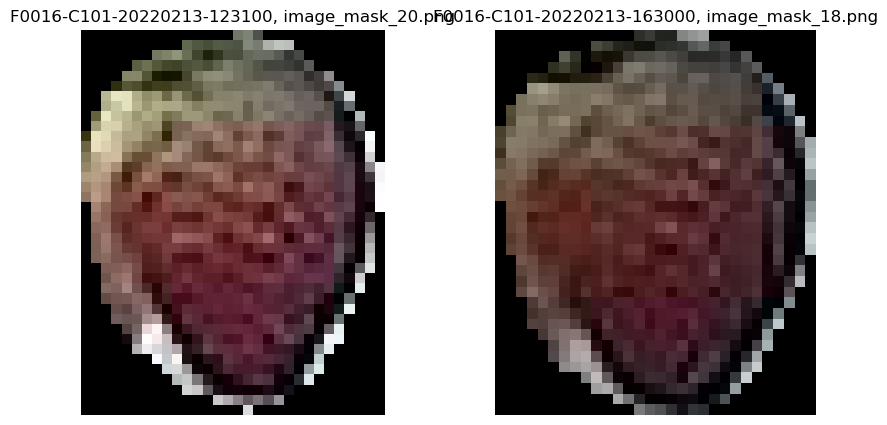

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_5
mask_id                                 7892d6953c0eafb2d977af6b366423ac
point_x_x                                                     543.858521
point_y_x                                                      81.999664
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

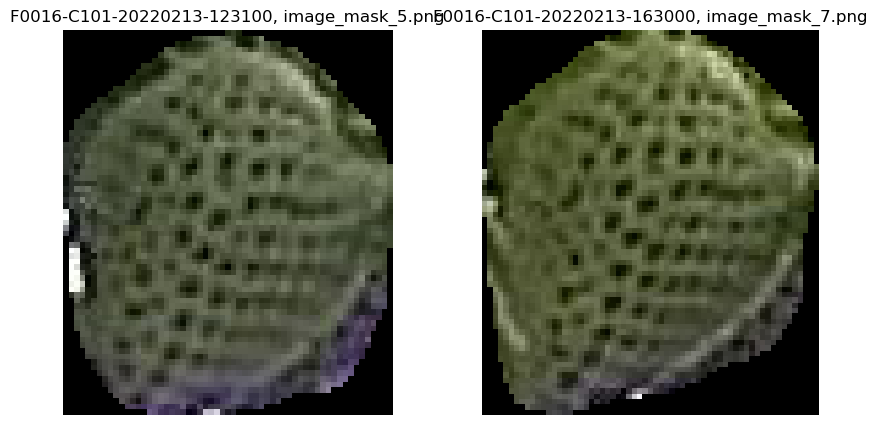

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_54
mask_id                                 791d494227b0f1d7b2dda892017585cd
point_x_x                                                    1861.224365
point_y_x                                                      74.827858
output_image_path_x                                    image_mask_54.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

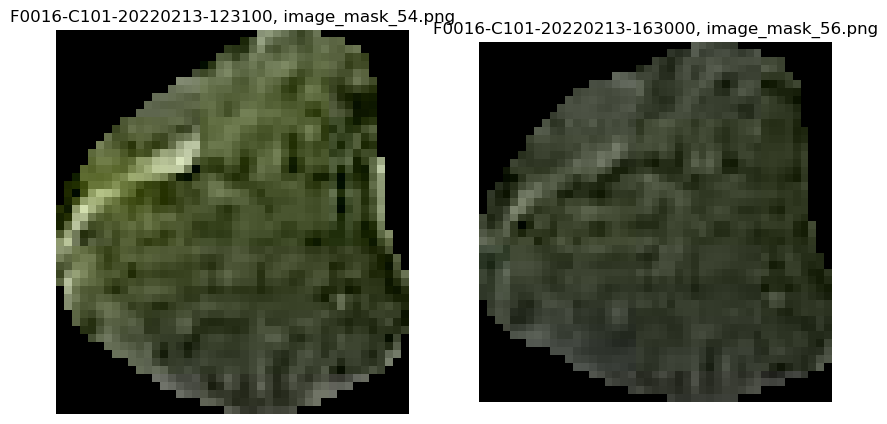

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_67
mask_id                                 7a775eff0e2ff602da1713ccfef4f67e
point_x_x                                                    2070.019531
point_y_x                                                      41.014019
output_image_path_x                                    image_mask_67.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

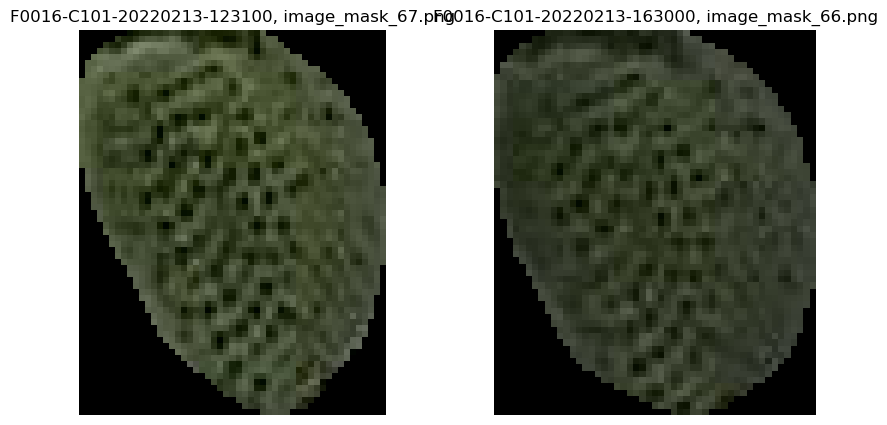

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_65
mask_id                                 7d78902ab2ef05dfe489937a97aa69c5
point_x_x                                                    2308.498535
point_y_x                                                     392.717407
output_image_path_x                                    image_mask_65.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

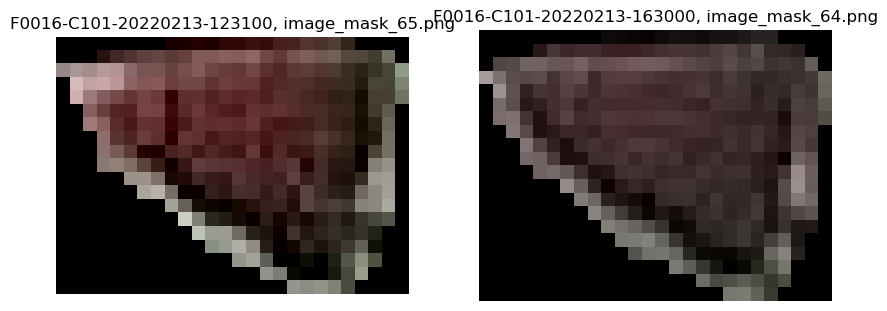

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_60
mask_id                                 7f7e34c1ece92fff3bd7ff13d0ec42db
point_x_x                                                    1953.606934
point_y_x                                                      167.92392
output_image_path_x                                    image_mask_60.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

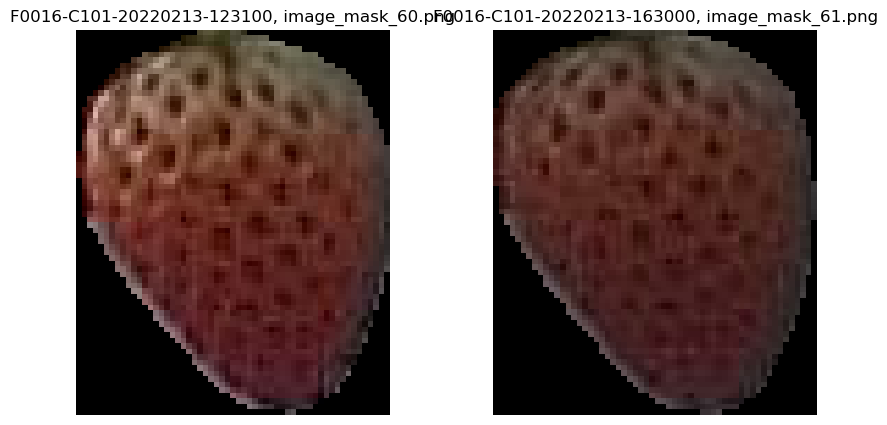

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_21
mask_id                                 7f89d470fd4679c1aa9a84654e96d388
point_x_x                                                     718.288147
point_y_x                                                     502.686157
output_image_path_x                                    image_mask_21.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

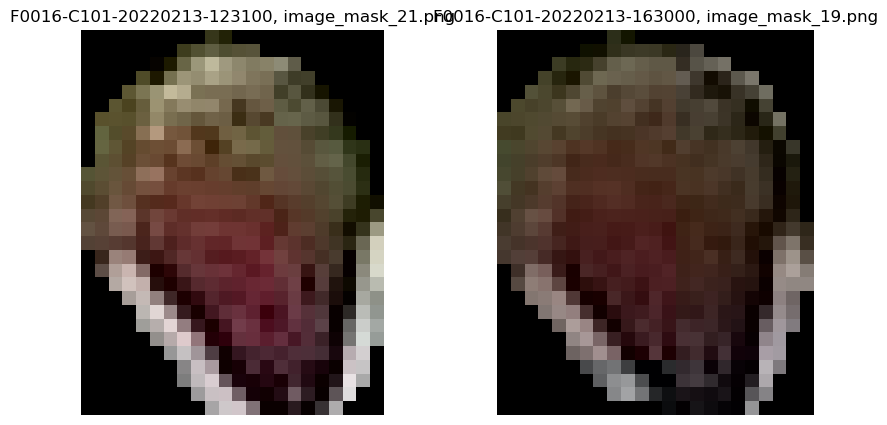

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_33
mask_id                                 96afe30f9f21b30917c1fc45a094d515
point_x_x                                                     922.841309
point_y_x                                                     586.761658
output_image_path_x                                    image_mask_33.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

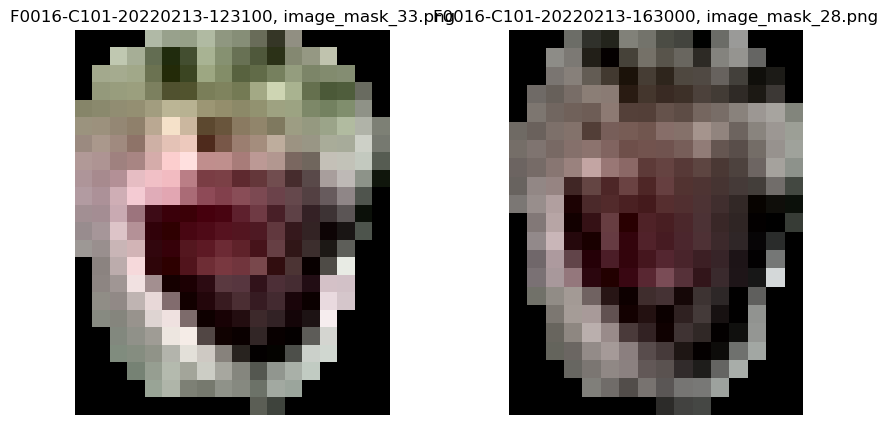

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_32
mask_id                                 9b65c7643f0812b92a690cb66b63c173
point_x_x                                                    1171.091187
point_y_x                                                     302.639221
output_image_path_x                                    image_mask_32.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

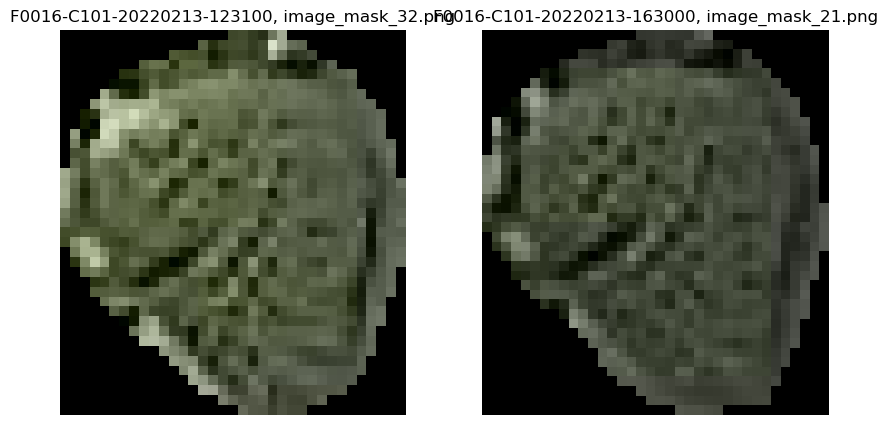

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_61
mask_id                                 9df4a1f7158196de71d9dd679640e9fe
point_x_x                                                    2346.083252
point_y_x                                                     398.009705
output_image_path_x                                    image_mask_61.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

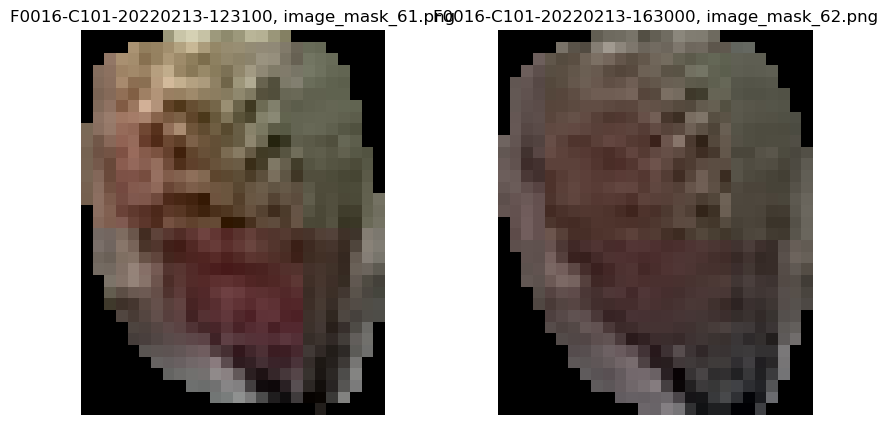

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_19
mask_id                                 9f2da9630ed75d8201f65a1b9f595bd1
point_x_x                                                    1155.710449
point_y_x                                                      553.19397
output_image_path_x                                    image_mask_19.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

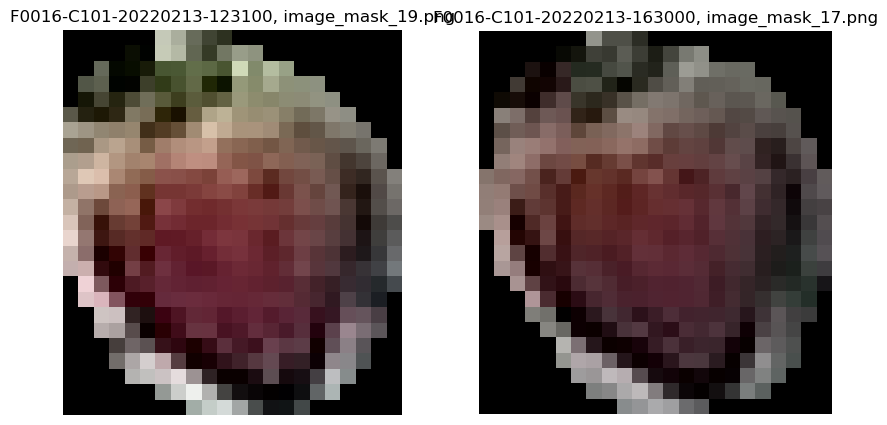

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_46
mask_id                                 9fd15f9f7f4163ceb240783c05d566eb
point_x_x                                                    1822.664551
point_y_x                                                     169.075836
output_image_path_x                                    image_mask_46.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

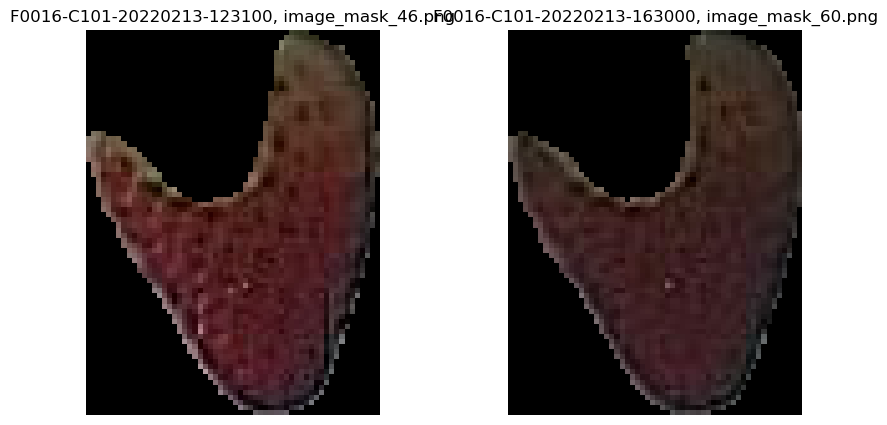

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_3
mask_id                                 a0be4c324fea847382e5eb418c941d2a
point_x_x                                                     601.782227
point_y_x                                                     580.521912
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

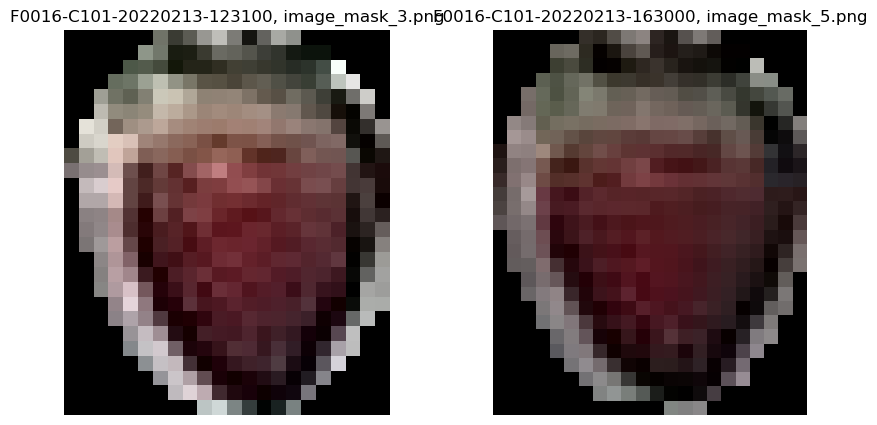

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_42
mask_id                                 a2844b868e00882a26d5699094abe290
point_x_x                                                    1424.169678
point_y_x                                                      523.46814
output_image_path_x                                    image_mask_42.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

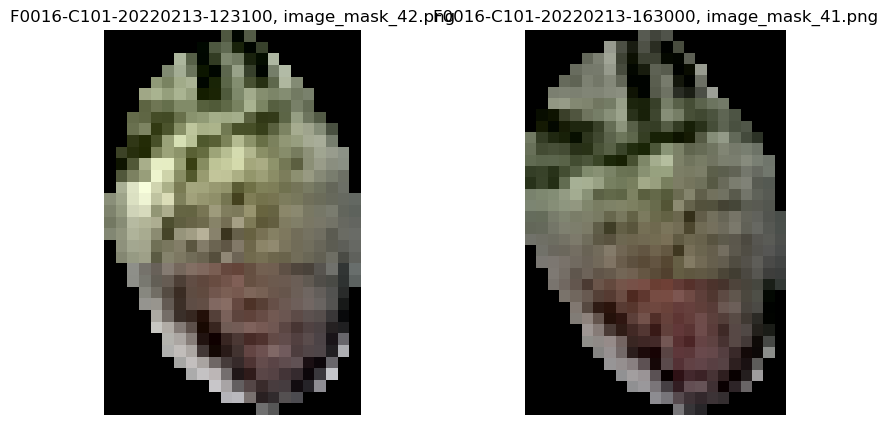

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_62
mask_id                                 a93419f5079b7a10c49bdbefa7212931
point_x_x                                                    2325.410645
point_y_x                                                     418.412415
output_image_path_x                                    image_mask_62.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

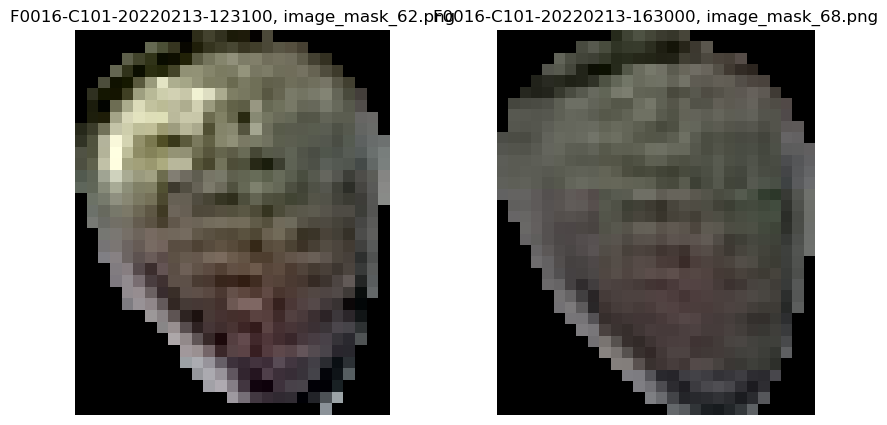

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_62
mask_id                                 a93419f5079b7a10c49bdbefa7212931
point_x_x                                                    2325.410645
point_y_x                                                     418.412415
output_image_path_x                                    image_mask_62.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

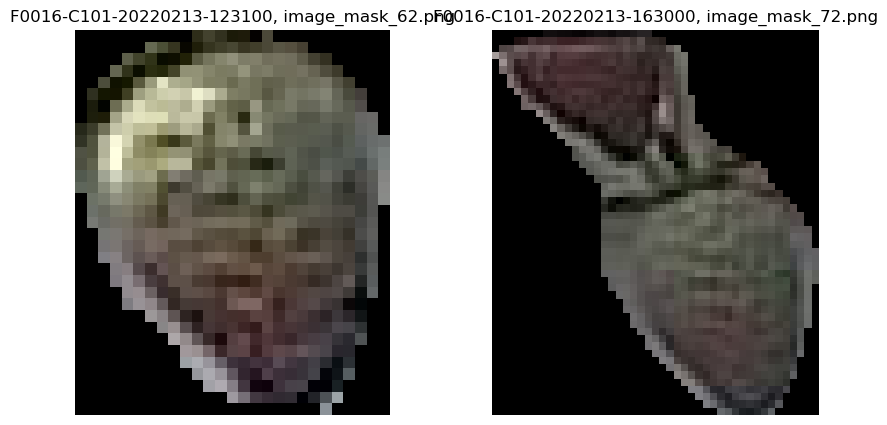

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_44
mask_id                                 aaa2868790859f91e402eb6ade7e91e1
point_x_x                                                    1324.115112
point_y_x                                                     550.476929
output_image_path_x                                    image_mask_44.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

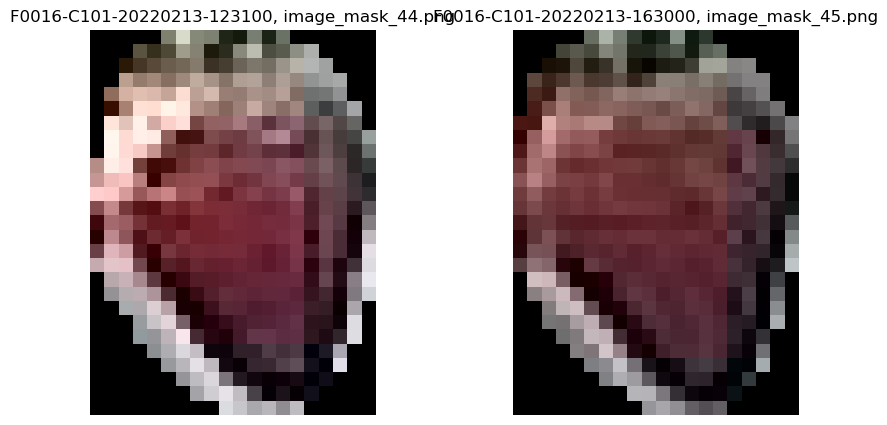

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_63
mask_id                                 aeeefcebaeba820a3be73cfbf76e99af
point_x_x                                                    2378.879395
point_y_x                                                     408.833374
output_image_path_x                                    image_mask_63.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

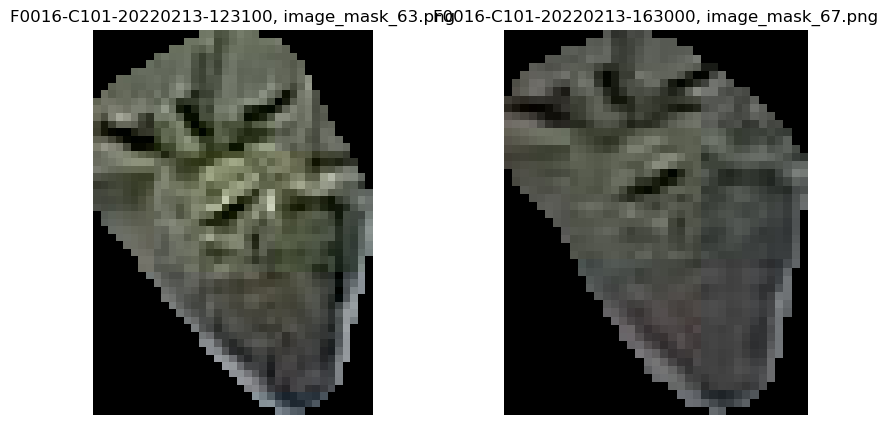

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_64
mask_id                                 b199d24b72e737cfb461dafab0e4fb81
point_x_x                                                    1991.425903
point_y_x                                                     103.620766
output_image_path_x                                    image_mask_64.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

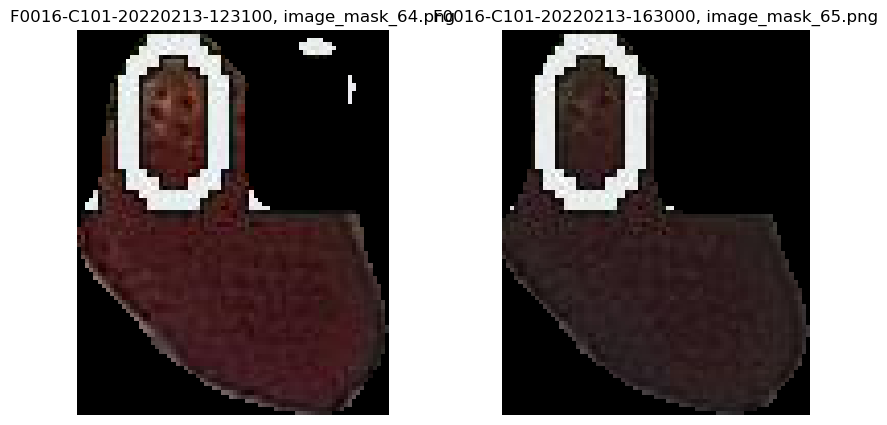

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_51
mask_id                                 b954235faf812ca861870073c87288d1
point_x_x                                                    1455.137085
point_y_x                                                     528.406494
output_image_path_x                                    image_mask_51.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

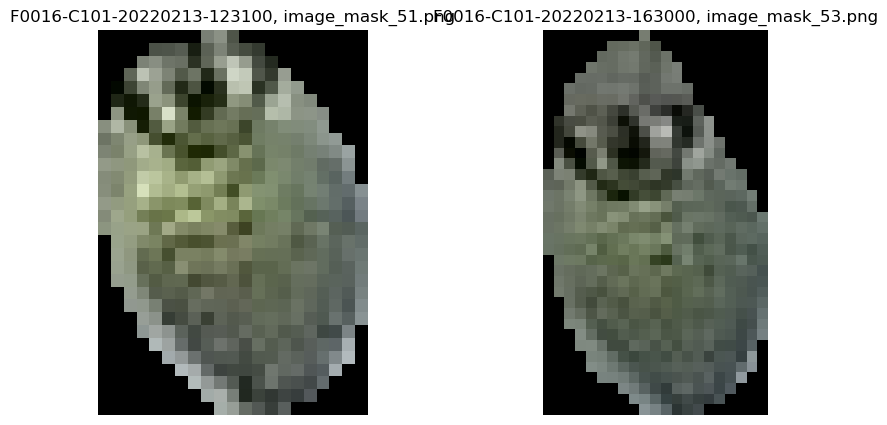

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_51
mask_id                                 b954235faf812ca861870073c87288d1
point_x_x                                                    1455.137085
point_y_x                                                     528.406494
output_image_path_x                                    image_mask_51.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

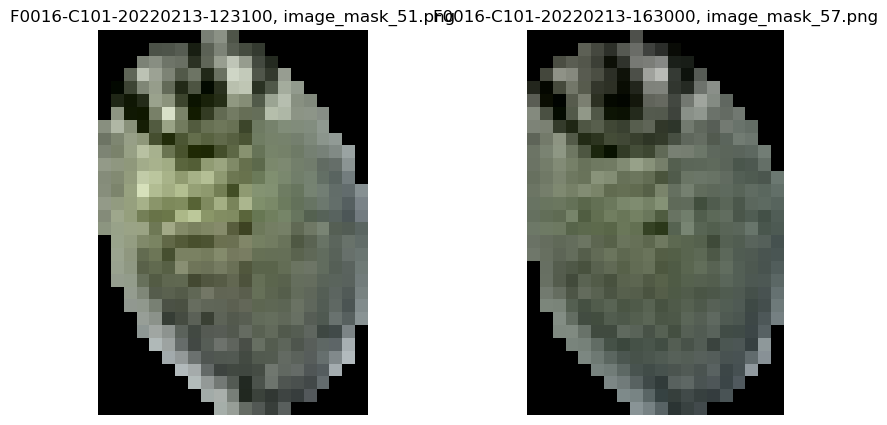

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_53
mask_id                                 bcb7dae75d18f8e6228027f4afa714e5
point_x_x                                                    1649.880737
point_y_x                                                     135.377319
output_image_path_x                                    image_mask_53.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

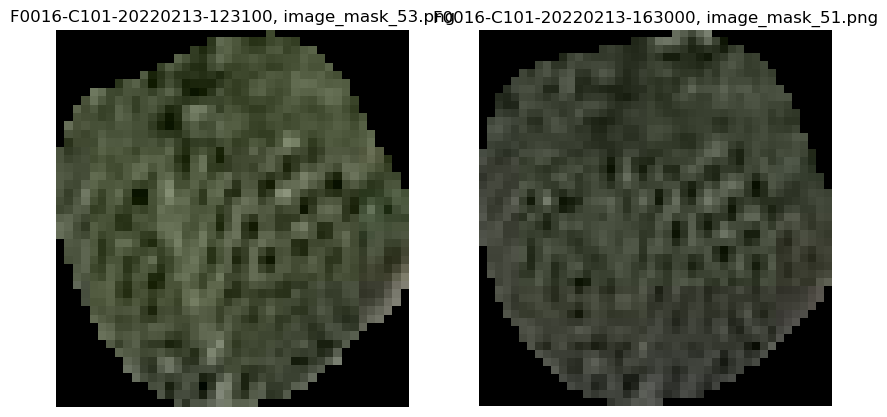

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_35
mask_id                                 bec8273482159df8969aa1267d3d27f6
point_x_x                                                     703.346985
point_y_x                                                     496.652588
output_image_path_x                                    image_mask_35.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

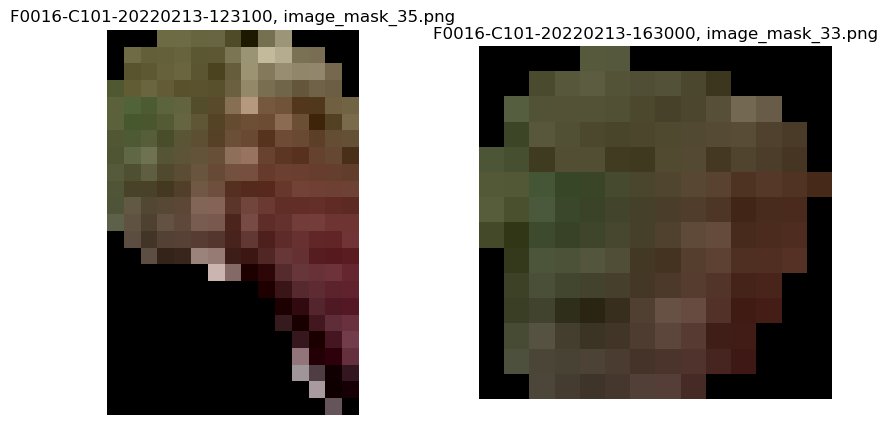

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_27
mask_id                                 c0459b302be9802c0578977d6b168efc
point_x_x                                                    1224.921875
point_y_x                                                     252.808563
output_image_path_x                                    image_mask_27.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

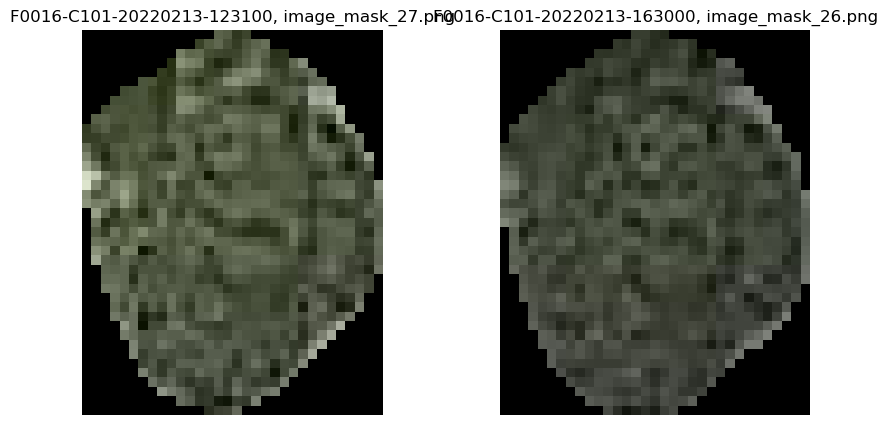

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_48
mask_id                                 c3947f703e79feef8a3dc093f49719fb
point_x_x                                                    1307.264526
point_y_x                                                     544.601685
output_image_path_x                                    image_mask_48.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

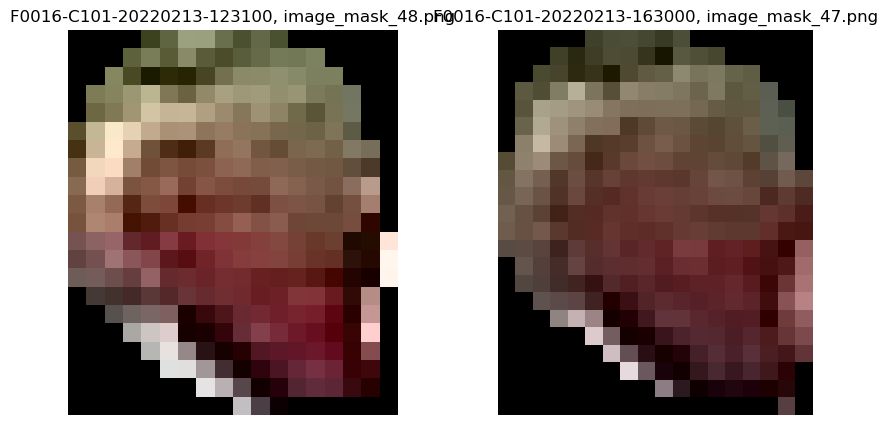

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_50
mask_id                                 c7523a61c1235d029671cf6f7cd603dc
point_x_x                                                    1541.463623
point_y_x                                                     504.781647
output_image_path_x                                    image_mask_50.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

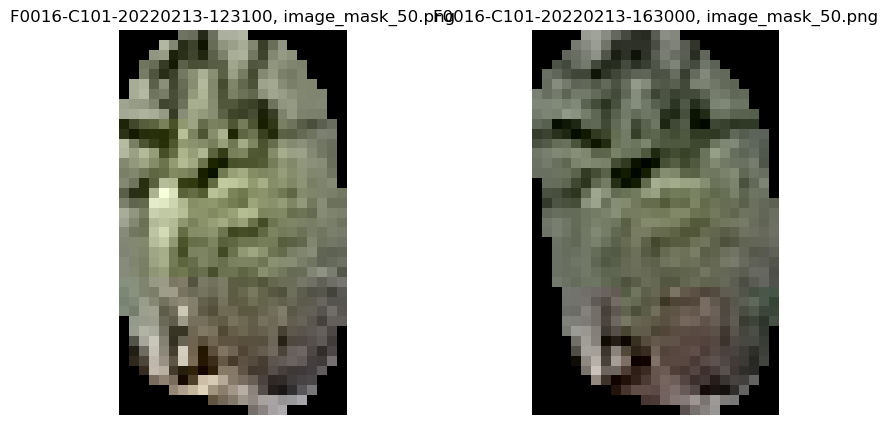

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_31
mask_id                                 c83256c46c57597229270d4aba5e36e1
point_x_x                                                    1037.152588
point_y_x                                                     574.397888
output_image_path_x                                    image_mask_31.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

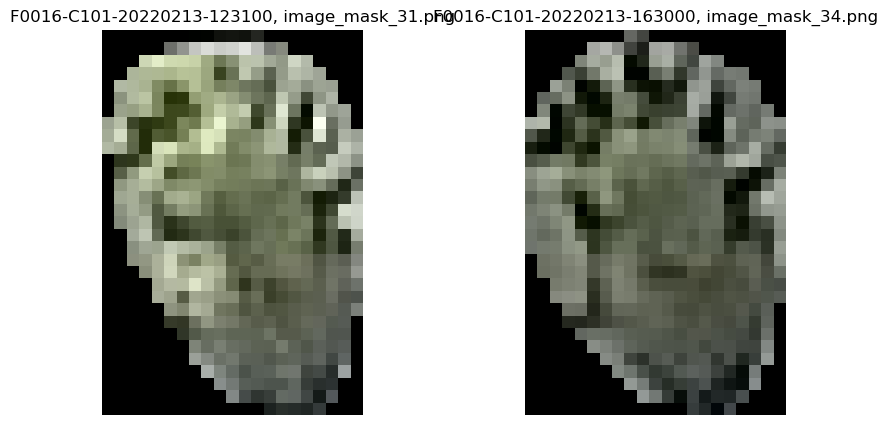

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_59
mask_id                                 c83b5ac7613f9a84b81e1f2cc3a6301c
point_x_x                                                    1974.366333
point_y_x                                                     440.888672
output_image_path_x                                    image_mask_59.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

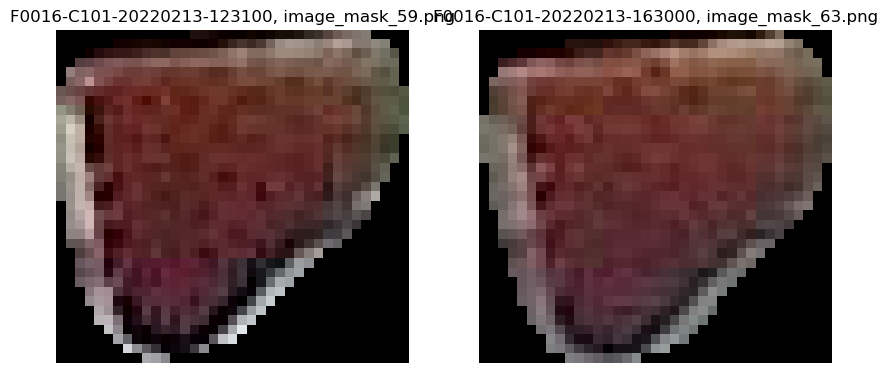

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_41
mask_id                                 ccf400a6a135984615b41b5cc72a724b
point_x_x                                                     1833.05957
point_y_x                                                     461.666382
output_image_path_x                                    image_mask_41.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

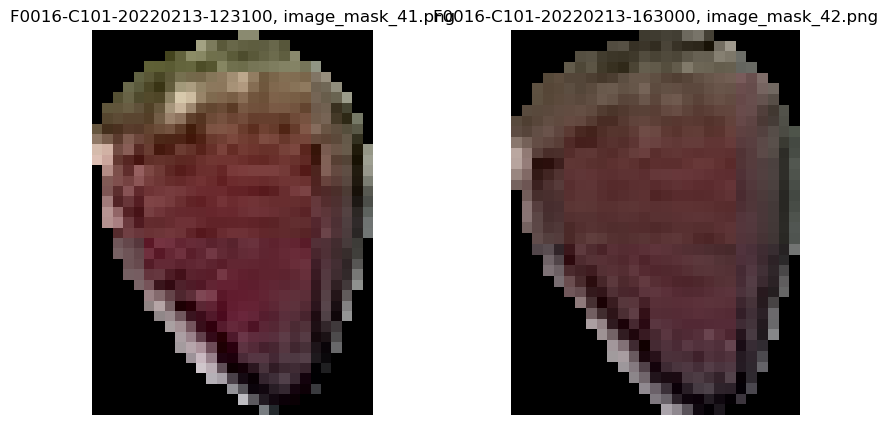

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_36
mask_id                                 d752e48adef773146987bfe1c3527fa0
point_x_x                                                    1582.638062
point_y_x                                                     185.965271
output_image_path_x                                    image_mask_36.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

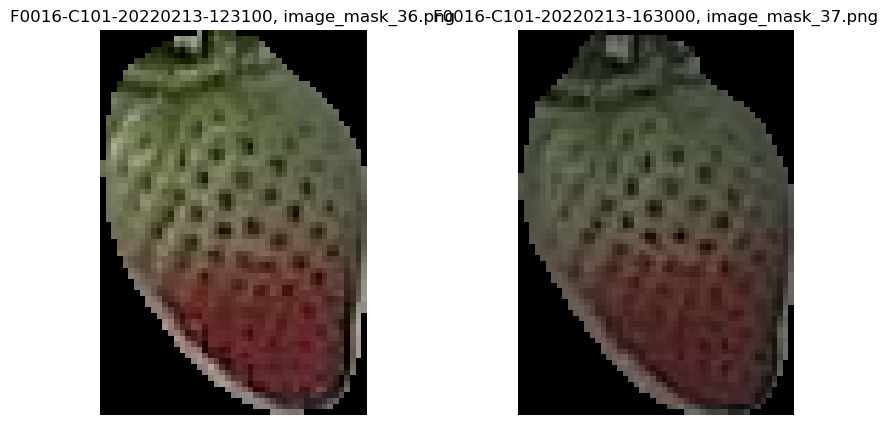

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_66
mask_id                                 e0f96d917577ddf4df52cc4b4aff3bae
point_x_x                                                    1924.652832
point_y_x                                                     449.581421
output_image_path_x                                    image_mask_66.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

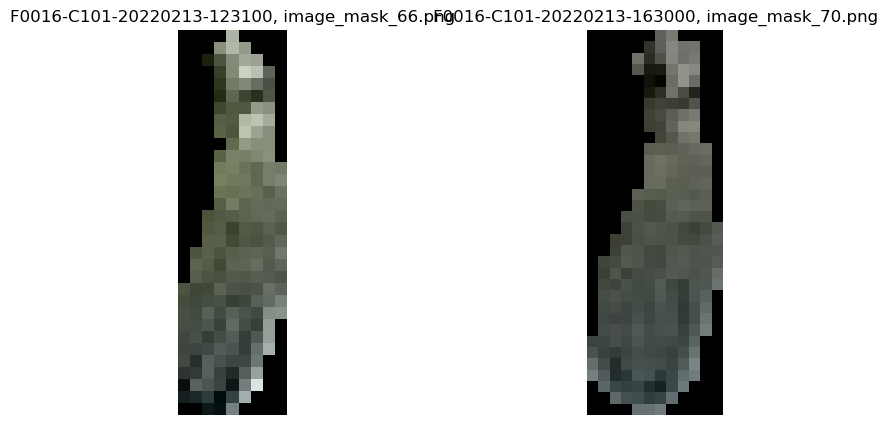

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_8
mask_id                                 e8ce74b1770ee0485bb23f9d2fc5b652
point_x_x                                                     590.444458
point_y_x                                                      76.163811
output_image_path_x                                     image_mask_8.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

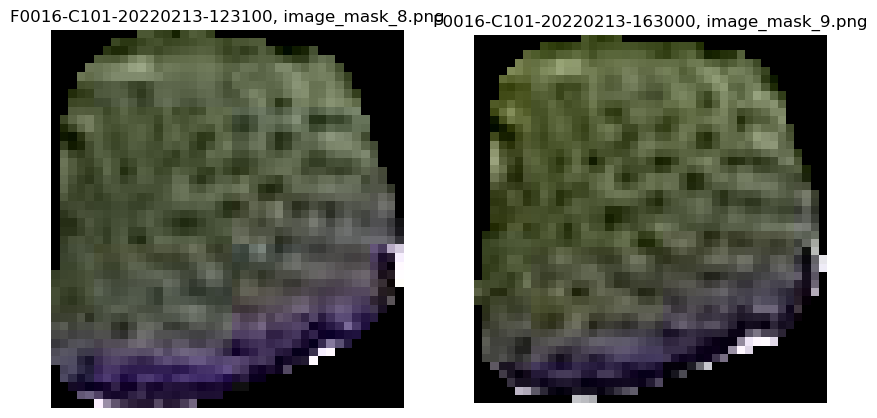

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_23
mask_id                                 ebbed5c86107c5bf275d0d5cc6391b20
point_x_x                                                     961.437317
point_y_x                                                     436.994263
output_image_path_x                                    image_mask_23.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

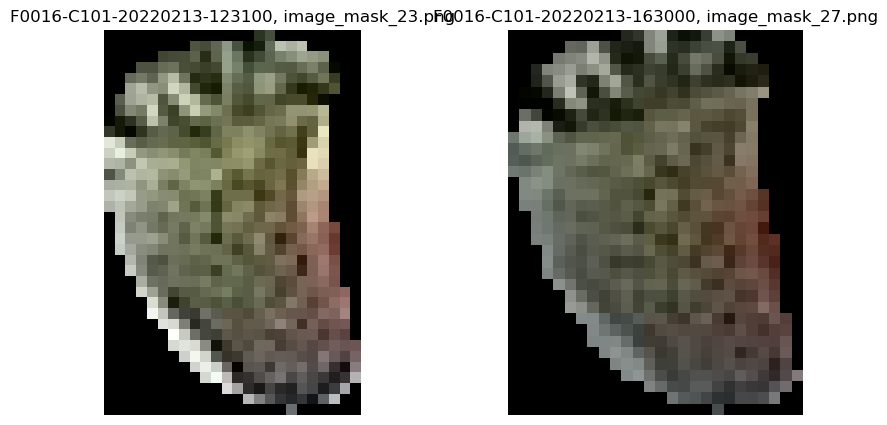

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_22
mask_id                                 ed85bddee852dcae30715baa1e32d0ff
point_x_x                                                     738.382812
point_y_x                                                     501.832184
output_image_path_x                                    image_mask_22.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

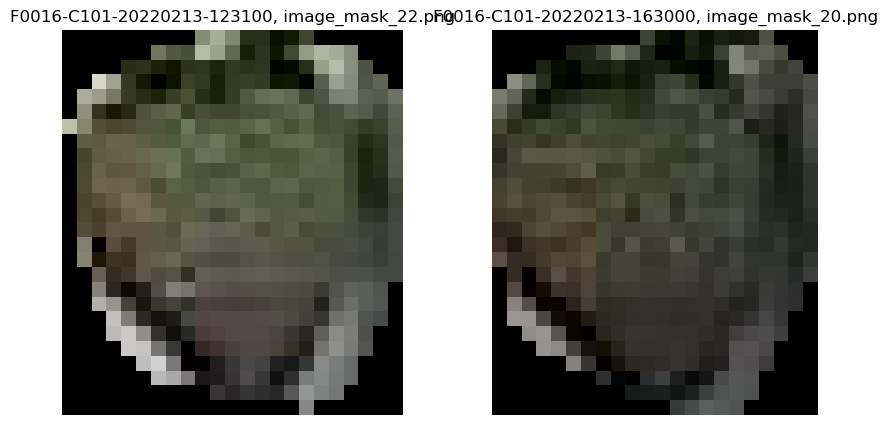

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_39
mask_id                                 f232d6dbcdf460dc945cca06d030e52a
point_x_x                                                    1534.602539
point_y_x                                                     532.968384
output_image_path_x                                    image_mask_39.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

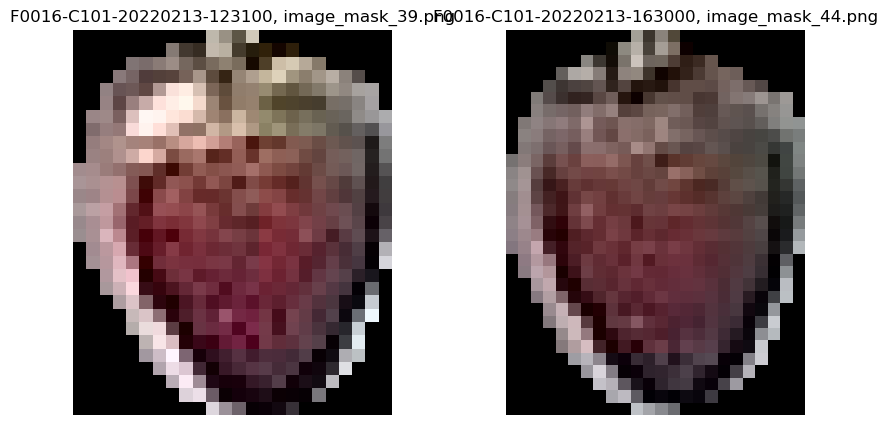

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                  F0016-C101-20220213-123100_9
mask_id                                 f597e9f9848f415fc68aa41ef5d4f27e
point_x_x                                                     344.175873
point_y_x                                                      284.18042
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

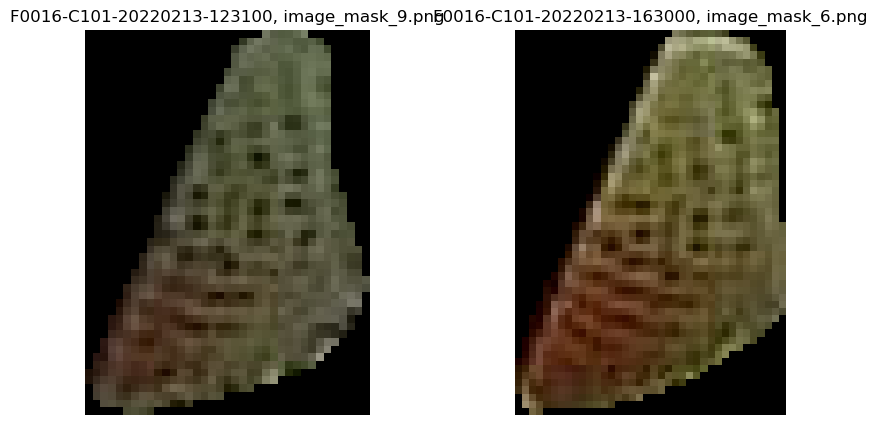

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220213-123100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220213-084500
mask_num_x                                 F0016-C101-20220213-123100_47
mask_id                                 f7e54b26fd84e2b8e0ed3e23f062c4fe
point_x_x                                                    1559.416016
point_y_x                                                     131.445221
output_image_path_x                                    image_mask_47.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220213-163000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

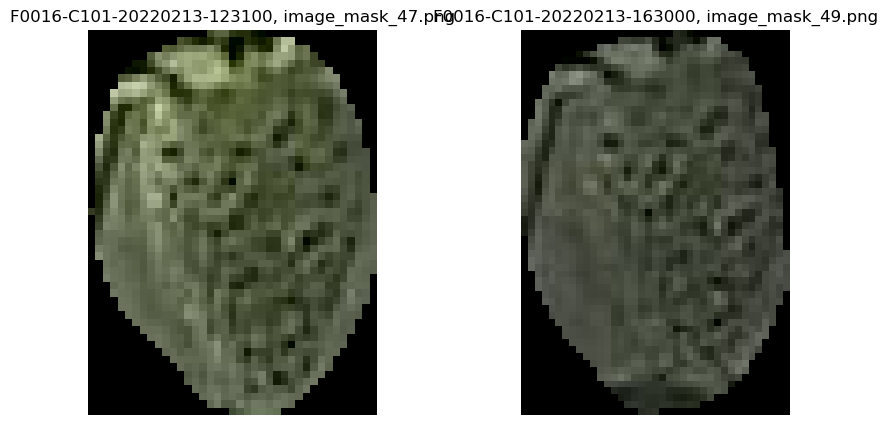

In [22]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_63
mask_id                                 03311a5c92cdcd7f791a5d21776ae93d
point_x_x                                                    2044.947021
point_y_x                                                     424.298859
output_image_path_x                                    image_mask_63.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

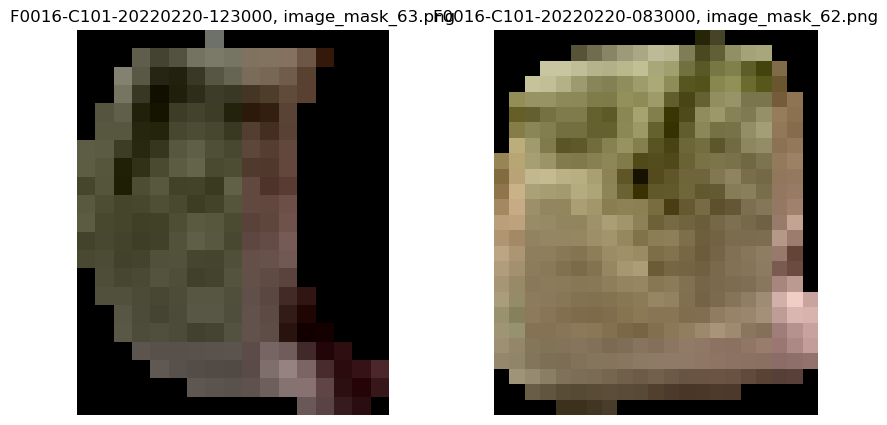

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_20
mask_id                                 16f948556ef563cd64f60aff7ad11b71
point_x_x                                                    1745.758545
point_y_x                                                     466.139252
output_image_path_x                                    image_mask_20.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

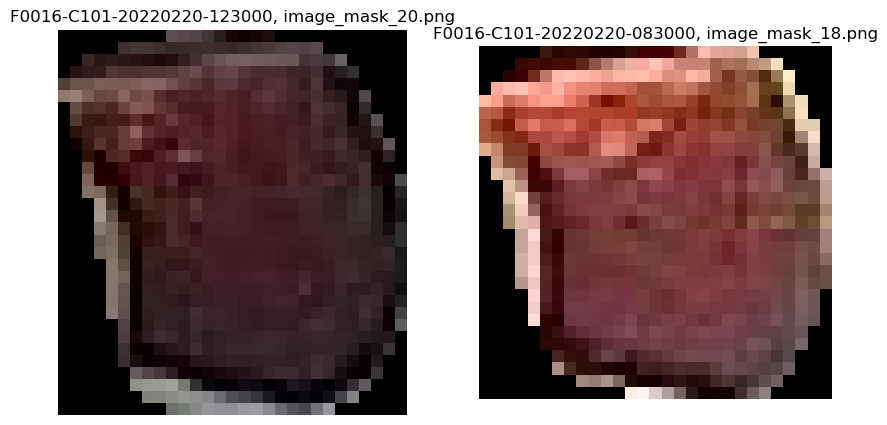

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                  F0016-C101-20220220-123000_6
mask_id                                 22797c3cbbd518f42a87f7dbb9201ded
point_x_x                                                    1156.562744
point_y_x                                                     319.287354
output_image_path_x                                     image_mask_6.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

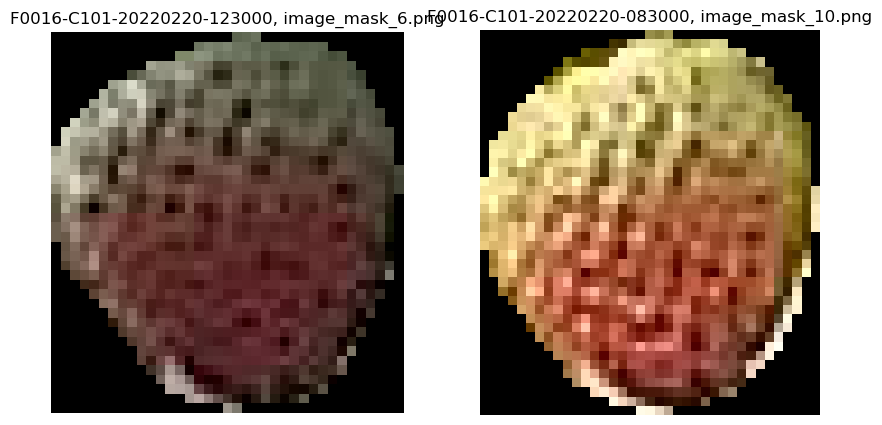

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_31
mask_id                                 2860e2b8810786bce534c3a9424b53bb
point_x_x                                                    1725.417236
point_y_x                                                     472.057007
output_image_path_x                                    image_mask_31.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

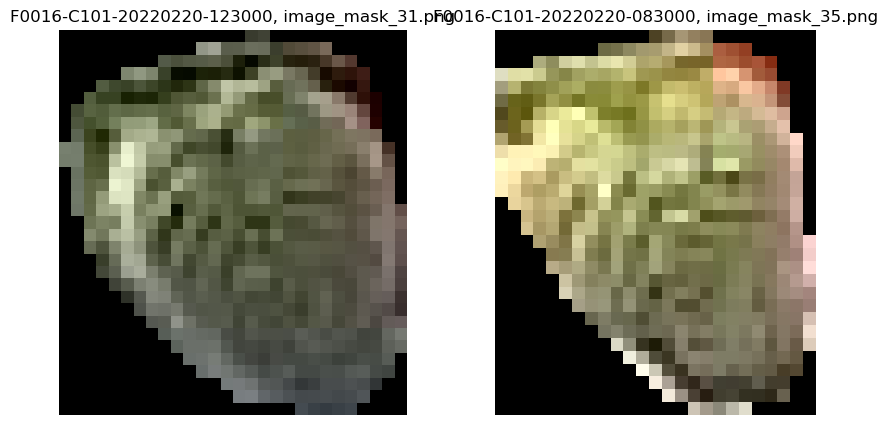

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_21
mask_id                                 2a9de60500f0e0c722c4646baeec5b65
point_x_x                                                    1775.508057
point_y_x                                                      29.339111
output_image_path_x                                    image_mask_21.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

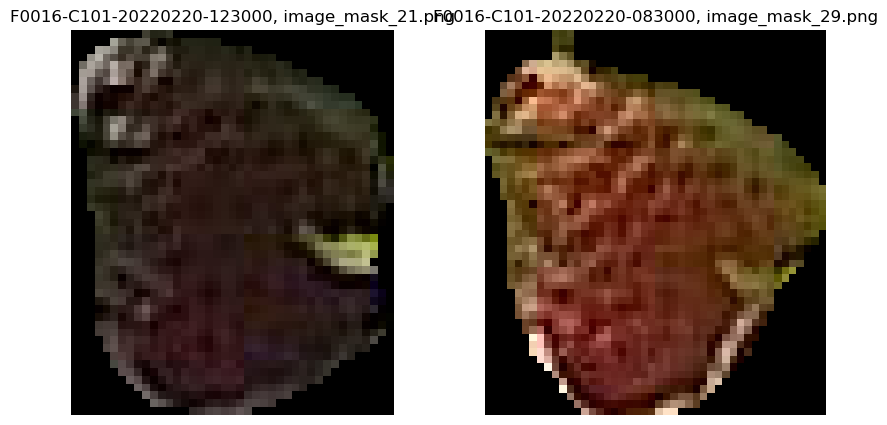

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_15
mask_id                                 30802cf28412a1c79a6b74407f66d3a0
point_x_x                                                    1728.776978
point_y_x                                                     172.668442
output_image_path_x                                    image_mask_15.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

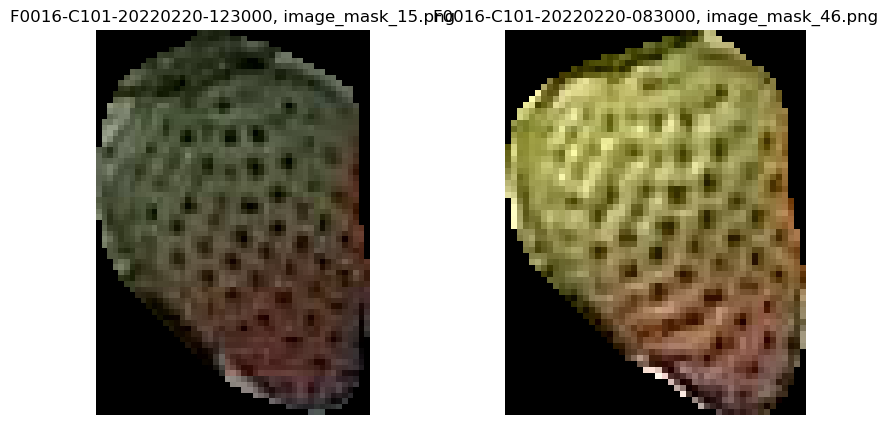

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_28
mask_id                                 367c2aee3c00ae73ab2a2653c018a216
point_x_x                                                    1413.047119
point_y_x                                                     298.486603
output_image_path_x                                    image_mask_28.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

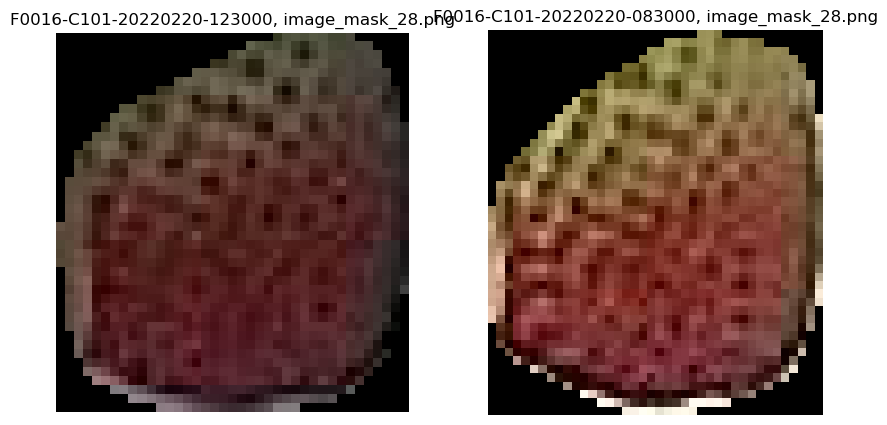

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_61
mask_id                                 38351d46797b8438fb5b5a0cedf26ea8
point_x_x                                                    2002.403809
point_y_x                                                      66.850822
output_image_path_x                                    image_mask_61.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

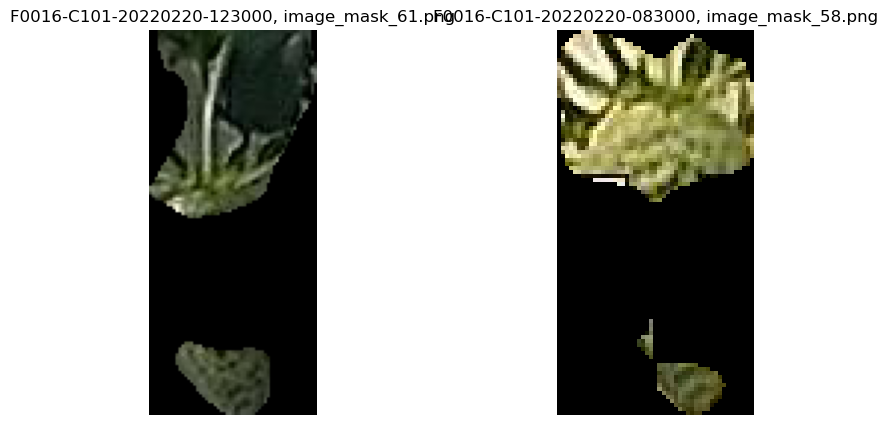

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_65
mask_id                                 3e13eb37ab42aa111180a18790515a79
point_x_x                                                    2453.356445
point_y_x                                                     388.637329
output_image_path_x                                    image_mask_65.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

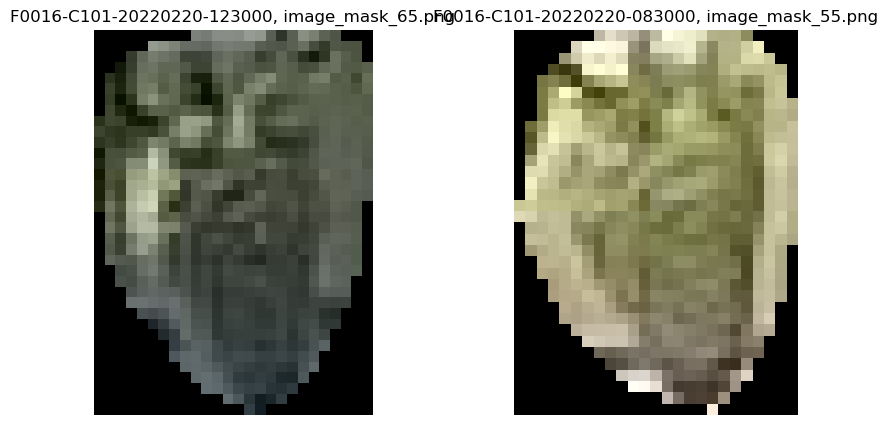

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_51
mask_id                                 45ad57036438c74b032507c0d8bf189e
point_x_x                                                    2019.821533
point_y_x                                                     430.097778
output_image_path_x                                    image_mask_51.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

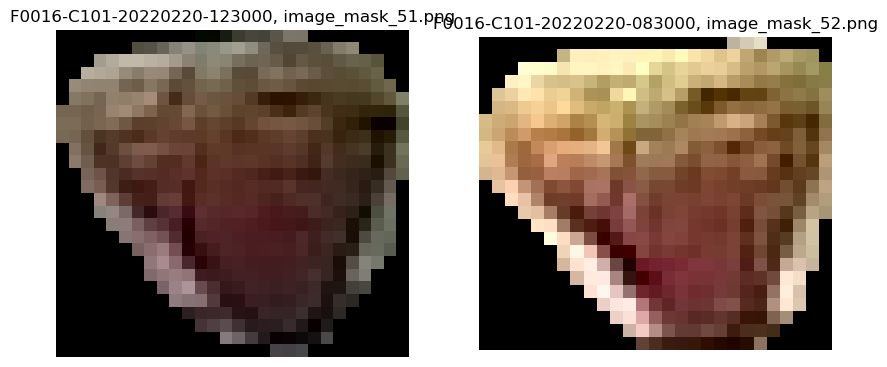

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_48
mask_id                                 4741028c57c0ac30995c2b94299c06e7
point_x_x                                                    1981.708862
point_y_x                                                     449.749634
output_image_path_x                                    image_mask_48.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

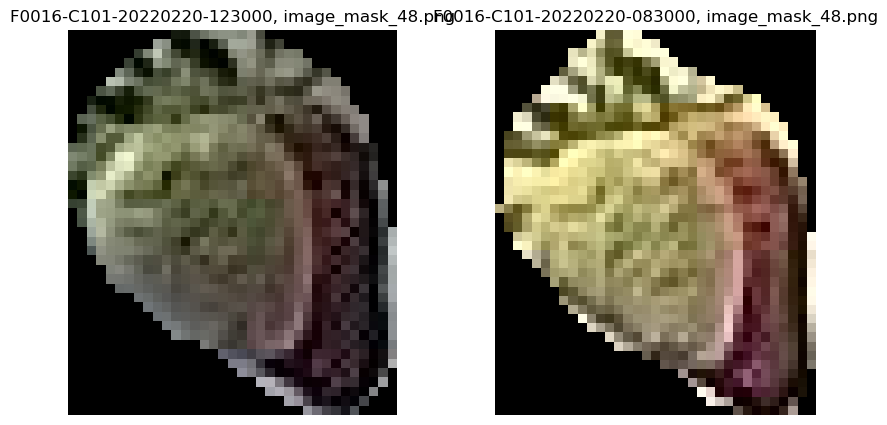

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_42
mask_id                                 489437615ca92afeddffbcd6a21d0c54
point_x_x                                                    1673.029785
point_y_x                                                     182.211121
output_image_path_x                                    image_mask_42.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

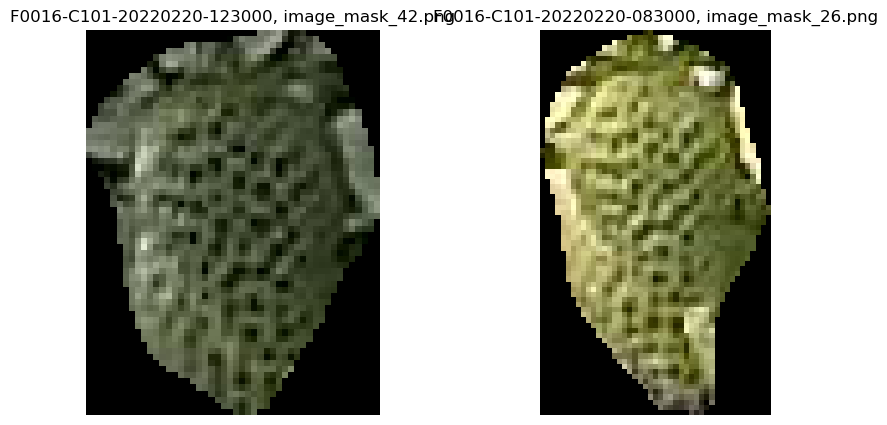

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_50
mask_id                                 4e06c5a157540a05bcdac96725fe36d6
point_x_x                                                    2114.716797
point_y_x                                                     436.362854
output_image_path_x                                    image_mask_50.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

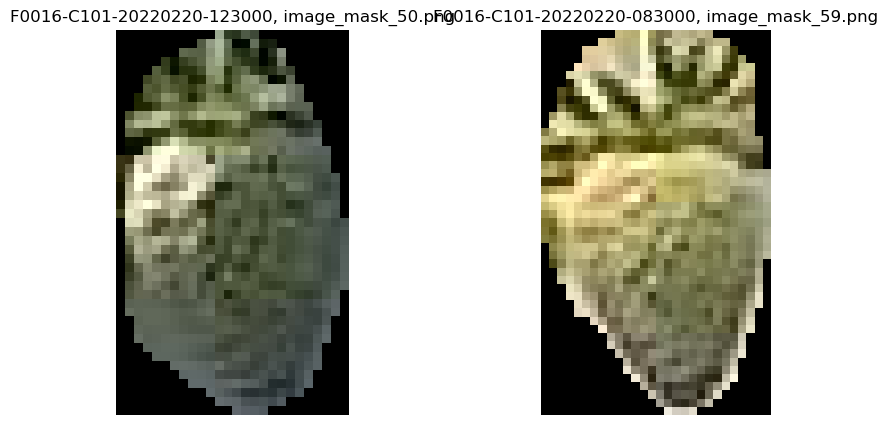

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_13
mask_id                                 4fca93b54f9a132fc325c0f6750848c4
point_x_x                                                    1009.657837
point_y_x                                                     445.372803
output_image_path_x                                    image_mask_13.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

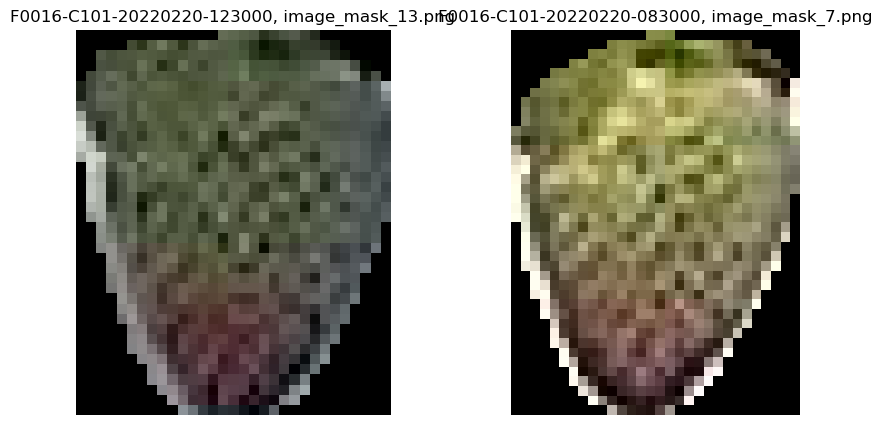

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_34
mask_id                                 60dda1794b389dc392643621fb939691
point_x_x                                                    1380.963867
point_y_x                                                     299.594177
output_image_path_x                                    image_mask_34.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

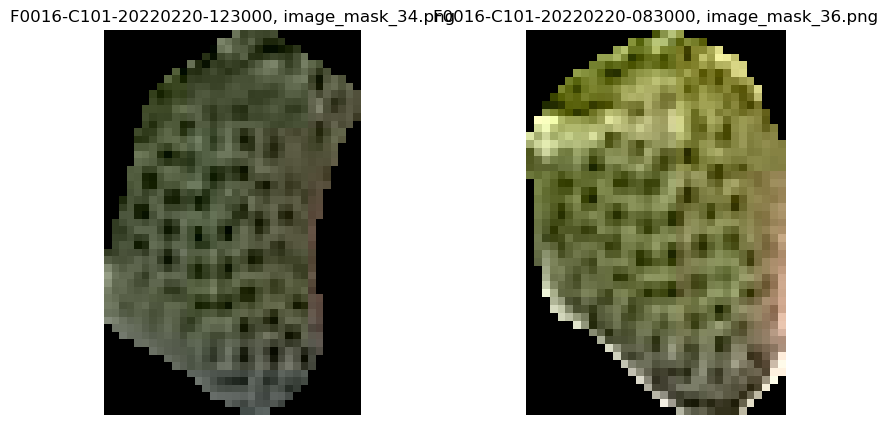

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                  F0016-C101-20220220-123000_1
mask_id                                 626d432a9ce347fae736971bc10669c7
point_x_x                                                     444.885437
point_y_x                                                     134.793823
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

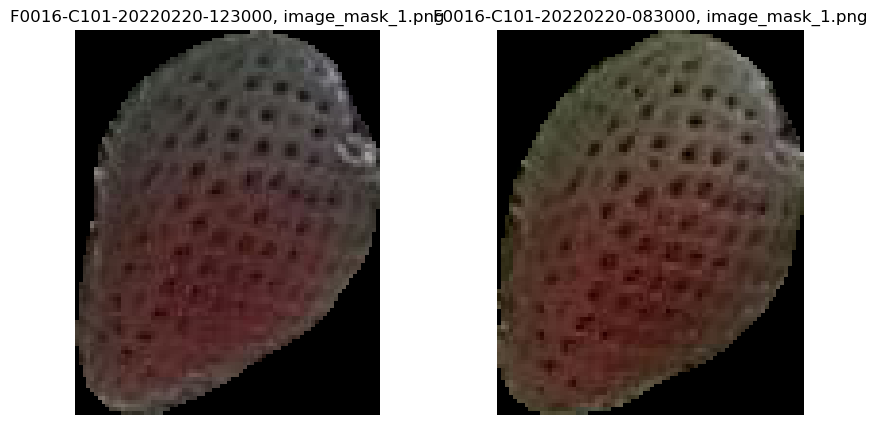

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_43
mask_id                                 628892da6d752452498868377294a8fe
point_x_x                                                    1408.064453
point_y_x                                                     544.096558
output_image_path_x                                    image_mask_43.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

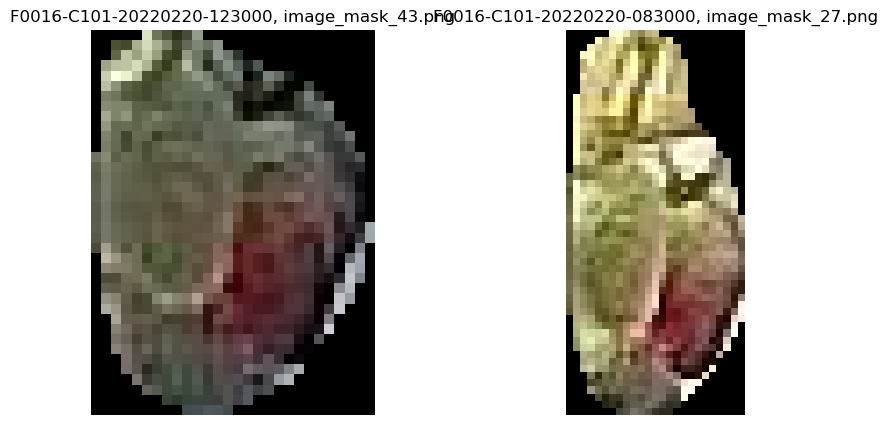

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_43
mask_id                                 628892da6d752452498868377294a8fe
point_x_x                                                    1408.064453
point_y_x                                                     544.096558
output_image_path_x                                    image_mask_43.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

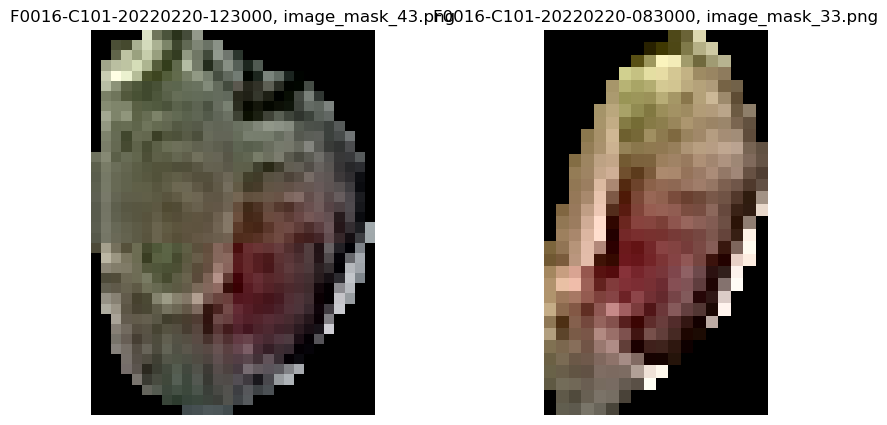

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_14
mask_id                                 72b2f6651cdf576903b5cd64de66eaee
point_x_x                                                     972.225708
point_y_x                                                     444.970947
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

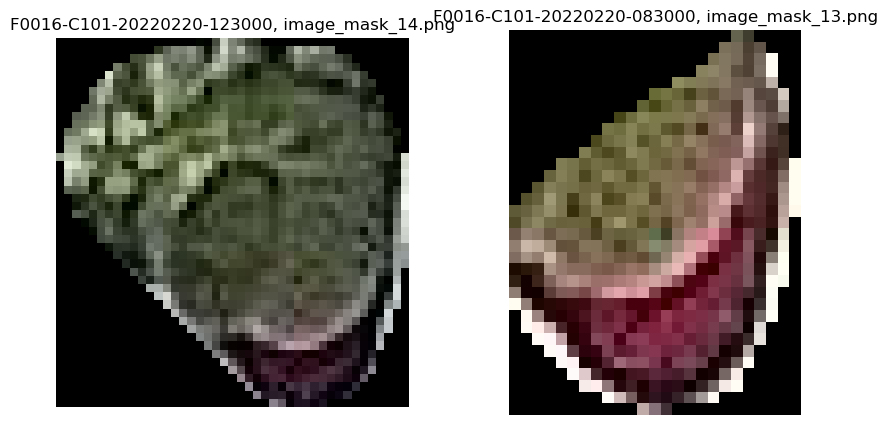

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_55
mask_id                                 797192a7b2cad2fedab485627500ed44
point_x_x                                                    2061.524902
point_y_x                                                     425.239624
output_image_path_x                                    image_mask_55.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

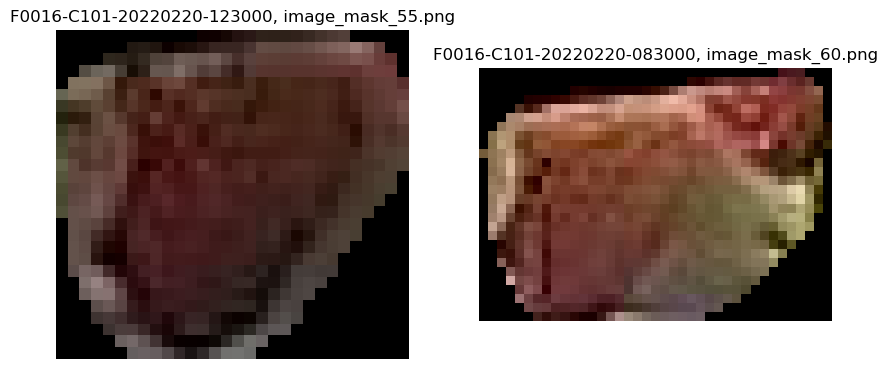

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_53
mask_id                                 7a775eff0e2ff602da1713ccfef4f67e
point_x_x                                                    2087.213379
point_y_x                                                      50.496216
output_image_path_x                                    image_mask_53.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

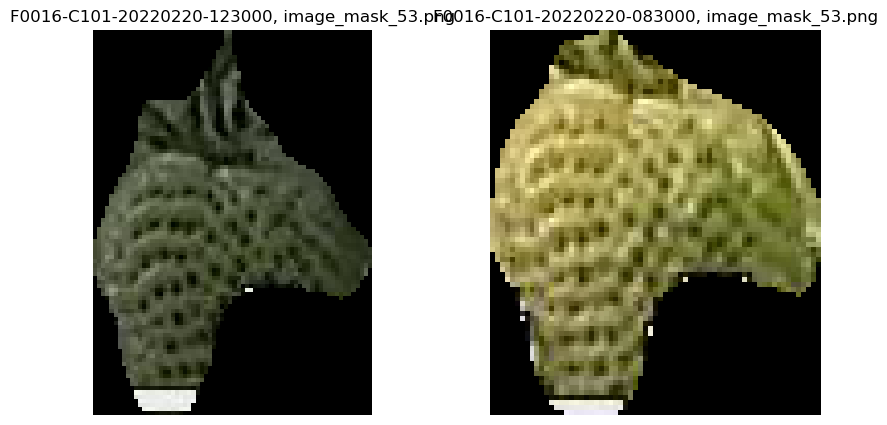

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_36
mask_id                                 7b802f52462d64ff85e3528163b2291e
point_x_x                                                    1703.271606
point_y_x                                                      75.902359
output_image_path_x                                    image_mask_36.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

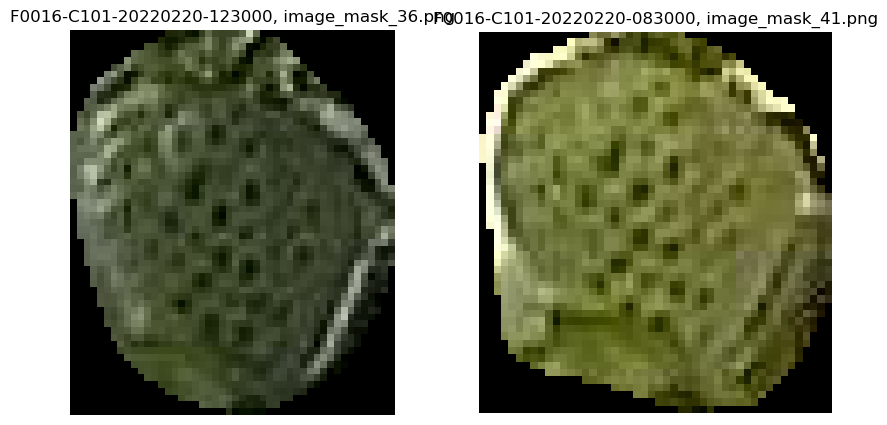

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_52
mask_id                                 7d78902ab2ef05dfe489937a97aa69c5
point_x_x                                                    2315.693359
point_y_x                                                     395.982971
output_image_path_x                                    image_mask_52.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

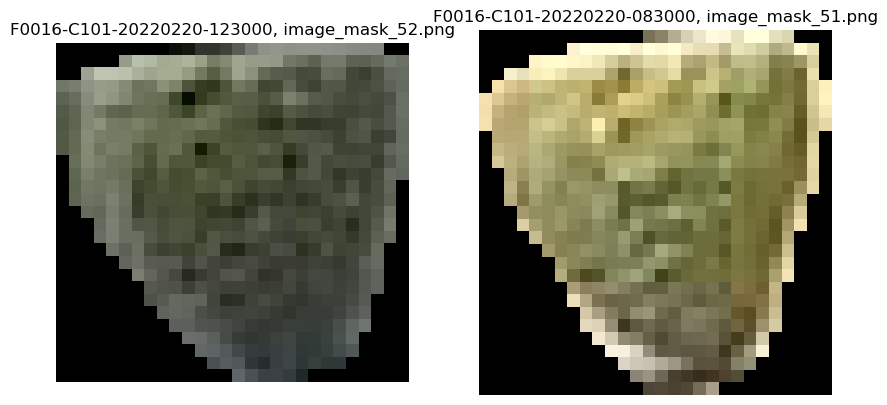

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                  F0016-C101-20220220-123000_3
mask_id                                 808a02f46624e43a3760fba421911ac9
point_x_x                                                     552.370605
point_y_x                                                     125.778198
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

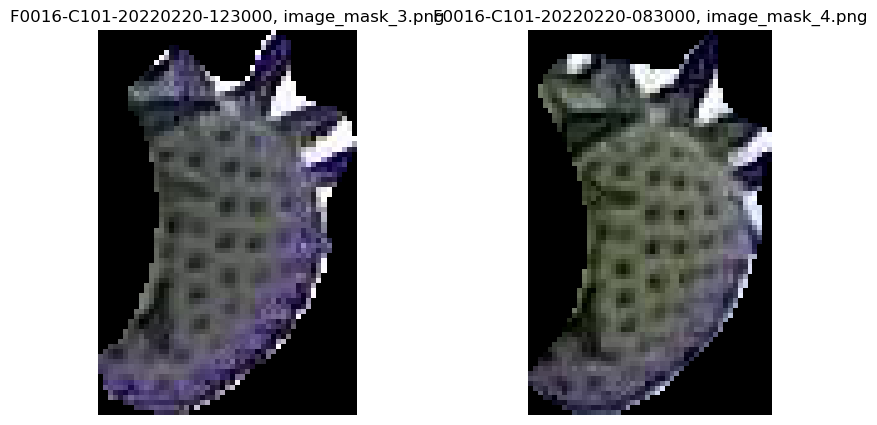

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_57
mask_id                                 811b1c08dbd1f1c54601305a981528bb
point_x_x                                                    2093.686035
point_y_x                                                     438.543671
output_image_path_x                                    image_mask_57.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

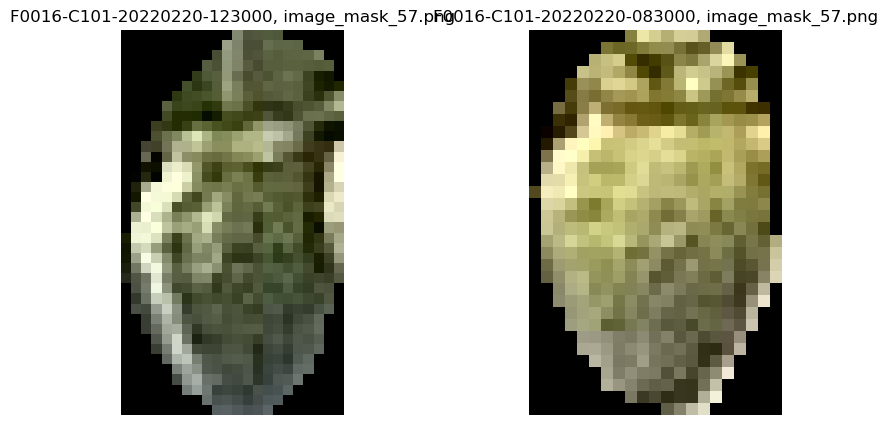

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                  F0016-C101-20220220-123000_8
mask_id                                 88ea481518d107507082f89edcc32049
point_x_x                                                    1255.783813
point_y_x                                                     288.274536
output_image_path_x                                     image_mask_8.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

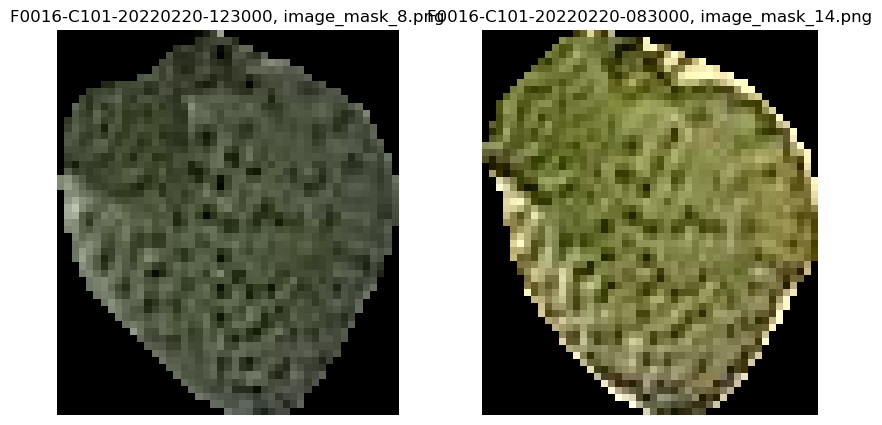

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                  F0016-C101-20220220-123000_5
mask_id                                 8fddd8a3d510461824cbdcd1fd75fc95
point_x_x                                                    1186.070679
point_y_x                                                     350.933655
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

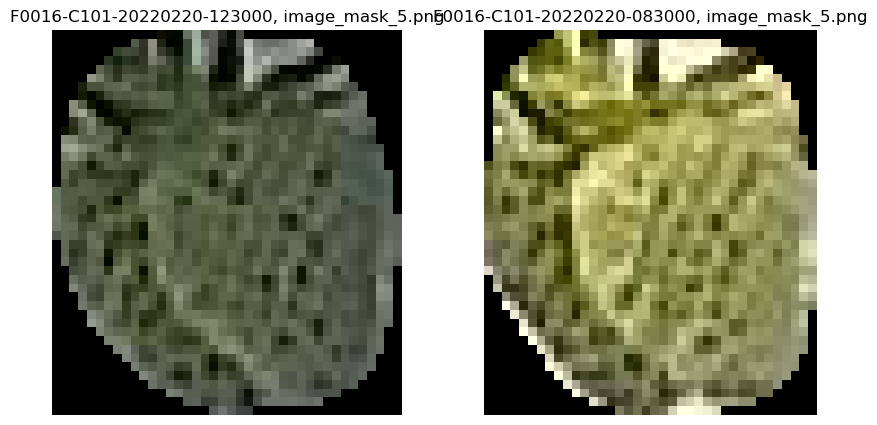

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_19
mask_id                                 9181d56215ac08d4d8e72e18e8f0404d
point_x_x                                                    1814.767456
point_y_x                                                     498.450104
output_image_path_x                                    image_mask_19.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

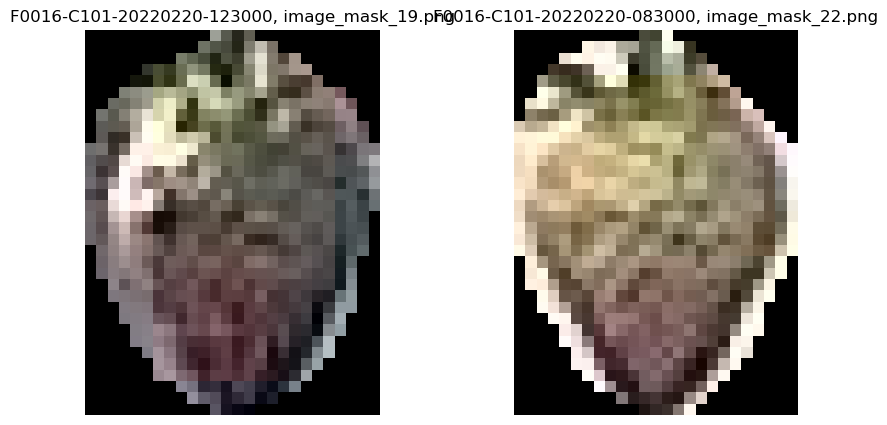

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                  F0016-C101-20220220-123000_9
mask_id                                 9363e20e84518513ffebe442dcf6a12a
point_x_x                                                    1075.033203
point_y_x                                                     560.415039
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

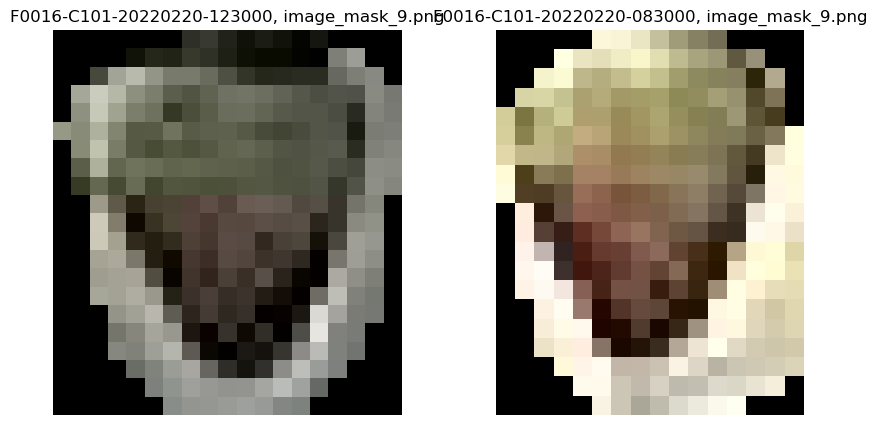

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_16
mask_id                                 9ec02953b2688f08b80c653835dcbe67
point_x_x                                                    1886.059814
point_y_x                                                      129.16629
output_image_path_x                                    image_mask_16.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

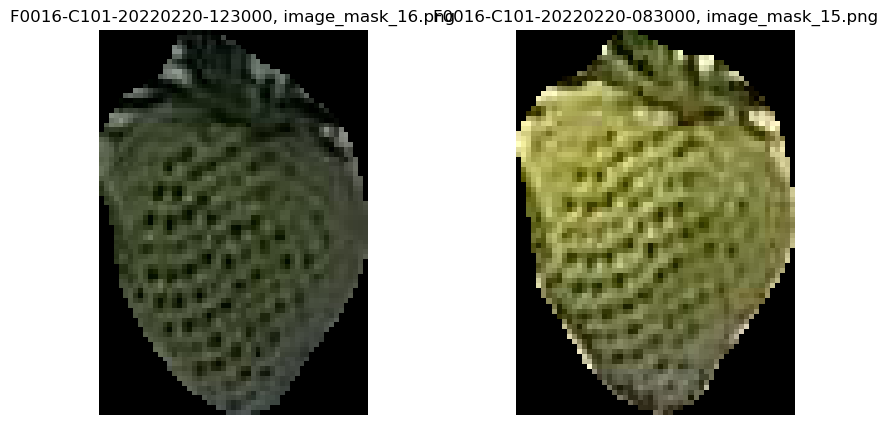

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_54
mask_id                                 a0ff684777c582030bb6957f62a6c69f
point_x_x                                                    2146.454102
point_y_x                                                     107.409683
output_image_path_x                                    image_mask_54.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

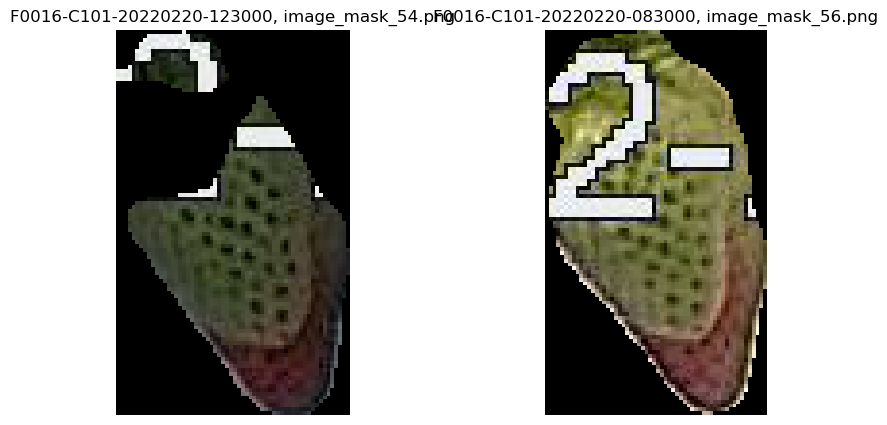

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_46
mask_id                                 b385814f48cbffb4559a453616504f58
point_x_x                                                    2536.779053
point_y_x                                                      381.11087
output_image_path_x                                    image_mask_46.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

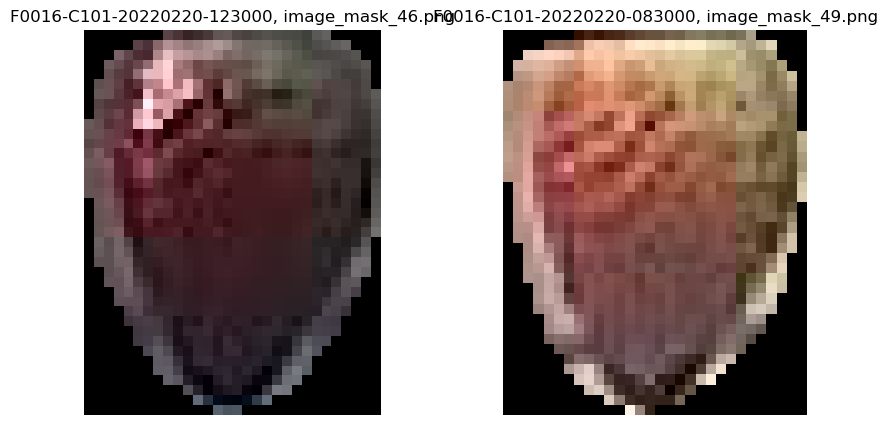

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_30
mask_id                                 b55ae2474d0a2595687492386ff543f3
point_x_x                                                    1704.714111
point_y_x                                                      213.71582
output_image_path_x                                    image_mask_30.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

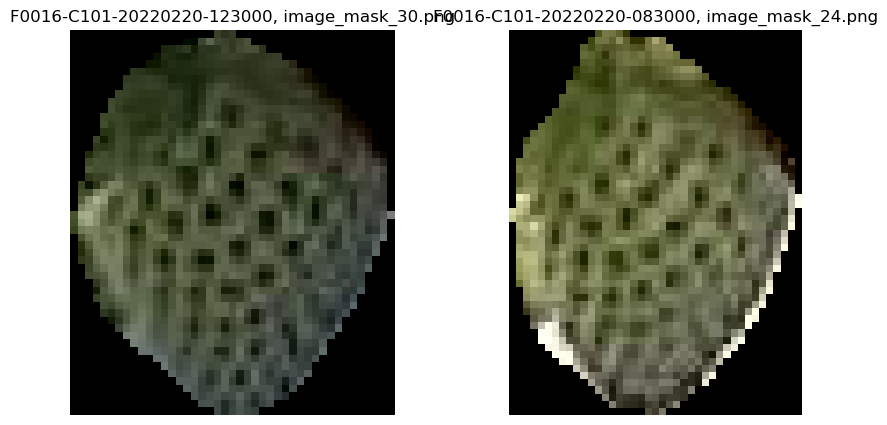

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_18
mask_id                                 b9f032cc07bd24936bc61e37d64d2e2a
point_x_x                                                    1777.498047
point_y_x                                                     184.387283
output_image_path_x                                    image_mask_18.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

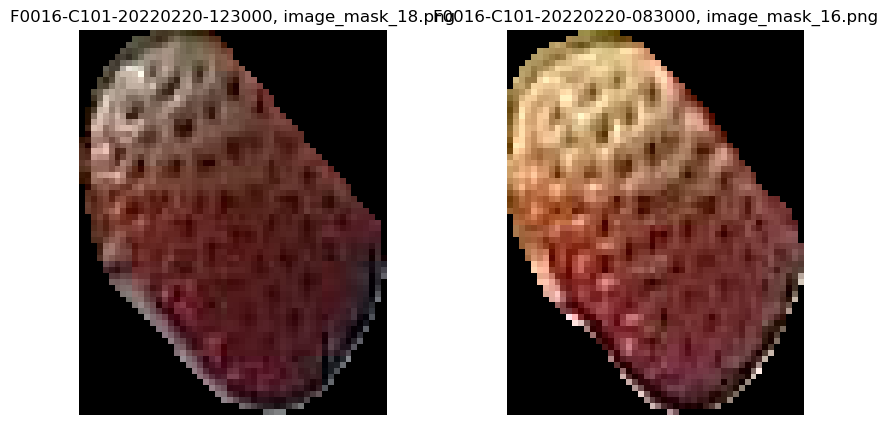

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_37
mask_id                                 b9f032cc07bd24936bc61e37d64d2e2a
point_x_x                                                    1777.532227
point_y_x                                                     174.600464
output_image_path_x                                    image_mask_37.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

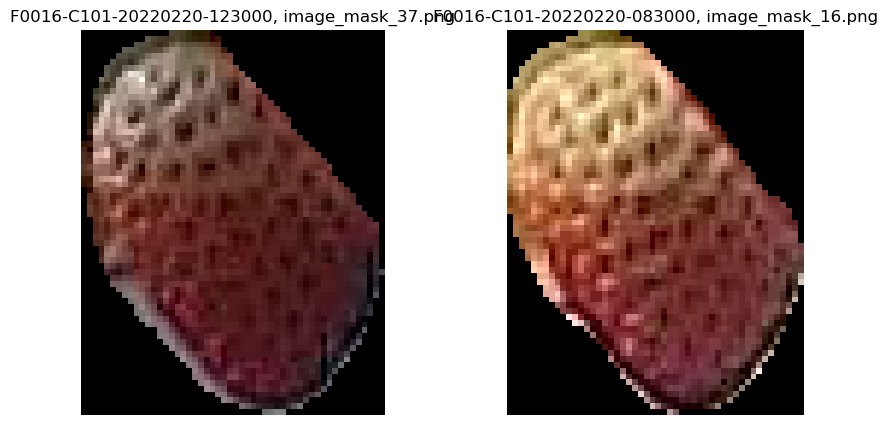

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_44
mask_id                                 bb3571acc935cf351684e9f5b7e20f62
point_x_x                                                    1855.241699
point_y_x                                                     449.546326
output_image_path_x                                    image_mask_44.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

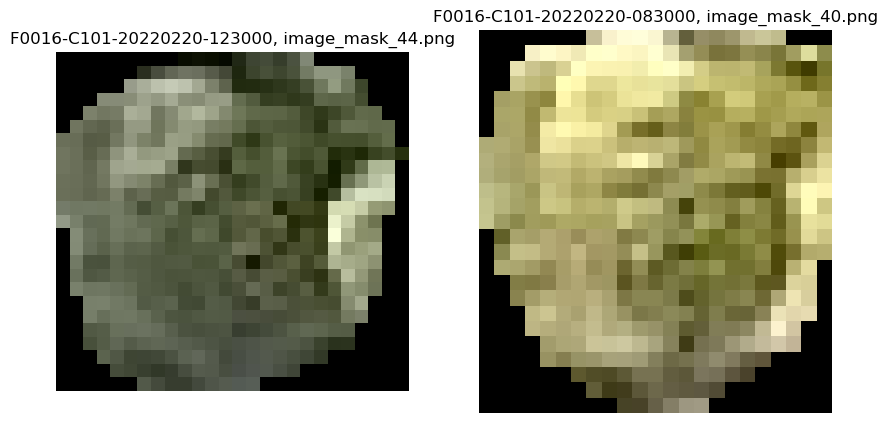

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_12
mask_id                                 c18c721c3b33ef54a1ad6f77c60dcf36
point_x_x                                                    1216.285156
point_y_x                                                     260.775696
output_image_path_x                                    image_mask_12.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

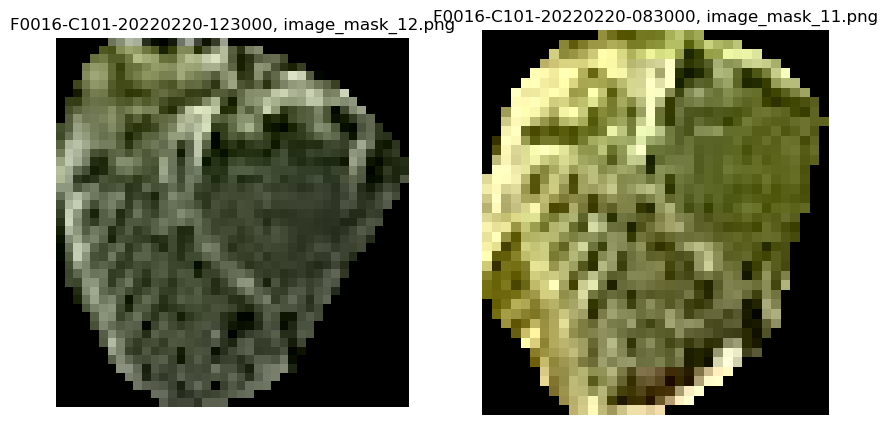

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_24
mask_id                                 c3947f703e79feef8a3dc093f49719fb
point_x_x                                                    1293.304077
point_y_x                                                     539.967651
output_image_path_x                                    image_mask_24.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

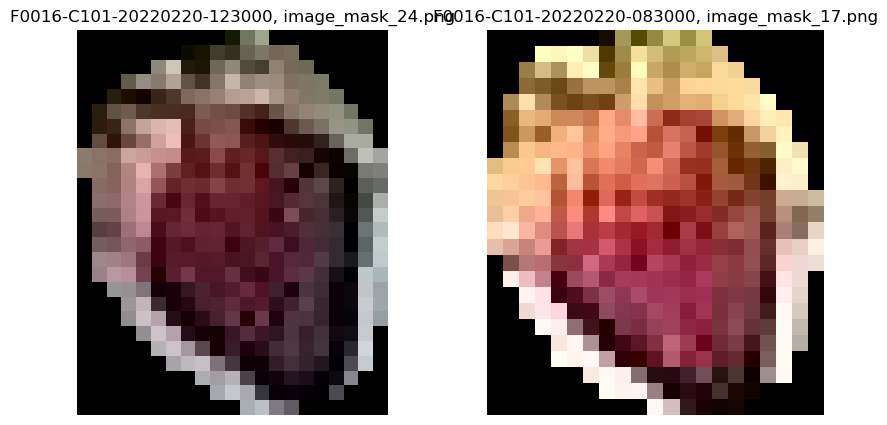

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_10
mask_id                                 c83256c46c57597229270d4aba5e36e1
point_x_x                                                    1039.564575
point_y_x                                                     582.979736
output_image_path_x                                    image_mask_10.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

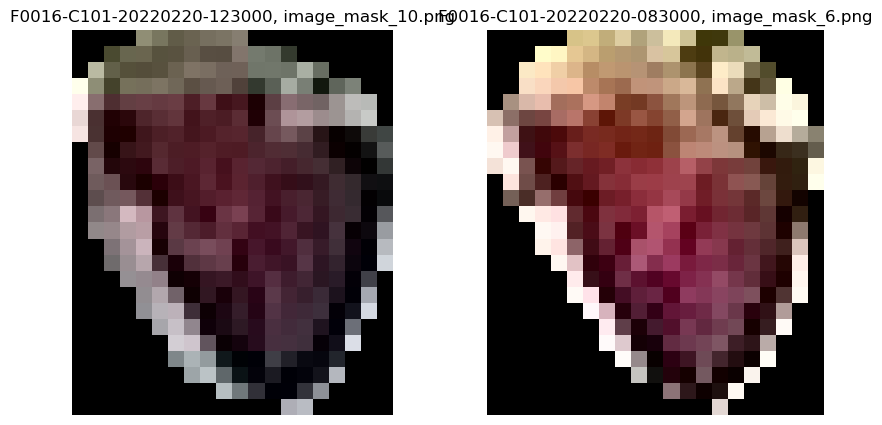

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_27
mask_id                                 ccf400a6a135984615b41b5cc72a724b
point_x_x                                                    1841.331543
point_y_x                                                     470.568665
output_image_path_x                                    image_mask_27.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

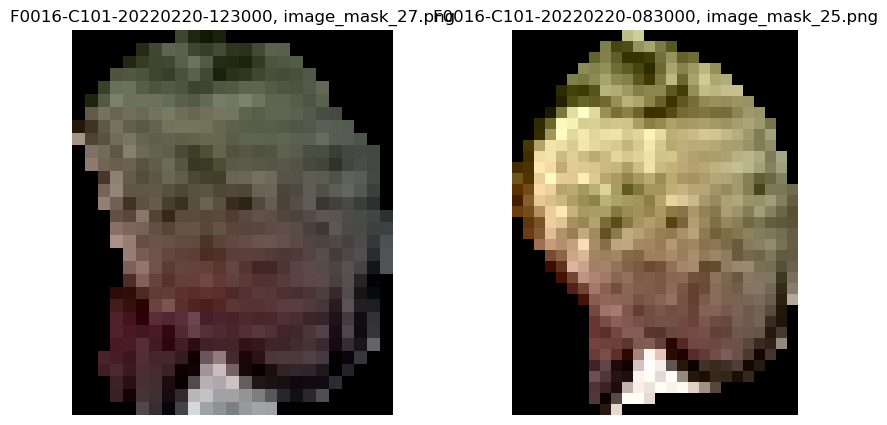

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_49
mask_id                                 e0f96d917577ddf4df52cc4b4aff3bae
point_x_x                                                    1929.721558
point_y_x                                                     470.428314
output_image_path_x                                    image_mask_49.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

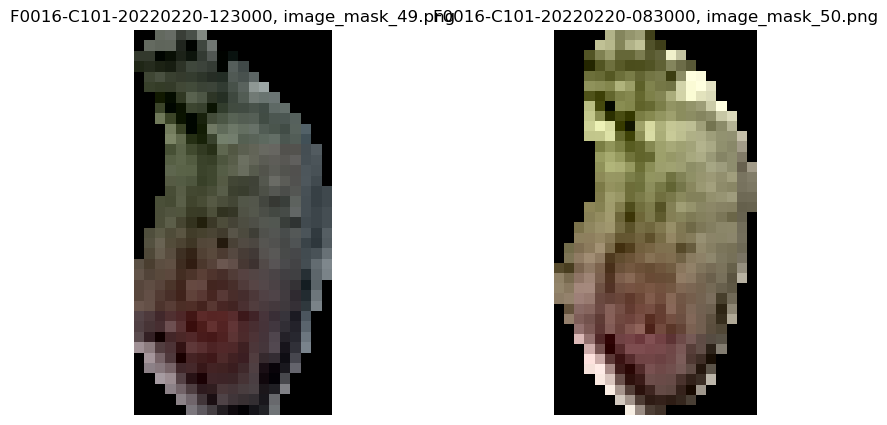

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_56
mask_id                                 e35fedd1c959bf01f5783358d1c7fbb6
point_x_x                                                    2434.286865
point_y_x                                                     381.882111
output_image_path_x                                    image_mask_56.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

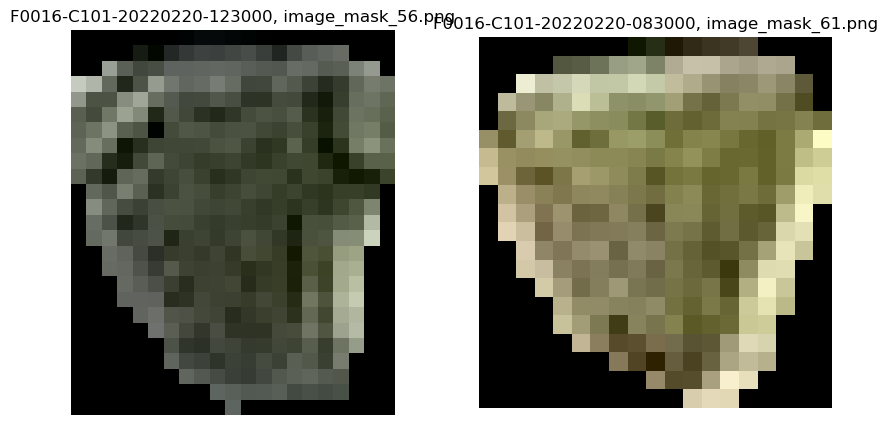

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_25
mask_id                                 faac2a53da4a96ac6e661b313a0fae2f
point_x_x                                                    1828.463135
point_y_x                                                     480.421265
output_image_path_x                                    image_mask_25.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

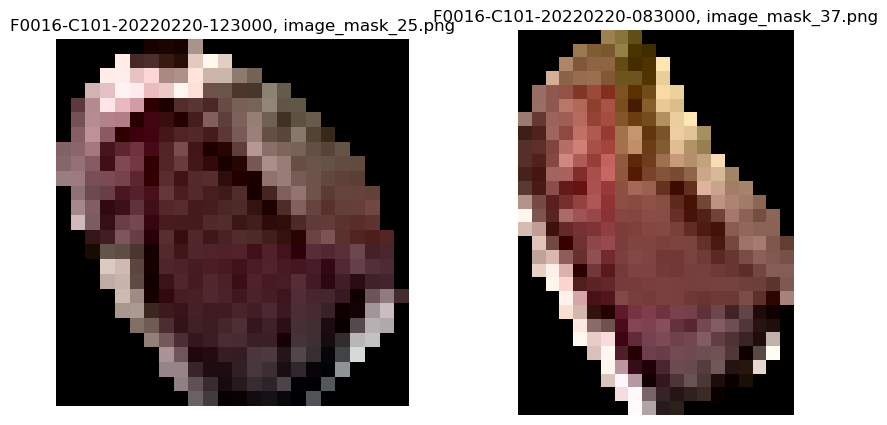

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_66
mask_id                                 fc0443333d4acabfe8f47ff8a73c21b0
point_x_x                                                    2488.052979
point_y_x                                                      393.17627
output_image_path_x                                    image_mask_66.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

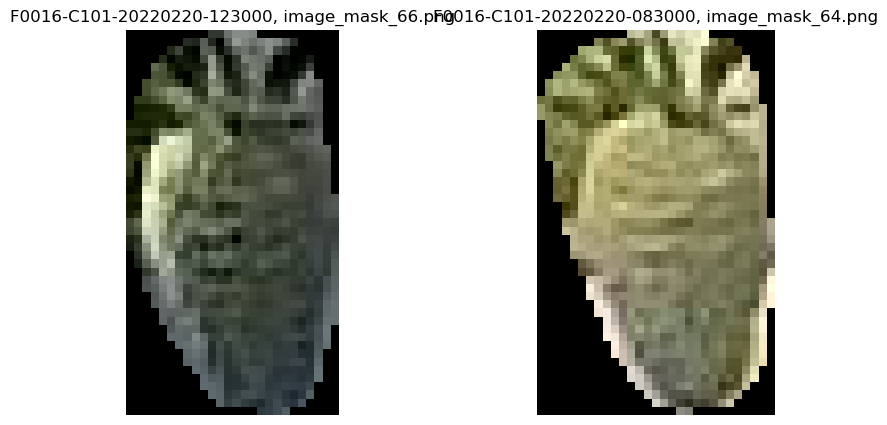

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220220-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220220-083000
mask_num_x                                 F0016-C101-20220220-123000_66
mask_id                                 fc0443333d4acabfe8f47ff8a73c21b0
point_x_x                                                    2488.052979
point_y_x                                                      393.17627
output_image_path_x                                    image_mask_66.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220220-083000
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

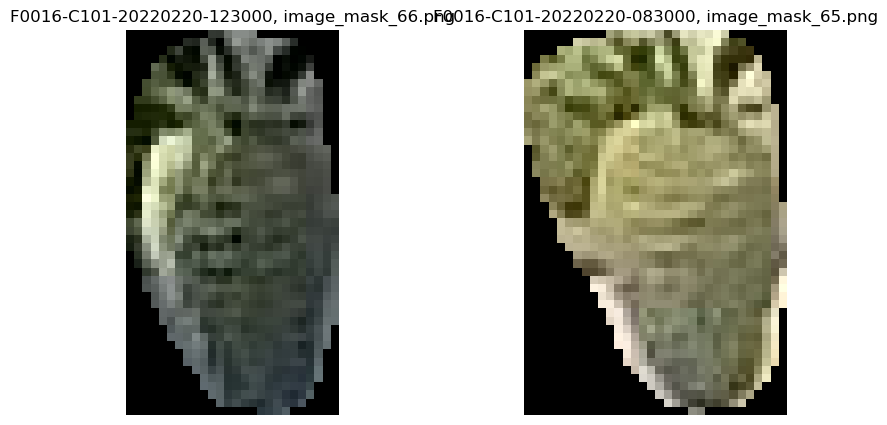

In [31]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_77
mask_id                                 0d54afcf03220bbe1d6b9f3bf4a80a2c
point_x_x                                                    2253.372559
point_y_x                                                     398.199097
output_image_path_x                                    image_mask_77.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

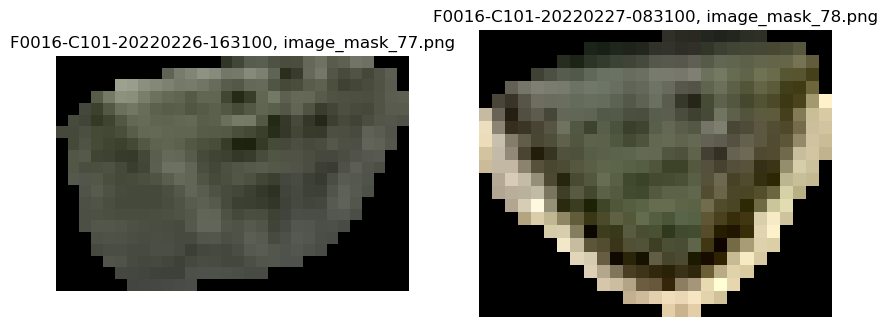

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_81
mask_id                                 1142e137e119fae24355900908132022
point_x_x                                                    2391.052734
point_y_x                                                     385.553345
output_image_path_x                                    image_mask_81.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

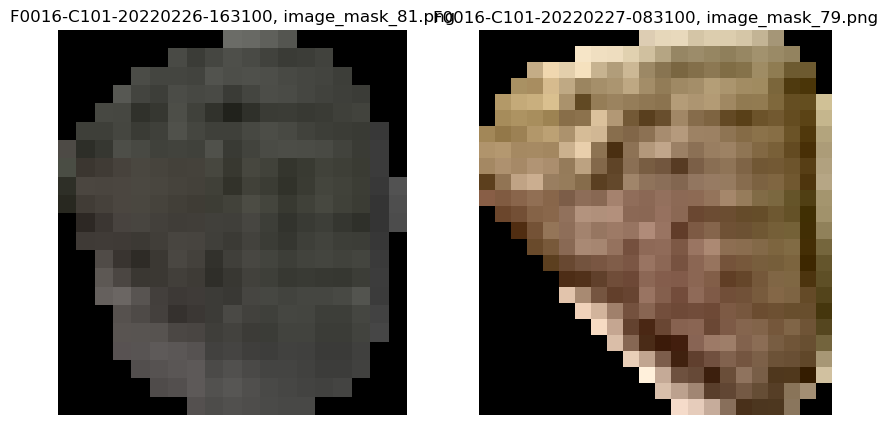

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_56
mask_id                                 11e3a3128dc5cb2e85bd75d29e3153cf
point_x_x                                                    2172.952148
point_y_x                                                     129.588104
output_image_path_x                                    image_mask_56.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

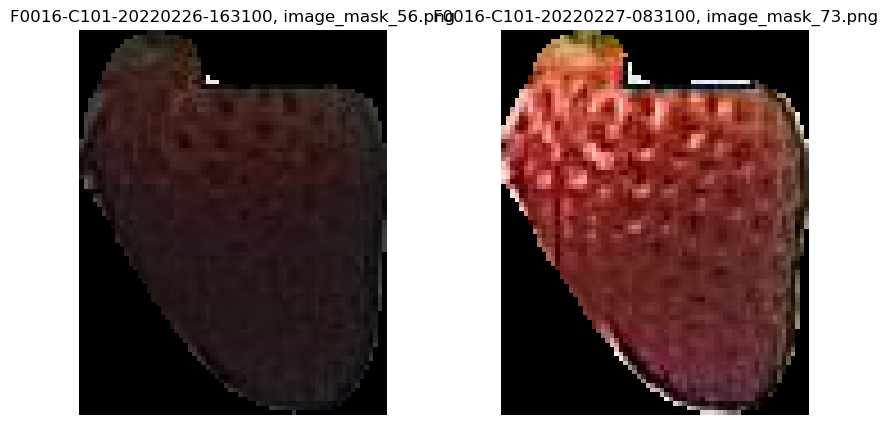

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_25
mask_id                                 2860e2b8810786bce534c3a9424b53bb
point_x_x                                                    1732.747681
point_y_x                                                     478.908203
output_image_path_x                                    image_mask_25.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

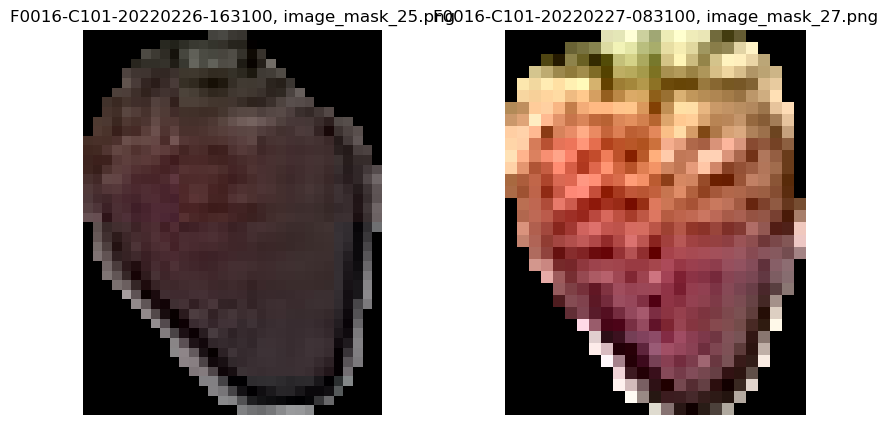

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_71
mask_id                                 2af9c3ca6c05d3f0a0f8e334f8377718
point_x_x                                                     2292.35791
point_y_x                                                      14.185547
output_image_path_x                                    image_mask_71.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

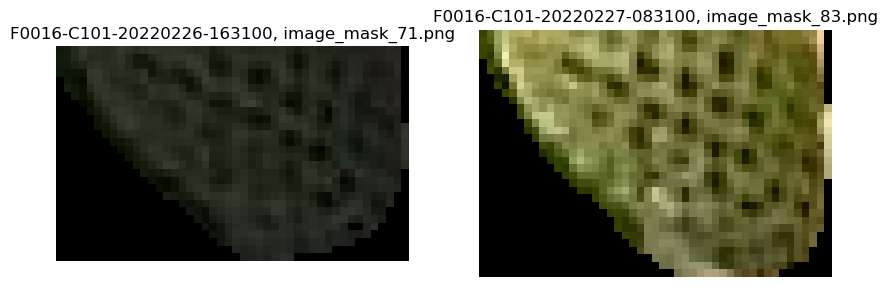

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_75
mask_id                                 3062dcfbe3a0584e7fc526db1433aaf2
point_x_x                                                    2501.173828
point_y_x                                                      86.133316
output_image_path_x                                    image_mask_75.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

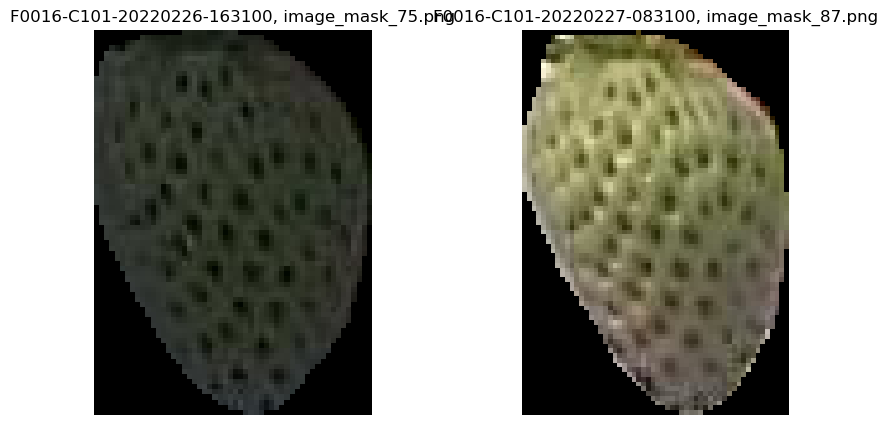

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_66
mask_id                                 409d1a5ef70fd18b0ab54d1aac294bcd
point_x_x                                                    2029.906494
point_y_x                                                      135.36998
output_image_path_x                                    image_mask_66.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

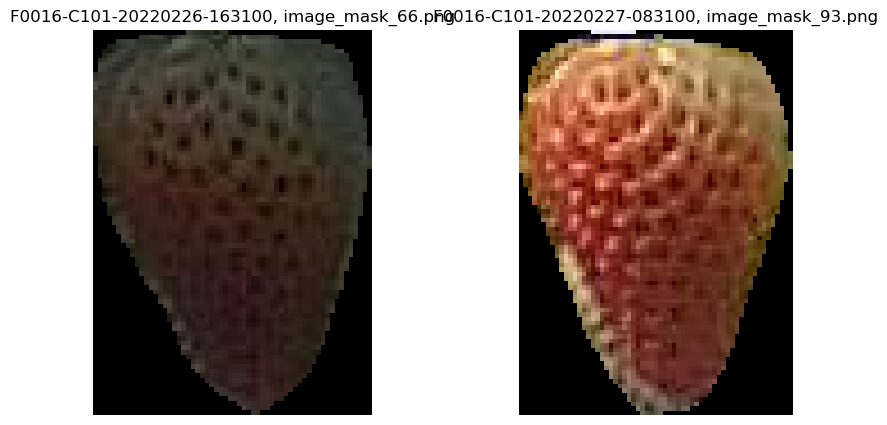

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_14
mask_id                                 46318a4524be95a26369b2d964722906
point_x_x                                                     894.845825
point_y_x                                                     412.852844
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

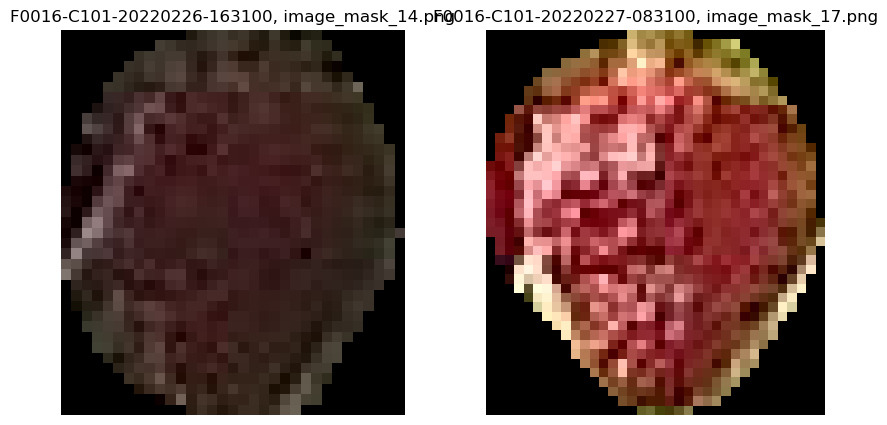

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_68
mask_id                                 4c2959a796de085523b61ae1f281a398
point_x_x                                                    2445.625488
point_y_x                                                     400.005493
output_image_path_x                                    image_mask_68.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

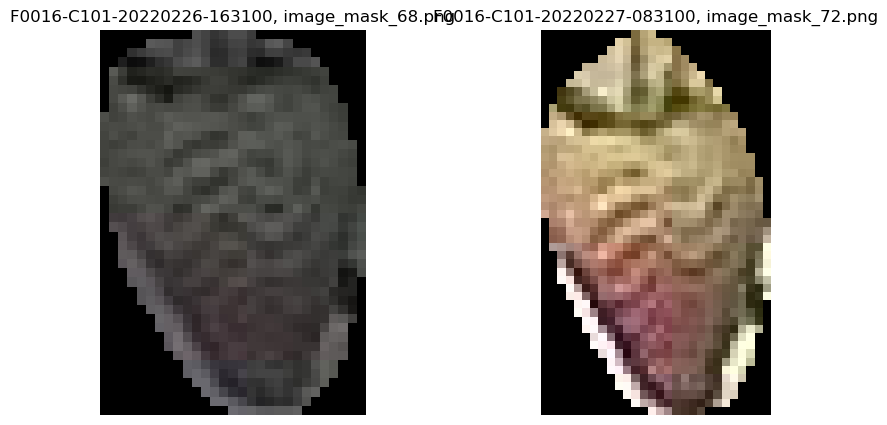

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_72
mask_id                                 504b0944ae8ea0ae4e7813c54082bca3
point_x_x                                                    2292.662109
point_y_x                                                     390.960388
output_image_path_x                                    image_mask_72.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

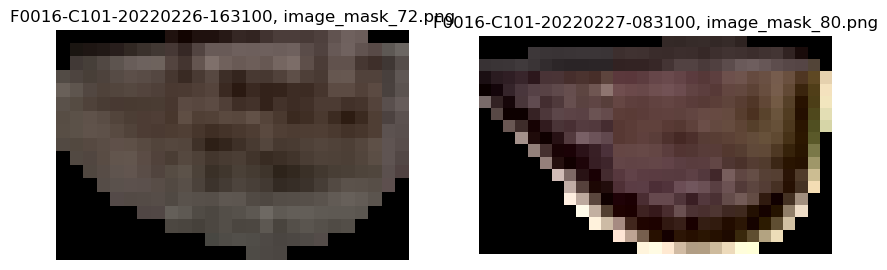

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_84
mask_id                                 504b0944ae8ea0ae4e7813c54082bca3
point_x_x                                                    2292.682617
point_y_x                                                     395.348267
output_image_path_x                                    image_mask_84.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

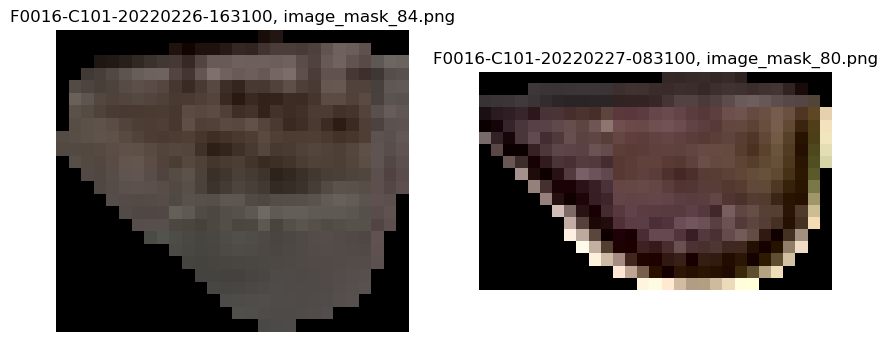

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_23
mask_id                                 5634118b4c3abc4c003a4bd042da7406
point_x_x                                                    1402.007935
point_y_x                                                     520.945923
output_image_path_x                                    image_mask_23.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

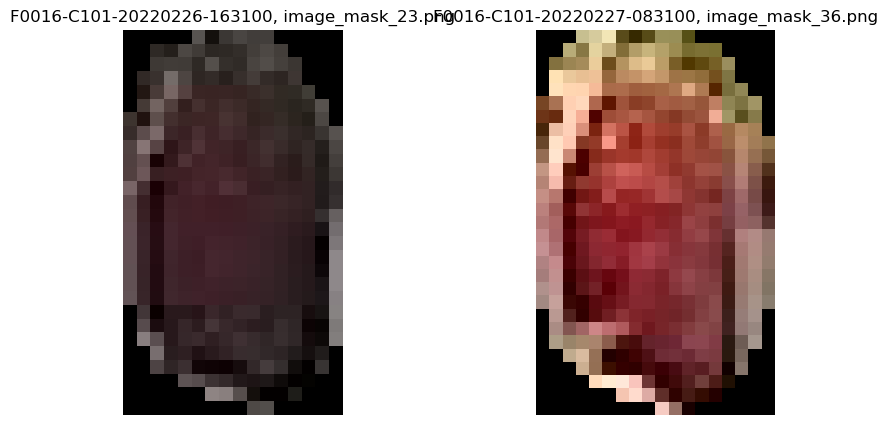

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_61
mask_id                                 57a59349454878827febd6a17241076b
point_x_x                                                    1975.459229
point_y_x                                                     137.468353
output_image_path_x                                    image_mask_61.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

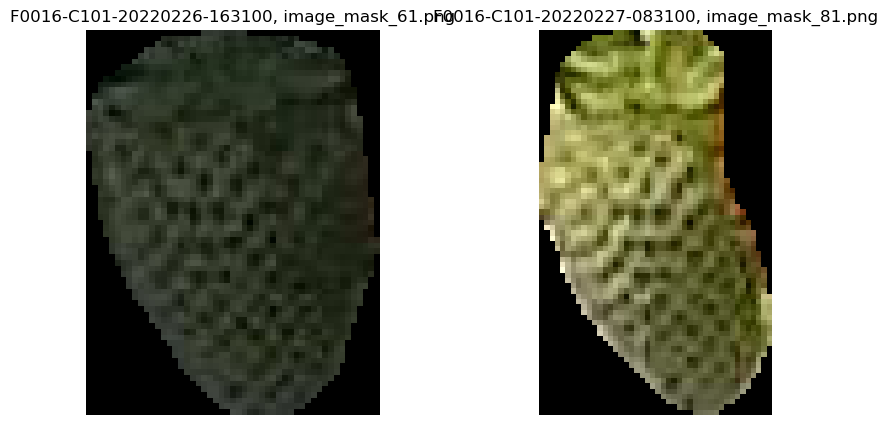

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                  F0016-C101-20220226-163100_6
mask_id                                 57b2cac3d604c10bbfeb3e93602cbddb
point_x_x                                                    1230.612305
point_y_x                                                     287.904785
output_image_path_x                                     image_mask_6.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

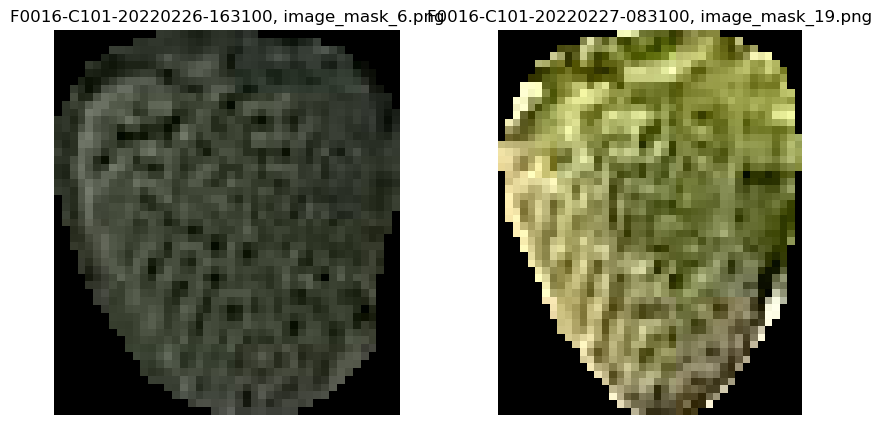

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_26
mask_id                                 5c4baefd59379e1458bf104750f306dc
point_x_x                                                    1764.116089
point_y_x                                                     457.471497
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

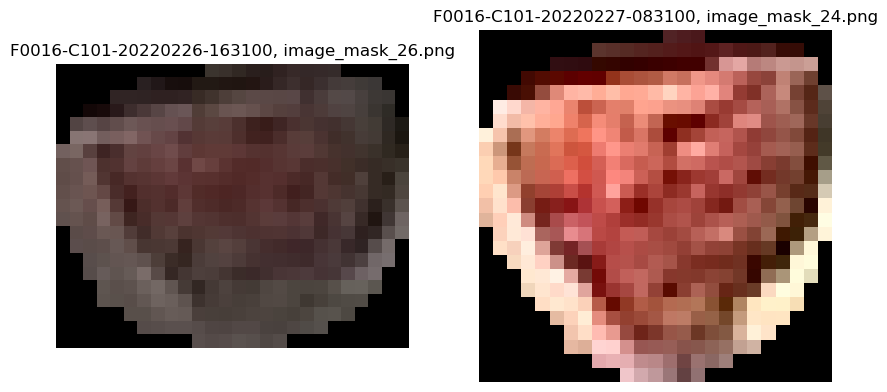

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_57
mask_id                                 5d654ff67a876c443b3a6418872fc554
point_x_x                                                     2347.13916
point_y_x                                                      24.396917
output_image_path_x                                    image_mask_57.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

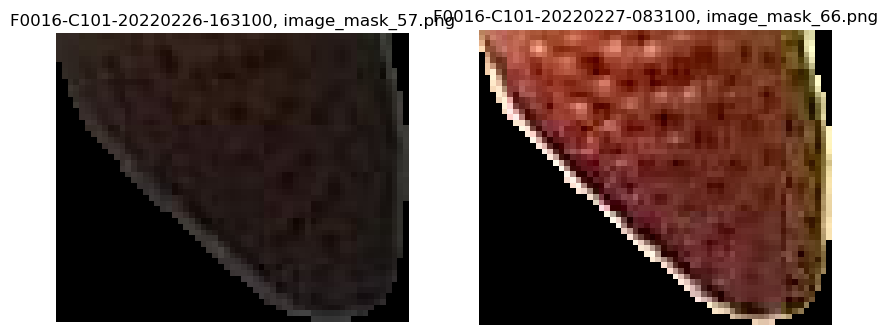

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_50
mask_id                                 64698136726718286cab01f23452e680
point_x_x                                                    1708.135864
point_y_x                                                     474.748505
output_image_path_x                                    image_mask_50.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

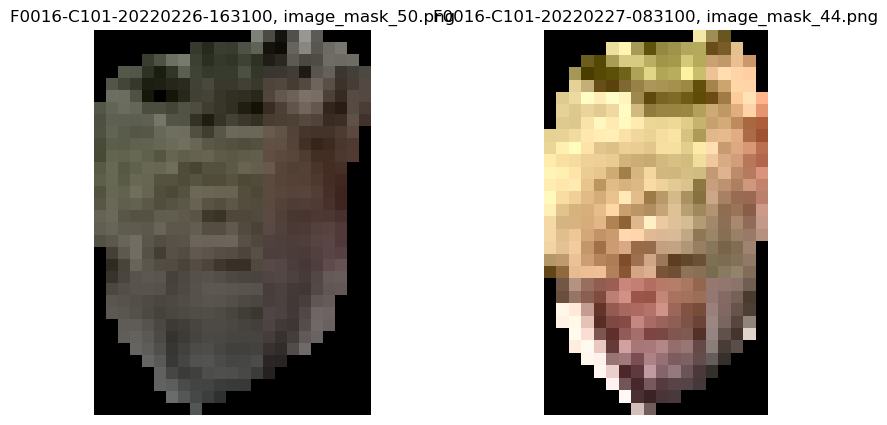

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_59
mask_id                                 67bd27ad5647b2699b51f6da2d5039f0
point_x_x                                                    2498.686035
point_y_x                                                        415.362
output_image_path_x                                    image_mask_59.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

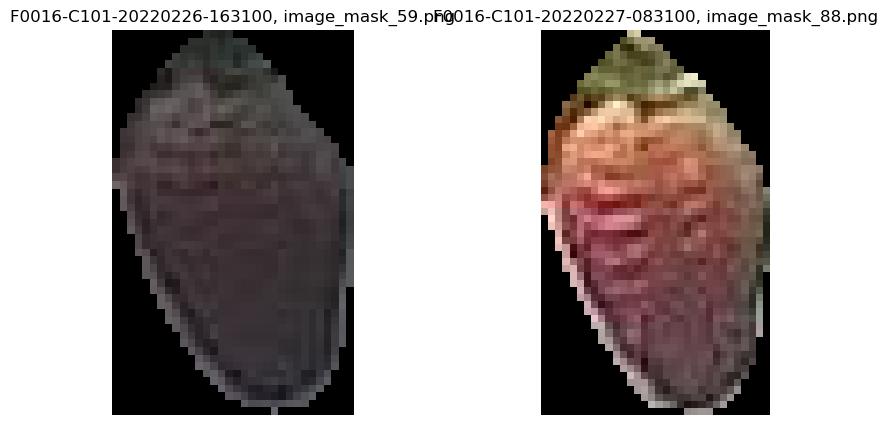

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_65
mask_id                                 68be9045ef8ed05832b2a80aedb5f458
point_x_x                                                    2055.952637
point_y_x                                                     172.191132
output_image_path_x                                    image_mask_65.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

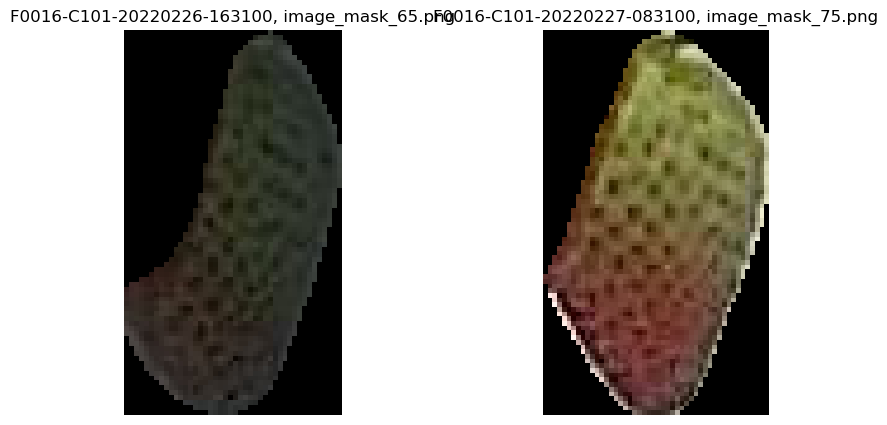

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_67
mask_id                                 6f2d9968c85877320a472e8c98fac0c8
point_x_x                                                    2546.958984
point_y_x                                                      76.314484
output_image_path_x                                    image_mask_67.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

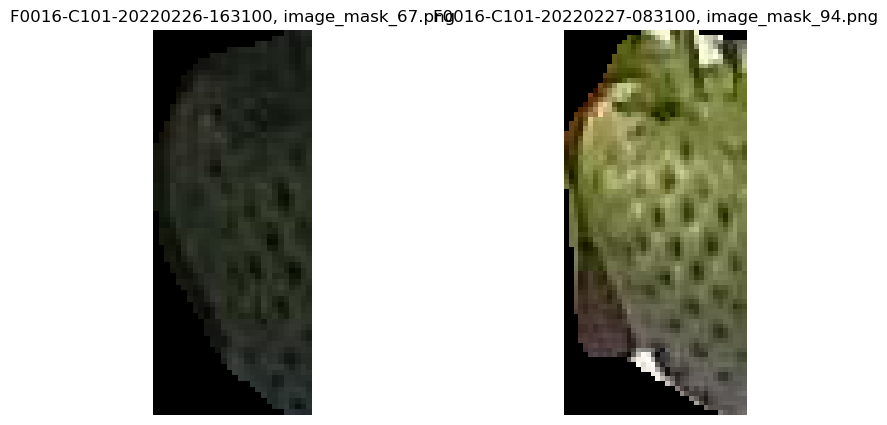

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_74
mask_id                                 7851f69f5bd5f6c34f599bfb0a75804c
point_x_x                                                    2108.345215
point_y_x                                                     457.688477
output_image_path_x                                    image_mask_74.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

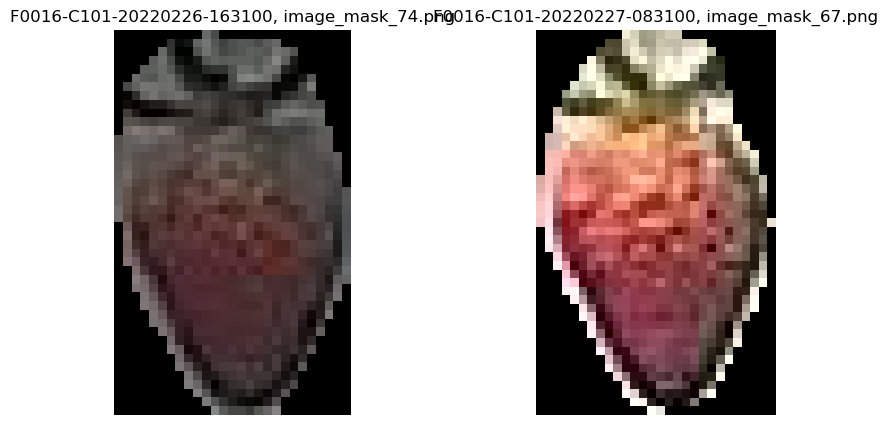

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_82
mask_id                                 78d4fc53208dbd26c310a2b88e041948
point_x_x                                                    2469.554688
point_y_x                                                     420.692627
output_image_path_x                                    image_mask_82.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

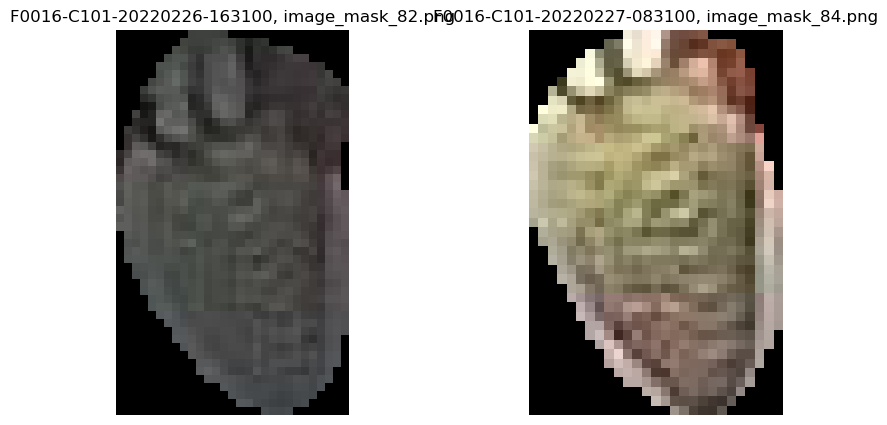

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_58
mask_id                                 7d78902ab2ef05dfe489937a97aa69c5
point_x_x                                                    2324.986328
point_y_x                                                     404.553345
output_image_path_x                                    image_mask_58.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

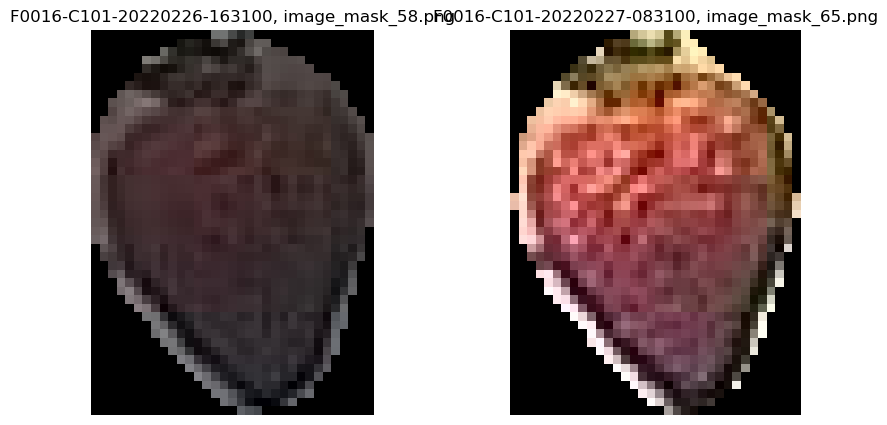

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_16
mask_id                                 80ba110200e28b45ec2c3fa4a646da37
point_x_x                                                      709.23468
point_y_x                                                     535.240601
output_image_path_x                                    image_mask_16.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

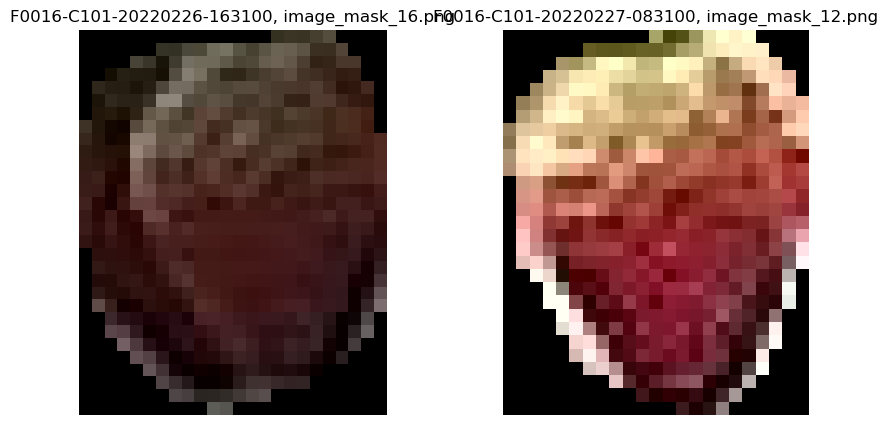

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_19
mask_id                                 82c15aa447f11cd28358c7f51fbfa0a6
point_x_x                                                     989.704956
point_y_x                                                     379.526489
output_image_path_x                                    image_mask_19.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

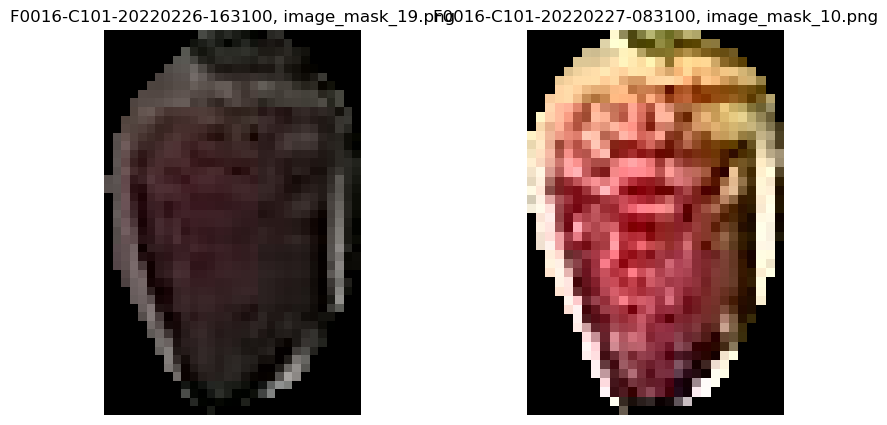

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_13
mask_id                                 88ea481518d107507082f89edcc32049
point_x_x                                                    1262.809082
point_y_x                                                     287.259033
output_image_path_x                                    image_mask_13.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

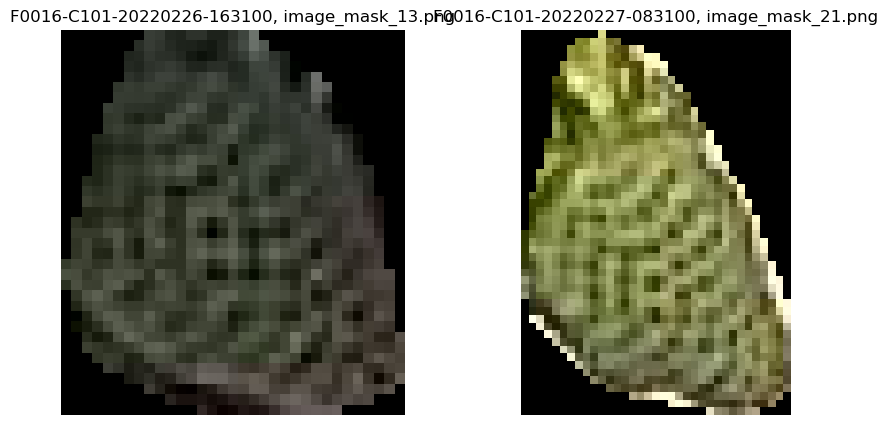

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_63
mask_id                                 923e1da268ba876a38ac0d15ed7cf9e6
point_x_x                                                     2179.68335
point_y_x                                                     413.508972
output_image_path_x                                    image_mask_63.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

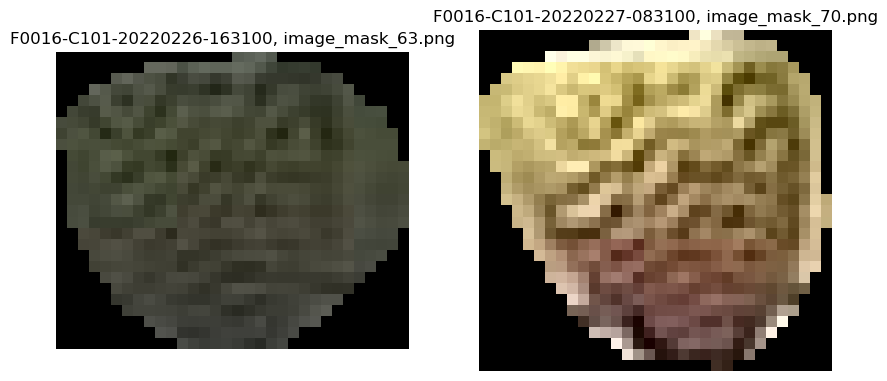

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_46
mask_id                                 986db48108836f14c3670e20d9bddfec
point_x_x                                                     1896.18689
point_y_x                                                      484.61792
output_image_path_x                                    image_mask_46.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

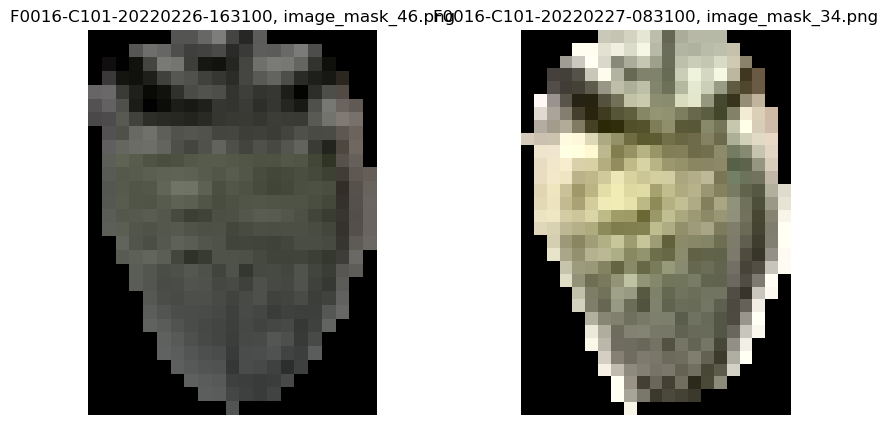

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                  F0016-C101-20220226-163100_7
mask_id                                 98d91ec11953c14a10804f5c3127502c
point_x_x                                                    1040.736816
point_y_x                                                      368.63031
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

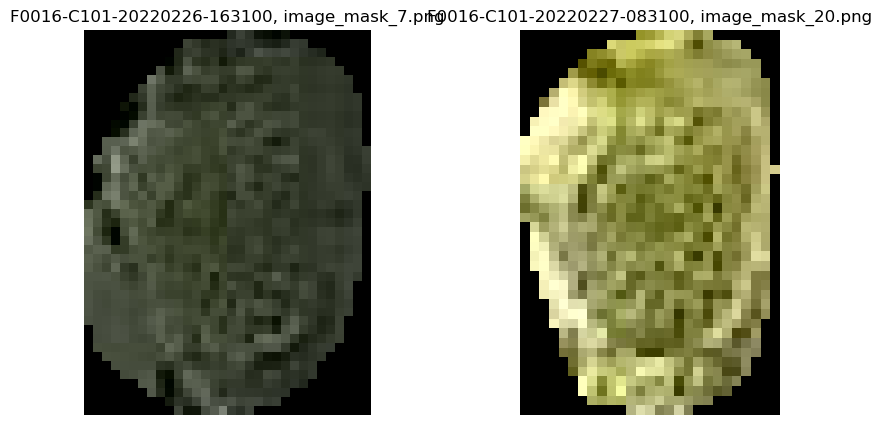

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_45
mask_id                                 99d3aedb4e309a24ac21a5113d819f0e
point_x_x                                                    1332.727783
point_y_x                                                     542.574097
output_image_path_x                                    image_mask_45.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

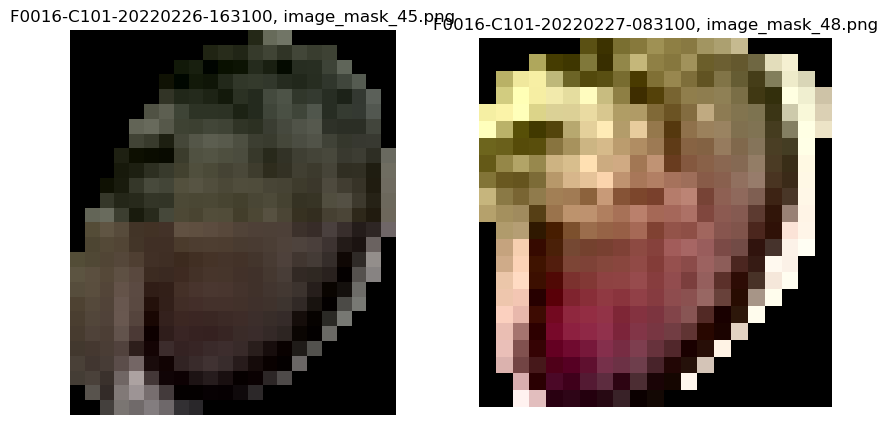

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                  F0016-C101-20220226-163100_5
mask_id                                 9d580a25bb5c5fd7a854f7ad09d3c13e
point_x_x                                                     941.305908
point_y_x                                                     407.691284
output_image_path_x                                     image_mask_5.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

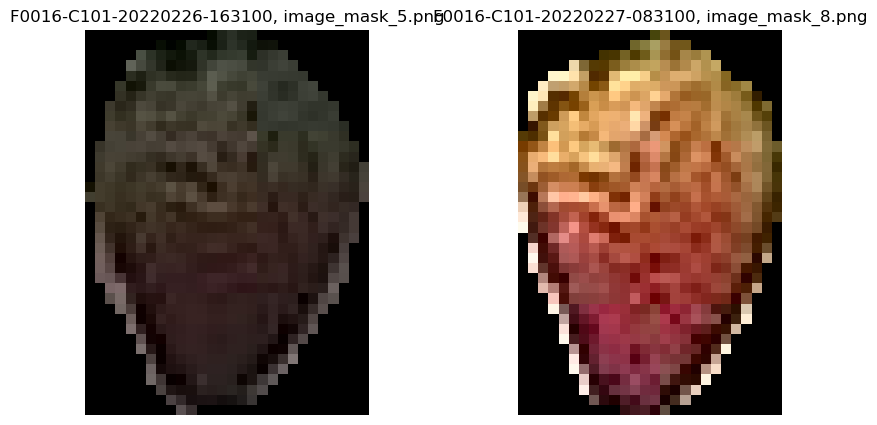

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                  F0016-C101-20220226-163100_1
mask_id                                 a1fabf6994b92f6c62116b83f5d6a05a
point_x_x                                                     508.873718
point_y_x                                                      156.58963
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

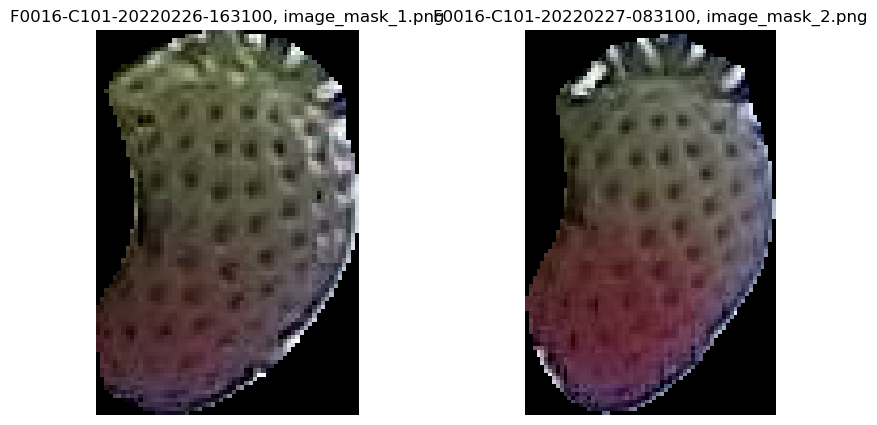

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_73
mask_id                                 a8da67d34d4921e9a623d6d83628d983
point_x_x                                                    2183.726074
point_y_x                                                       31.05801
output_image_path_x                                    image_mask_73.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

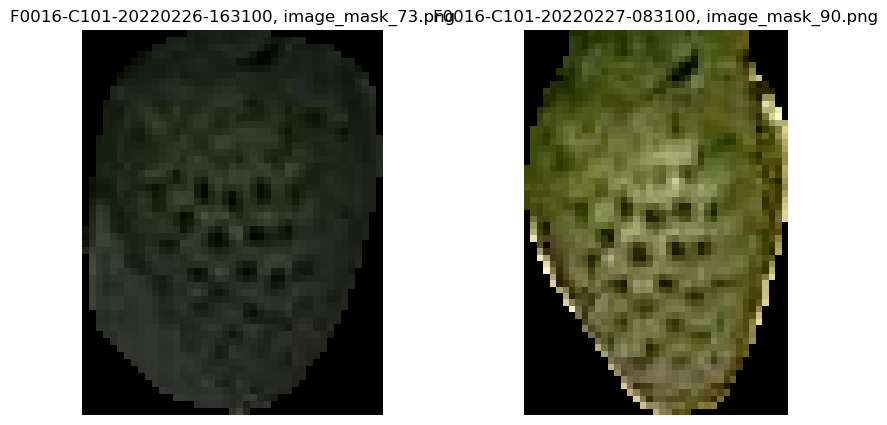

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_55
mask_id                                 ad60623edd4978297d58bc4f298733e3
point_x_x                                                    2128.440186
point_y_x                                                     171.130585
output_image_path_x                                    image_mask_55.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

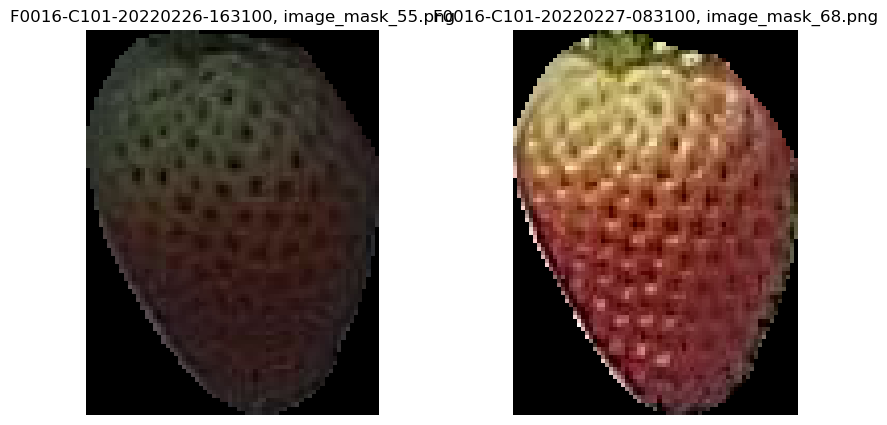

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_32
mask_id                                 b34d8825c04866eee6a2fb0be91949fb
point_x_x                                                    1621.578613
point_y_x                                                     499.102234
output_image_path_x                                    image_mask_32.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

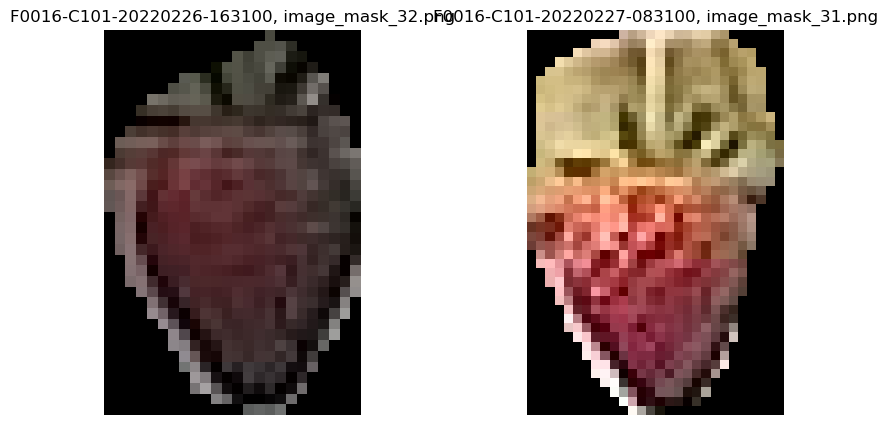

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_32
mask_id                                 b34d8825c04866eee6a2fb0be91949fb
point_x_x                                                    1621.578613
point_y_x                                                     499.102234
output_image_path_x                                    image_mask_32.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

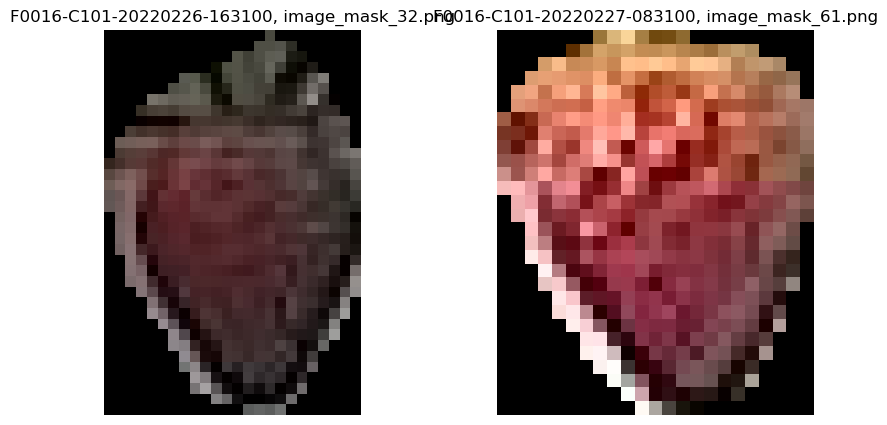

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_17
mask_id                                 b4a155709fad41599a173d80f8799b5a
point_x_x                                                    1237.109131
point_y_x                                                     556.051697
output_image_path_x                                    image_mask_17.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

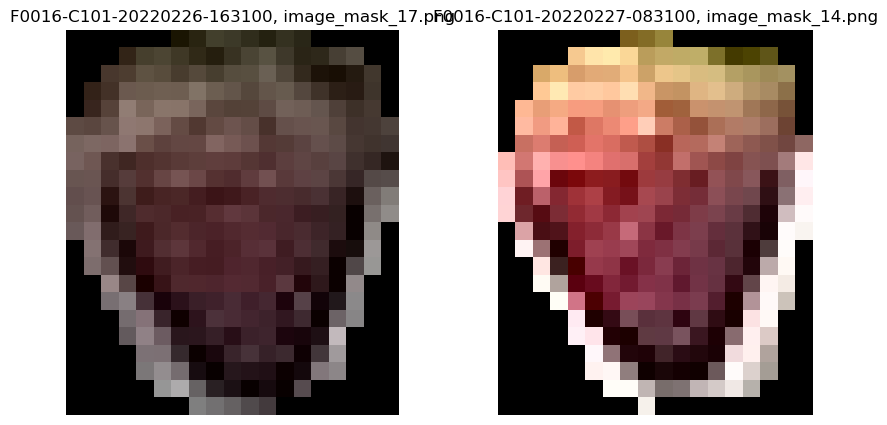

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                  F0016-C101-20220226-163100_8
mask_id                                 bac53b1d8c36ff844aa5330407b4b764
point_x_x                                                      730.04834
point_y_x                                                     532.803833
output_image_path_x                                     image_mask_8.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

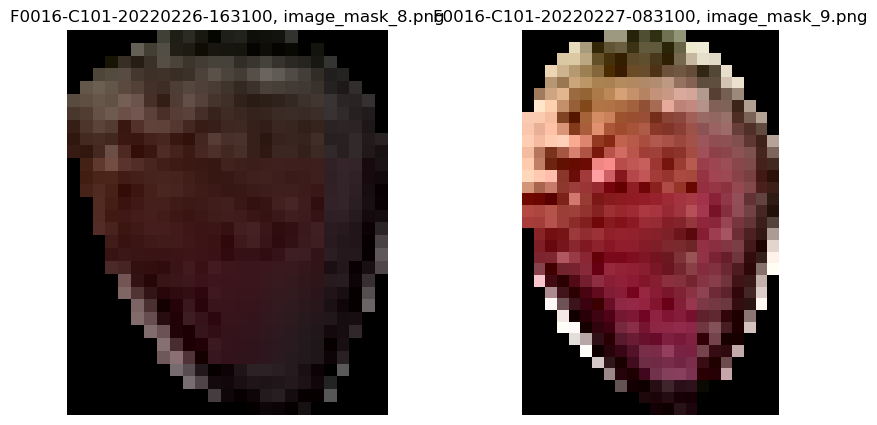

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_38
mask_id                                 bb3571acc935cf351684e9f5b7e20f62
point_x_x                                                    1852.569336
point_y_x                                                     456.355286
output_image_path_x                                    image_mask_38.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

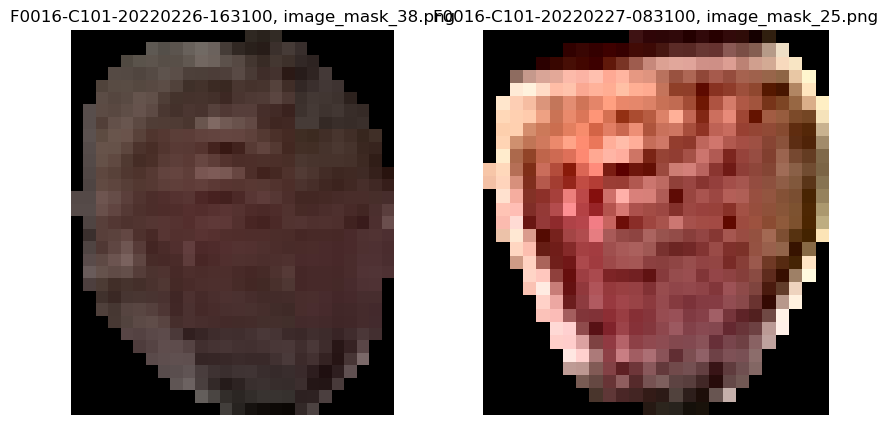

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_64
mask_id                                 bec9963ba2d0ff612cde4d2faf43712c
point_x_x                                                    2031.303833
point_y_x                                                     425.425171
output_image_path_x                                    image_mask_64.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

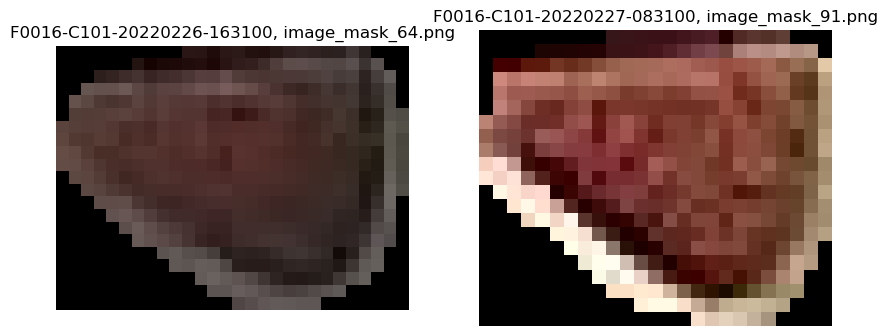

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_21
mask_id                                 c26179b0cd65eb270a4a4dd5e5a19c7e
point_x_x                                                    1478.559448
point_y_x                                                       254.7995
output_image_path_x                                    image_mask_21.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

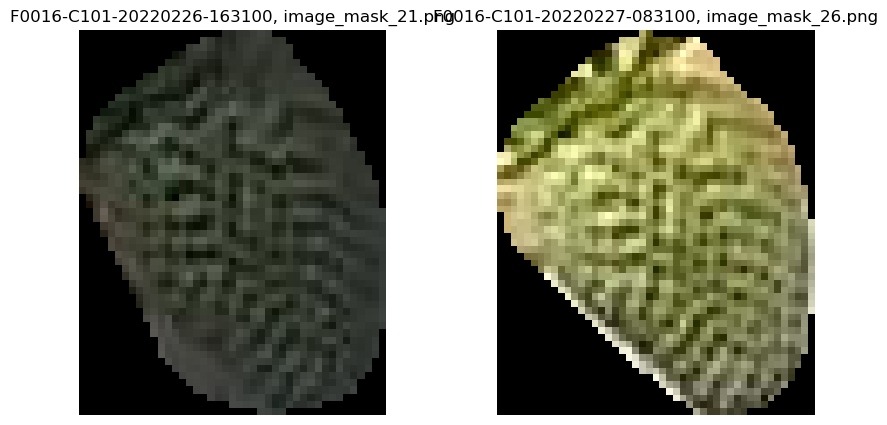

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_35
mask_id                                 c3947f703e79feef8a3dc093f49719fb
point_x_x                                                    1293.643799
point_y_x                                                     532.627014
output_image_path_x                                    image_mask_35.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

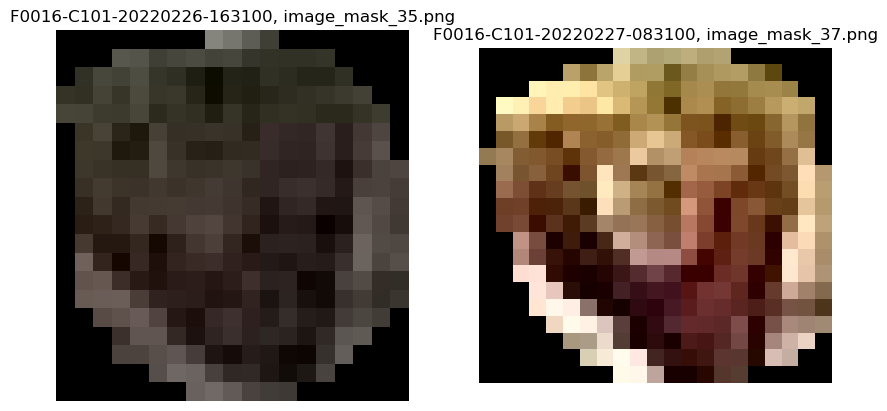

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_62
mask_id                                 cb519c1508e1ee81f6ea46ab60d1fe0c
point_x_x                                                    1968.336182
point_y_x                                                      438.85788
output_image_path_x                                    image_mask_62.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

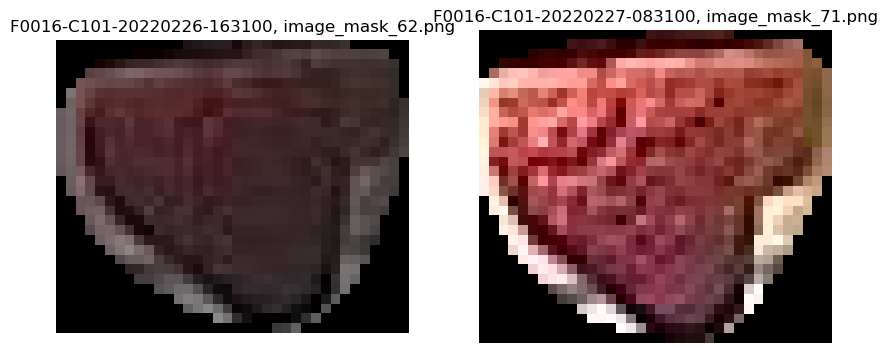

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_40
mask_id                                 d9d4c03a8b6b87b34ee8467b380f03c9
point_x_x                                                    1913.309448
point_y_x                                                      479.31311
output_image_path_x                                    image_mask_40.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

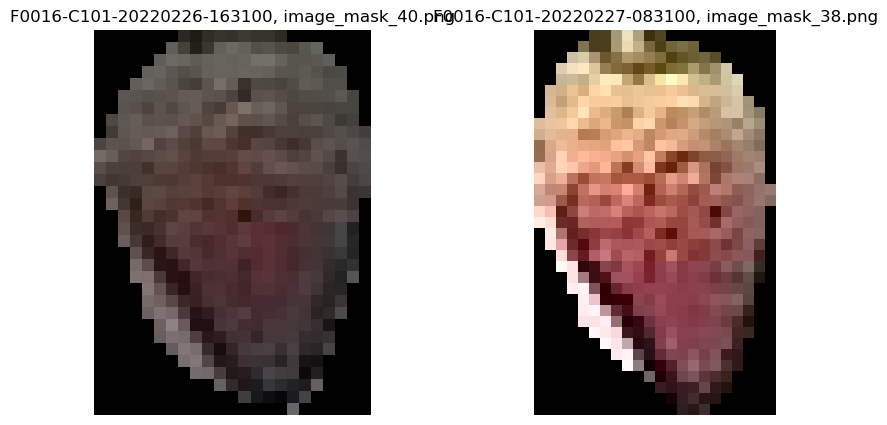

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_80
mask_id                                 da63c36cd9d9612160e29597c569c2d6
point_x_x                                                    2213.395508
point_y_x                                                      416.47934
output_image_path_x                                    image_mask_80.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

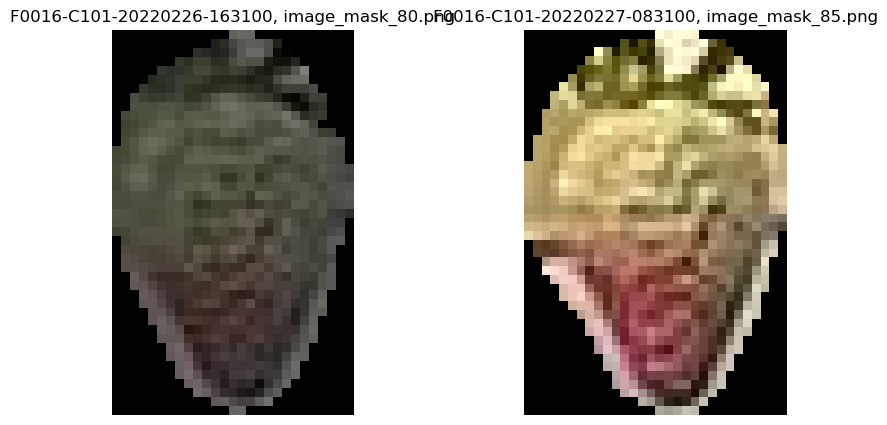

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_69
mask_id                                 e0f96d917577ddf4df52cc4b4aff3bae
point_x_x                                                    1926.296875
point_y_x                                                     476.795898
output_image_path_x                                    image_mask_69.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

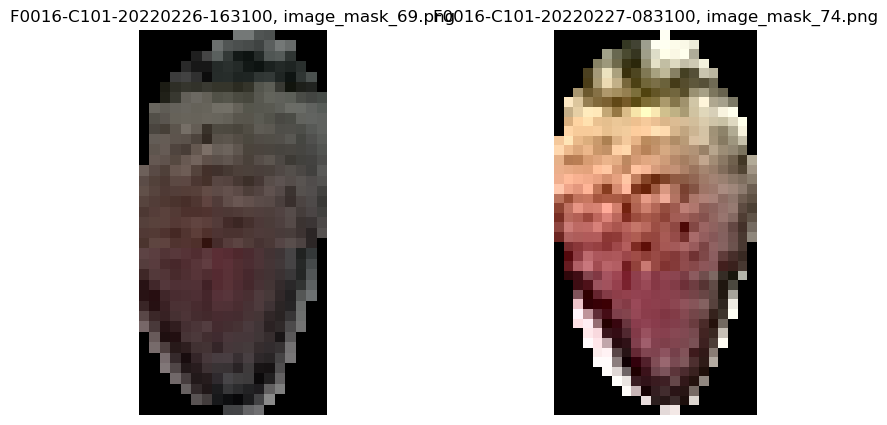

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_70
mask_id                                 e23cbbba255e27f9cd6d98dd29234b85
point_x_x                                                    2144.396484
point_y_x                                                     416.378601
output_image_path_x                                    image_mask_70.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

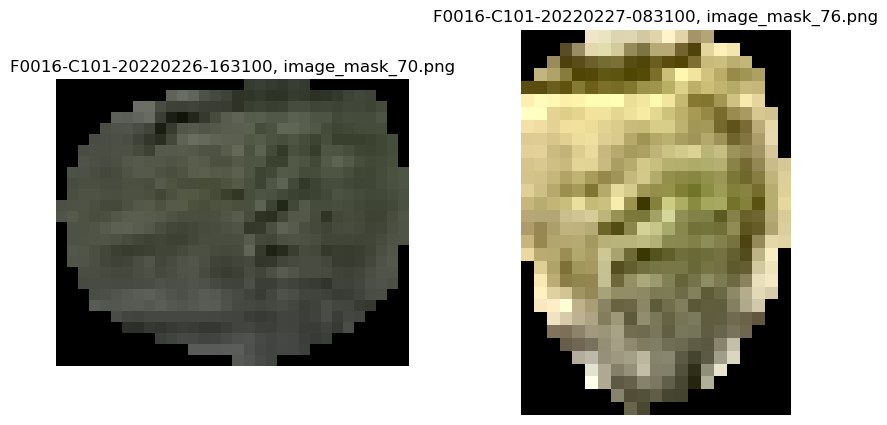

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_42
mask_id                                 e96caeada7cfa9ab009942a93ab565e2
point_x_x                                                    1756.592041
point_y_x                                                      81.083008
output_image_path_x                                    image_mask_42.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

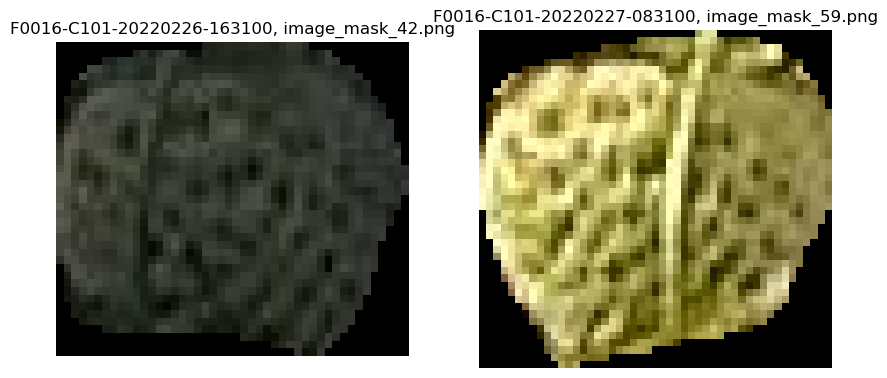

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_53
mask_id                                 eb00829c43a94b60020a73dbd50f965f
point_x_x                                                    1665.838257
point_y_x                                                     268.595001
output_image_path_x                                    image_mask_53.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

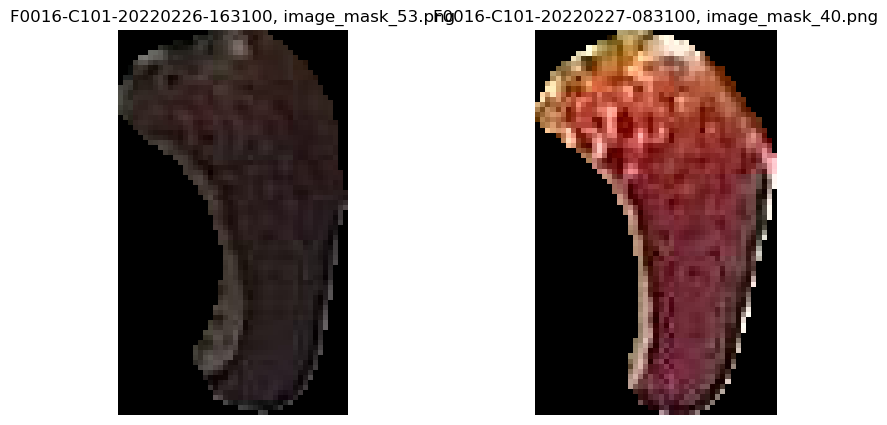

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                  F0016-C101-20220226-163100_9
mask_id                                 ed85bddee852dcae30715baa1e32d0ff
point_x_x                                                     741.418213
point_y_x                                                     499.562073
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

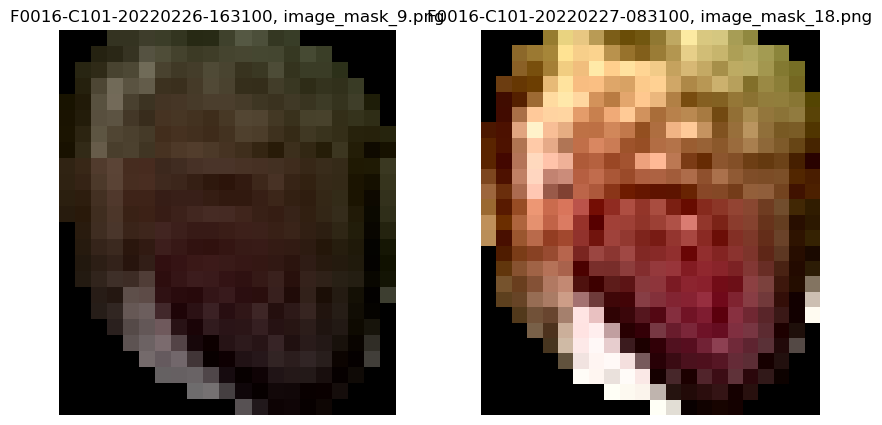

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_60
mask_id                                 ef1f77be4e709445d6bfc524b8b3ce09
point_x_x                                                    2373.203369
point_y_x                                                     395.295776
output_image_path_x                                    image_mask_60.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

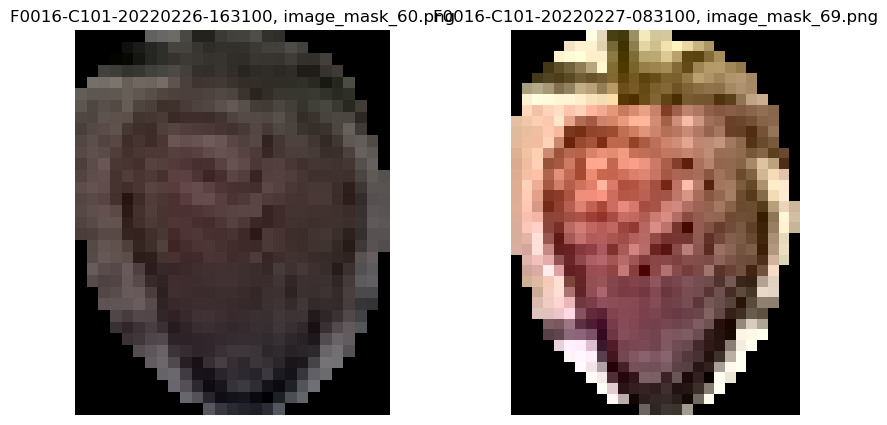

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220226-163100
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220226-124700
mask_num_x                                 F0016-C101-20220226-163100_76
mask_id                                 f9a12e4845af53932b18aedc5dd8e4d1
point_x_x                                                    2232.868652
point_y_x                                                      23.293362
output_image_path_x                                    image_mask_76.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220227-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

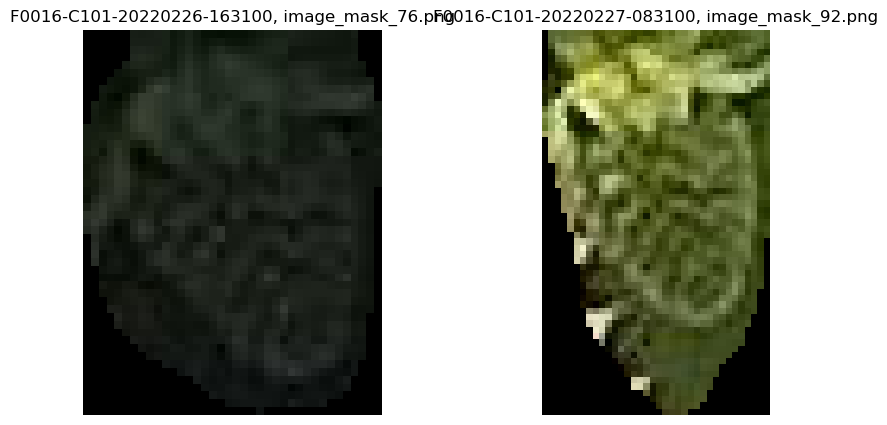

In [40]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_76
mask_id                                 03311a5c92cdcd7f791a5d21776ae93d
point_x_x                                                    2039.951416
point_y_x                                                     425.039124
output_image_path_x                                    image_mask_76.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

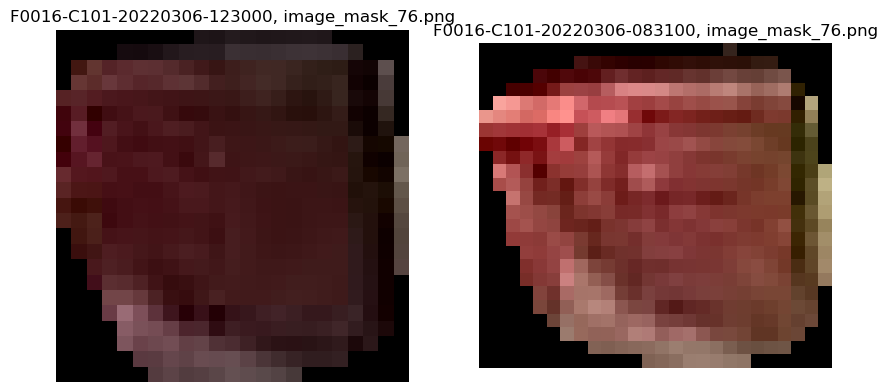

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_52
mask_id                                 116b9d6e37a233ebbb0e1a0f23340795
point_x_x                                                    1318.637207
point_y_x                                                     560.625732
output_image_path_x                                    image_mask_52.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

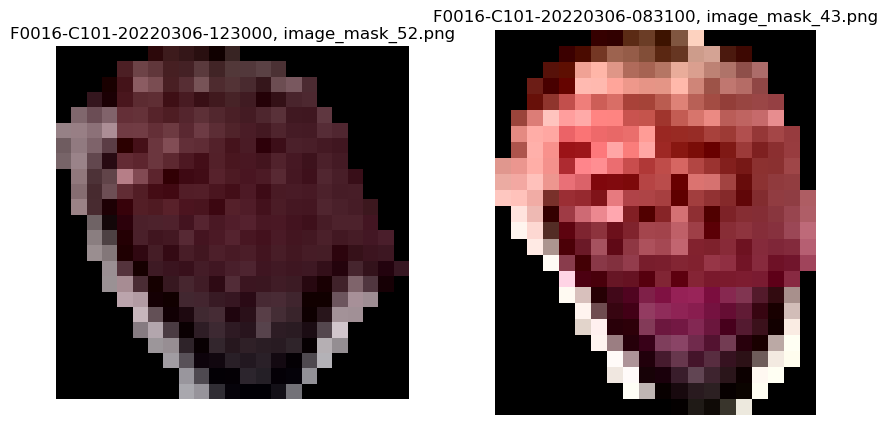

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_79
mask_id                                 11ba8dba9a678f4a2d4457b27df21979
point_x_x                                                    2355.910156
point_y_x                                                      393.30484
output_image_path_x                                    image_mask_79.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

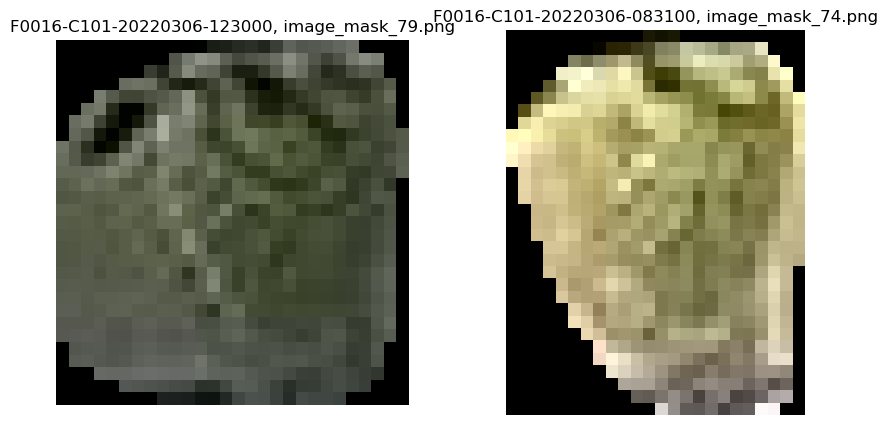

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_19
mask_id                                 134c98f578d41ee48031e7a91d420fcd
point_x_x                                                    1220.644409
point_y_x                                                     341.836792
output_image_path_x                                    image_mask_19.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

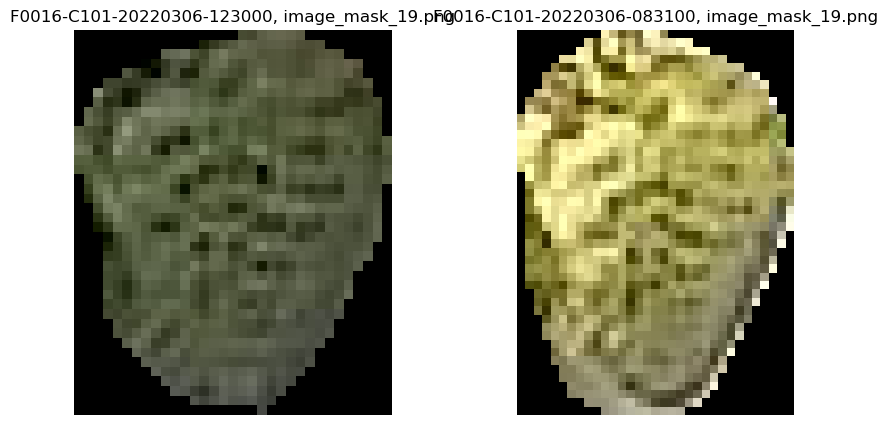

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_37
mask_id                                 13ec5bdaf3959b678f8b23f4320dca03
point_x_x                                                    1779.097534
point_y_x                                                     120.685669
output_image_path_x                                    image_mask_37.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

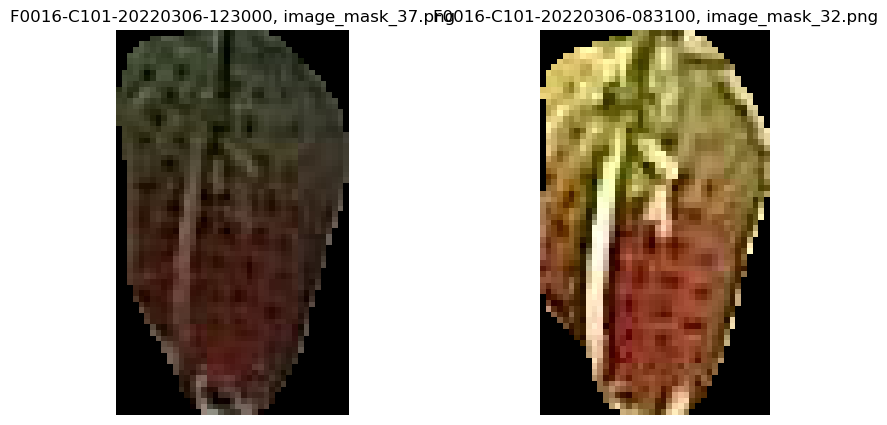

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_44
mask_id                                 1c5c98d9b32768785862b9df4f7350c2
point_x_x                                                    1738.167236
point_y_x                                                     119.555191
output_image_path_x                                    image_mask_44.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

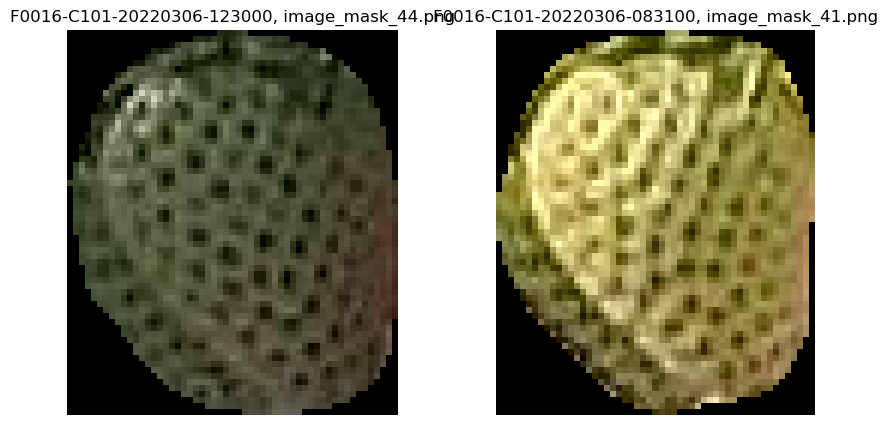

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_27
mask_id                                 22797c3cbbd518f42a87f7dbb9201ded
point_x_x                                                    1164.687134
point_y_x                                                     331.622009
output_image_path_x                                    image_mask_27.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

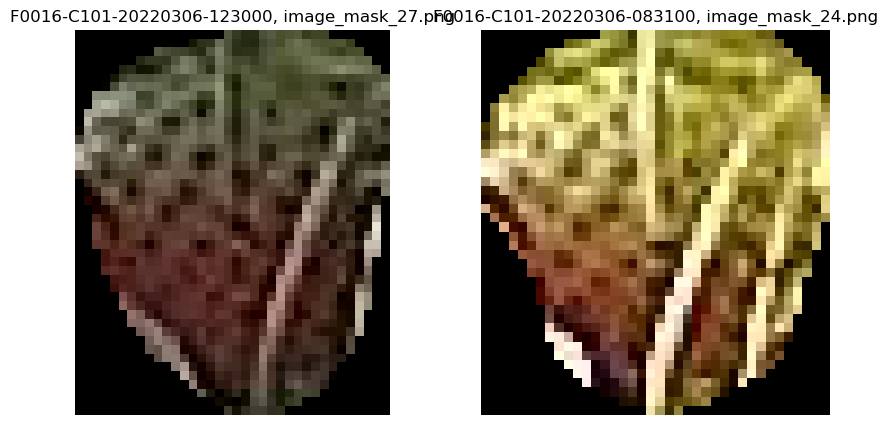

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_65
mask_id                                 2533d7b05bea0a21bff0b2e449fe6bab
point_x_x                                                     2267.38916
point_y_x                                                     402.696259
output_image_path_x                                    image_mask_65.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

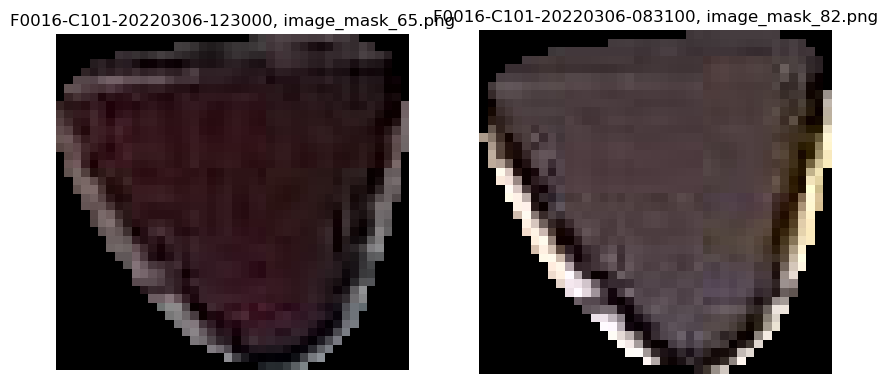

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_14
mask_id                                 29c022f7d24fa28921a44b9b91af861b
point_x_x                                                      968.75647
point_y_x                                                     468.872101
output_image_path_x                                    image_mask_14.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

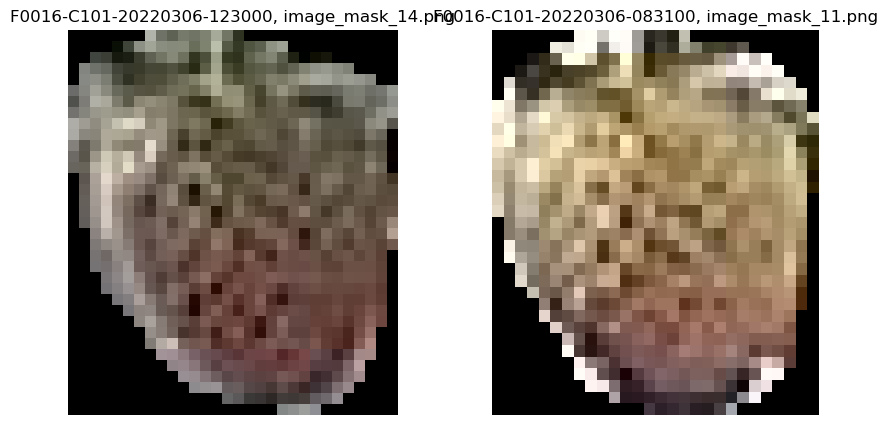

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_71
mask_id                                 2ddf428db9c52a420d9549201051ee92
point_x_x                                                    2129.953613
point_y_x                                                     420.233368
output_image_path_x                                    image_mask_71.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

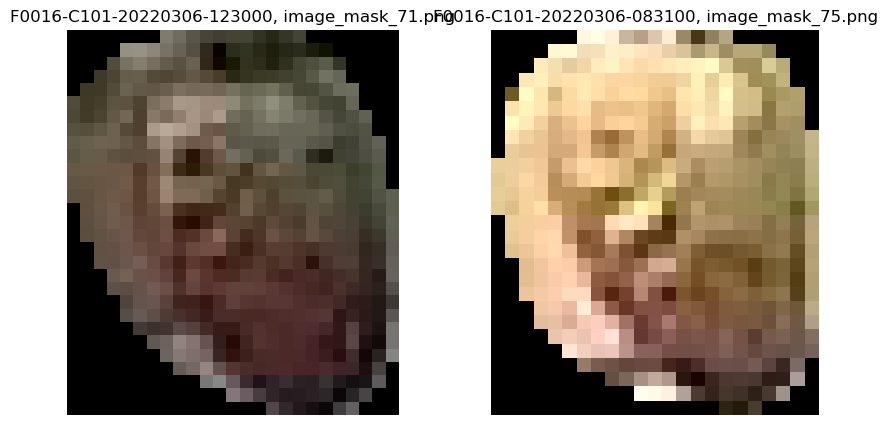

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_51
mask_id                                 2f46b323f6579f722f66e558d5baa5e2
point_x_x                                                    1604.613892
point_y_x                                                     159.061661
output_image_path_x                                    image_mask_51.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

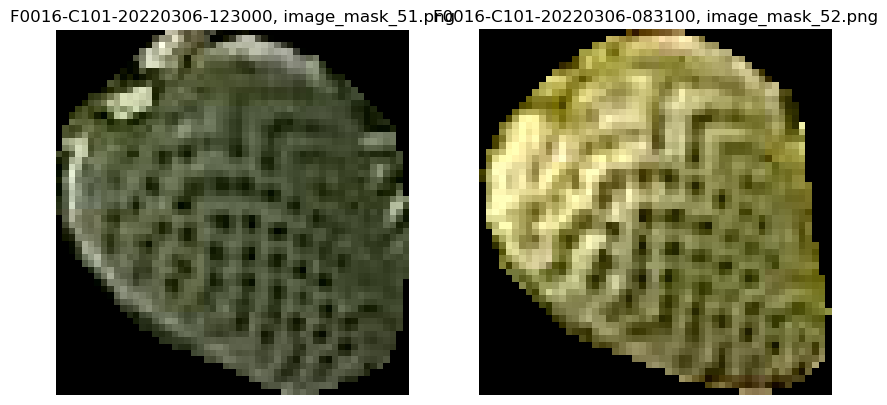

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_59
mask_id                                 2f8c12e67cce83004f7fc32b92f72913
point_x_x                                                     1503.94458
point_y_x                                                      297.38916
output_image_path_x                                    image_mask_59.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

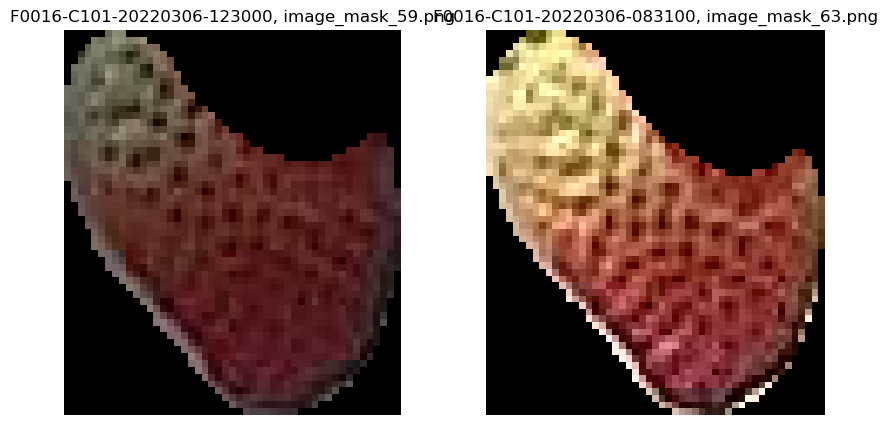

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_28
mask_id                                 38a4fa43e63eba2eecfd322ed8d9b44f
point_x_x                                                    1074.081055
point_y_x                                                     415.787323
output_image_path_x                                    image_mask_28.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

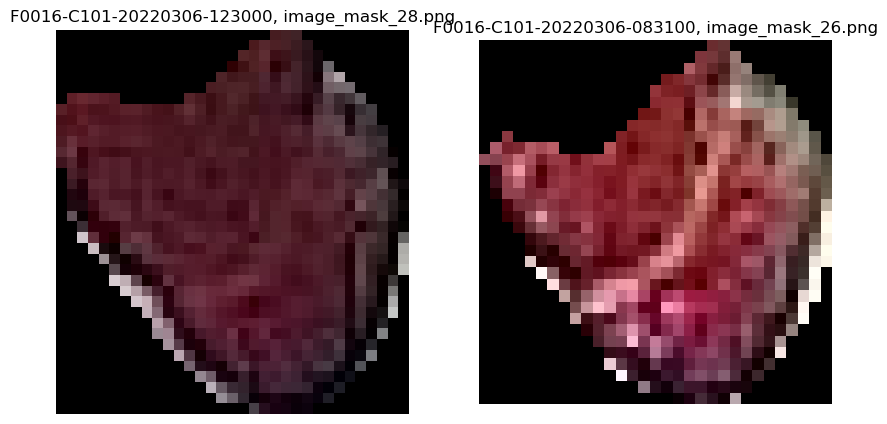

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_86
mask_id                                 3e13eb37ab42aa111180a18790515a79
point_x_x                                                    2458.655273
point_y_x                                                     405.056702
output_image_path_x                                    image_mask_86.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

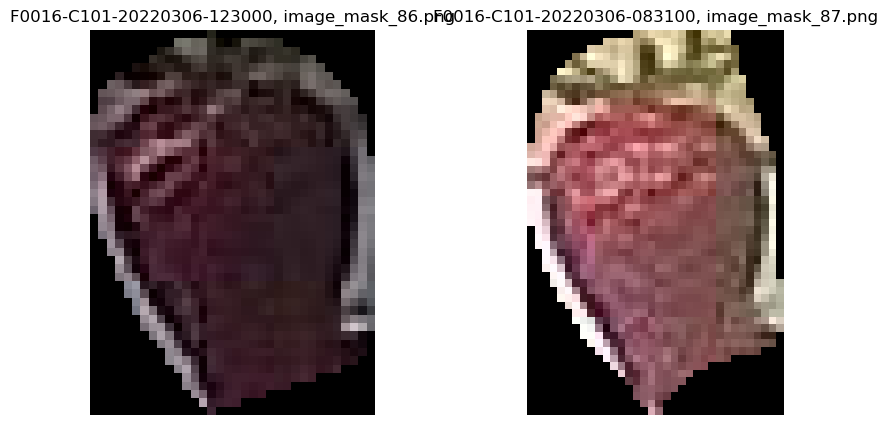

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_86
mask_id                                 3e13eb37ab42aa111180a18790515a79
point_x_x                                                    2458.655273
point_y_x                                                     405.056702
output_image_path_x                                    image_mask_86.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

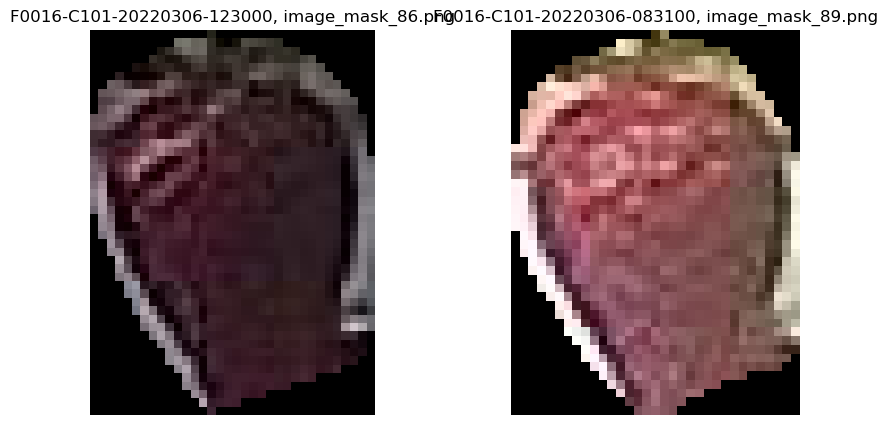

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_32
mask_id                                 43b172889d6948550bda2cf695b4cd8d
point_x_x                                                    1547.405762
point_y_x                                                      255.90593
output_image_path_x                                    image_mask_32.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

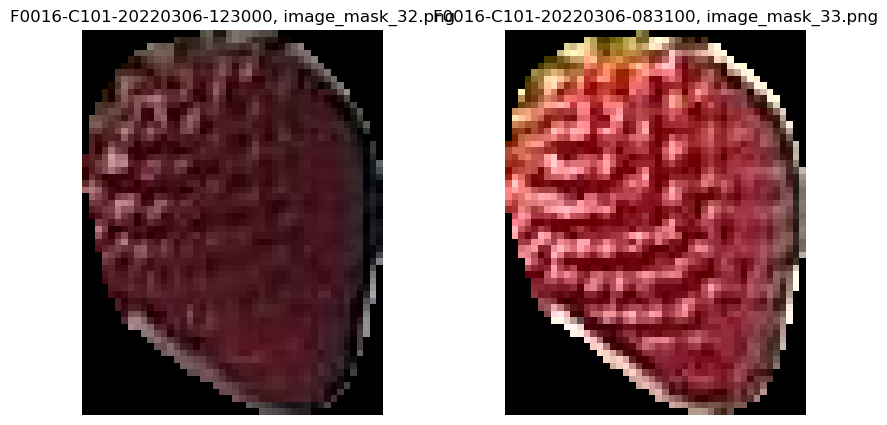

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_73
mask_id                                 443c856eaa1ff91ccb19526d7b6c105c
point_x_x                                                    2175.635742
point_y_x                                                      448.53891
output_image_path_x                                    image_mask_73.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

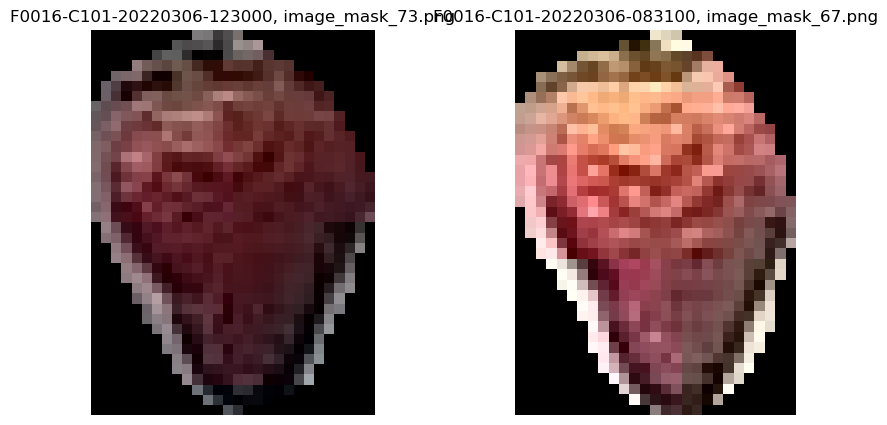

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_49
mask_id                                 44eda1824b2ba4f3815683778a8cad58
point_x_x                                                    1478.090088
point_y_x                                                      553.10437
output_image_path_x                                    image_mask_49.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

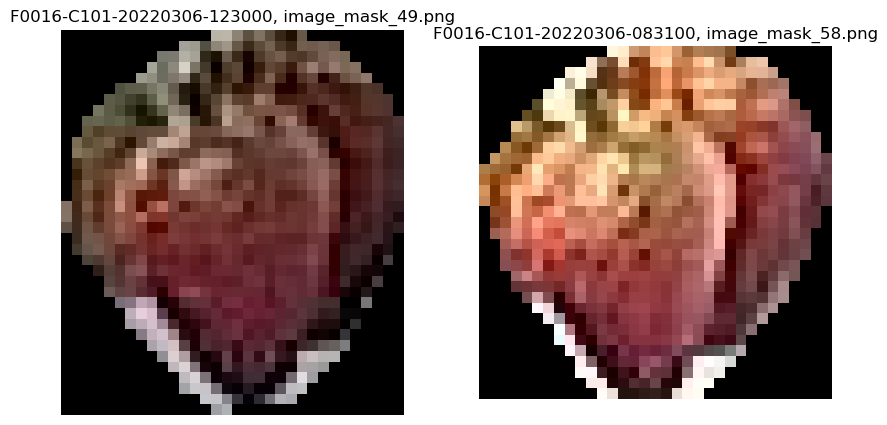

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_63
mask_id                                 47553f1b7ab2ae507acf37ddb4d8563b
point_x_x                                                    2019.036133
point_y_x                                                     168.501038
output_image_path_x                                    image_mask_63.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

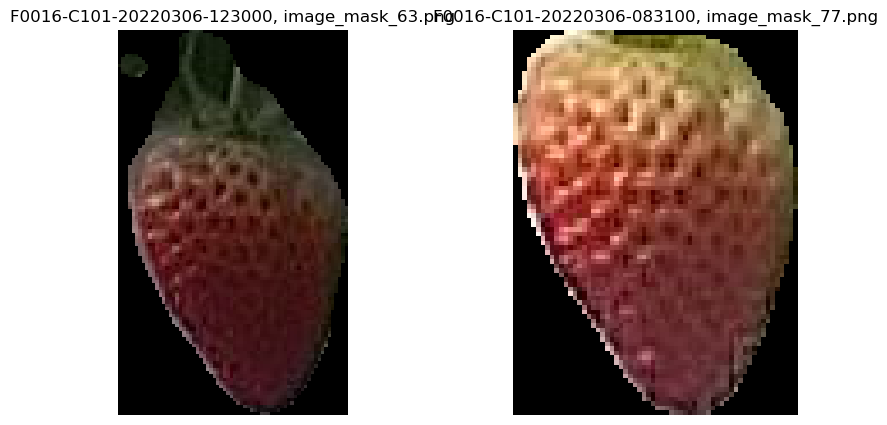

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_13
mask_id                                 4bab53d3d6a062df7d43632dbfdd7329
point_x_x                                                    1133.637695
point_y_x                                                     342.508484
output_image_path_x                                    image_mask_13.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

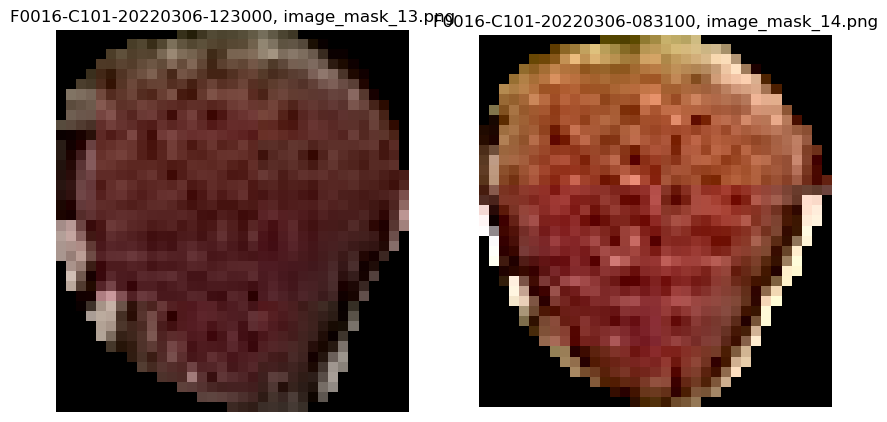

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_53
mask_id                                 4fefcdc3b4b2a36e60f7bfd5db7f662c
point_x_x                                                    1431.706787
point_y_x                                                     346.454163
output_image_path_x                                    image_mask_53.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

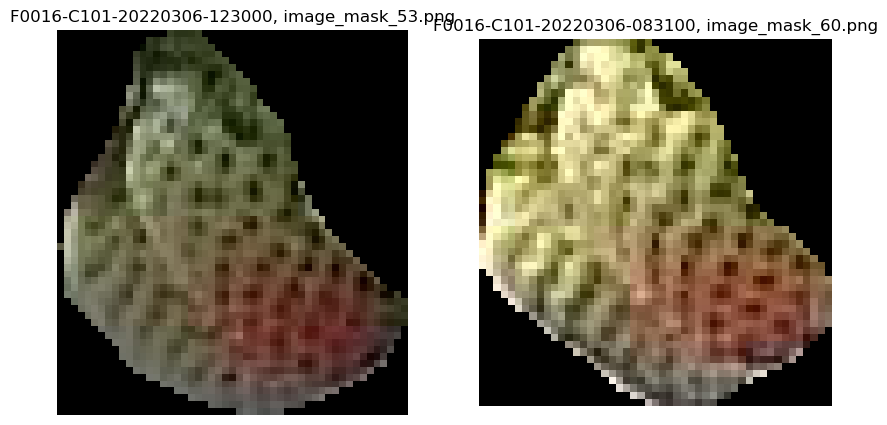

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                  F0016-C101-20220306-123000_1
mask_id                                 51084fac206bd7499fcad415c5cc50bc
point_x_x                                                     412.453156
point_y_x                                                      198.33316
output_image_path_x                                     image_mask_1.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

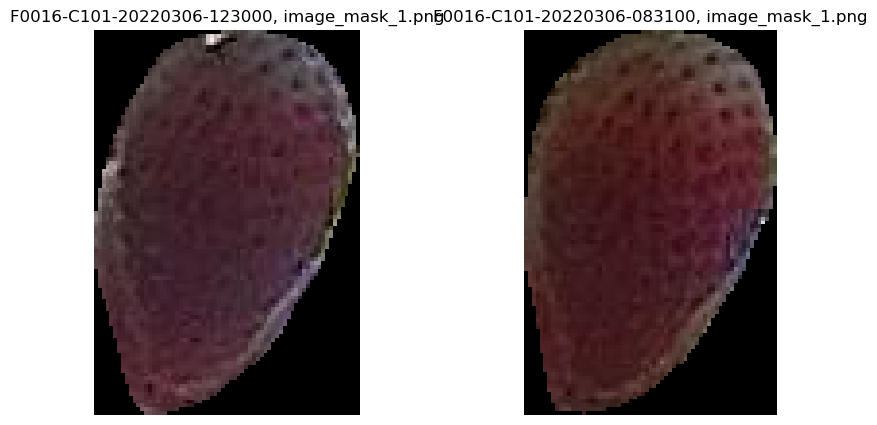

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_30
mask_id                                 54d3a82a27503b529dc629507880234c
point_x_x                                                    1877.150635
point_y_x                                                     223.690613
output_image_path_x                                    image_mask_30.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

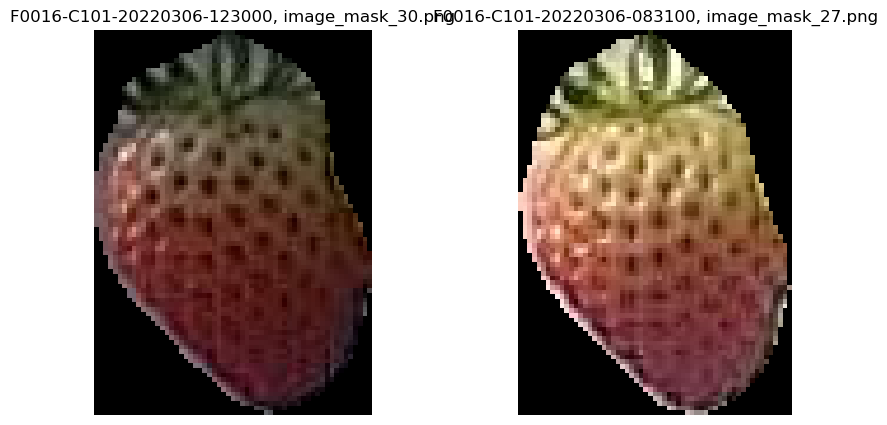

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_43
mask_id                                 60dda1794b389dc392643621fb939691
point_x_x                                                    1459.635498
point_y_x                                                     342.927917
output_image_path_x                                    image_mask_43.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

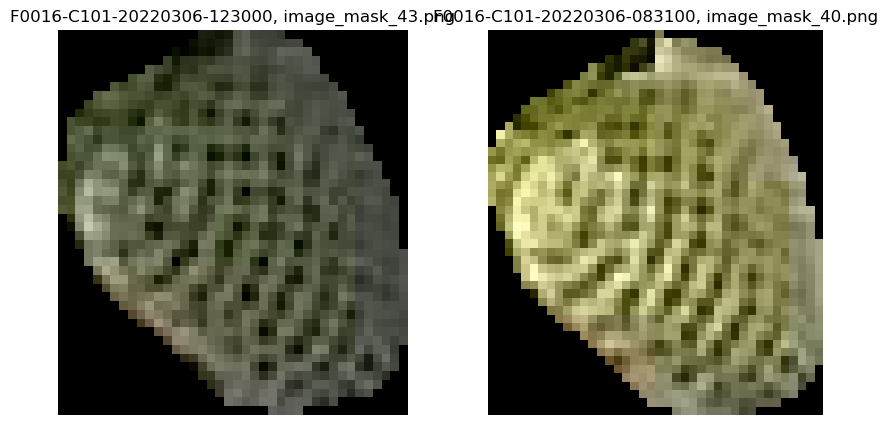

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_17
mask_id                                 64a95c85219e0bfe7fd8e8e407725401
point_x_x                                                     983.295288
point_y_x                                                     434.141785
output_image_path_x                                    image_mask_17.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

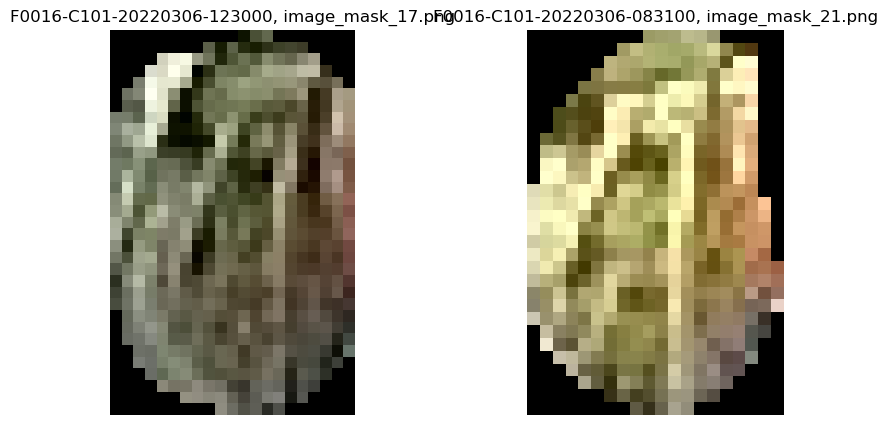

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_83
mask_id                                 67e21677124a5050ded599e640a30c6d
point_x_x                                                    1931.437744
point_y_x                                                      51.317707
output_image_path_x                                    image_mask_83.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

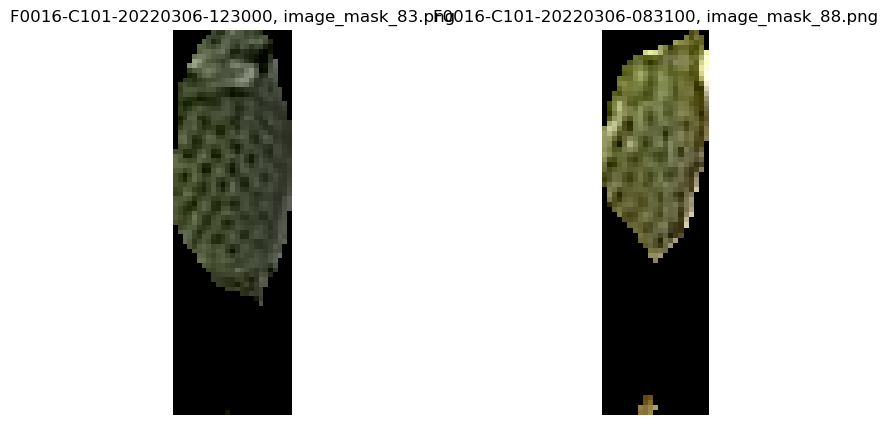

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_12
mask_id                                 6bf90ff443bfa793a0ee19d9c5ec6dad
point_x_x                                                     882.977722
point_y_x                                                     439.638672
output_image_path_x                                    image_mask_12.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

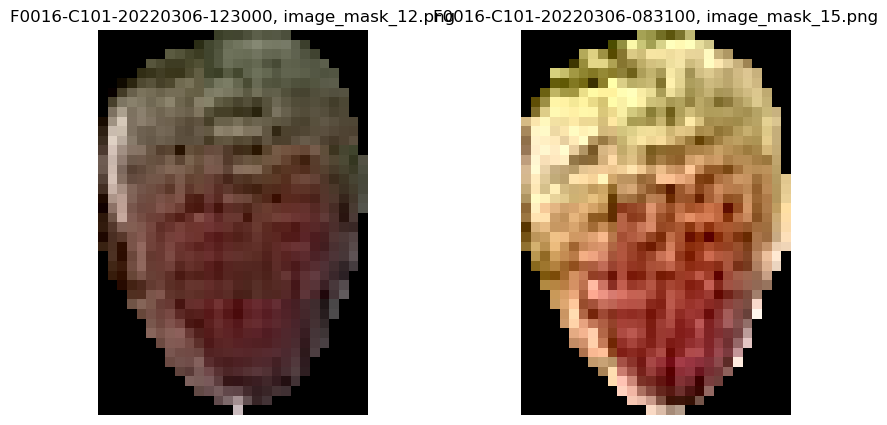

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_41
mask_id                                 7203291068cda1f0824e10521b8a5b79
point_x_x                                                    1402.621094
point_y_x                                                     283.428802
output_image_path_x                                    image_mask_41.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

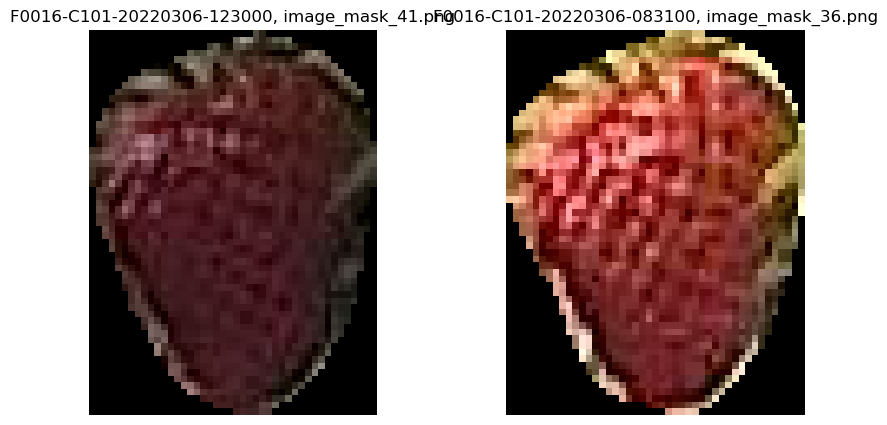

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                  F0016-C101-20220306-123000_6
mask_id                                 72b2f6651cdf576903b5cd64de66eaee
point_x_x                                                     994.016663
point_y_x                                                      473.05365
output_image_path_x                                     image_mask_6.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

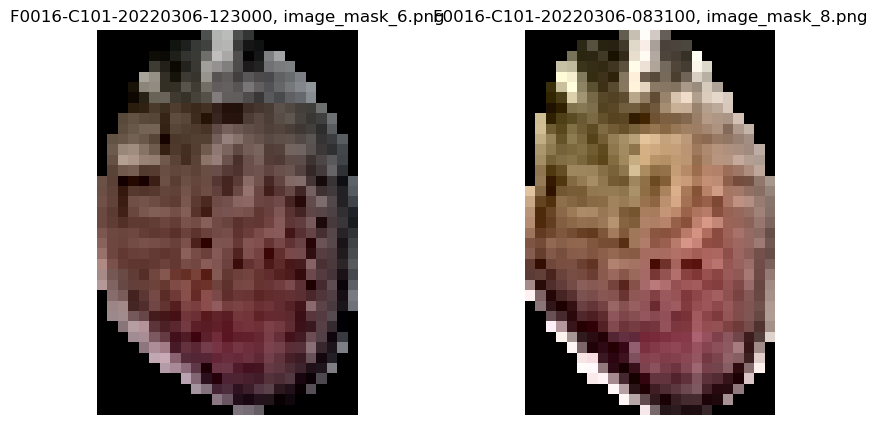

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                  F0016-C101-20220306-123000_2
mask_id                                 7759d203821a64b13164ee6cd54ed362
point_x_x                                                     348.449127
point_y_x                                                     372.711609
output_image_path_x                                     image_mask_2.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

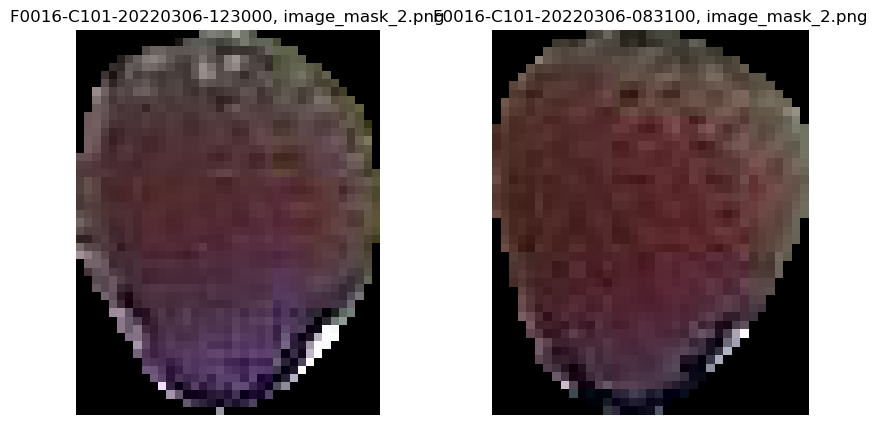

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_38
mask_id                                 77a0fc7371195626b55a65d03dfdc4b3
point_x_x                                                    1531.759521
point_y_x                                                      535.90979
output_image_path_x                                    image_mask_38.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

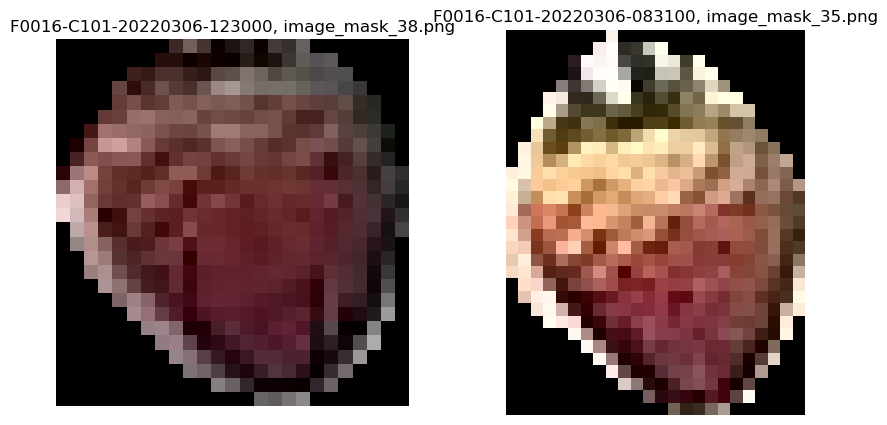

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_85
mask_id                                 78d4fc53208dbd26c310a2b88e041948
point_x_x                                                      2469.6875
point_y_x                                                     440.750549
output_image_path_x                                    image_mask_85.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

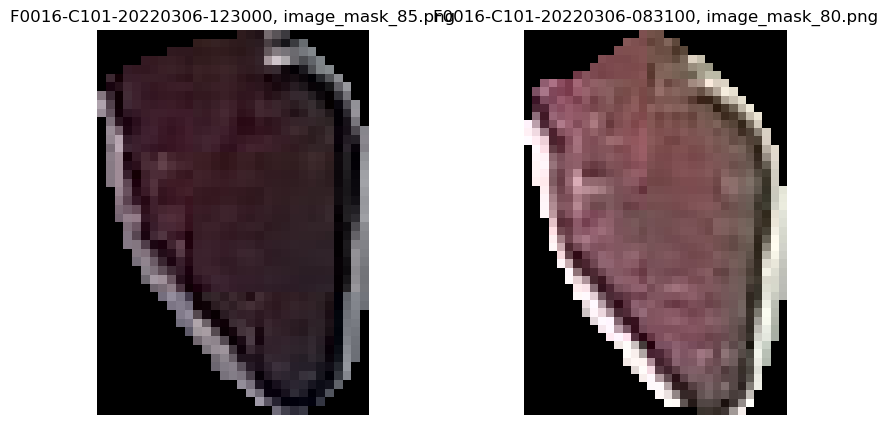

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_75
mask_id                                 797192a7b2cad2fedab485627500ed44
point_x_x                                                     2074.92041
point_y_x                                                     428.258362
output_image_path_x                                    image_mask_75.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

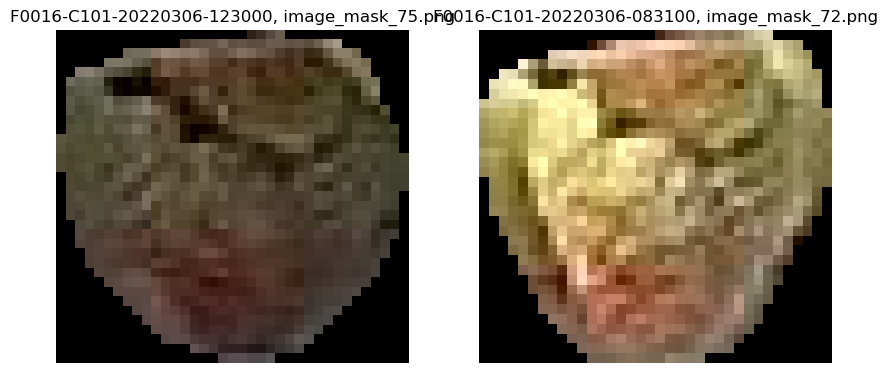

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_60
mask_id                                 79bfec736f169de7ad95f798ac95e8d0
point_x_x                                                    2314.996582
point_y_x                                                      47.562397
output_image_path_x                                    image_mask_60.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

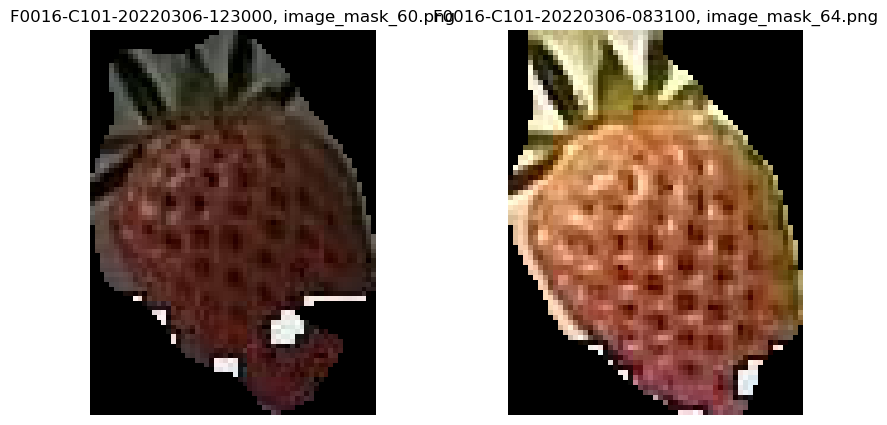

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_16
mask_id                                 7dcf74371f1bbfd71b0cfbebb273bdbd
point_x_x                                                    1064.717529
point_y_x                                                     402.745117
output_image_path_x                                    image_mask_16.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

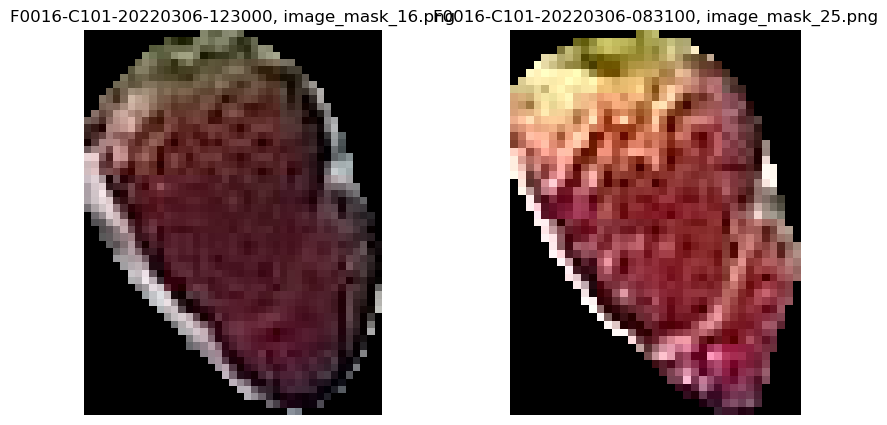

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_26
mask_id                                 7dcf74371f1bbfd71b0cfbebb273bdbd
point_x_x                                                     1062.82959
point_y_x                                                     400.101135
output_image_path_x                                    image_mask_26.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

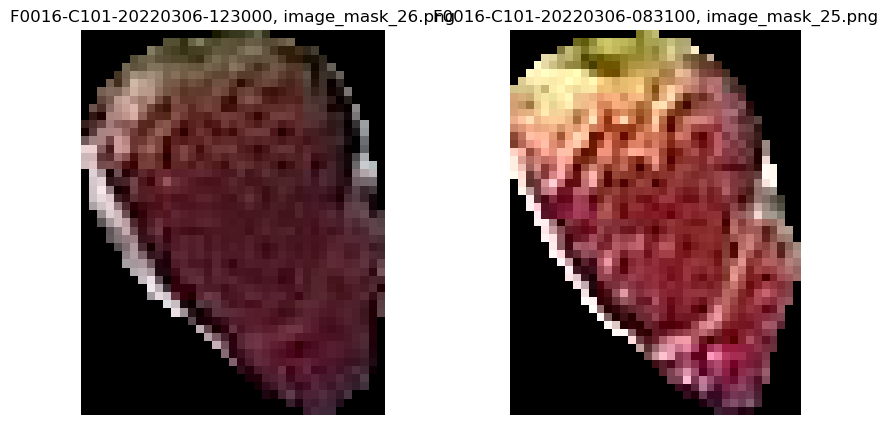

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_33
mask_id                                 8792f1901048377ddbde2baf9660f0df
point_x_x                                                    1588.021484
point_y_x                                                      104.29393
output_image_path_x                                    image_mask_33.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

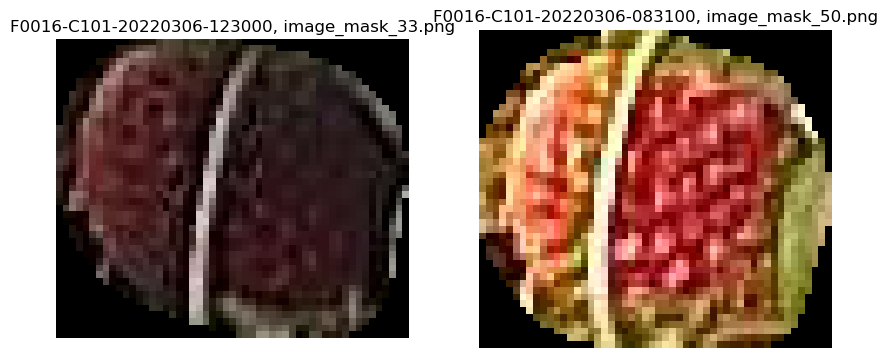

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_25
mask_id                                 8cd8e4d3fbab55354209c2a922c04843
point_x_x                                                     768.657288
point_y_x                                                     484.258118
output_image_path_x                                    image_mask_25.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

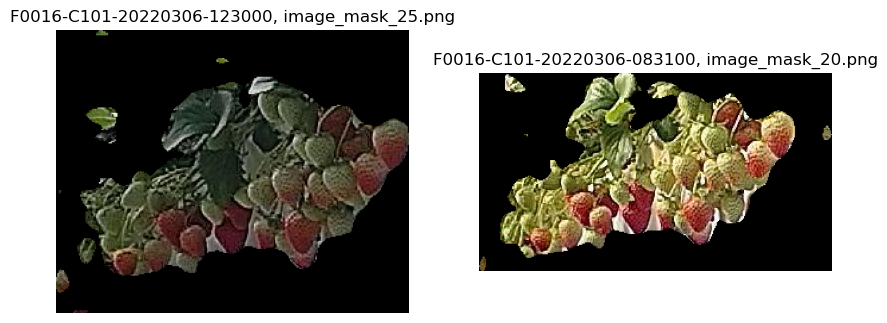

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_72
mask_id                                 8f112f3ae51df263c6ee15aa41d86dc6
point_x_x                                                    2311.467285
point_y_x                                                     396.075745
output_image_path_x                                    image_mask_72.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

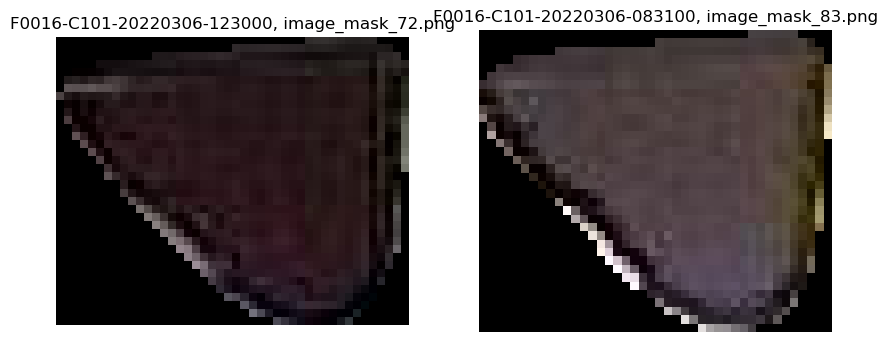

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_67
mask_id                                 923e1da268ba876a38ac0d15ed7cf9e6
point_x_x                                                    2193.505371
point_y_x                                                     424.686401
output_image_path_x                                    image_mask_67.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

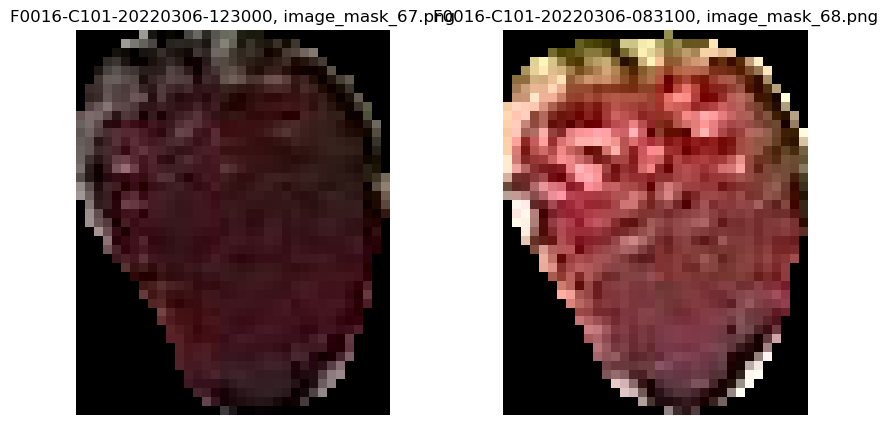

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_56
mask_id                                 97c9d4ae9456a0fc070a0d7ae0fcb2f3
point_x_x                                                    1556.498413
point_y_x                                                     499.845947
output_image_path_x                                    image_mask_56.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

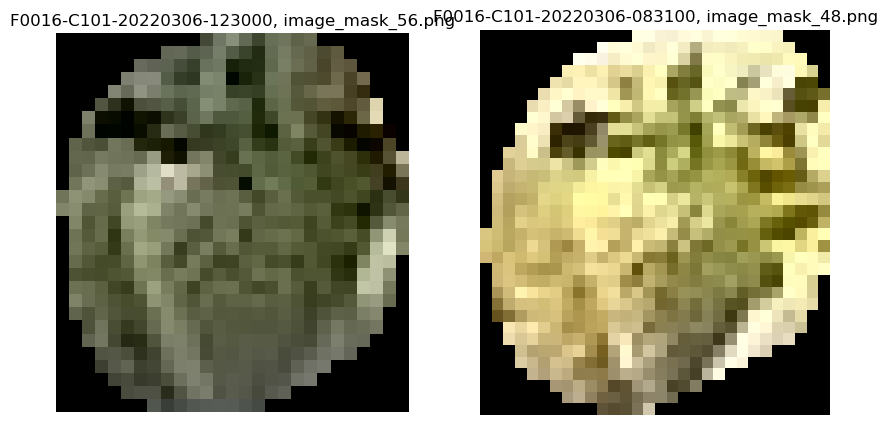

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_45
mask_id                                 986db48108836f14c3670e20d9bddfec
point_x_x                                                    1910.161133
point_y_x                                                     488.700836
output_image_path_x                                    image_mask_45.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

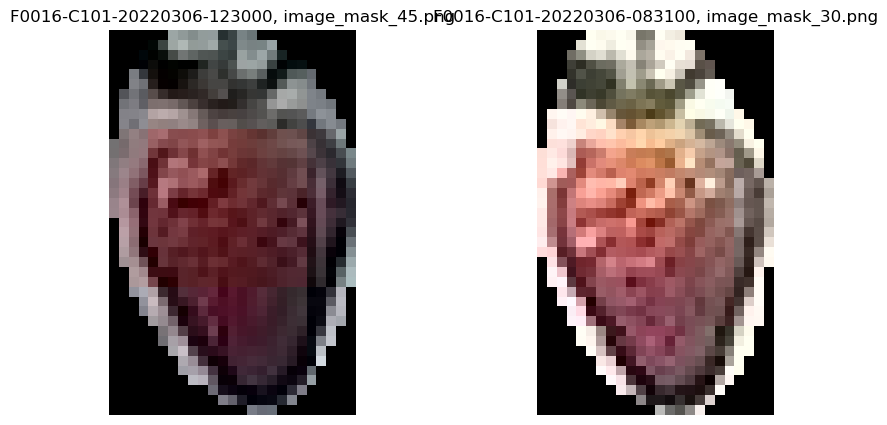

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_50
mask_id                                 99d3aedb4e309a24ac21a5113d819f0e
point_x_x                                                    1334.749756
point_y_x                                                     554.258057
output_image_path_x                                    image_mask_50.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

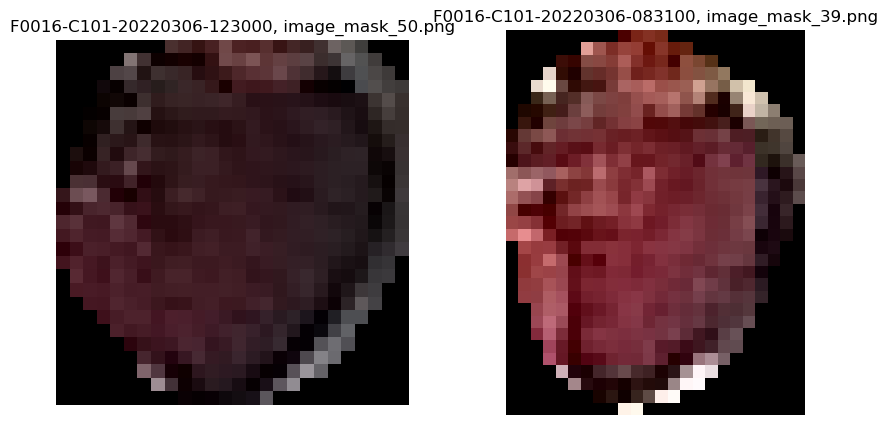

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_61
mask_id                                 9b4f4b84e5c289b3b791614e600f1106
point_x_x                                                    2495.408936
point_y_x                                                      103.60804
output_image_path_x                                    image_mask_61.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

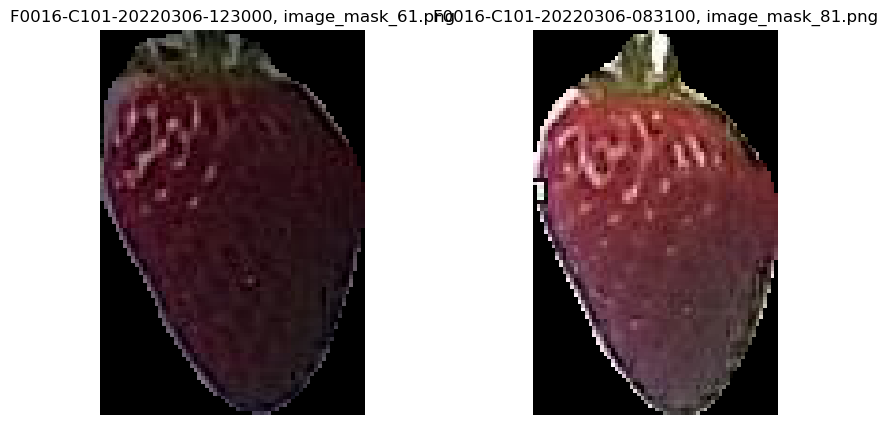

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_42
mask_id                                 9d4a888fe0aa6a137e236881cb0483bb
point_x_x                                                    1699.046509
point_y_x                                                     487.733459
output_image_path_x                                    image_mask_42.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

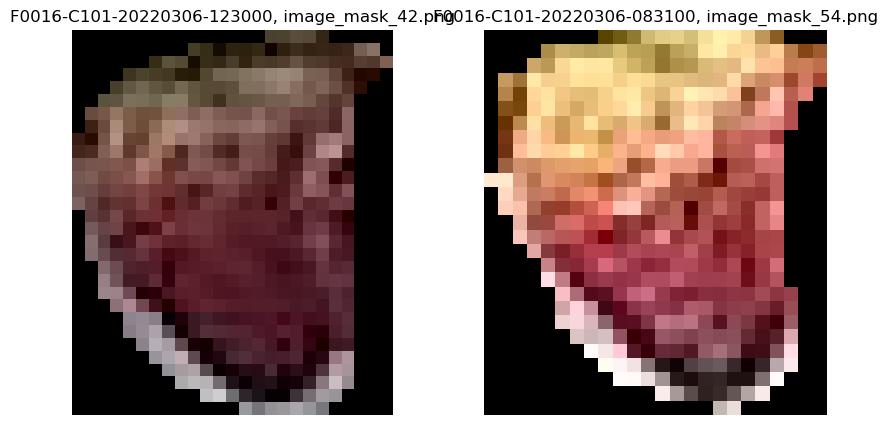

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_42
mask_id                                 9d4a888fe0aa6a137e236881cb0483bb
point_x_x                                                    1699.046509
point_y_x                                                     487.733459
output_image_path_x                                    image_mask_42.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

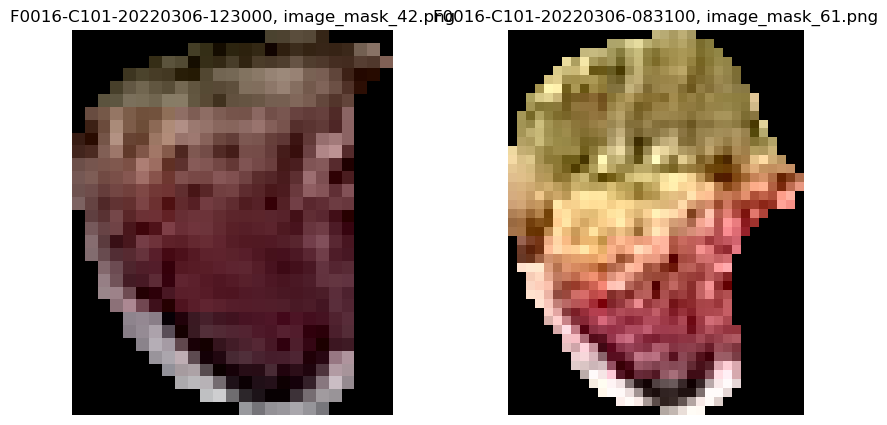

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_57
mask_id                                 a773056a53eea5523e892e698d6b7fe5
point_x_x                                                    1509.155029
point_y_x                                                     259.453094
output_image_path_x                                    image_mask_57.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

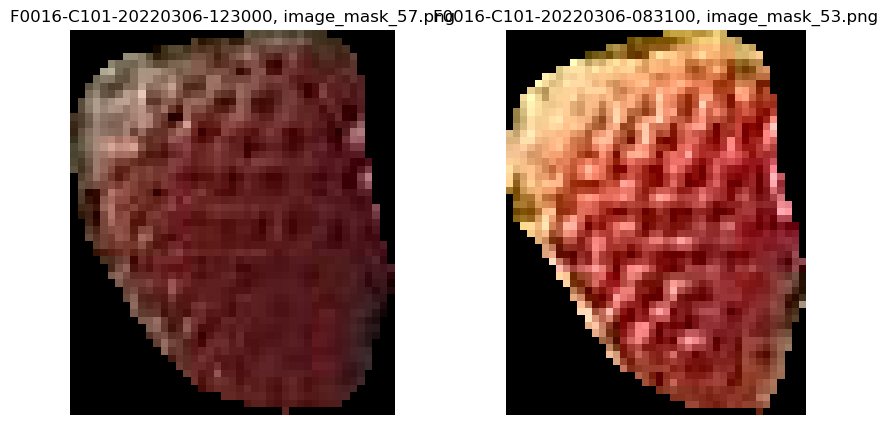

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_82
mask_id                                 a8da67d34d4921e9a623d6d83628d983
point_x_x                                                    2199.958984
point_y_x                                                      49.000107
output_image_path_x                                    image_mask_82.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

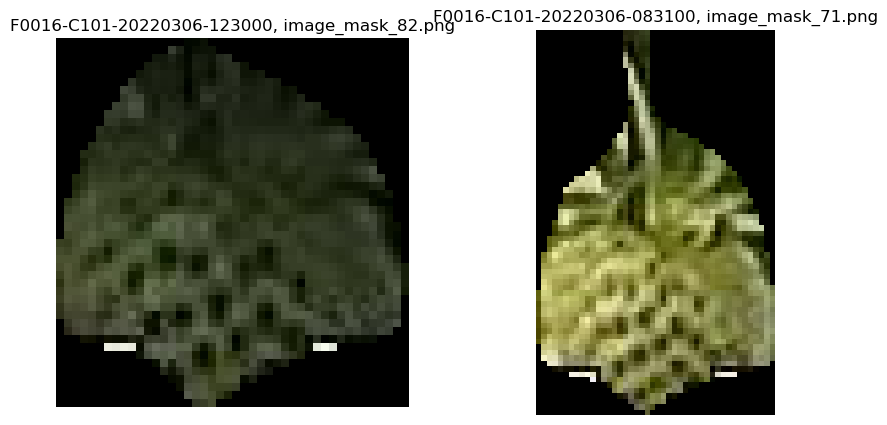

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_84
mask_id                                 a8da67d34d4921e9a623d6d83628d983
point_x_x                                                    2199.278564
point_y_x                                                       57.00309
output_image_path_x                                    image_mask_84.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

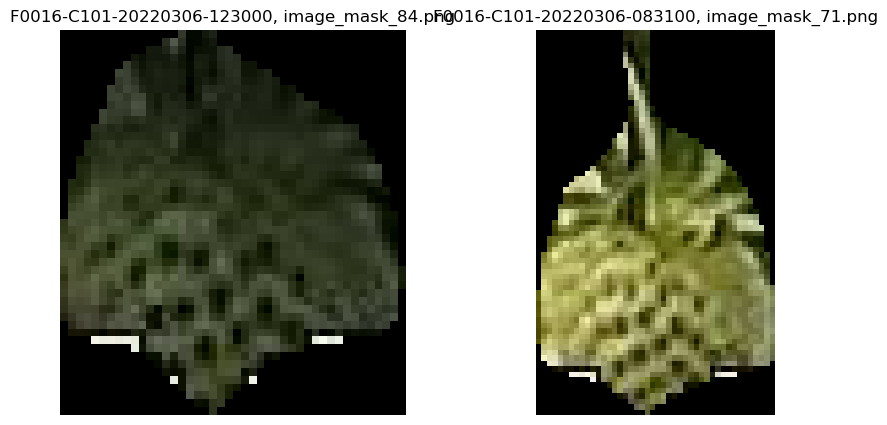

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_69
mask_id                                 b4720602b377bacde44539fba49926d8
point_x_x                                                    1935.466553
point_y_x                                                     205.431976
output_image_path_x                                    image_mask_69.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

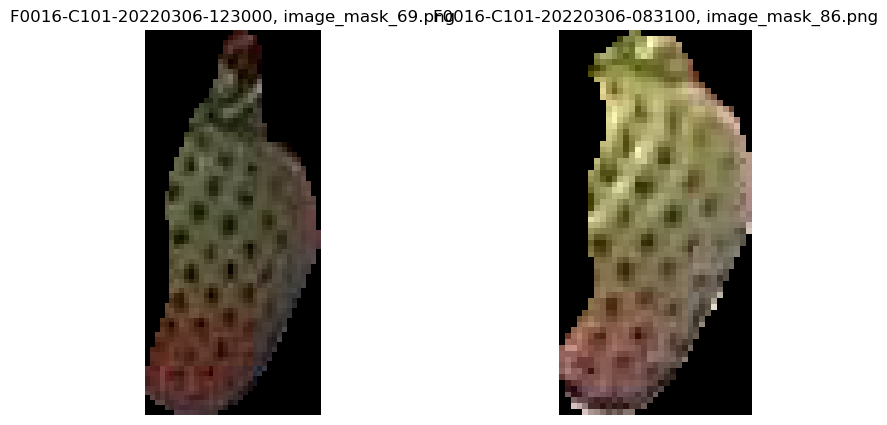

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_70
mask_id                                 bec9963ba2d0ff612cde4d2faf43712c
point_x_x                                                    2015.860107
point_y_x                                                     434.455444
output_image_path_x                                    image_mask_70.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

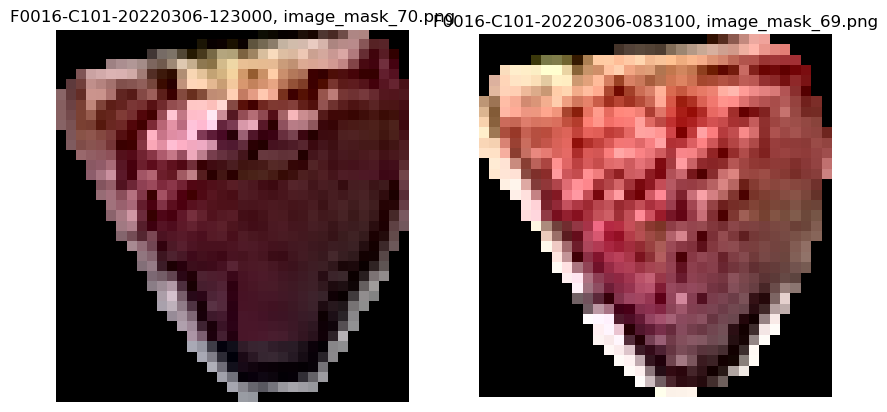

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_40
mask_id                                 c26179b0cd65eb270a4a4dd5e5a19c7e
point_x_x                                                    1504.051758
point_y_x                                                     283.433777
output_image_path_x                                    image_mask_40.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

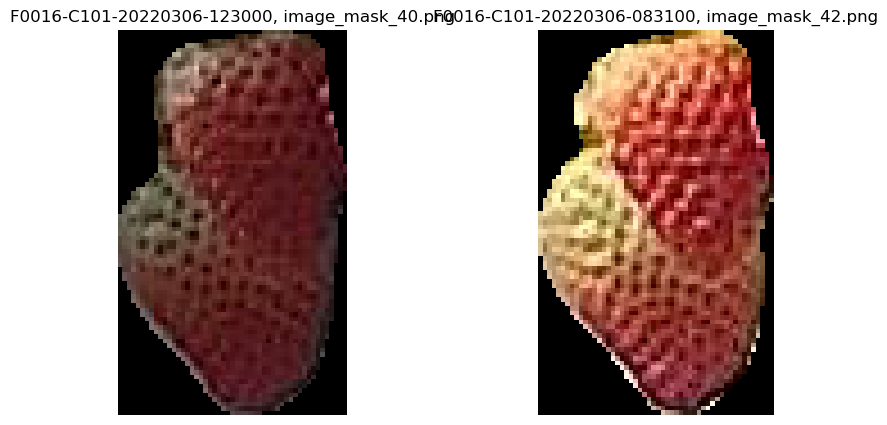

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_29
mask_id                                 c3bed56d22524f9ccf78f7c72dd3b68b
point_x_x                                                    1801.516113
point_y_x                                                     475.631195
output_image_path_x                                    image_mask_29.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

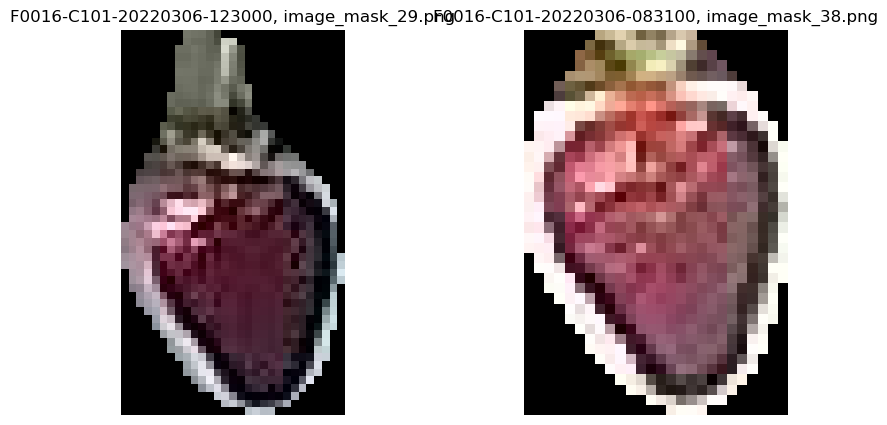

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_29
mask_id                                 c3bed56d22524f9ccf78f7c72dd3b68b
point_x_x                                                    1801.516113
point_y_x                                                     475.631195
output_image_path_x                                    image_mask_29.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

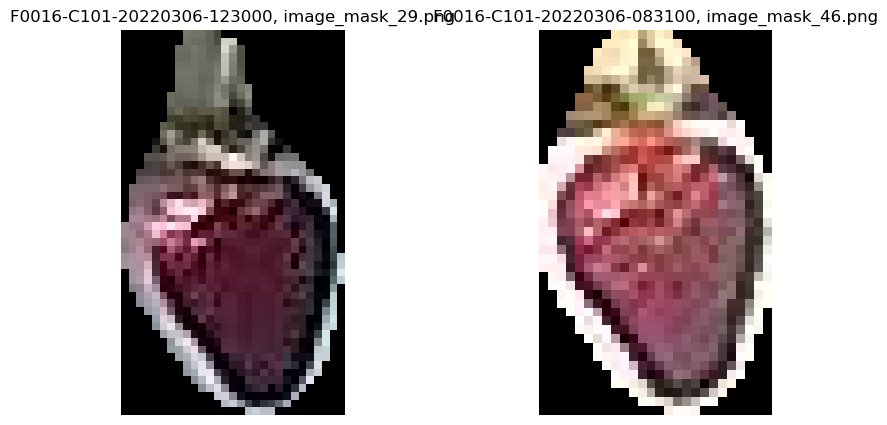

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_58
mask_id                                 c3bed56d22524f9ccf78f7c72dd3b68b
point_x_x                                                    1801.702881
point_y_x                                                     484.396271
output_image_path_x                                    image_mask_58.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

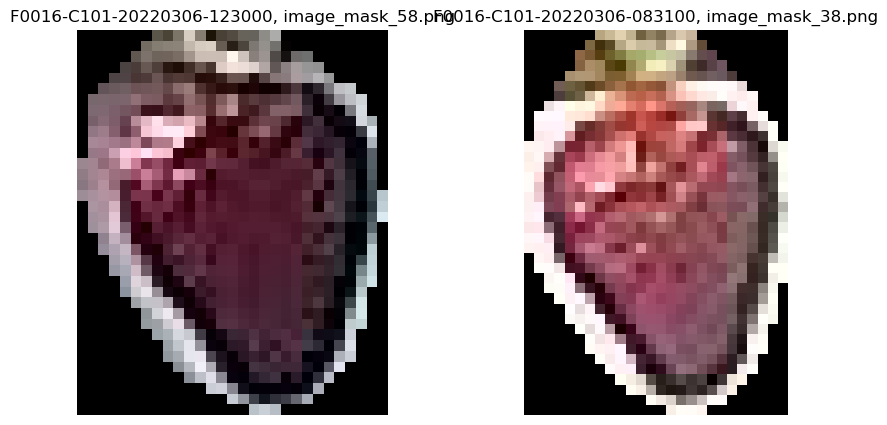

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_58
mask_id                                 c3bed56d22524f9ccf78f7c72dd3b68b
point_x_x                                                    1801.702881
point_y_x                                                     484.396271
output_image_path_x                                    image_mask_58.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

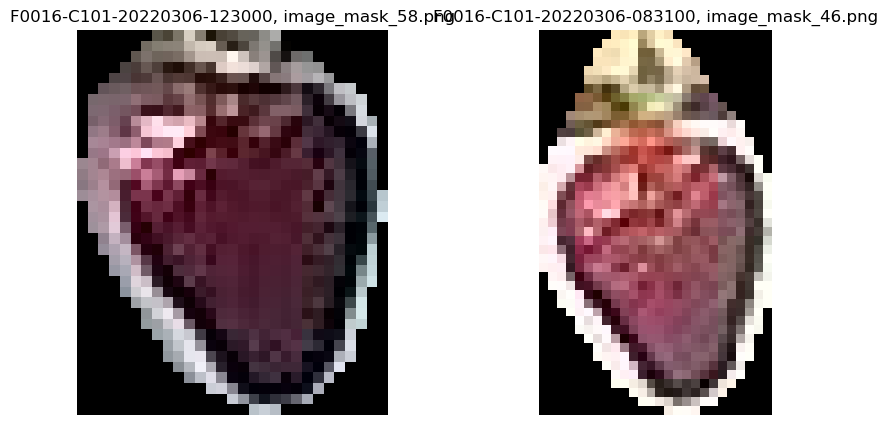

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_62
mask_id                                 ce7bd0631d94309be3bb298920469f2b
point_x_x                                                     1954.31543
point_y_x                                                     168.851273
output_image_path_x                                    image_mask_62.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

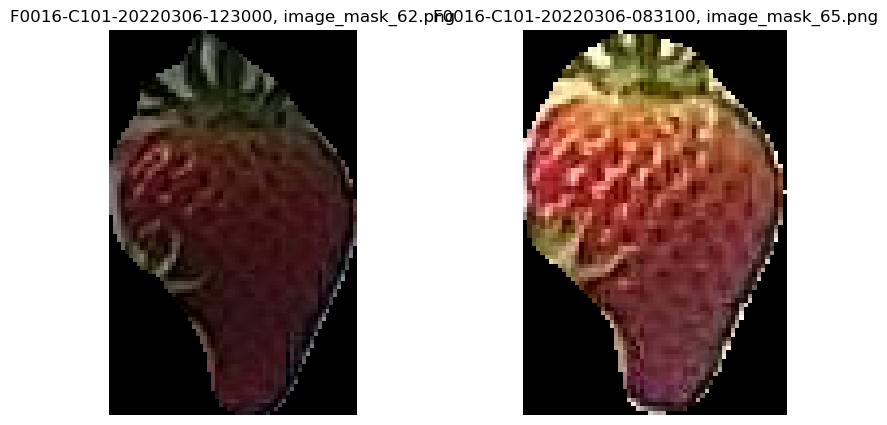

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_10
mask_id                                 d27614e8909898499e87692ba0a694ce
point_x_x                                                     995.330139
point_y_x                                                       366.0802
output_image_path_x                                    image_mask_10.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

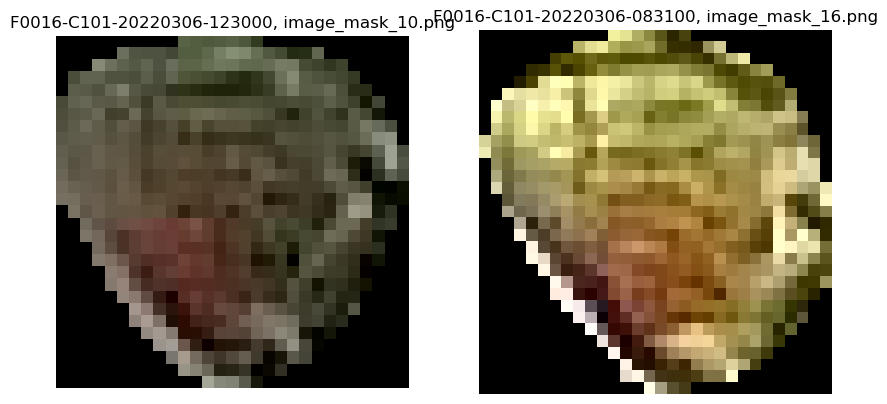

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_64
mask_id                                 d8192169ca5f1c21f5144cb09d752d33
point_x_x                                                    2421.669922
point_y_x                                                     384.012756
output_image_path_x                                    image_mask_64.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

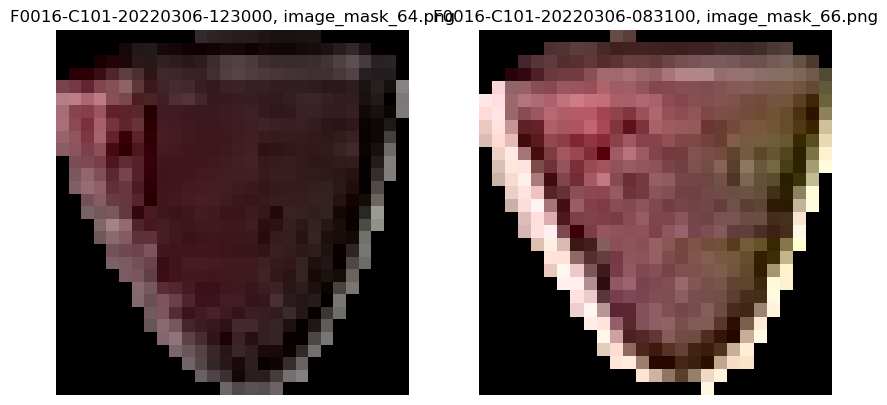

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_81
mask_id                                 da63c36cd9d9612160e29597c569c2d6
point_x_x                                                     2222.22583
point_y_x                                                     440.936676
output_image_path_x                                    image_mask_81.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

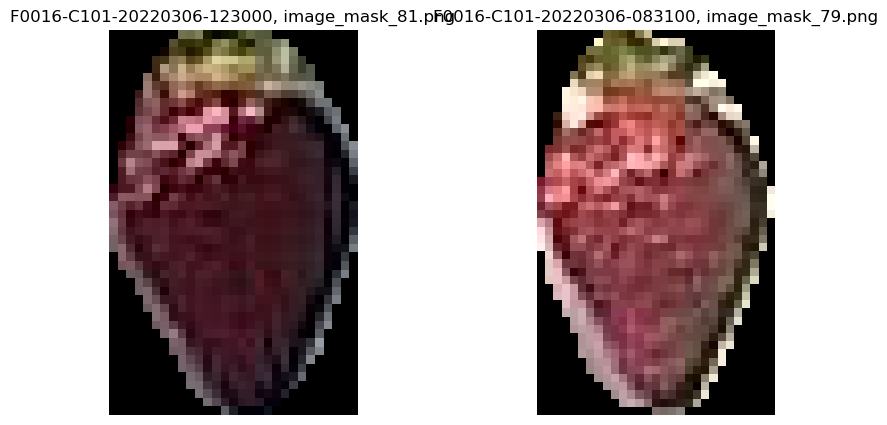

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                  F0016-C101-20220306-123000_9
mask_id                                 dea5276e50fd793d7052e379c4b83cb8
point_x_x                                                    1004.421387
point_y_x                                                     429.236237
output_image_path_x                                     image_mask_9.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

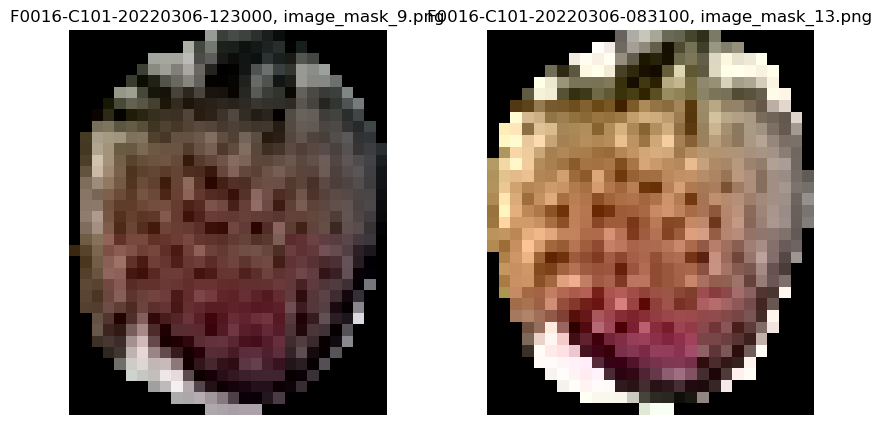

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_66
mask_id                                 e1c5ad33c74ea0d7212b54a2640f84b2
point_x_x                                                    2153.501465
point_y_x                                                       53.66555
output_image_path_x                                    image_mask_66.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

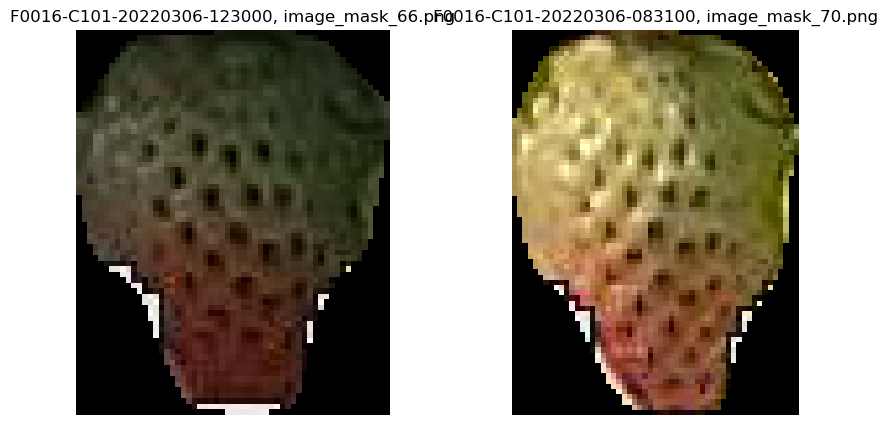

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_35
mask_id                                 eb852a11405a07a247f3fa57689c6b31
point_x_x                                                    1907.612793
point_y_x                                                     214.697357
output_image_path_x                                    image_mask_35.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

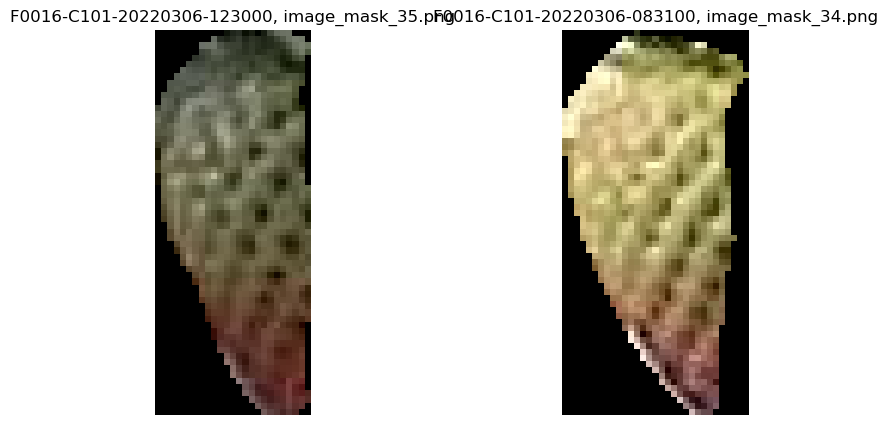

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_36
mask_id                                 ed5519317e6568ee1d84923bcd7bb1fe
point_x_x                                                    1391.258789
point_y_x                                                     339.755371
output_image_path_x                                    image_mask_36.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

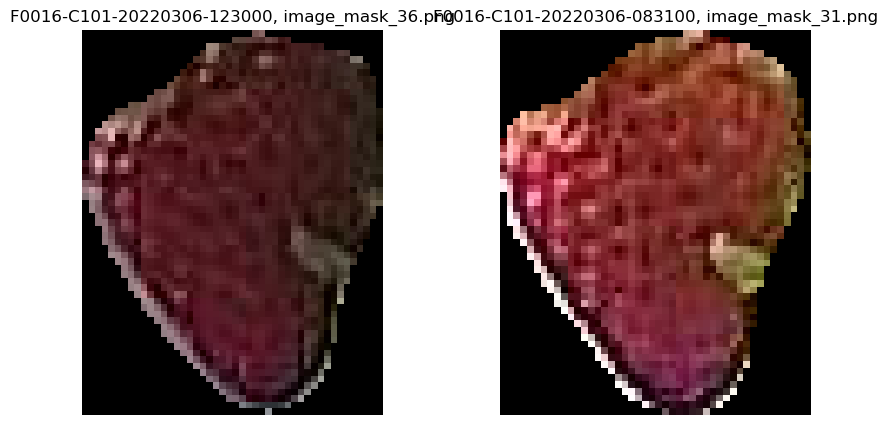

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                 F0016-C101-20220306-123000_23
mask_id                                 f57a626eda2d73e6eb7177e1e0649524
point_x_x                                                     1262.23877
point_y_x                                                     316.182098
output_image_path_x                                    image_mask_23.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

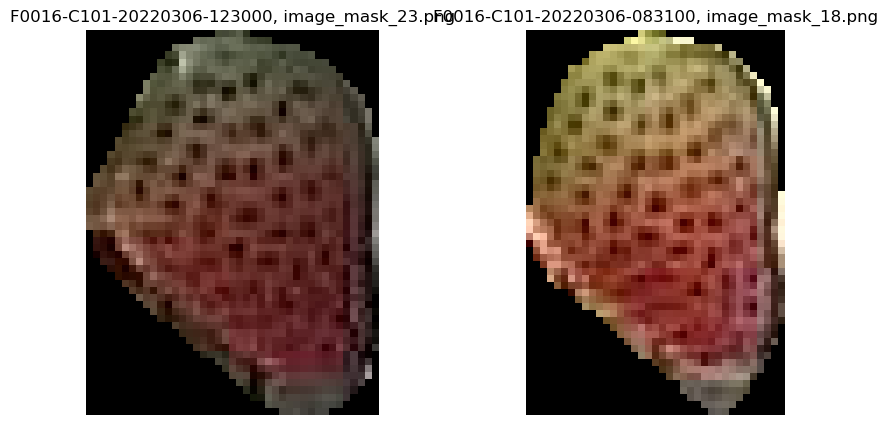

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                  F0016-C101-20220306-123000_3
mask_id                                 f5c3b60f5b0d8951dc11fa8f53ade14b
point_x_x                                                     368.466125
point_y_x                                                     239.478424
output_image_path_x                                     image_mask_3.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

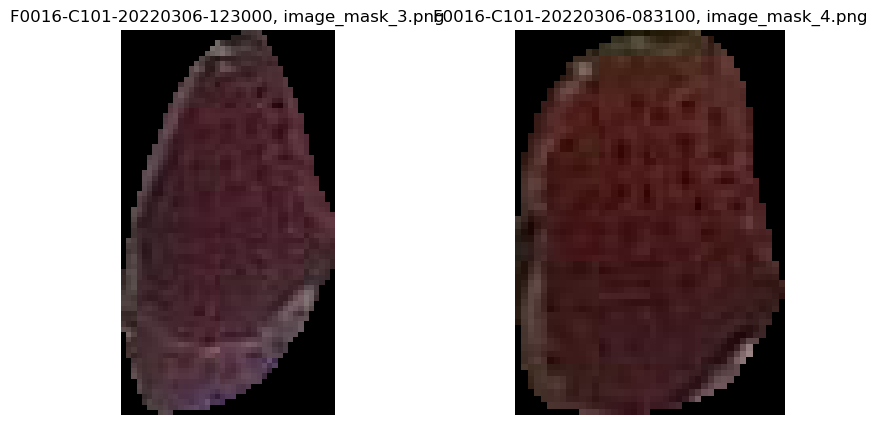

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                  F0016-C101-20220306-123000_7
mask_id                                 f63edfb1943e1860ce8389fe3c2ccc26
point_x_x                                                     1108.31189
point_y_x                                                     413.358337
output_image_path_x                                     image_mask_7.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

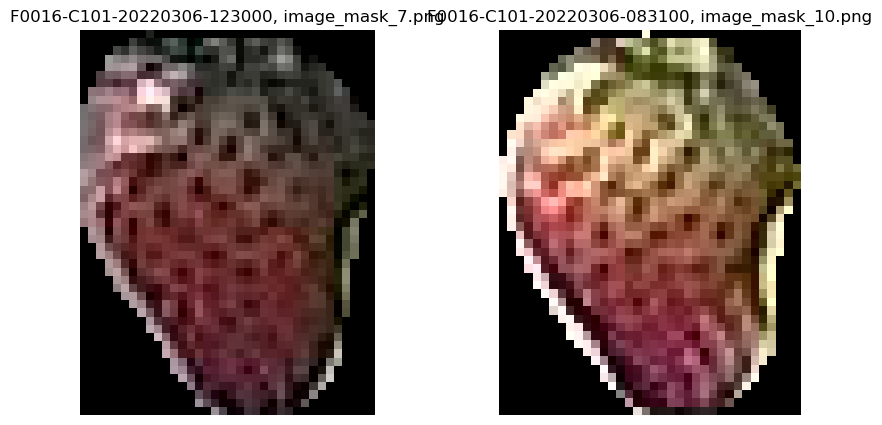

farm_code_x                                                        F0016
input_image_name_x                            F0016-C101-20220306-123000
input_image_path_x     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_x                                                         C101
before_img_name_x                             F0016-C101-20220306-083100
mask_num_x                                  F0016-C101-20220306-123000_8
mask_id                                 f70103b412b3d04b36695e5ca357d227
point_x_x                                                     1138.90625
point_y_x                                                     424.369537
output_image_path_x                                     image_mask_8.png
farm_code_y                                                        F0016
input_image_name_y                            F0016-C101-20220306-083100
input_image_path_y     /home/ubuntu/drive/dataset/plant/F0016/C101/F0...
area_code_y                                        

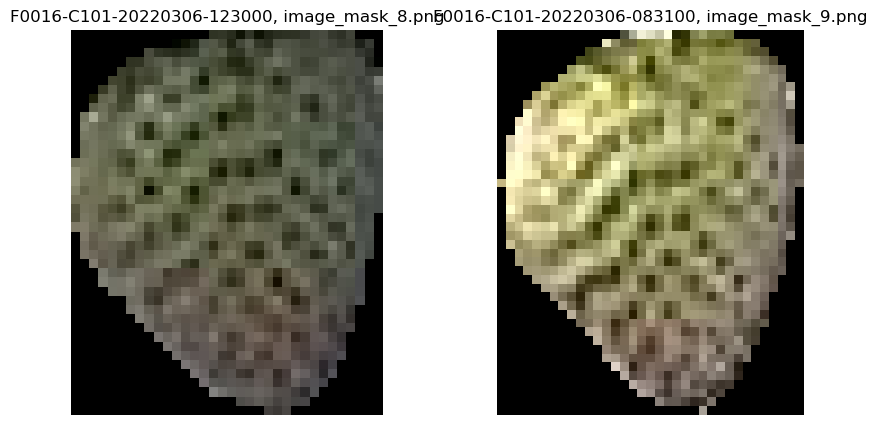

In [55]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)

In [ ]:
# 이미지가 저장된 폴더 경로 설정
base_folder = "/home/ubuntu/drive/dataset/SAM_result/"

# 각 행에 대해 visualize_mask 함수 호출
for index, row in nov0506.iterrows():
    if (row["input_image_name_x"] is not np.nan) & (row["input_image_name_y"] is not np.nan):
        print(row)
        print("-"*30)   
        visualize_mask(row, base_folder)